## Crossover of FRP sum (MW) and Pollutants levels in a time series template over the years or single year

### Portugal

#### All Years

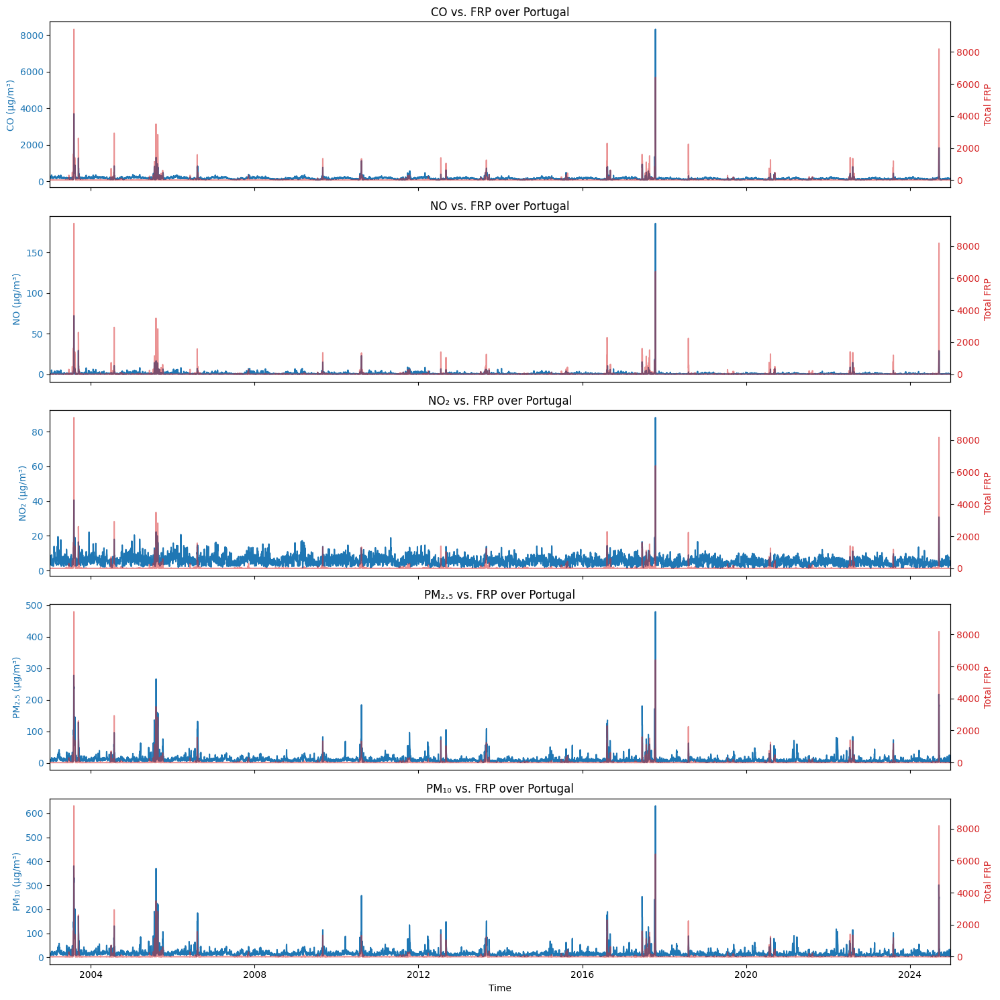

In [1]:
# All Years - Portugal

import xarray as xr
import matplotlib.pyplot as plt

# File paths for each pollutant
files = {
    'CO':     r"D:\IPMA\Results\co_fire_meteo_Portugal.nc",
    'NO':     r"D:\IPMA\Results\no_fire_meteo_Portugal.nc",
    'NO₂':    r"D:\IPMA\Results\no2_fire_meteo_Portugal.nc",
    'PM₂.₅':  r"D:\IPMA\Results\pm2p5_fire_meteo_Portugal.nc",
    'PM₁₀':   r"D:\IPMA\Results\pm10_fire_meteo_Portugal.nc"
}

# Correct units for plotting (CO now in µg/m³)
units = {
    'CO': 'µg/m³',
    'NO': 'µg/m³',
    'NO₂': 'µg/m³',
    'PM₂.₅': 'µg/m³',
    'PM₁₀': 'µg/m³'
}

# Set up figure
fig, axs = plt.subplots(len(files), 1, figsize=(15, 3 * len(files)), sharex=True)

for ax, (pollutant_name, file_path) in zip(axs, files.items()):
    # Load dataset
    ds = xr.open_dataset(file_path)

    # Extract time range
    time = ds.time
    tmin = time.min().values
    tmax = time.max().values

    # Spatial average of pollutant concentration
    pollutant = ds['Mean'].mean(dim=['latitude', 'longitude'])

    # Convert CO mg/m³ → µg/m³
    if pollutant_name == 'CO':
        pollutant = pollutant * 1000

    # Daily total FRP over Portugal
    frp = ds['frp_sum_Portugal'].mean(dim=['latitude', 'longitude'])

    # Plot pollutant mean
    ax.plot(time, pollutant, label=f'{pollutant_name} Mean ({units[pollutant_name]})', color='tab:blue')
    ax.set_ylabel(f'{pollutant_name} ({units[pollutant_name]})', color='tab:blue')
    ax.tick_params(axis='y', labelcolor='tab:blue')
    ax.grid(False)

    # Plot FRP on twin y-axis
    ax2 = ax.twinx()
    ax2.plot(time, frp, label='FRP (MW)', color='tab:red', alpha=0.5)
    ax2.set_ylabel('Total FRP', color='tab:red')
    ax2.tick_params(axis='y', labelcolor='tab:red')

    # Set x-axis limits
    ax.set_xlim([tmin, tmax])

    # Title
    ax.set_title(f'{pollutant_name} vs. FRP over Portugal')

# Global X label
axs[-1].set_xlabel('Time')
plt.tight_layout()
plt.show()


#### Certain Year

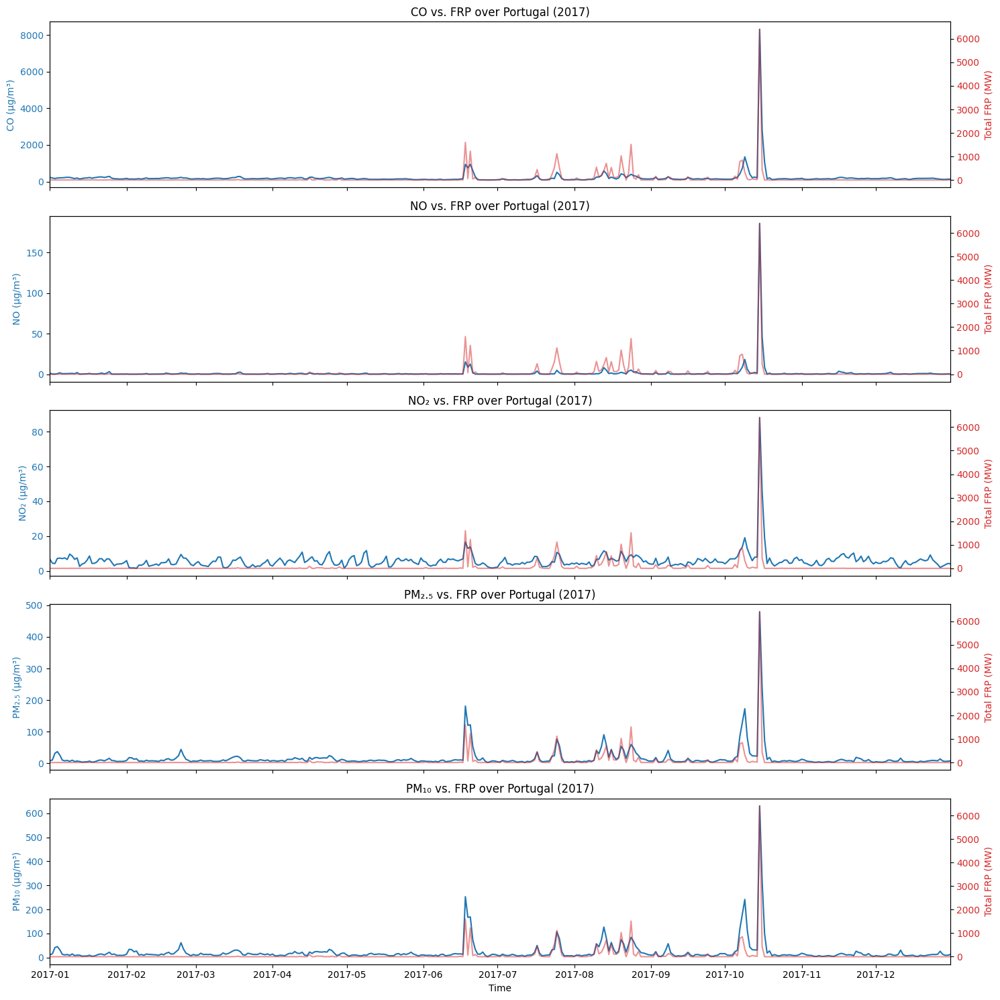

In [2]:
# Certain Year - Portugal

import xarray as xr
import matplotlib.pyplot as plt
import pandas as pd

# Set this to a specific year (e.g., 2017), or to None to plot all years
selected_year = 2017

# File paths for each pollutant
files = {
    'CO':     r"D:\IPMA\Results\co_fire_meteo_Portugal.nc",
    'NO':     r"D:\IPMA\Results\no_fire_meteo_Portugal.nc",
    'NO₂':    r"D:\IPMA\Results\no2_fire_meteo_Portugal.nc",
    'PM₂.₅':  r"D:\IPMA\Results\pm2p5_fire_meteo_Portugal.nc",
    'PM₁₀':   r"D:\IPMA\Results\pm10_fire_meteo_Portugal.nc"
}

# Units for each pollutant (CO now in µg/m³)
pollutant_units = {
    'CO': 'µg/m³',
    'NO': 'µg/m³',
    'NO₂': 'µg/m³',
    'PM₂.₅': 'µg/m³',
    'PM₁₀': 'µg/m³'
}

# Set up figure
fig, axs = plt.subplots(len(files), 1, figsize=(15, 3 * len(files)), sharex=True)

for ax, (pollutant_name, file_path) in zip(axs, files.items()):
    # Load dataset
    ds = xr.open_dataset(file_path)

    # Subset by year if specified
    if selected_year is not None:
        # Ensure time is datetime64
        ds['time'] = pd.to_datetime(ds['time'].values)
        ds = ds.sel(time=ds['time'].dt.year == selected_year)

    # Extract time and limits
    time = ds.time
    if len(time) == 0:
        ax.set_title(f'{pollutant_name} vs. FRP – No data for year {selected_year}')
        continue

    tmin = time.min().values
    tmax = time.max().values

    # Spatial average of pollutant concentration
    pollutant = ds['Mean'].mean(dim=['latitude', 'longitude'])

    # Convert CO mg/m³ → µg/m³
    if pollutant_name == 'CO':
        pollutant = pollutant * 1000

    # Daily total FRP over Portugal
    frp = ds['frp_sum_Portugal'].mean(dim=['latitude', 'longitude'])

    # Get units
    unit = pollutant_units[pollutant_name]

    # Plot pollutant mean
    ax.plot(time, pollutant, label=f'{pollutant_name} Mean ({unit})', color='tab:blue')
    ax.set_ylabel(f'{pollutant_name} ({unit})', color='tab:blue')
    ax.tick_params(axis='y', labelcolor='tab:blue')
    ax.grid(False)

    # Plot FRP on twin y-axis
    ax2 = ax.twinx()
    ax2.plot(time, frp, label='FRP (MW)', color='tab:red', alpha=0.5)
    ax2.set_ylabel('Total FRP (MW)', color='tab:red')
    ax2.tick_params(axis='y', labelcolor='tab:red')

    # Set x-axis limits to match time range
    ax.set_xlim([tmin, tmax])

    # Title
    title = f'{pollutant_name} vs. FRP over Portugal'
    if selected_year is not None:
        title += f' ({selected_year})'
    ax.set_title(title)

# Global X label
axs[-1].set_xlabel('Time')
plt.tight_layout()
plt.show()


#### Chosen Year all together

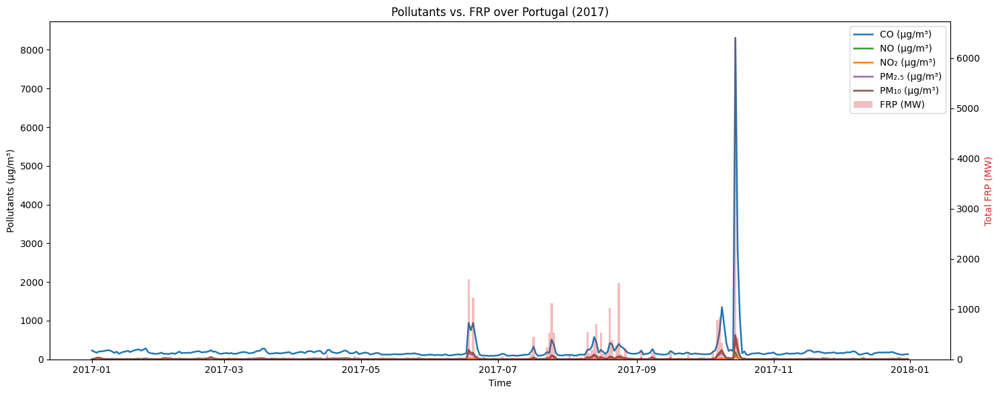

In [3]:
import xarray as xr
import matplotlib.pyplot as plt
import pandas as pd

# --- Settings ---
selected_year = 2017

# File paths for each pollutant
files = {
    'CO':     r"D:\IPMA\Results\co_fire_meteo_Portugal.nc",
    'NO':     r"D:\IPMA\Results\no_fire_meteo_Portugal.nc",
    'NO₂':    r"D:\IPMA\Results\no2_fire_meteo_Portugal.nc",
    'PM₂.₅':  r"D:\IPMA\Results\pm2p5_fire_meteo_Portugal.nc",
    'PM₁₀':   r"D:\IPMA\Results\pm10_fire_meteo_Portugal.nc"
}

# Units for each pollutant
pollutant_units = {
    'CO': 'µg/m³',   # converted from mg/m³
    'NO': 'µg/m³',
    'NO₂': 'µg/m³',
    'PM₂.₅': 'µg/m³',
    'PM₁₀': 'µg/m³'
}

# Colors for pollutants
colors = {
    'CO': 'tab:blue',
    'NO': 'tab:green',
    'NO₂': 'tab:orange',
    'PM₂.₅': 'tab:purple',
    'PM₁₀': 'tab:brown'
}

# --- Create one figure ---
fig, ax = plt.subplots(figsize=(15, 6))
ax2 = ax.twinx()  # secondary axis for FRP

frp_plotted = False  # so we only plot FRP once

# --- Loop over pollutants ---
for pollutant_name, file_path in files.items():
    ds = xr.open_dataset(file_path)

    # Subset by year if specified
    if selected_year is not None:
        ds['time'] = pd.to_datetime(ds['time'].values)
        ds = ds.sel(time=ds['time'].dt.year == selected_year)

    if len(ds.time) == 0:
        continue

    # Spatial average
    pollutant = ds['Mean'].mean(dim=['latitude', 'longitude'])

    # Convert CO from mg/m³ → µg/m³
    if pollutant_name == 'CO':
        pollutant = pollutant * 1000

    # Plot pollutant line
    unit = pollutant_units[pollutant_name]
    ax.plot(ds.time, pollutant, label=f'{pollutant_name} ({unit})',
            color=colors[pollutant_name], linewidth=1.8)

    # Plot FRP only once (as bars)
    if not frp_plotted and 'frp_sum_Portugal' in ds:
        frp = ds['frp_sum_Portugal'].mean(dim=['latitude', 'longitude'])
        ax2.bar(ds.time, frp, width=1.0, color='tab:red', alpha=0.3, label='FRP (MW)')
        frp_plotted = True

# --- Axis formatting ---
ax.set_ylabel("Pollutants (µg/m³)", color='black')
ax2.set_ylabel("Total FRP (MW)", color='tab:red')

# Force both y-axes to start at zero
ax.set_ylim(bottom=0)
ax2.set_ylim(bottom=0)

# Title
title = "Pollutants vs. FRP over Portugal"
if selected_year is not None:
    title += f" ({selected_year})"
ax.set_title(title)

# Legend (combine both axes)
lines, labels = ax.get_legend_handles_labels()
lines2, labels2 = ax2.get_legend_handles_labels()
ax.legend(lines + lines2, labels + labels2, loc='upper right')

ax.set_xlabel("Time")
plt.tight_layout()
plt.show()


### Italy

#### All Years

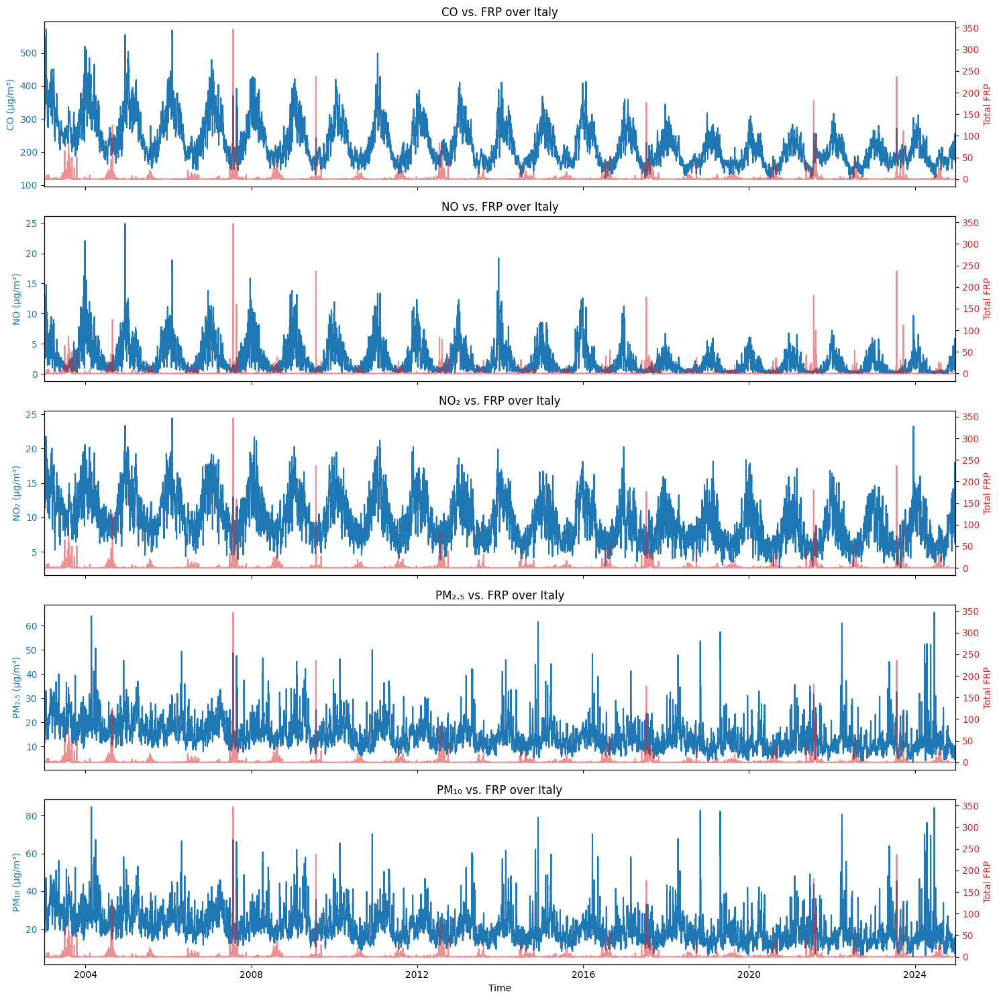

In [4]:
# All Years - Italy

import xarray as xr
import matplotlib.pyplot as plt

# File paths for each pollutant
files = {
    'CO':     r"D:\IPMA\Results\co_fire_meteo_Italy.nc",
    'NO':     r"D:\IPMA\Results\no_fire_meteo_Italy.nc",
    'NO₂':    r"D:\IPMA\Results\no2_fire_meteo_Italy.nc",
    'PM₂.₅':  r"D:\IPMA\Results\pm2p5_fire_meteo_Italy.nc",
    'PM₁₀':   r"D:\IPMA\Results\pm10_fire_meteo_Italy.nc"
}

# Correct units for plotting
units = {
    'CO': 'µg/m³',
    'NO': 'µg/m³',
    'NO₂': 'µg/m³',
    'PM₂.₅': 'µg/m³',
    'PM₁₀': 'µg/m³'
}

# Set up figure
fig, axs = plt.subplots(len(files), 1, figsize=(15, 3 * len(files)), sharex=True)

for ax, (pollutant_name, file_path) in zip(axs, files.items()):
    # Load dataset
    ds = xr.open_dataset(file_path)

    # Extract time range
    time = ds.time
    tmin = time.min().values
    tmax = time.max().values

    # Spatial average of pollutant concentration
    pollutant = ds['Mean'].mean(dim=['latitude', 'longitude'])

    # Convert CO mg/m³ → µg/m³
    if pollutant_name == 'CO':
        pollutant = pollutant * 1000

    # Daily total FRP over Italy
    frp = ds['frp_sum_Italy'].mean(dim=['latitude', 'longitude'])

    # Plot pollutant mean
    ax.plot(time, pollutant, label=f'{pollutant_name} Mean ({units[pollutant_name]})', color='tab:blue')
    ax.set_ylabel(f'{pollutant_name} ({units[pollutant_name]})', color='tab:blue')
    ax.tick_params(axis='y', labelcolor='tab:blue')
    ax.grid(False)

    # Plot FRP on twin y-axis
    ax2 = ax.twinx()
    ax2.plot(time, frp, label='FRP (MW)', color='tab:red', alpha=0.5)
    ax2.set_ylabel('Total FRP', color='tab:red')
    ax2.tick_params(axis='y', labelcolor='tab:red')

    # Set x-axis limits
    ax.set_xlim([tmin, tmax])

    # Title
    ax.set_title(f'{pollutant_name} vs. FRP over Italy')

# Global X label
axs[-1].set_xlabel('Time')
plt.tight_layout()
plt.show()


#### Certain Year

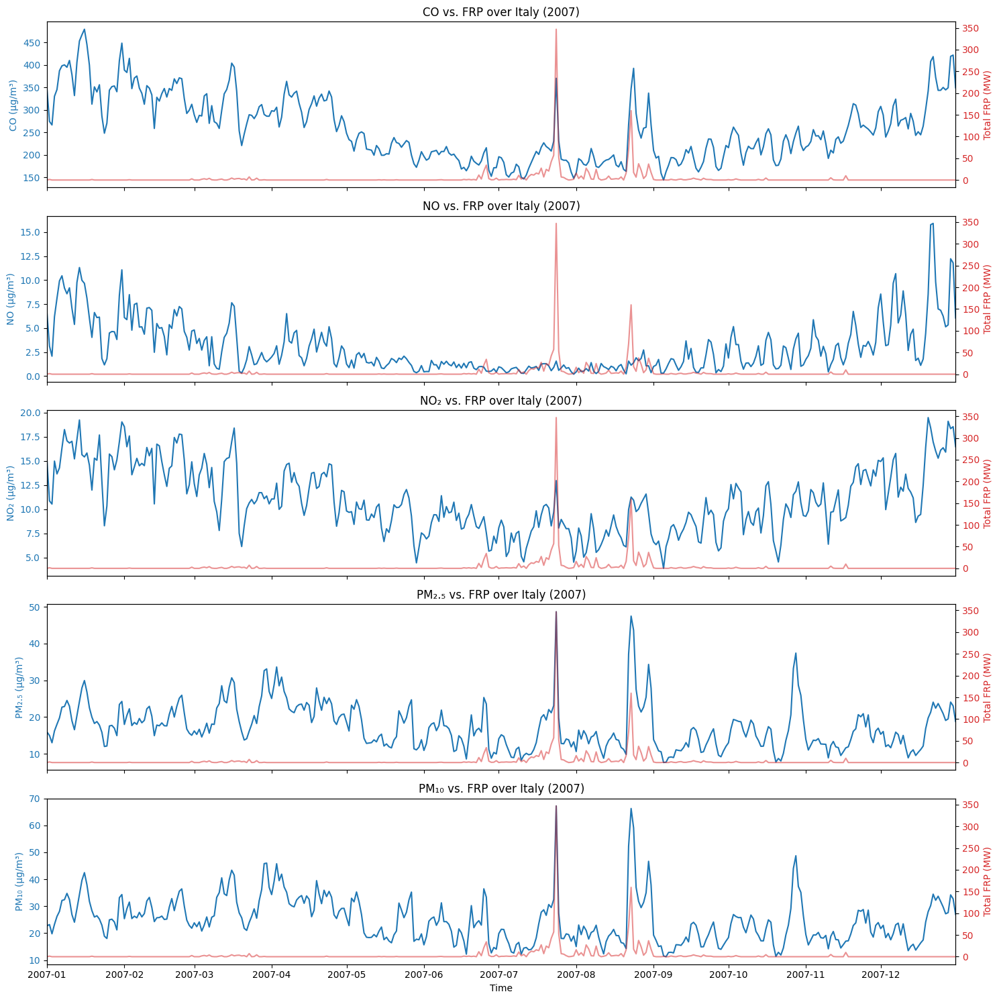

In [5]:
# Certain Year - Italy

import xarray as xr
import matplotlib.pyplot as plt
import pandas as pd

# Set this to a specific year (e.g., 2017), or to None to plot all years
selected_year = 2007

# File paths for each pollutant
files = {
    'CO':     r"D:\IPMA\Results\co_fire_meteo_Italy.nc",
    'NO':     r"D:\IPMA\Results\no_fire_meteo_Italy.nc",
    'NO₂':    r"D:\IPMA\Results\no2_fire_meteo_Italy.nc",
    'PM₂.₅':  r"D:\IPMA\Results\pm2p5_fire_meteo_Italy.nc",
    'PM₁₀':   r"D:\IPMA\Results\pm10_fire_meteo_Italy.nc"
}

# Units for each pollutant
pollutant_units = {
    'CO': 'µg/m³',
    'NO': 'µg/m³',
    'NO₂': 'µg/m³',
    'PM₂.₅': 'µg/m³',
    'PM₁₀': 'µg/m³'
}

# Set up figure
fig, axs = plt.subplots(len(files), 1, figsize=(15, 3 * len(files)), sharex=True)

for ax, (pollutant_name, file_path) in zip(axs, files.items()):
    # Load dataset
    ds = xr.open_dataset(file_path)

    # Subset by year if specified
    if selected_year is not None:
        # Ensure time is datetime64
        ds['time'] = pd.to_datetime(ds['time'].values)
        ds = ds.sel(time=ds['time'].dt.year == selected_year)

    # Extract time and limits
    time = ds.time
    if len(time) == 0:
        ax.set_title(f'{pollutant_name} vs. FRP – No data for year {selected_year}')
        continue

    tmin = time.min().values
    tmax = time.max().values

    # Spatial average of pollutant concentration
    pollutant = ds['Mean'].mean(dim=['latitude', 'longitude'])

    # Convert CO mg/m³ → µg/m³
    if pollutant_name == 'CO':
        pollutant = pollutant * 1000

    # Daily total FRP over Italy
    frp = ds['frp_sum_Italy'].mean(dim=['latitude', 'longitude'])

    # Get units
    unit = pollutant_units[pollutant_name]

    # Plot pollutant mean
    ax.plot(time, pollutant, label=f'{pollutant_name} Mean ({unit})', color='tab:blue')
    ax.set_ylabel(f'{pollutant_name} ({unit})', color='tab:blue')
    ax.tick_params(axis='y', labelcolor='tab:blue')
    ax.grid(False)

    # Plot FRP on twin y-axis
    ax2 = ax.twinx()
    ax2.plot(time, frp, label='FRP (MW)', color='tab:red', alpha=0.5)
    ax2.set_ylabel('Total FRP (MW)', color='tab:red')
    ax2.tick_params(axis='y', labelcolor='tab:red')

    # Set x-axis limits to match time range
    ax.set_xlim([tmin, tmax])

    # Title
    title = f'{pollutant_name} vs. FRP over Italy'
    if selected_year is not None:
        title += f' ({selected_year})'
    ax.set_title(title)

# Global X label
axs[-1].set_xlabel('Time')
plt.tight_layout()
plt.show()


### Spain

#### All Years

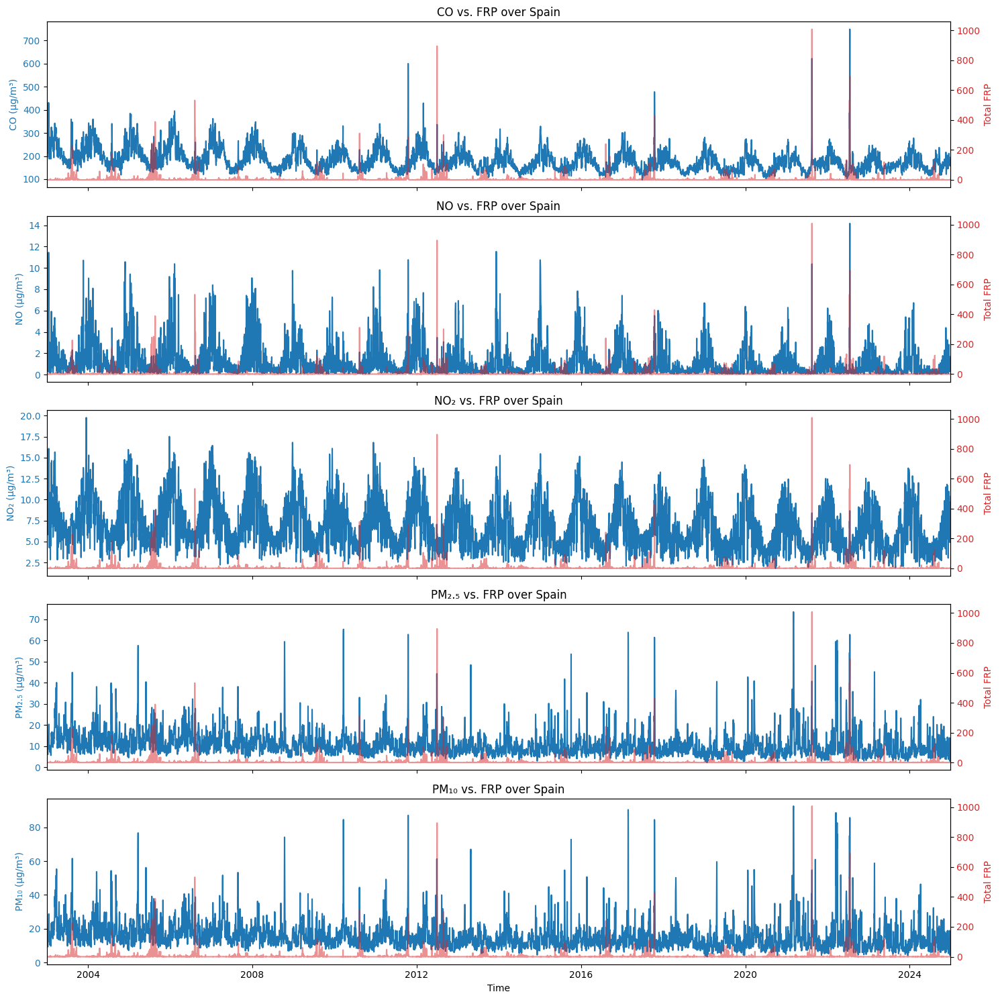

In [6]:
# All Years - Spain

import xarray as xr
import matplotlib.pyplot as plt

# File paths for each pollutant
files = {
    'CO':     r"D:\IPMA\Results\co_fire_meteo_Spain.nc",
    'NO':     r"D:\IPMA\Results\no_fire_meteo_Spain.nc",
    'NO₂':    r"D:\IPMA\Results\no2_fire_meteo_Spain.nc",
    'PM₂.₅':  r"D:\IPMA\Results\pm2p5_fire_meteo_Spain.nc",
    'PM₁₀':   r"D:\IPMA\Results\pm10_fire_meteo_Spain.nc"
}

# Correct units for plotting
units = {
    'CO': 'µg/m³',
    'NO': 'µg/m³',
    'NO₂': 'µg/m³',
    'PM₂.₅': 'µg/m³',
    'PM₁₀': 'µg/m³'
}

# Set up figure
fig, axs = plt.subplots(len(files), 1, figsize=(15, 3 * len(files)), sharex=True)

for ax, (pollutant_name, file_path) in zip(axs, files.items()):
    # Load dataset
    ds = xr.open_dataset(file_path)

    # Extract time range
    time = ds.time
    tmin = time.min().values
    tmax = time.max().values

    # Spatial average of pollutant concentration
    pollutant = ds['Mean'].mean(dim=['latitude', 'longitude'])

    # Convert CO mg/m³ → µg/m³
    if pollutant_name == 'CO':
        pollutant = pollutant * 1000

    # Daily total FRP over Spain
    frp = ds['frp_sum_Spain'].mean(dim=['latitude', 'longitude'])

    # Plot pollutant mean
    ax.plot(time, pollutant, label=f'{pollutant_name} Mean ({units[pollutant_name]})', color='tab:blue')
    ax.set_ylabel(f'{pollutant_name} ({units[pollutant_name]})', color='tab:blue')
    ax.tick_params(axis='y', labelcolor='tab:blue')
    ax.grid(False)

    # Plot FRP on twin y-axis
    ax2 = ax.twinx()
    ax2.plot(time, frp, label='FRP (MW)', color='tab:red', alpha=0.5)
    ax2.set_ylabel('Total FRP', color='tab:red')
    ax2.tick_params(axis='y', labelcolor='tab:red')

    # Set x-axis limits
    ax.set_xlim([tmin, tmax])

    # Title
    ax.set_title(f'{pollutant_name} vs. FRP over Spain')

# Global X label
axs[-1].set_xlabel('Time')
plt.tight_layout()
plt.show()


#### Certain Year

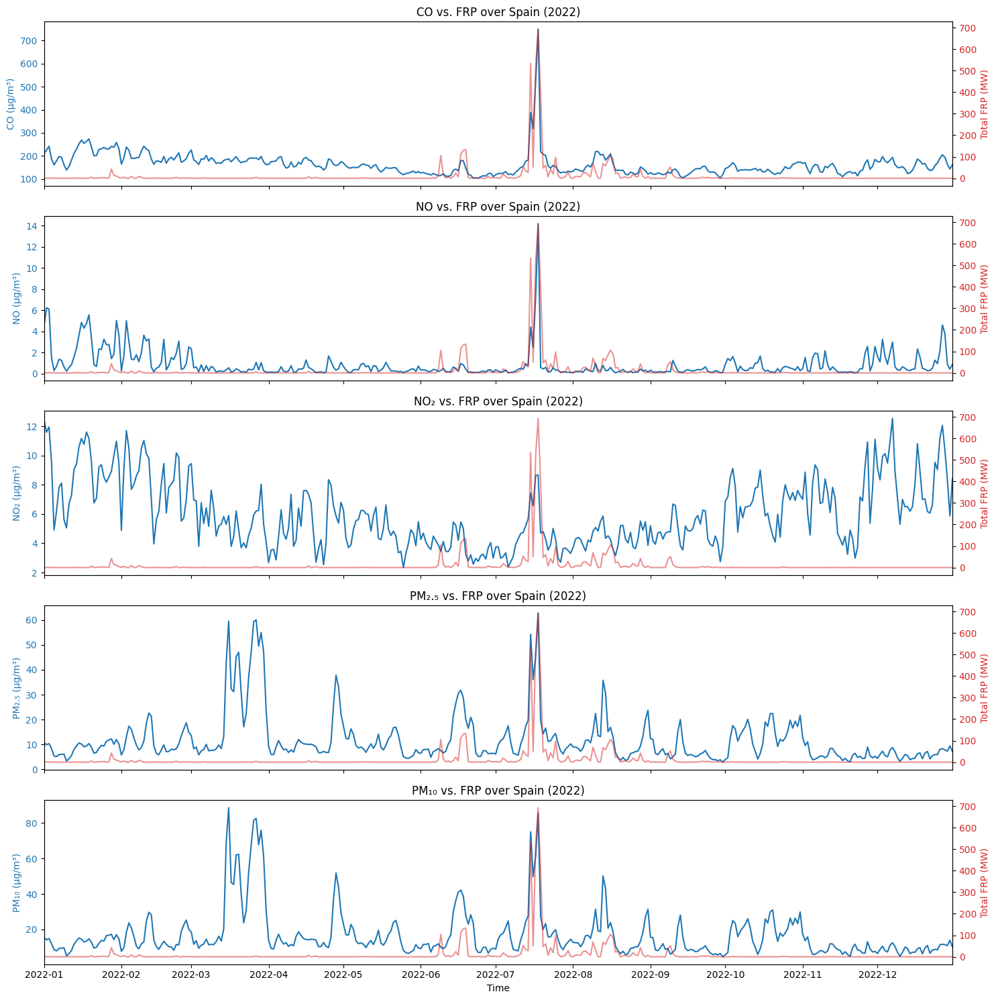

In [7]:
# Certain Year - Spain

import xarray as xr
import matplotlib.pyplot as plt
import pandas as pd

# Set this to a specific year (e.g., 2017), or to None to plot all years
selected_year = 2022

# File paths for each pollutant
files = {
    'CO':     r"D:\IPMA\Results\co_fire_meteo_Spain.nc",
    'NO':     r"D:\IPMA\Results\no_fire_meteo_Spain.nc",
    'NO₂':    r"D:\IPMA\Results\no2_fire_meteo_Spain.nc",
    'PM₂.₅':  r"D:\IPMA\Results\pm2p5_fire_meteo_Spain.nc",
    'PM₁₀':   r"D:\IPMA\Results\pm10_fire_meteo_Spain.nc"
}

# Units for each pollutant
pollutant_units = {
    'CO': 'µg/m³',
    'NO': 'µg/m³',
    'NO₂': 'µg/m³',
    'PM₂.₅': 'µg/m³',
    'PM₁₀': 'µg/m³'
}

# Set up figure
fig, axs = plt.subplots(len(files), 1, figsize=(15, 3 * len(files)), sharex=True)

for ax, (pollutant_name, file_path) in zip(axs, files.items()):
    # Load dataset
    ds = xr.open_dataset(file_path)

    # Subset by year if specified
    if selected_year is not None:
        # Ensure time is datetime64
        ds['time'] = pd.to_datetime(ds['time'].values)
        ds = ds.sel(time=ds['time'].dt.year == selected_year)

    # Extract time and limits
    time = ds.time
    if len(time) == 0:
        ax.set_title(f'{pollutant_name} vs. FRP – No data for year {selected_year}')
        continue

    tmin = time.min().values
    tmax = time.max().values

    # Spatial average of pollutant concentration
    pollutant = ds['Mean'].mean(dim=['latitude', 'longitude'])

    # Convert CO mg/m³ → µg/m³
    if pollutant_name == 'CO':
        pollutant = pollutant * 1000

    # Daily total FRP over Spain
    frp = ds['frp_sum_Spain'].mean(dim=['latitude', 'longitude'])

    # Get units
    unit = pollutant_units[pollutant_name]

    # Plot pollutant mean
    ax.plot(time, pollutant, label=f'{pollutant_name} Mean ({unit})', color='tab:blue')
    ax.set_ylabel(f'{pollutant_name} ({unit})', color='tab:blue')
    ax.tick_params(axis='y', labelcolor='tab:blue')
    ax.grid(False)

    # Plot FRP on twin y-axis
    ax2 = ax.twinx()
    ax2.plot(time, frp, label='FRP (MW)', color='tab:red', alpha=0.5)
    ax2.set_ylabel('Total FRP (MW)', color='tab:red')
    ax2.tick_params(axis='y', labelcolor='tab:red')

    # Set x-axis limits to match time range
    ax.set_xlim([tmin, tmax])

    # Title
    title = f'{pollutant_name} vs. FRP over Spain'
    if selected_year is not None:
        title += f' ({selected_year})'
    ax.set_title(title)

# Global X label
axs[-1].set_xlabel('Time')
plt.tight_layout()
plt.show()


### Greece

#### All Years

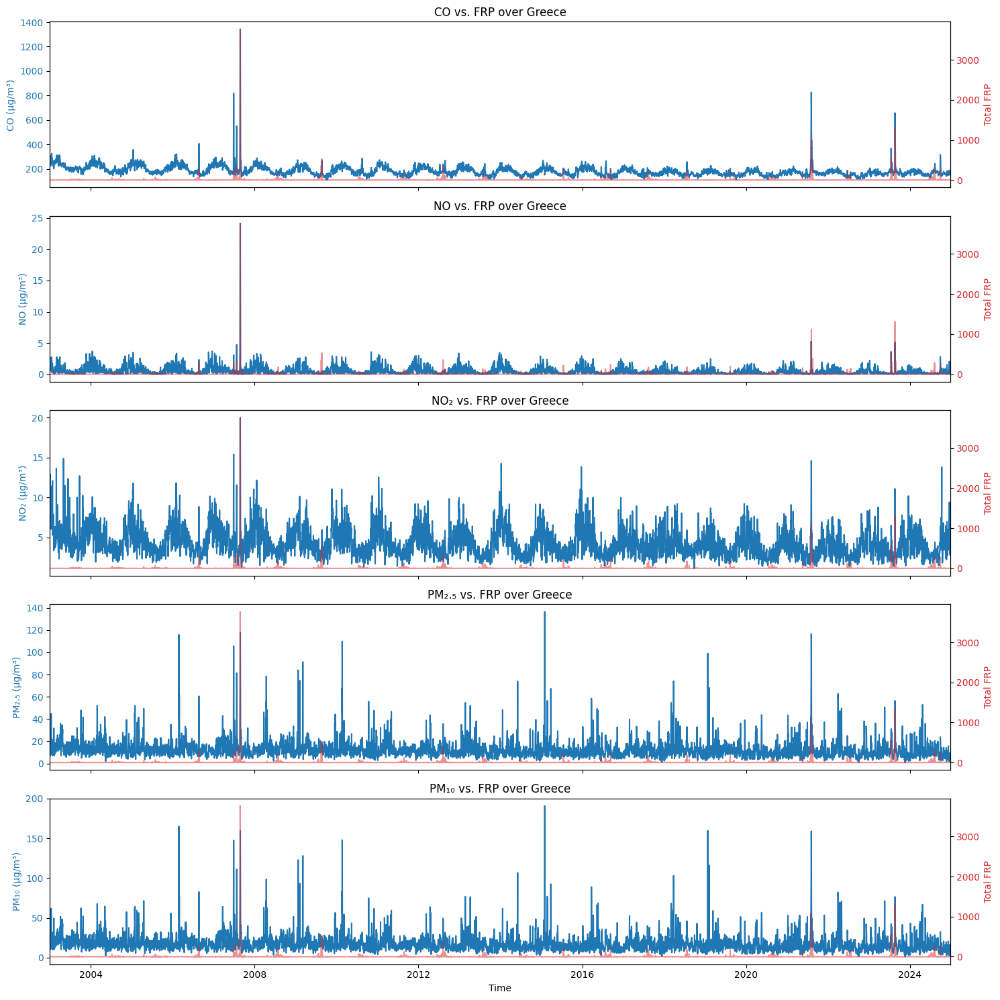

In [8]:
# All Years - Greece

import xarray as xr
import matplotlib.pyplot as plt

# File paths for each pollutant
files = {
    'CO':     r"D:\IPMA\Results\co_fire_meteo_Greece.nc",
    'NO':     r"D:\IPMA\Results\no_fire_meteo_Greece.nc",
    'NO₂':    r"D:\IPMA\Results\no2_fire_meteo_Greece.nc",
    'PM₂.₅':  r"D:\IPMA\Results\pm2p5_fire_meteo_Greece.nc",
    'PM₁₀':   r"D:\IPMA\Results\pm10_fire_meteo_Greece.nc"
}

# Correct units for plotting
units = {
    'CO': 'µg/m³',
    'NO': 'µg/m³',
    'NO₂': 'µg/m³',
    'PM₂.₅': 'µg/m³',
    'PM₁₀': 'µg/m³'
}

# Set up figure
fig, axs = plt.subplots(len(files), 1, figsize=(15, 3 * len(files)), sharex=True)

for ax, (pollutant_name, file_path) in zip(axs, files.items()):
    # Load dataset
    ds = xr.open_dataset(file_path)

    # Extract time range
    time = ds.time
    tmin = time.min().values
    tmax = time.max().values

    # Spatial average of pollutant concentration
    pollutant = ds['Mean'].mean(dim=['latitude', 'longitude'])

    # Convert CO mg/m³ → µg/m³
    if pollutant_name == 'CO':
        pollutant = pollutant * 1000

    # Daily total FRP over Greece
    frp = ds['frp_sum_Greece'].mean(dim=['latitude', 'longitude'])

    # Plot pollutant mean
    ax.plot(time, pollutant, label=f'{pollutant_name} Mean ({units[pollutant_name]})', color='tab:blue')
    ax.set_ylabel(f'{pollutant_name} ({units[pollutant_name]})', color='tab:blue')
    ax.tick_params(axis='y', labelcolor='tab:blue')
    ax.grid(False)

    # Plot FRP on twin y-axis
    ax2 = ax.twinx()
    ax2.plot(time, frp, label='FRP (MW)', color='tab:red', alpha=0.5)
    ax2.set_ylabel('Total FRP', color='tab:red')
    ax2.tick_params(axis='y', labelcolor='tab:red')

    # Set x-axis limits
    ax.set_xlim([tmin, tmax])

    # Title
    ax.set_title(f'{pollutant_name} vs. FRP over Greece')

# Global X label
axs[-1].set_xlabel('Time')
plt.tight_layout()
plt.show()


#### Certain Year

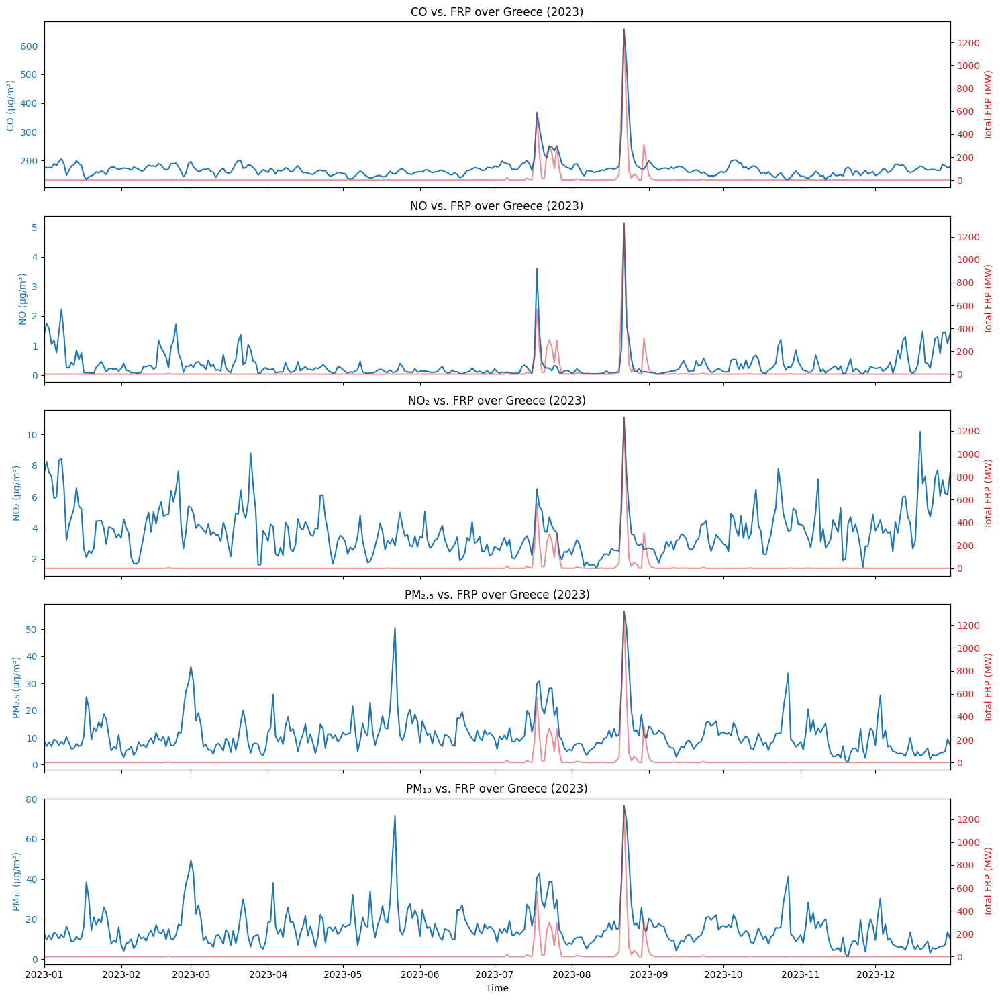

In [9]:
# Certain Year - Greece

import xarray as xr
import matplotlib.pyplot as plt
import pandas as pd

# Set this to a specific year (e.g., 2017), or to None to plot all years
selected_year = 2023

# File paths for each pollutant
files = {
    'CO':     r"D:\IPMA\Results\co_fire_meteo_Greece.nc",
    'NO':     r"D:\IPMA\Results\no_fire_meteo_Greece.nc",
    'NO₂':    r"D:\IPMA\Results\no2_fire_meteo_Greece.nc",
    'PM₂.₅':  r"D:\IPMA\Results\pm2p5_fire_meteo_Greece.nc",
    'PM₁₀':   r"D:\IPMA\Results\pm10_fire_meteo_Greece.nc"
}

# Units for each pollutant
pollutant_units = {
    'CO': 'µg/m³',
    'NO': 'µg/m³',
    'NO₂': 'µg/m³',
    'PM₂.₅': 'µg/m³',
    'PM₁₀': 'µg/m³'
}

# Set up figure
fig, axs = plt.subplots(len(files), 1, figsize=(15, 3 * len(files)), sharex=True)

for ax, (pollutant_name, file_path) in zip(axs, files.items()):
    # Load dataset
    ds = xr.open_dataset(file_path)

    # Subset by year if specified
    if selected_year is not None:
        # Ensure time is datetime64
        ds['time'] = pd.to_datetime(ds['time'].values)
        ds = ds.sel(time=ds['time'].dt.year == selected_year)

    # Extract time and limits
    time = ds.time
    if len(time) == 0:
        ax.set_title(f'{pollutant_name} vs. FRP – No data for year {selected_year}')
        continue

    tmin = time.min().values
    tmax = time.max().values

    # Spatial average of pollutant concentration
    pollutant = ds['Mean'].mean(dim=['latitude', 'longitude'])

    # Convert CO mg/m³ → µg/m³
    if pollutant_name == 'CO':
        pollutant = pollutant * 1000

    # Daily total FRP over Greece
    frp = ds['frp_sum_Greece'].mean(dim=['latitude', 'longitude'])

    # Get units
    unit = pollutant_units[pollutant_name]

    # Plot pollutant mean
    ax.plot(time, pollutant, label=f'{pollutant_name} Mean ({unit})', color='tab:blue')
    ax.set_ylabel(f'{pollutant_name} ({unit})', color='tab:blue')
    ax.tick_params(axis='y', labelcolor='tab:blue')
    ax.grid(False)

    # Plot FRP on twin y-axis
    ax2 = ax.twinx()
    ax2.plot(time, frp, label='FRP (MW)', color='tab:red', alpha=0.5)
    ax2.set_ylabel('Total FRP (MW)', color='tab:red')
    ax2.tick_params(axis='y', labelcolor='tab:red')

    # Set x-axis limits to match time range
    ax.set_xlim([tmin, tmax])

    # Title
    title = f'{pollutant_name} vs. FRP over Greece'
    if selected_year is not None:
        title += f' ({selected_year})'
    ax.set_title(title)

# Global X label
axs[-1].set_xlabel('Time')
plt.tight_layout()
plt.show()


### Iberia

#### All Years

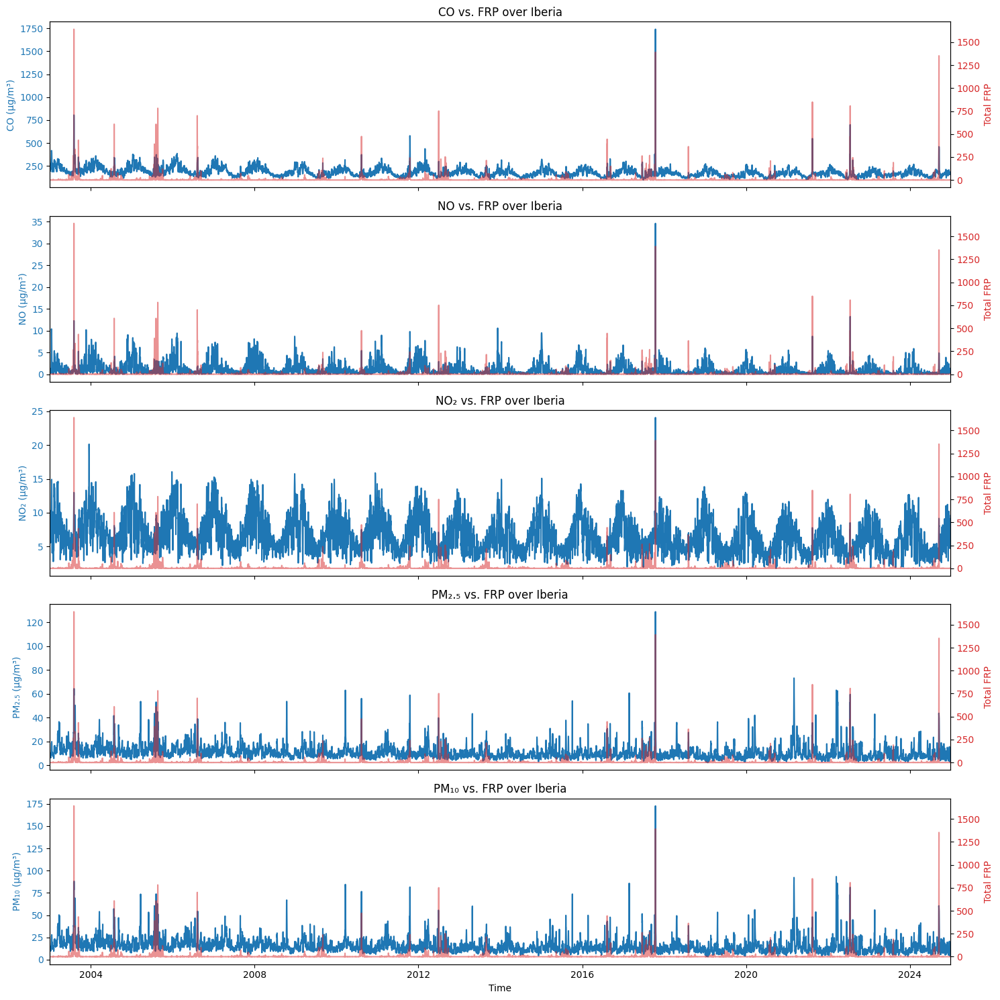

In [10]:
# All Years - Iberia

import xarray as xr
import matplotlib.pyplot as plt

# File paths for each pollutant
files = {
    'CO':     r"D:\IPMA\Results\co_fire_meteo_Iberia.nc",
    'NO':     r"D:\IPMA\Results\no_fire_meteo_Iberia.nc",
    'NO₂':    r"D:\IPMA\Results\no2_fire_meteo_Iberia.nc",
    'PM₂.₅':  r"D:\IPMA\Results\pm2p5_fire_meteo_Iberia.nc",
    'PM₁₀':   r"D:\IPMA\Results\pm10_fire_meteo_Iberia.nc"
}

# Correct units for plotting (CO now in µg/m³)
units = {
    'CO': 'µg/m³',
    'NO': 'µg/m³',
    'NO₂': 'µg/m³',
    'PM₂.₅': 'µg/m³',
    'PM₁₀': 'µg/m³'
}

# Set up figure
fig, axs = plt.subplots(len(files), 1, figsize=(15, 3 * len(files)), sharex=True)

for ax, (pollutant_name, file_path) in zip(axs, files.items()):
    # Load dataset
    ds = xr.open_dataset(file_path)

    # Extract time range
    time = ds.time
    tmin = time.min().values
    tmax = time.max().values

    # Spatial average of pollutant concentration
    pollutant = ds['Mean'].mean(dim=['latitude', 'longitude'])

    # Convert CO mg/m³ → µg/m³
    if pollutant_name == 'CO':
        pollutant = pollutant * 1000

    # Daily total FRP over Iberia
    frp = ds['frp_sum_Iberia'].mean(dim=['latitude', 'longitude'])

    # Plot pollutant mean
    ax.plot(time, pollutant, label=f'{pollutant_name} Mean ({units[pollutant_name]})', color='tab:blue')
    ax.set_ylabel(f'{pollutant_name} ({units[pollutant_name]})', color='tab:blue')
    ax.tick_params(axis='y', labelcolor='tab:blue')
    ax.grid(False)

    # Plot FRP on twin y-axis
    ax2 = ax.twinx()
    ax2.plot(time, frp, label='FRP (MW)', color='tab:red', alpha=0.5)
    ax2.set_ylabel('Total FRP', color='tab:red')
    ax2.tick_params(axis='y', labelcolor='tab:red')

    # Set x-axis limits
    ax.set_xlim([tmin, tmax])

    # Title
    ax.set_title(f'{pollutant_name} vs. FRP over Iberia')

# Global X label
axs[-1].set_xlabel('Time')
plt.tight_layout()
plt.show()


#### Certain Year

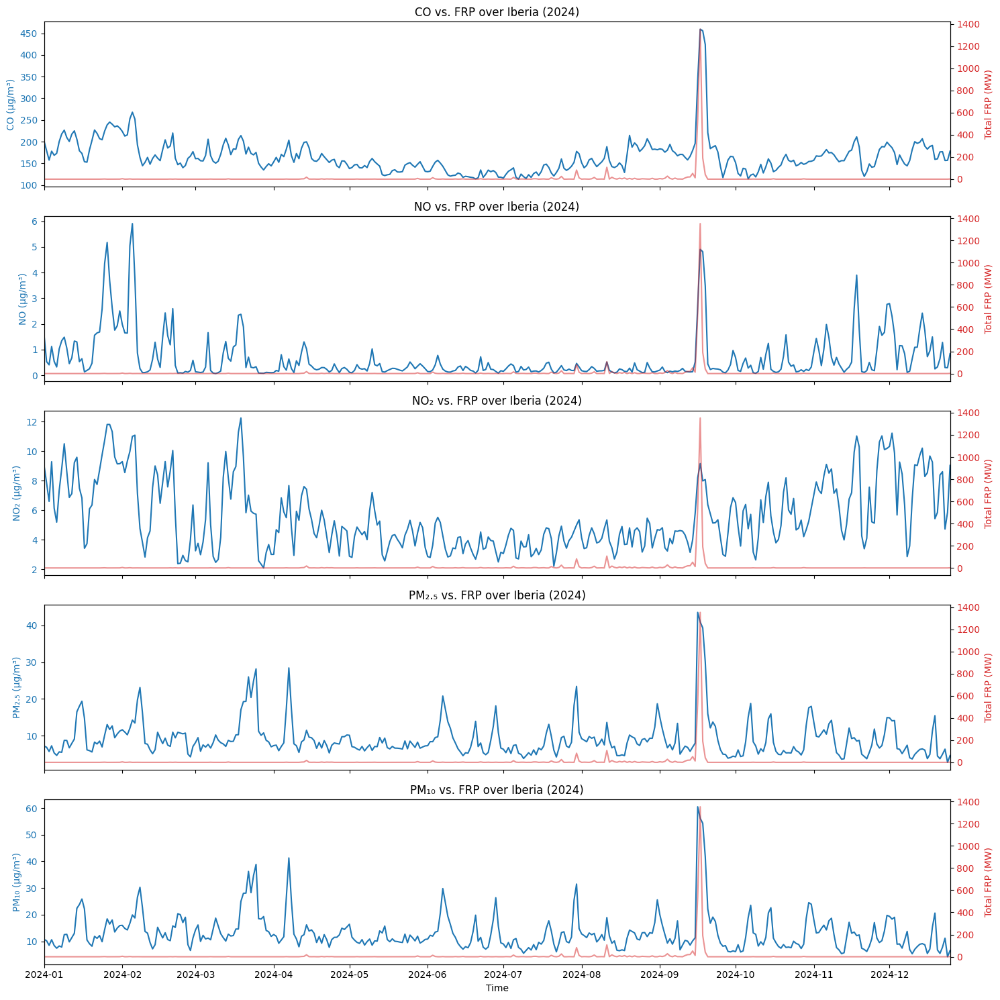

In [11]:
# Certain Year - Iberia

import xarray as xr
import matplotlib.pyplot as plt
import pandas as pd

# Set this to a specific year (e.g., 2017), or to None to plot all years
selected_year = 2024

# File paths for each pollutant
files = {
    'CO':     r"D:\IPMA\Results\co_fire_meteo_Iberia.nc",
    'NO':     r"D:\IPMA\Results\no_fire_meteo_Iberia.nc",
    'NO₂':    r"D:\IPMA\Results\no2_fire_meteo_Iberia.nc",
    'PM₂.₅':  r"D:\IPMA\Results\pm2p5_fire_meteo_Iberia.nc",
    'PM₁₀':   r"D:\IPMA\Results\pm10_fire_meteo_Iberia.nc"
}

# Units for each pollutant (CO now in µg/m³)
pollutant_units = {
    'CO': 'µg/m³',
    'NO': 'µg/m³',
    'NO₂': 'µg/m³',
    'PM₂.₅': 'µg/m³',
    'PM₁₀': 'µg/m³'
}

# Set up figure
fig, axs = plt.subplots(len(files), 1, figsize=(15, 3 * len(files)), sharex=True)

for ax, (pollutant_name, file_path) in zip(axs, files.items()):
    # Load dataset
    ds = xr.open_dataset(file_path)

    # Subset by year if specified
    if selected_year is not None:
        # Ensure time is datetime64
        ds['time'] = pd.to_datetime(ds['time'].values)
        ds = ds.sel(time=ds['time'].dt.year == selected_year)

    # Extract time and limits
    time = ds.time
    if len(time) == 0:
        ax.set_title(f'{pollutant_name} vs. FRP – No data for year {selected_year}')
        continue

    tmin = time.min().values
    tmax = time.max().values

    # Spatial average of pollutant concentration
    pollutant = ds['Mean'].mean(dim=['latitude', 'longitude'])

    # Convert CO mg/m³ → µg/m³
    if pollutant_name == 'CO':
        pollutant = pollutant * 1000

    # Daily total FRP over Iberia
    frp = ds['frp_sum_Iberia'].mean(dim=['latitude', 'longitude'])

    # Get units
    unit = pollutant_units[pollutant_name]

    # Plot pollutant mean
    ax.plot(time, pollutant, label=f'{pollutant_name} Mean ({unit})', color='tab:blue')
    ax.set_ylabel(f'{pollutant_name} ({unit})', color='tab:blue')
    ax.tick_params(axis='y', labelcolor='tab:blue')
    ax.grid(False)

    # Plot FRP on twin y-axis
    ax2 = ax.twinx()
    ax2.plot(time, frp, label='FRP (MW)', color='tab:red', alpha=0.5)
    ax2.set_ylabel('Total FRP (MW)', color='tab:red')
    ax2.tick_params(axis='y', labelcolor='tab:red')

    # Set x-axis limits to match time range
    ax.set_xlim([tmin, tmax])

    # Title
    title = f'{pollutant_name} vs. FRP over Iberia'
    if selected_year is not None:
        title += f' ({selected_year})'
    ax.set_title(title)

# Global X label
axs[-1].set_xlabel('Time')
plt.tight_layout()
plt.show()


## Crossover of FRP (fire foci - count) and Pollutants levels in a time series template over the years or single year

### Portugal

#### All Years

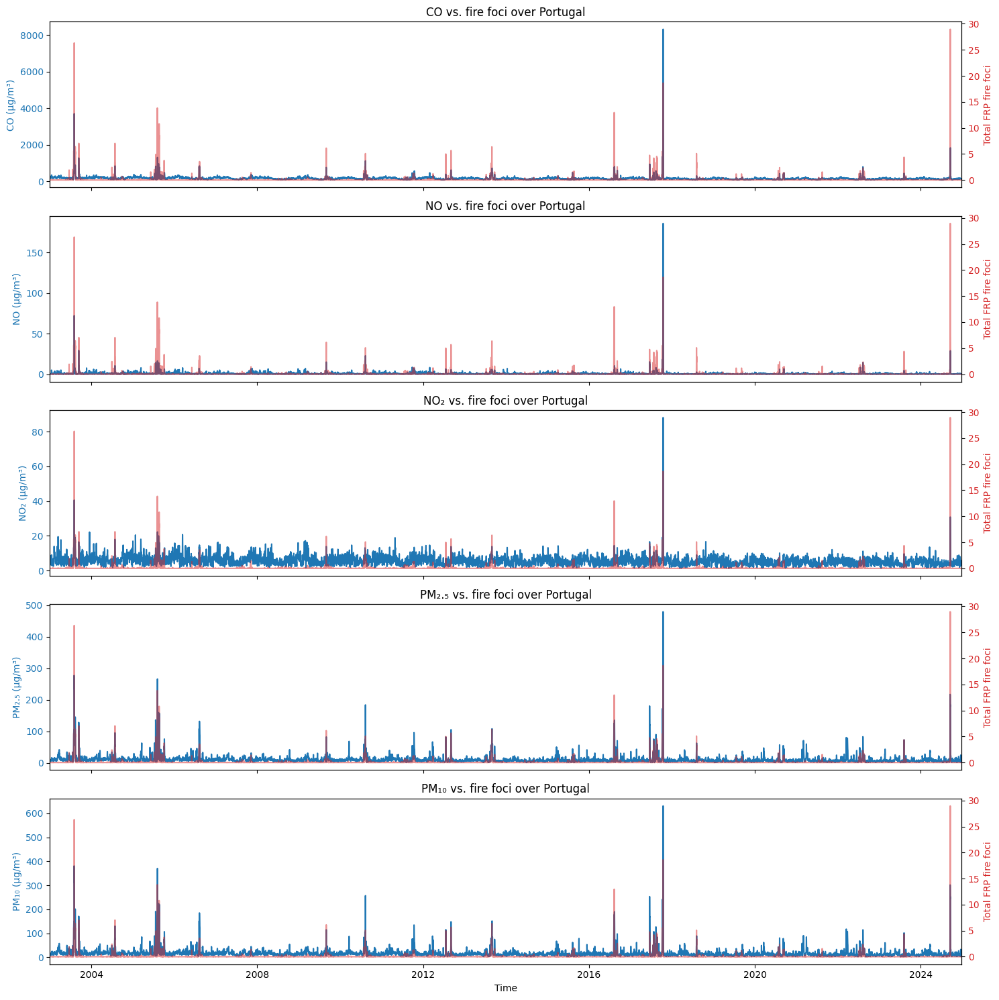

In [12]:
# All Years - Portugal

import xarray as xr
import matplotlib.pyplot as plt

# File paths for each pollutant
files = {
    'CO':     r"D:\IPMA\Results\co_fire_meteo_Portugal.nc",
    'NO':     r"D:\IPMA\Results\no_fire_meteo_Portugal.nc",
    'NO₂':    r"D:\IPMA\Results\no2_fire_meteo_Portugal.nc",
    'PM₂.₅':  r"D:\IPMA\Results\pm2p5_fire_meteo_Portugal.nc",
    'PM₁₀':   r"D:\IPMA\Results\pm10_fire_meteo_Portugal.nc"
}

# Correct units for plotting
units = {
    'CO': 'µg/m³',
    'NO': 'µg/m³',
    'NO₂': 'µg/m³',
    'PM₂.₅': 'µg/m³',
    'PM₁₀': 'µg/m³'
}

# Set up figure
fig, axs = plt.subplots(len(files), 1, figsize=(15, 3 * len(files)), sharex=True)

for ax, (pollutant_name, file_path) in zip(axs, files.items()):
    # Load dataset
    ds = xr.open_dataset(file_path)

    # Extract time range
    time = ds.time
    tmin = time.min().values
    tmax = time.max().values

    # Spatial average of pollutant concentration
    pollutant = ds['Mean'].mean(dim=['latitude', 'longitude'])

    # Convert CO mg/m³ → µg/m³
    if pollutant_name == 'CO':
        pollutant = pollutant * 1000

    # Daily total count FRP over Portugal
    frp = ds['frp_count_Portugal'].mean(dim=['latitude', 'longitude'])

    # Plot pollutant mean
    ax.plot(time, pollutant, label=f'{pollutant_name} Mean ({units[pollutant_name]})', color='tab:blue')
    ax.set_ylabel(f'{pollutant_name} ({units[pollutant_name]})', color='tab:blue')
    ax.tick_params(axis='y', labelcolor='tab:blue')
    ax.grid(False)

    # Plot FRP on twin y-axis
    ax2 = ax.twinx()
    ax2.plot(time, frp, label='FRP', color='tab:red', alpha=0.5)
    ax2.set_ylabel('Total FRP fire foci', color='tab:red')
    ax2.tick_params(axis='y', labelcolor='tab:red')

    # Set x-axis limits
    ax.set_xlim([tmin, tmax])

    # Title
    ax.set_title(f'{pollutant_name} vs. fire foci over Portugal')

# Global X label
axs[-1].set_xlabel('Time')
plt.tight_layout()
plt.show()


#### Certain Year

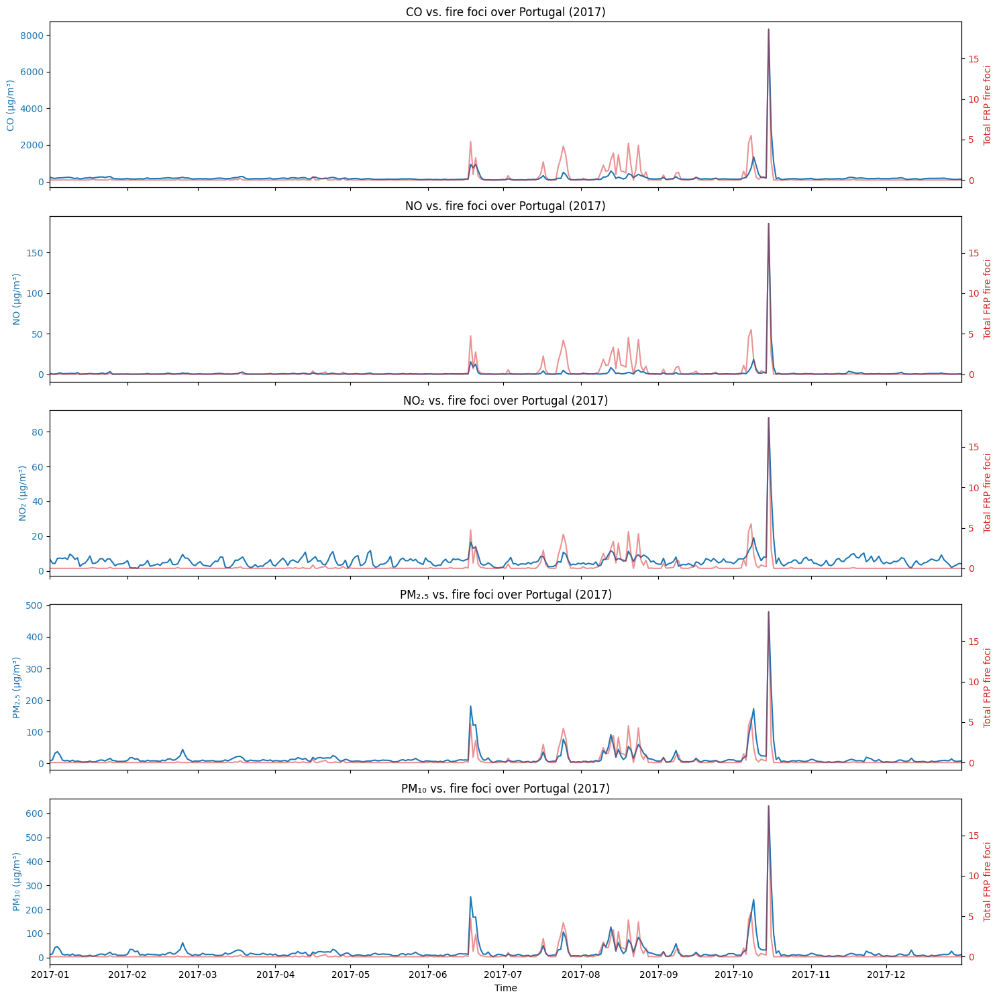

In [13]:
# Certain Year - Portugal

import xarray as xr
import matplotlib.pyplot as plt
import pandas as pd

# Set this to a specific year (e.g., 2017), or to None to plot all years
selected_year = 2017

# File paths for each pollutant
files = {
    'CO':     r"D:\IPMA\Results\co_fire_meteo_Portugal.nc",
    'NO':     r"D:\IPMA\Results\no_fire_meteo_Portugal.nc",
    'NO₂':    r"D:\IPMA\Results\no2_fire_meteo_Portugal.nc",
    'PM₂.₅':  r"D:\IPMA\Results\pm2p5_fire_meteo_Portugal.nc",
    'PM₁₀':   r"D:\IPMA\Results\pm10_fire_meteo_Portugal.nc"
}

# Units for each pollutant
pollutant_units = {
    'CO': 'µg/m³',
    'NO': 'µg/m³',
    'NO₂': 'µg/m³',
    'PM₂.₅': 'µg/m³',
    'PM₁₀': 'µg/m³'
}

# Set up figure
fig, axs = plt.subplots(len(files), 1, figsize=(15, 3 * len(files)), sharex=True)

for ax, (pollutant_name, file_path) in zip(axs, files.items()):
    # Load dataset
    ds = xr.open_dataset(file_path)

    # Subset by year if specified
    if selected_year is not None:
        # Ensure time is a datetime64
        ds['time'] = pd.to_datetime(ds['time'].values)
        ds = ds.sel(time=ds['time'].dt.year == selected_year)

    # Extract time and limits
    time = ds.time
    if len(time) == 0:
        ax.set_title(f'{pollutant_name} vs. FRP – No data for year {selected_year}')
        continue

    tmin = time.min().values
    tmax = time.max().values

    # Spatial average of pollutant concentration
    pollutant = ds['Mean'].mean(dim=['latitude', 'longitude'])

    # Convert CO mg/m³ → µg/m³
    if pollutant_name == 'CO':
        pollutant = pollutant * 1000

    # Daily total count FRP over Portugal
    frp = ds['frp_count_Portugal'].mean(dim=['latitude', 'longitude'])

    # Get units
    unit = pollutant_units[pollutant_name]

    # Plot pollutant mean
    ax.plot(time, pollutant, label=f'{pollutant_name} Mean ({unit})', color='tab:blue')
    ax.set_ylabel(f'{pollutant_name} ({unit})', color='tab:blue')
    ax.tick_params(axis='y', labelcolor='tab:blue')
    ax.grid(False)

    # Plot FRP on twin y-axis
    ax2 = ax.twinx()
    ax2.plot(time, frp, label='FRP', color='tab:red', alpha=0.5)
    ax2.set_ylabel('Total FRP fire foci', color='tab:red')
    ax2.tick_params(axis='y', labelcolor='tab:red')

    # Set x-axis limits to match time range
    ax.set_xlim([tmin, tmax])

    # Title
    title = f'{pollutant_name} vs. fire foci over Portugal'
    if selected_year is not None:
        title += f' ({selected_year})'
    ax.set_title(title)

# Global X label
axs[-1].set_xlabel('Time')
plt.tight_layout()
plt.show()


### Italy

#### All Years

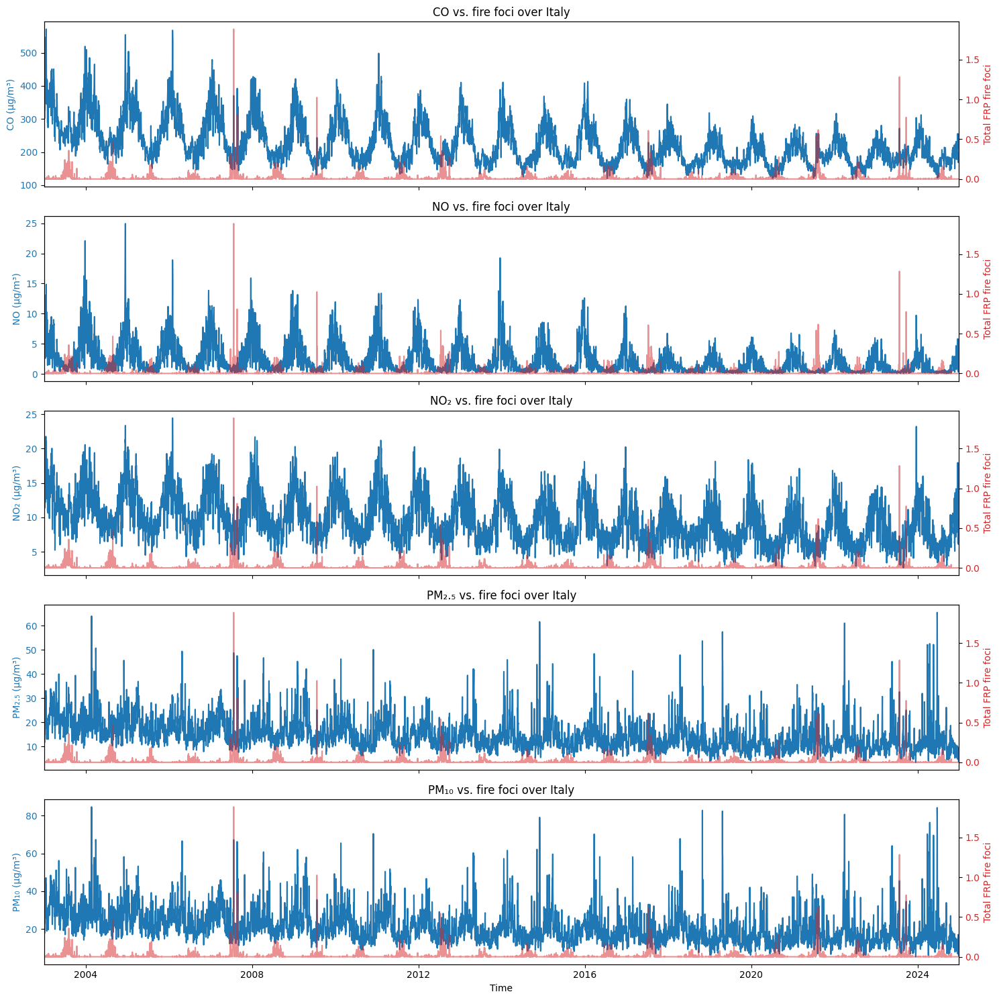

In [14]:
# All Years - Italy

import xarray as xr
import matplotlib.pyplot as plt

# File paths for each pollutant
files = {
    'CO':     r"D:\IPMA\Results\co_fire_meteo_Italy.nc",
    'NO':     r"D:\IPMA\Results\no_fire_meteo_Italy.nc",
    'NO₂':    r"D:\IPMA\Results\no2_fire_meteo_Italy.nc",
    'PM₂.₅':  r"D:\IPMA\Results\pm2p5_fire_meteo_Italy.nc",
    'PM₁₀':   r"D:\IPMA\Results\pm10_fire_meteo_Italy.nc"
}

# Correct units for plotting
units = {
    'CO': 'µg/m³',
    'NO': 'µg/m³',
    'NO₂': 'µg/m³',
    'PM₂.₅': 'µg/m³',
    'PM₁₀': 'µg/m³'
}

# Set up figure
fig, axs = plt.subplots(len(files), 1, figsize=(15, 3 * len(files)), sharex=True)

for ax, (pollutant_name, file_path) in zip(axs, files.items()):
    # Load dataset
    ds = xr.open_dataset(file_path)

    # Extract time range
    time = ds.time
    tmin = time.min().values
    tmax = time.max().values

    # Spatial average of pollutant concentration
    pollutant = ds['Mean'].mean(dim=['latitude', 'longitude'])

    # Convert CO mg/m³ → µg/m³
    if pollutant_name == 'CO':
        pollutant = pollutant * 1000

    # Daily total count FRP over Italy
    frp = ds['frp_count_Italy'].mean(dim=['latitude', 'longitude'])

    # Plot pollutant mean
    ax.plot(time, pollutant, label=f'{pollutant_name} Mean ({units[pollutant_name]})', color='tab:blue')
    ax.set_ylabel(f'{pollutant_name} ({units[pollutant_name]})', color='tab:blue')
    ax.tick_params(axis='y', labelcolor='tab:blue')
    ax.grid(False)

    # Plot FRP on twin y-axis
    ax2 = ax.twinx()
    ax2.plot(time, frp, label='FRP', color='tab:red', alpha=0.5)
    ax2.set_ylabel('Total FRP fire foci', color='tab:red')
    ax2.tick_params(axis='y', labelcolor='tab:red')

    # Set x-axis limits
    ax.set_xlim([tmin, tmax])

    # Title
    ax.set_title(f'{pollutant_name} vs. fire foci over Italy')

# Global X label
axs[-1].set_xlabel('Time')
plt.tight_layout()
plt.show()


#### Certain Year

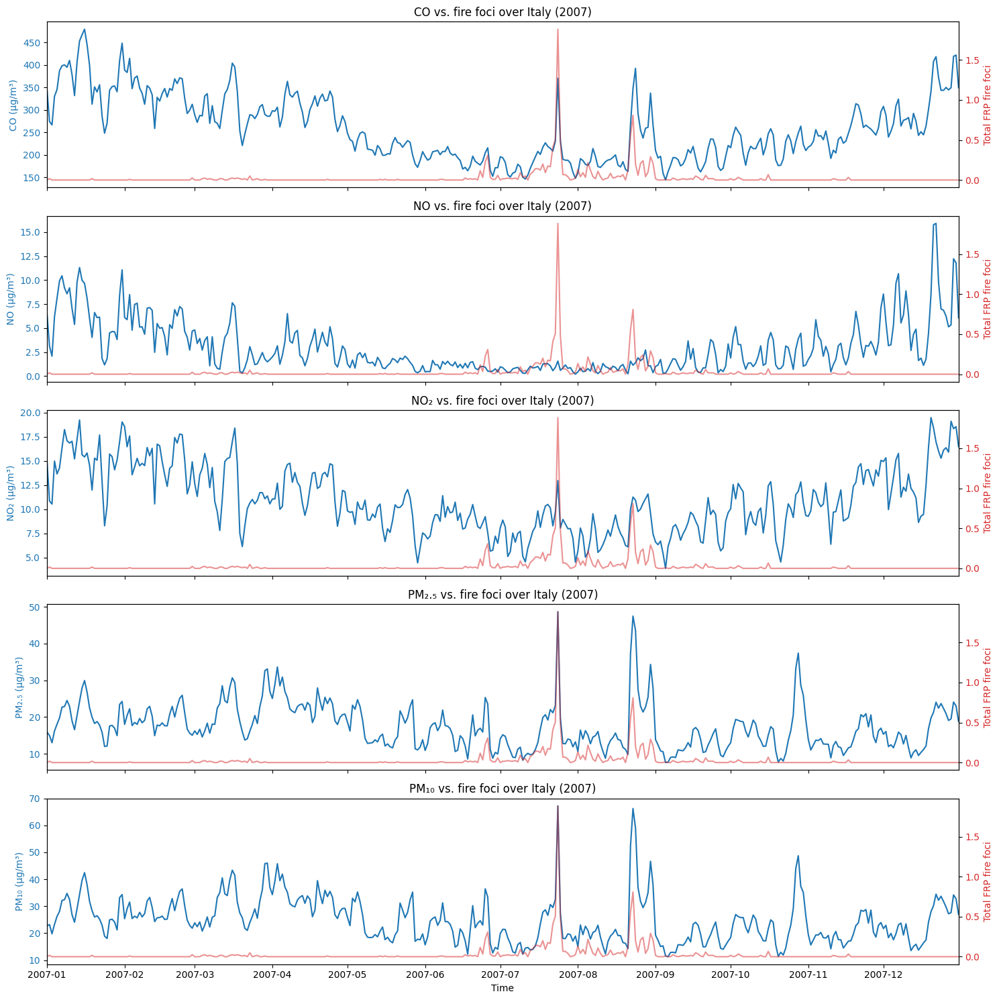

In [15]:
# Certain Year - Italy

import xarray as xr
import matplotlib.pyplot as plt
import pandas as pd

# Set this to a specific year (e.g., 2017), or to None to plot all years
selected_year = 2007

# File paths for each pollutant
files = {
    'CO':     r"D:\IPMA\Results\co_fire_meteo_Italy.nc",
    'NO':     r"D:\IPMA\Results\no_fire_meteo_Italy.nc",
    'NO₂':    r"D:\IPMA\Results\no2_fire_meteo_Italy.nc",
    'PM₂.₅':  r"D:\IPMA\Results\pm2p5_fire_meteo_Italy.nc",
    'PM₁₀':   r"D:\IPMA\Results\pm10_fire_meteo_Italy.nc"
}

# Units for each pollutant
pollutant_units = {
    'CO': 'µg/m³',
    'NO': 'µg/m³',
    'NO₂': 'µg/m³',
    'PM₂.₅': 'µg/m³',
    'PM₁₀': 'µg/m³'
}

# Set up figure
fig, axs = plt.subplots(len(files), 1, figsize=(15, 3 * len(files)), sharex=True)

for ax, (pollutant_name, file_path) in zip(axs, files.items()):
    # Load dataset
    ds = xr.open_dataset(file_path)

    # Subset by year if specified
    if selected_year is not None:
        # Ensure time is a datetime64
        ds['time'] = pd.to_datetime(ds['time'].values)
        ds = ds.sel(time=ds['time'].dt.year == selected_year)

    # Extract time and limits
    time = ds.time
    if len(time) == 0:
        ax.set_title(f'{pollutant_name} vs. FRP – No data for year {selected_year}')
        continue

    tmin = time.min().values
    tmax = time.max().values

    # Spatial average of pollutant concentration
    pollutant = ds['Mean'].mean(dim=['latitude', 'longitude'])

    # Convert CO mg/m³ → µg/m³
    if pollutant_name == 'CO':
        pollutant = pollutant * 1000    

    # Daily total count FRP over Italy
    frp = ds['frp_count_Italy'].mean(dim=['latitude', 'longitude'])

    # Get units
    unit = pollutant_units[pollutant_name]

    # Plot pollutant mean
    ax.plot(time, pollutant, label=f'{pollutant_name} Mean ({unit})', color='tab:blue')
    ax.set_ylabel(f'{pollutant_name} ({unit})', color='tab:blue')
    ax.tick_params(axis='y', labelcolor='tab:blue')
    ax.grid(False)

    # Plot FRP on twin y-axis
    ax2 = ax.twinx()
    ax2.plot(time, frp, label='FRP', color='tab:red', alpha=0.5)
    ax2.set_ylabel('Total FRP fire foci', color='tab:red')
    ax2.tick_params(axis='y', labelcolor='tab:red')

    # Set x-axis limits to match time range
    ax.set_xlim([tmin, tmax])

    # Title
    title = f'{pollutant_name} vs. fire foci over Italy'
    if selected_year is not None:
        title += f' ({selected_year})'
    ax.set_title(title)

# Global X label
axs[-1].set_xlabel('Time')
plt.tight_layout()
plt.show()


### Spain

#### All Years

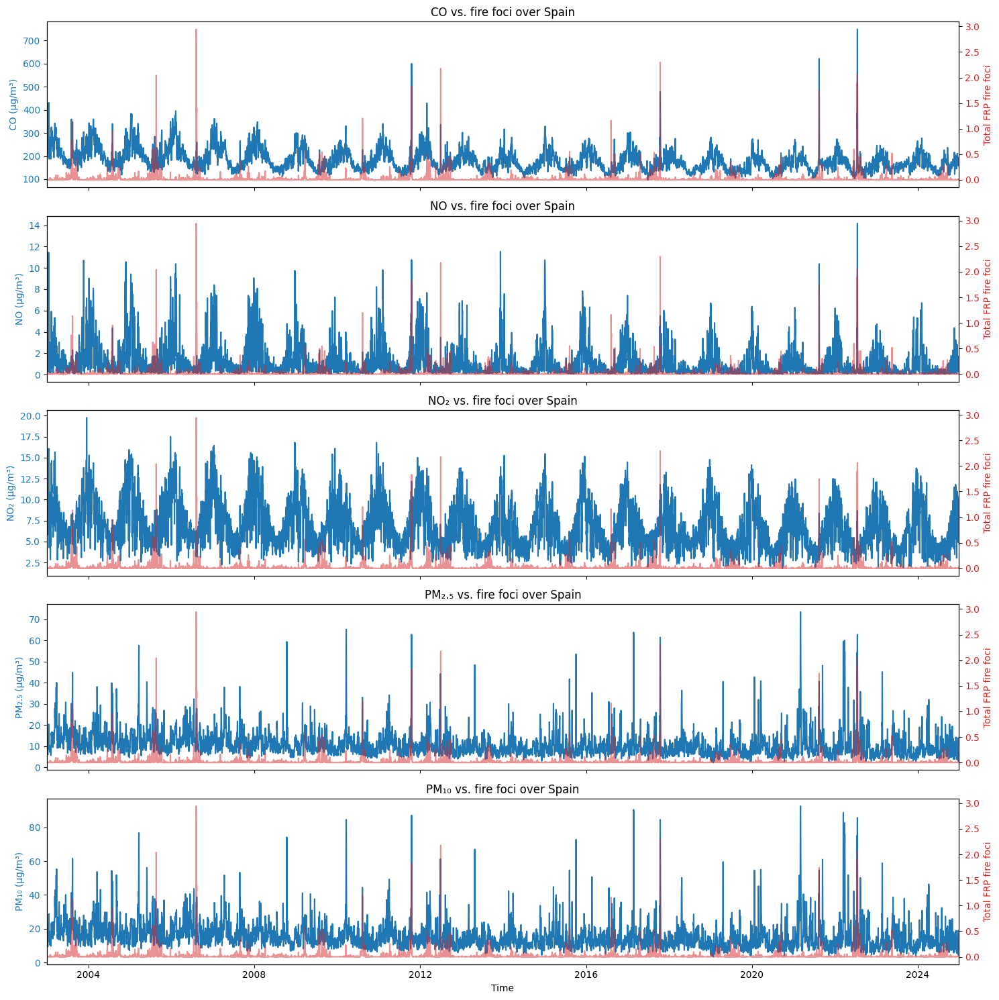

In [16]:
# All Years - Spain

import xarray as xr
import matplotlib.pyplot as plt

# File paths for each pollutant
files = {
    'CO':     r"D:\IPMA\Results\co_fire_meteo_Spain.nc",
    'NO':     r"D:\IPMA\Results\no_fire_meteo_Spain.nc",
    'NO₂':    r"D:\IPMA\Results\no2_fire_meteo_Spain.nc",
    'PM₂.₅':  r"D:\IPMA\Results\pm2p5_fire_meteo_Spain.nc",
    'PM₁₀':   r"D:\IPMA\Results\pm10_fire_meteo_Spain.nc"
}

# Correct units for plotting
units = {
    'CO': 'µg/m³',
    'NO': 'µg/m³',
    'NO₂': 'µg/m³',
    'PM₂.₅': 'µg/m³',
    'PM₁₀': 'µg/m³'
}

# Set up figure
fig, axs = plt.subplots(len(files), 1, figsize=(15, 3 * len(files)), sharex=True)

for ax, (pollutant_name, file_path) in zip(axs, files.items()):
    # Load dataset
    ds = xr.open_dataset(file_path)

    # Extract time range
    time = ds.time
    tmin = time.min().values
    tmax = time.max().values

    # Spatial average of pollutant concentration
    pollutant = ds['Mean'].mean(dim=['latitude', 'longitude'])

    # Convert CO mg/m³ → µg/m³
    if pollutant_name == 'CO':
        pollutant = pollutant * 1000

    # Daily total count FRP over Spain
    frp = ds['frp_count_Spain'].mean(dim=['latitude', 'longitude'])

    # Plot pollutant mean
    ax.plot(time, pollutant, label=f'{pollutant_name} Mean ({units[pollutant_name]})', color='tab:blue')
    ax.set_ylabel(f'{pollutant_name} ({units[pollutant_name]})', color='tab:blue')
    ax.tick_params(axis='y', labelcolor='tab:blue')
    ax.grid(False)

    # Plot FRP on twin y-axis
    ax2 = ax.twinx()
    ax2.plot(time, frp, label='FRP', color='tab:red', alpha=0.5)
    ax2.set_ylabel('Total FRP fire foci', color='tab:red')
    ax2.tick_params(axis='y', labelcolor='tab:red')

    # Set x-axis limits
    ax.set_xlim([tmin, tmax])

    # Title
    ax.set_title(f'{pollutant_name} vs. fire foci over Spain')

# Global X label
axs[-1].set_xlabel('Time')
plt.tight_layout()
plt.show()


#### Certain Year

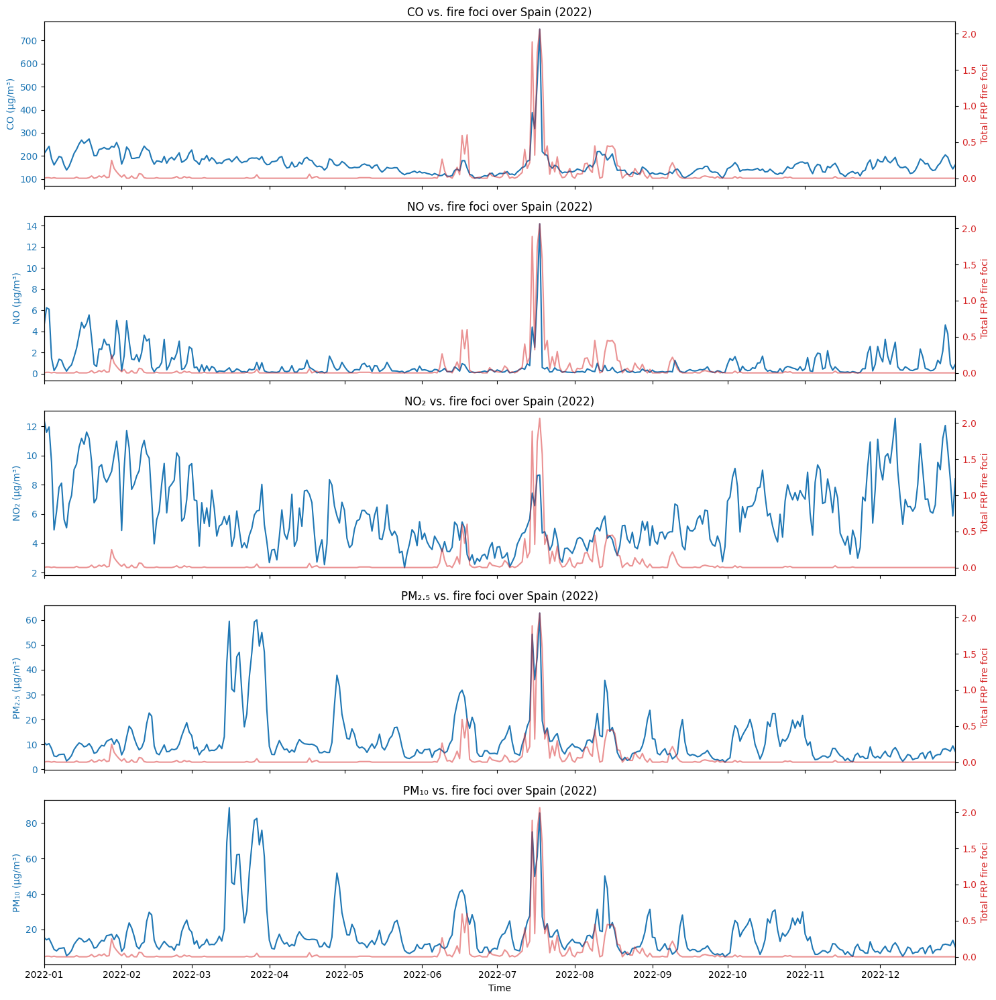

In [17]:
# Certain Year - Spain

import xarray as xr
import matplotlib.pyplot as plt
import pandas as pd

# Set this to a specific year (e.g., 2017), or to None to plot all years
selected_year = 2022

# File paths for each pollutant
files = {
    'CO':     r"D:\IPMA\Results\co_fire_meteo_Spain.nc",
    'NO':     r"D:\IPMA\Results\no_fire_meteo_Spain.nc",
    'NO₂':    r"D:\IPMA\Results\no2_fire_meteo_Spain.nc",
    'PM₂.₅':  r"D:\IPMA\Results\pm2p5_fire_meteo_Spain.nc",
    'PM₁₀':   r"D:\IPMA\Results\pm10_fire_meteo_Spain.nc"
}

# Units for each pollutant
pollutant_units = {
    'CO': 'µg/m³',
    'NO': 'µg/m³',
    'NO₂': 'µg/m³',
    'PM₂.₅': 'µg/m³',
    'PM₁₀': 'µg/m³'
}

# Set up figure
fig, axs = plt.subplots(len(files), 1, figsize=(15, 3 * len(files)), sharex=True)

for ax, (pollutant_name, file_path) in zip(axs, files.items()):
    # Load dataset
    ds = xr.open_dataset(file_path)

    # Subset by year if specified
    if selected_year is not None:
        # Ensure time is a datetime64
        ds['time'] = pd.to_datetime(ds['time'].values)
        ds = ds.sel(time=ds['time'].dt.year == selected_year)

    # Extract time and limits
    time = ds.time
    if len(time) == 0:
        ax.set_title(f'{pollutant_name} vs. FRP – No data for year {selected_year}')
        continue

    tmin = time.min().values
    tmax = time.max().values

    # Spatial average of pollutant concentration
    pollutant = ds['Mean'].mean(dim=['latitude', 'longitude'])

    # Convert CO mg/m³ → µg/m³
    if pollutant_name == 'CO':
        pollutant = pollutant * 1000

    # Daily total count FRP over Spain
    frp = ds['frp_count_Spain'].mean(dim=['latitude', 'longitude'])

    # Get units
    unit = pollutant_units[pollutant_name]

    # Plot pollutant mean
    ax.plot(time, pollutant, label=f'{pollutant_name} Mean ({unit})', color='tab:blue')
    ax.set_ylabel(f'{pollutant_name} ({unit})', color='tab:blue')
    ax.tick_params(axis='y', labelcolor='tab:blue')
    ax.grid(False)

    # Plot FRP on twin y-axis
    ax2 = ax.twinx()
    ax2.plot(time, frp, label='FRP', color='tab:red', alpha=0.5)
    ax2.set_ylabel('Total FRP fire foci', color='tab:red')
    ax2.tick_params(axis='y', labelcolor='tab:red')

    # Set x-axis limits to match time range
    ax.set_xlim([tmin, tmax])

    # Title
    title = f'{pollutant_name} vs. fire foci over Spain'
    if selected_year is not None:
        title += f' ({selected_year})'
    ax.set_title(title)

# Global X label
axs[-1].set_xlabel('Time')
plt.tight_layout()
plt.show()


### Greece

#### All Years

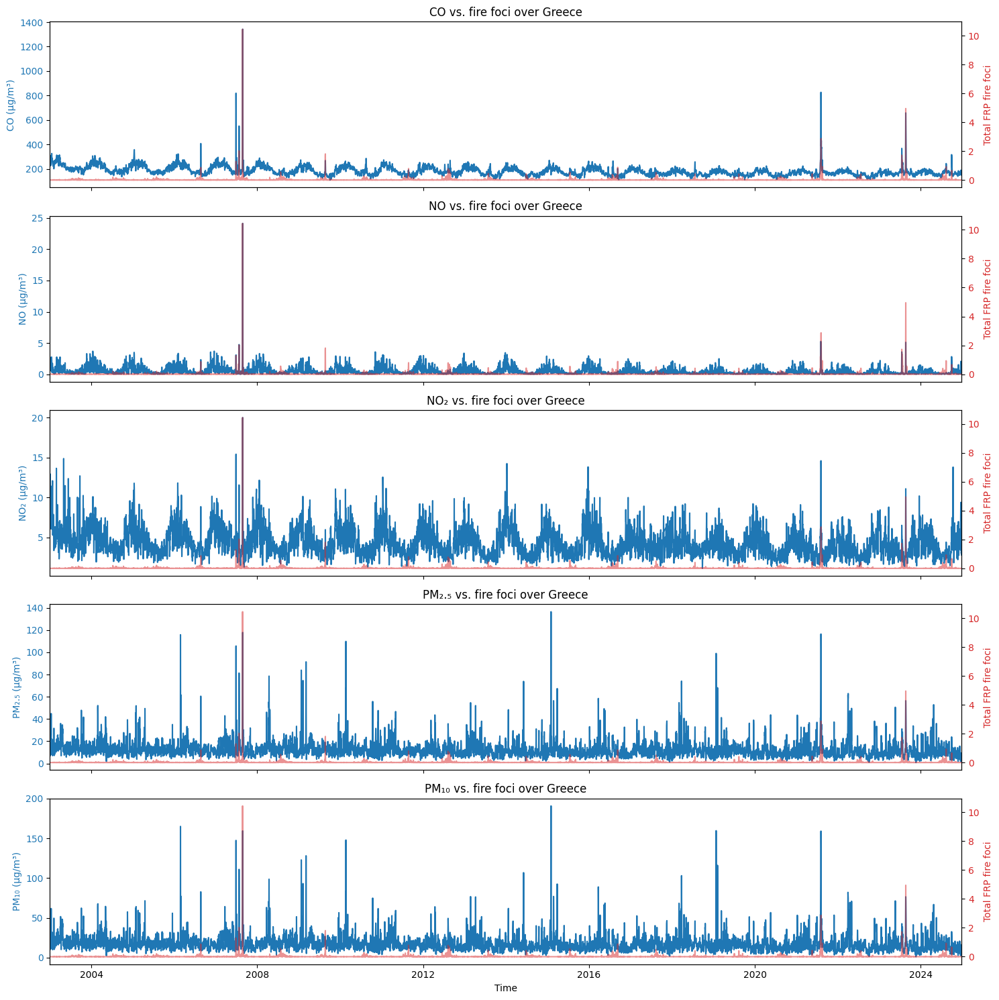

In [18]:
# All Years - Greece

import xarray as xr
import matplotlib.pyplot as plt

# File paths for each pollutant
files = {
    'CO':     r"D:\IPMA\Results\co_fire_meteo_Greece.nc",
    'NO':     r"D:\IPMA\Results\no_fire_meteo_Greece.nc",
    'NO₂':    r"D:\IPMA\Results\no2_fire_meteo_Greece.nc",
    'PM₂.₅':  r"D:\IPMA\Results\pm2p5_fire_meteo_Greece.nc",
    'PM₁₀':   r"D:\IPMA\Results\pm10_fire_meteo_Greece.nc"
}

# Correct units for plotting
units = {
    'CO': 'µg/m³',
    'NO': 'µg/m³',
    'NO₂': 'µg/m³',
    'PM₂.₅': 'µg/m³',
    'PM₁₀': 'µg/m³'
}

# Set up figure
fig, axs = plt.subplots(len(files), 1, figsize=(15, 3 * len(files)), sharex=True)

for ax, (pollutant_name, file_path) in zip(axs, files.items()):
    # Load dataset
    ds = xr.open_dataset(file_path)

    # Extract time range
    time = ds.time
    tmin = time.min().values
    tmax = time.max().values

    # Spatial average of pollutant concentration
    pollutant = ds['Mean'].mean(dim=['latitude', 'longitude'])

    # Convert CO mg/m³ → µg/m³
    if pollutant_name == 'CO':
        pollutant = pollutant * 1000

    # Daily total count FRP over Greece
    frp = ds['frp_count_Greece'].mean(dim=['latitude', 'longitude'])

    # Plot pollutant mean
    ax.plot(time, pollutant, label=f'{pollutant_name} Mean ({units[pollutant_name]})', color='tab:blue')
    ax.set_ylabel(f'{pollutant_name} ({units[pollutant_name]})', color='tab:blue')
    ax.tick_params(axis='y', labelcolor='tab:blue')
    ax.grid(False)

    # Plot FRP on twin y-axis
    ax2 = ax.twinx()
    ax2.plot(time, frp, label='FRP', color='tab:red', alpha=0.5)
    ax2.set_ylabel('Total FRP fire foci', color='tab:red')
    ax2.tick_params(axis='y', labelcolor='tab:red')

    # Set x-axis limits
    ax.set_xlim([tmin, tmax])

    # Title
    ax.set_title(f'{pollutant_name} vs. fire foci over Greece')

# Global X label
axs[-1].set_xlabel('Time')
plt.tight_layout()
plt.show()


#### Certain Year

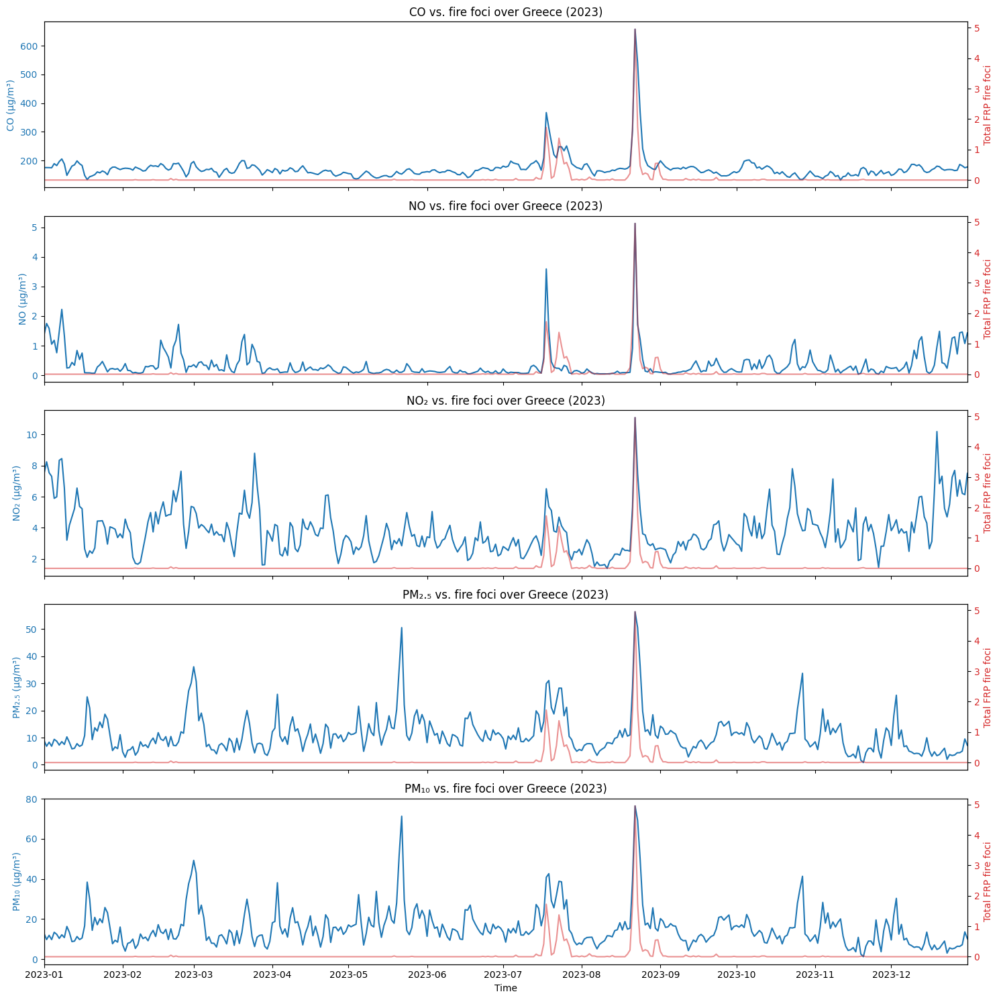

In [19]:
# Certain Year - Greece

import xarray as xr
import matplotlib.pyplot as plt
import pandas as pd

# Set this to a specific year (e.g., 2017), or to None to plot all years
selected_year = 2023

# File paths for each pollutant
files = {
    'CO':     r"D:\IPMA\Results\co_fire_meteo_Greece.nc",
    'NO':     r"D:\IPMA\Results\no_fire_meteo_Greece.nc",
    'NO₂':    r"D:\IPMA\Results\no2_fire_meteo_Greece.nc",
    'PM₂.₅':  r"D:\IPMA\Results\pm2p5_fire_meteo_Greece.nc",
    'PM₁₀':   r"D:\IPMA\Results\pm10_fire_meteo_Greece.nc"
}

# Units for each pollutant
pollutant_units = {
    'CO': 'µg/m³',
    'NO': 'µg/m³',
    'NO₂': 'µg/m³',
    'PM₂.₅': 'µg/m³',
    'PM₁₀': 'µg/m³'
}

# Set up figure
fig, axs = plt.subplots(len(files), 1, figsize=(15, 3 * len(files)), sharex=True)

for ax, (pollutant_name, file_path) in zip(axs, files.items()):
    # Load dataset
    ds = xr.open_dataset(file_path)

    # Subset by year if specified
    if selected_year is not None:
        # Ensure time is a datetime64
        ds['time'] = pd.to_datetime(ds['time'].values)
        ds = ds.sel(time=ds['time'].dt.year == selected_year)

    # Extract time and limits
    time = ds.time
    if len(time) == 0:
        ax.set_title(f'{pollutant_name} vs. FRP – No data for year {selected_year}')
        continue

    tmin = time.min().values
    tmax = time.max().values

    # Spatial average of pollutant concentration
    pollutant = ds['Mean'].mean(dim=['latitude', 'longitude'])

    # Convert CO mg/m³ → µg/m³
    if pollutant_name == 'CO':
        pollutant = pollutant * 1000

    # Daily total count FRP over greece
    frp = ds['frp_count_Greece'].mean(dim=['latitude', 'longitude'])

    # Get units
    unit = pollutant_units[pollutant_name]

    # Plot pollutant mean
    ax.plot(time, pollutant, label=f'{pollutant_name} Mean ({unit})', color='tab:blue')
    ax.set_ylabel(f'{pollutant_name} ({unit})', color='tab:blue')
    ax.tick_params(axis='y', labelcolor='tab:blue')
    ax.grid(False)

    # Plot FRP on twin y-axis
    ax2 = ax.twinx()
    ax2.plot(time, frp, label='FRP', color='tab:red', alpha=0.5)
    ax2.set_ylabel('Total FRP fire foci', color='tab:red')
    ax2.tick_params(axis='y', labelcolor='tab:red')

    # Set x-axis limits to match time range
    ax.set_xlim([tmin, tmax])

    # Title
    title = f'{pollutant_name} vs. fire foci over Greece'
    if selected_year is not None:
        title += f' ({selected_year})'
    ax.set_title(title)

# Global X label
axs[-1].set_xlabel('Time')
plt.tight_layout()
plt.show()


### Iberia

#### All Years

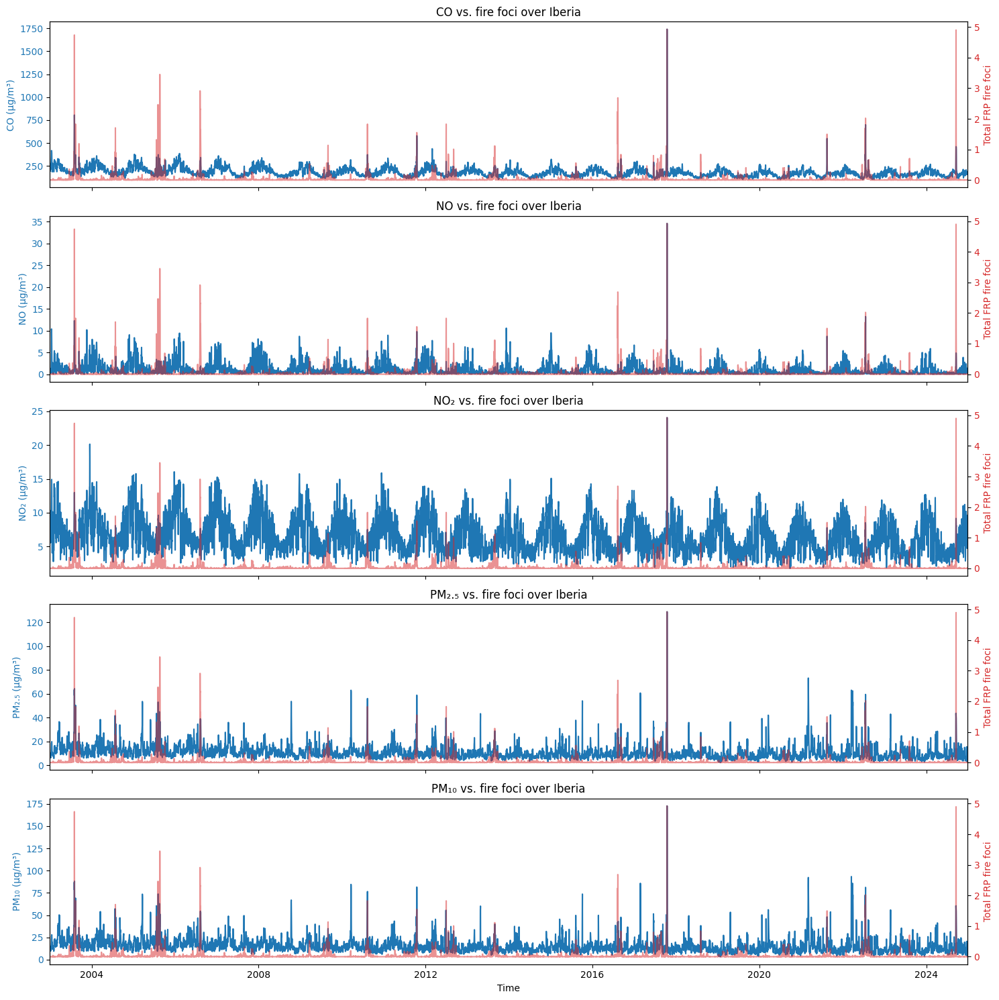

In [20]:
# All Years - Iberia

import xarray as xr
import matplotlib.pyplot as plt

# File paths for each pollutant
files = {
    'CO':     r"D:\IPMA\Results\co_fire_meteo_Iberia.nc",
    'NO':     r"D:\IPMA\Results\no_fire_meteo_Iberia.nc",
    'NO₂':    r"D:\IPMA\Results\no2_fire_meteo_Iberia.nc",
    'PM₂.₅':  r"D:\IPMA\Results\pm2p5_fire_meteo_Iberia.nc",
    'PM₁₀':   r"D:\IPMA\Results\pm10_fire_meteo_Iberia.nc"
}

# Correct units for plotting
units = {
    'CO': 'µg/m³',
    'NO': 'µg/m³',
    'NO₂': 'µg/m³',
    'PM₂.₅': 'µg/m³',
    'PM₁₀': 'µg/m³'
}

# Set up figure
fig, axs = plt.subplots(len(files), 1, figsize=(15, 3 * len(files)), sharex=True)

for ax, (pollutant_name, file_path) in zip(axs, files.items()):
    # Load dataset
    ds = xr.open_dataset(file_path)

    # Extract time range
    time = ds.time
    tmin = time.min().values
    tmax = time.max().values

    # Spatial average of pollutant concentration
    pollutant = ds['Mean'].mean(dim=['latitude', 'longitude'])

    # Convert CO mg/m³ → µg/m³
    if pollutant_name == 'CO':
        pollutant = pollutant * 1000

    # Daily total count FRP over Iberia
    frp = ds['frp_count_Iberia'].mean(dim=['latitude', 'longitude'])

    # Plot pollutant mean
    ax.plot(time, pollutant, label=f'{pollutant_name} Mean ({units[pollutant_name]})', color='tab:blue')
    ax.set_ylabel(f'{pollutant_name} ({units[pollutant_name]})', color='tab:blue')
    ax.tick_params(axis='y', labelcolor='tab:blue')
    ax.grid(False)

    # Plot FRP on twin y-axis
    ax2 = ax.twinx()
    ax2.plot(time, frp, label='FRP', color='tab:red', alpha=0.5)
    ax2.set_ylabel('Total FRP fire foci', color='tab:red')
    ax2.tick_params(axis='y', labelcolor='tab:red')

    # Set x-axis limits
    ax.set_xlim([tmin, tmax])

    # Title
    ax.set_title(f'{pollutant_name} vs. fire foci over Iberia')

# Global X label
axs[-1].set_xlabel('Time')
plt.tight_layout()
plt.show()


#### Certain Year

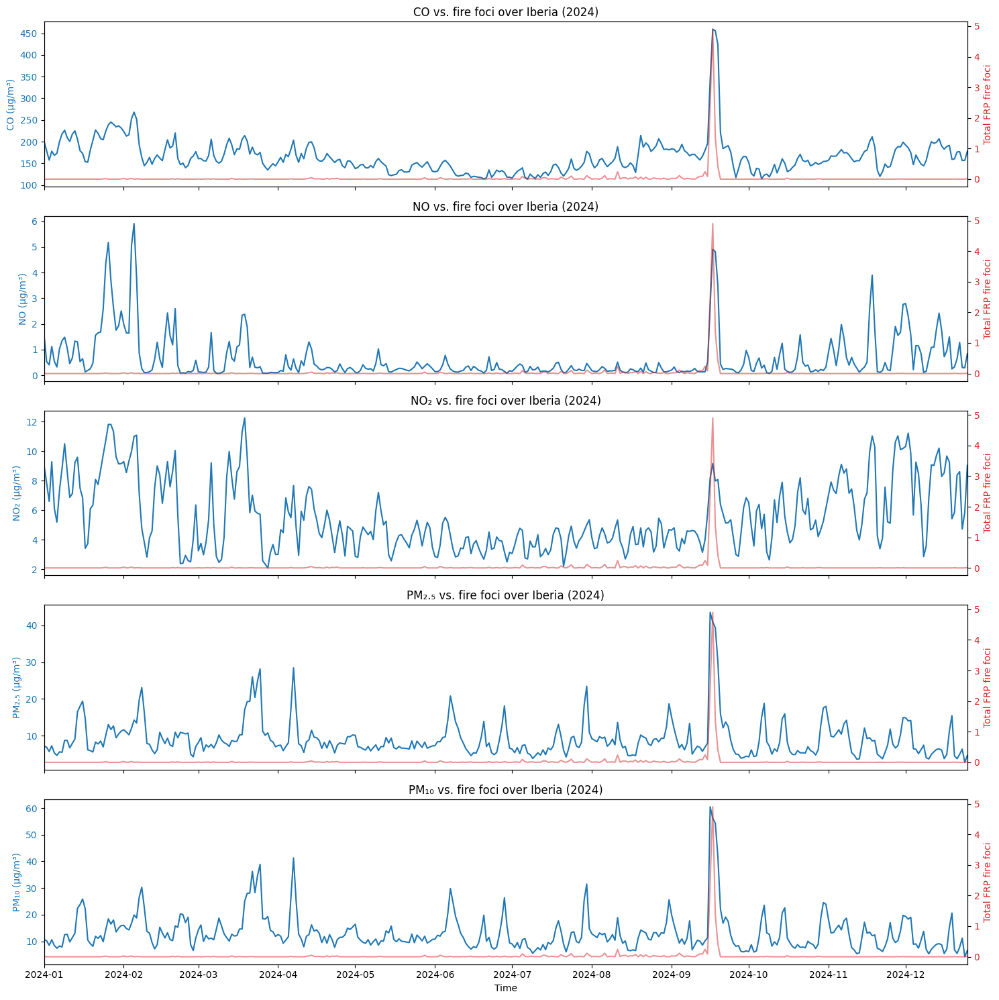

In [21]:
# Certain Year - Iberia

import xarray as xr
import matplotlib.pyplot as plt
import pandas as pd

# Set this to a specific year (e.g., 2017), or to None to plot all years
selected_year = 2024

# File paths for each pollutant
files = {
    'CO':     r"D:\IPMA\Results\co_fire_meteo_Iberia.nc",
    'NO':     r"D:\IPMA\Results\no_fire_meteo_Iberia.nc",
    'NO₂':    r"D:\IPMA\Results\no2_fire_meteo_Iberia.nc",
    'PM₂.₅':  r"D:\IPMA\Results\pm2p5_fire_meteo_Iberia.nc",
    'PM₁₀':   r"D:\IPMA\Results\pm10_fire_meteo_Iberia.nc"
}

# Units for each pollutant
pollutant_units = {
    'CO': 'µg/m³',
    'NO': 'µg/m³',
    'NO₂': 'µg/m³',
    'PM₂.₅': 'µg/m³',
    'PM₁₀': 'µg/m³'
}

# Set up figure
fig, axs = plt.subplots(len(files), 1, figsize=(15, 3 * len(files)), sharex=True)

for ax, (pollutant_name, file_path) in zip(axs, files.items()):
    # Load dataset
    ds = xr.open_dataset(file_path)

    # Subset by year if specified
    if selected_year is not None:
        # Ensure time is a datetime64
        ds['time'] = pd.to_datetime(ds['time'].values)
        ds = ds.sel(time=ds['time'].dt.year == selected_year)

    # Extract time and limits
    time = ds.time
    if len(time) == 0:
        ax.set_title(f'{pollutant_name} vs. FRP – No data for year {selected_year}')
        continue

    tmin = time.min().values
    tmax = time.max().values

    # Spatial average of pollutant concentration
    pollutant = ds['Mean'].mean(dim=['latitude', 'longitude'])

    # Convert CO mg/m³ → µg/m³
    if pollutant_name == 'CO':
        pollutant = pollutant * 1000

    # Daily total count FRP over Iberia
    frp = ds['frp_count_Iberia'].mean(dim=['latitude', 'longitude'])

    # Get units
    unit = pollutant_units[pollutant_name]

    # Plot pollutant mean
    ax.plot(time, pollutant, label=f'{pollutant_name} Mean ({unit})', color='tab:blue')
    ax.set_ylabel(f'{pollutant_name} ({unit})', color='tab:blue')
    ax.tick_params(axis='y', labelcolor='tab:blue')
    ax.grid(False)

    # Plot FRP on twin y-axis
    ax2 = ax.twinx()
    ax2.plot(time, frp, label='FRP', color='tab:red', alpha=0.5)
    ax2.set_ylabel('Total FRP fire foci', color='tab:red')
    ax2.tick_params(axis='y', labelcolor='tab:red')

    # Set x-axis limits to match time range
    ax.set_xlim([tmin, tmax])

    # Title
    title = f'{pollutant_name} vs. fire foci over Iberia'
    if selected_year is not None:
        title += f' ({selected_year})'
    ax.set_title(title)

# Global X label
axs[-1].set_xlabel('Time')
plt.tight_layout()
plt.show()


## Air pollutants levels on days with different labels

### Portugal

C:\Users\sofia\AppData\Local\Temp\ipykernel_16176\979500621.py:37: RuntimeWarning: invalid value encountered in cast
  labels = ds['fire_label_Portugal'].values.flatten().astype(int)
C:\Users\sofia\AppData\Local\Temp\ipykernel_16176\979500621.py:37: RuntimeWarning: invalid value encountered in cast
  labels = ds['fire_label_Portugal'].values.flatten().astype(int)
C:\Users\sofia\AppData\Local\Temp\ipykernel_16176\979500621.py:37: RuntimeWarning: invalid value encountered in cast
  labels = ds['fire_label_Portugal'].values.flatten().astype(int)
C:\Users\sofia\AppData\Local\Temp\ipykernel_16176\979500621.py:37: RuntimeWarning: invalid value encountered in cast
  labels = ds['fire_label_Portugal'].values.flatten().astype(int)
C:\Users\sofia\AppData\Local\Temp\ipykernel_16176\979500621.py:37: RuntimeWarning: invalid value encountered in cast
  labels = ds['fire_label_Portugal'].values.flatten().astype(int)


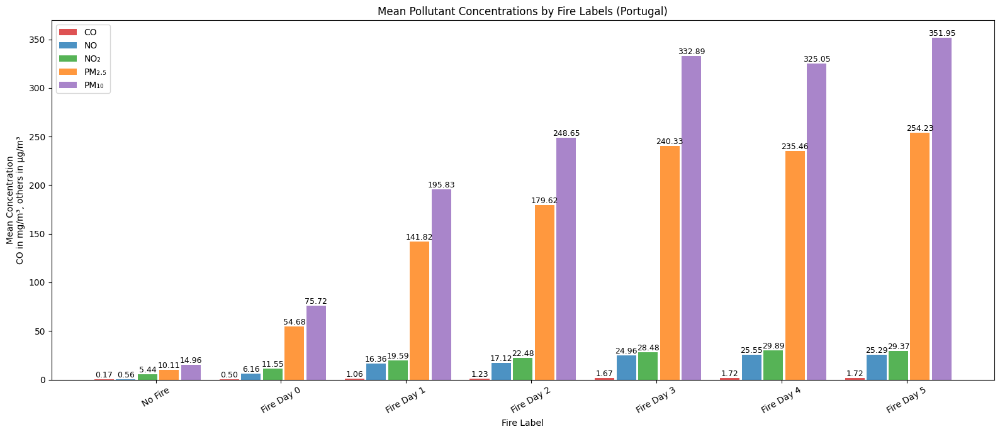

In [22]:
import xarray as xr
import matplotlib.pyplot as plt
import numpy as np

# File paths
files = {
    'CO':     r"D:\IPMA\Results\co_fire_meteo_Portugal.nc",
    'NO':     r"D:\IPMA\Results\no_fire_meteo_Portugal.nc",
    'NO₂':    r"D:\IPMA\Results\no2_fire_meteo_Portugal.nc",
    'PM₂.₅':  r"D:\IPMA\Results\pm2p5_fire_meteo_Portugal.nc",
    'PM₁₀':   r"D:\IPMA\Results\pm10_fire_meteo_Portugal.nc"  
}

# Fire labels
label_map = {
    0: "No Fire",
    1: "Fire Day 0",
    2: "Fire Day 1",
    3: "Fire Day 2",
    4: "Fire Day 3",
    5: "Fire Day 4",
    6: "Fire Day 5"
}
label_values = list(label_map.keys())
ordered_labels = list(label_map.values())

pollutants = list(files.keys())
n_labels = len(label_values)
n_pollutants = len(pollutants)

# Prepare mean data for each pollutant and label
means_by_pollutant_label = {p: [] for p in pollutants}

for pollutant_name, file_path in files.items():
    ds = xr.open_dataset(file_path)
    conc = ds['Mean'].transpose('time', 'latitude', 'longitude').values.flatten()
    labels = ds['fire_label_Portugal'].values.flatten().astype(int)

    valid = ~np.isnan(conc) & ~np.isnan(labels)
    conc = conc[valid]
    labels = labels[valid]

    for lv in label_values:
        data_lv = conc[labels == lv]
        mean_val = np.nan if len(data_lv) == 0 else np.nanmean(data_lv)
        means_by_pollutant_label[pollutant_name].append(mean_val)

# Convert means to array for easier plotting
mean_matrix = np.array([means_by_pollutant_label[p] for p in pollutants])  # shape (pollutants, labels)

# Colorblind-friendly colors for pollutants
pollutant_colors = {
    'CO': 'tab:red',
    'NO': 'tab:blue',
    'NO₂': 'tab:green',
    'PM₂.₅': 'tab:orange',
    'PM₁₀': 'tab:purple'
}

# Plot grouped bar chart
fig, ax = plt.subplots(figsize=(16, 7))
bar_width = 0.13
group_width = n_pollutants * bar_width + 0.1

# x-ticks positions for bar groups
xticks_pos = [i * group_width + (group_width - bar_width)/2 for i in range(n_labels)]

# Plot bars
for j, pollutant_name in enumerate(pollutants):
    pos = [i * group_width + j * bar_width for i in range(n_labels)]
    color = pollutant_colors[pollutant_name]
    bars = ax.bar(pos, mean_matrix[j], width=bar_width*0.9, label=pollutant_name, color=color, alpha=0.8)
    
    # Add numbers on top of each bar
    for bar in bars:
        height = bar.get_height()
        if not np.isnan(height):
            ax.text(bar.get_x() + bar.get_width()/2, height, f"{height:.2f}", ha='center', va='bottom', fontsize=9)

# Labels and title
ax.set_xticks(xticks_pos)
ax.set_xticklabels(ordered_labels, rotation=30)
ax.set_ylabel("Mean Concentration\nCO in mg/m³, others in µg/m³")
ax.set_xlabel("Fire Label")
ax.set_title("Mean Pollutant Concentrations by Fire Labels (Portugal)")

# Move legend to left
ax.legend(loc='upper left')
ax.grid(False)
plt.tight_layout()
plt.show()

C:\Users\sofia\AppData\Local\Temp\ipykernel_16176\3766243097.py:42: RuntimeWarning: invalid value encountered in cast
  labels = ds['fire_label_Portugal'].values.flatten().astype(int)
C:\Users\sofia\AppData\Local\Temp\ipykernel_16176\3766243097.py:42: RuntimeWarning: invalid value encountered in cast
  labels = ds['fire_label_Portugal'].values.flatten().astype(int)
C:\Users\sofia\AppData\Local\Temp\ipykernel_16176\3766243097.py:42: RuntimeWarning: invalid value encountered in cast
  labels = ds['fire_label_Portugal'].values.flatten().astype(int)
C:\Users\sofia\AppData\Local\Temp\ipykernel_16176\3766243097.py:42: RuntimeWarning: invalid value encountered in cast
  labels = ds['fire_label_Portugal'].values.flatten().astype(int)
C:\Users\sofia\AppData\Local\Temp\ipykernel_16176\3766243097.py:42: RuntimeWarning: invalid value encountered in cast
  labels = ds['fire_label_Portugal'].values.flatten().astype(int)


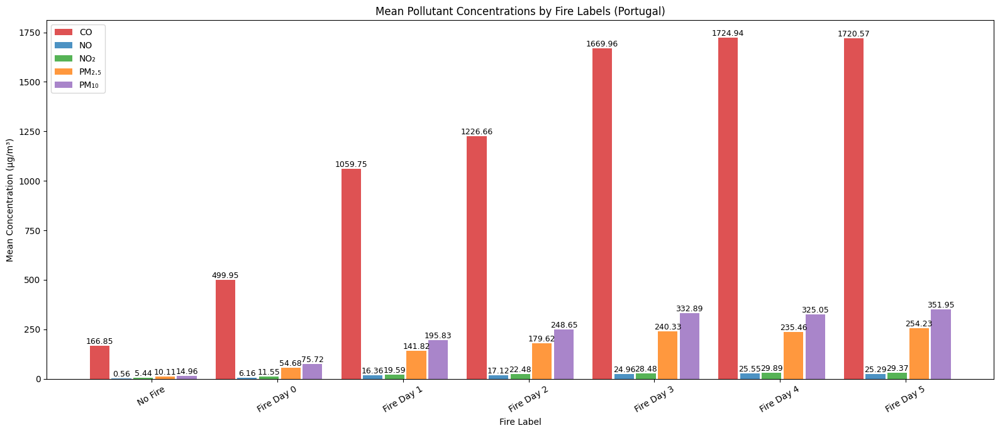

In [23]:
import xarray as xr
import matplotlib.pyplot as plt
import numpy as np

# File paths
files = {
    'CO':     r"D:\IPMA\Results\co_fire_meteo_Portugal.nc",
    'NO':     r"D:\IPMA\Results\no_fire_meteo_Portugal.nc",
    'NO₂':    r"D:\IPMA\Results\no2_fire_meteo_Portugal.nc",
    'PM₂.₅':  r"D:\IPMA\Results\pm2p5_fire_meteo_Portugal.nc",
    'PM₁₀':   r"D:\IPMA\Results\pm10_fire_meteo_Portugal.nc"   
}

# Fire labels
label_map = {
    0: "No Fire",
    1: "Fire Day 0",
    2: "Fire Day 1",
    3: "Fire Day 2",
    4: "Fire Day 3",
    5: "Fire Day 4",
    6: "Fire Day 5"
}
label_values = list(label_map.keys())
ordered_labels = list(label_map.values())

pollutants = list(files.keys())
n_labels = len(label_values)
n_pollutants = len(pollutants)

# Prepare mean data for each pollutant and label
means_by_pollutant_label = {p: [] for p in pollutants}

for pollutant_name, file_path in files.items():
    ds = xr.open_dataset(file_path)
    conc = ds['Mean'].transpose('time', 'latitude', 'longitude').values.flatten()

    # Convert CO from mg/m³ to µg/m³
    if pollutant_name == 'CO':
        conc = conc * 1000
    
    labels = ds['fire_label_Portugal'].values.flatten().astype(int)

    valid = ~np.isnan(conc) & ~np.isnan(labels)
    conc = conc[valid]
    labels = labels[valid]

    for lv in label_values:
        data_lv = conc[labels == lv]
        mean_val = np.nan if len(data_lv) == 0 else np.nanmean(data_lv)
        means_by_pollutant_label[pollutant_name].append(mean_val)

# Convert means to array for easier plotting
mean_matrix = np.array([means_by_pollutant_label[p] for p in pollutants])  # shape (pollutants, labels)

# Colorblind-friendly colors for pollutants
pollutant_colors = {
    'CO': 'tab:red',
    'NO': 'tab:blue',
    'NO₂': 'tab:green',
    'PM₂.₅': 'tab:orange',
    'PM₁₀': 'tab:purple'
}

# Plot grouped bar chart
fig, ax = plt.subplots(figsize=(16, 7))
bar_width = 0.13
group_width = n_pollutants * bar_width + 0.1

# x-ticks positions for bar groups
xticks_pos = [i * group_width + (group_width - bar_width)/2 for i in range(n_labels)]

# Plot bars
for j, pollutant_name in enumerate(pollutants):
    pos = [i * group_width + j * bar_width for i in range(n_labels)]
    color = pollutant_colors[pollutant_name]
    bars = ax.bar(pos, mean_matrix[j], width=bar_width*0.9, label=pollutant_name, color=color, alpha=0.8)
    
    # Add numbers on top of each bar
    for bar in bars:
        height = bar.get_height()
        if not np.isnan(height):
            ax.text(bar.get_x() + bar.get_width()/2, height, f"{height:.2f}", ha='center', va='bottom', fontsize=9)

# Labels and title
ax.set_xticks(xticks_pos)
ax.set_xticklabels(ordered_labels, rotation=30)
ax.set_ylabel("Mean Concentration (µg/m³)")
ax.set_xlabel("Fire Label")
ax.set_title("Mean Pollutant Concentrations by Fire Labels (Portugal)")

# Legend
ax.legend(loc='upper left')
ax.grid(False)
plt.tight_layout()
plt.show()


### Italy

C:\Users\sofia\AppData\Local\Temp\ipykernel_16176\2278408303.py:37: RuntimeWarning: invalid value encountered in cast
  labels = ds['fire_label_Italy'].values.flatten().astype(int)
C:\Users\sofia\AppData\Local\Temp\ipykernel_16176\2278408303.py:37: RuntimeWarning: invalid value encountered in cast
  labels = ds['fire_label_Italy'].values.flatten().astype(int)
C:\Users\sofia\AppData\Local\Temp\ipykernel_16176\2278408303.py:37: RuntimeWarning: invalid value encountered in cast
  labels = ds['fire_label_Italy'].values.flatten().astype(int)
C:\Users\sofia\AppData\Local\Temp\ipykernel_16176\2278408303.py:37: RuntimeWarning: invalid value encountered in cast
  labels = ds['fire_label_Italy'].values.flatten().astype(int)
C:\Users\sofia\AppData\Local\Temp\ipykernel_16176\2278408303.py:37: RuntimeWarning: invalid value encountered in cast
  labels = ds['fire_label_Italy'].values.flatten().astype(int)


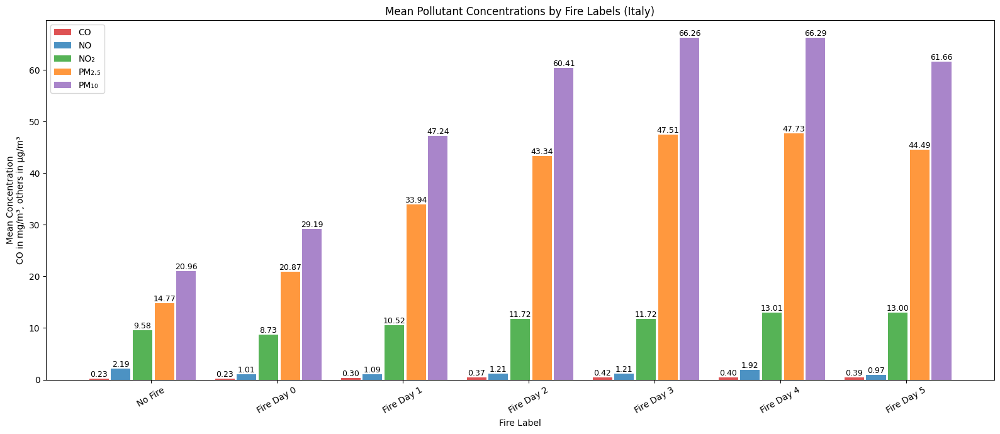

In [24]:
import xarray as xr
import matplotlib.pyplot as plt
import numpy as np

# File paths
files = {
    'CO':     r"D:\IPMA\Results\co_fire_meteo_Italy.nc",
    'NO':     r"D:\IPMA\Results\no_fire_meteo_Italy.nc",
    'NO₂':    r"D:\IPMA\Results\no2_fire_meteo_Italy.nc",
    'PM₂.₅':  r"D:\IPMA\Results\pm2p5_fire_meteo_Italy.nc",
    'PM₁₀':   r"D:\IPMA\Results\pm10_fire_meteo_Italy.nc"   
}

# Fire labels
label_map = {
    0: "No Fire",
    1: "Fire Day 0",
    2: "Fire Day 1",
    3: "Fire Day 2",
    4: "Fire Day 3",
    5: "Fire Day 4",
    6: "Fire Day 5"
}
label_values = list(label_map.keys())
ordered_labels = list(label_map.values())

pollutants = list(files.keys())
n_labels = len(label_values)
n_pollutants = len(pollutants)

# Prepare mean data for each pollutant and label
means_by_pollutant_label = {p: [] for p in pollutants}

for pollutant_name, file_path in files.items():
    ds = xr.open_dataset(file_path)
    conc = ds['Mean'].transpose('time', 'latitude', 'longitude').values.flatten()
    labels = ds['fire_label_Italy'].values.flatten().astype(int)

    valid = ~np.isnan(conc) & ~np.isnan(labels)
    conc = conc[valid]
    labels = labels[valid]

    for lv in label_values:
        data_lv = conc[labels == lv]
        mean_val = np.nan if len(data_lv) == 0 else np.nanmean(data_lv)
        means_by_pollutant_label[pollutant_name].append(mean_val)

# Convert means to array for easier plotting
mean_matrix = np.array([means_by_pollutant_label[p] for p in pollutants])  # shape (pollutants, labels)

# Colorblind-friendly colors for pollutants
pollutant_colors = {
    'CO': 'tab:red',
    'NO': 'tab:blue',
    'NO₂': 'tab:green',
    'PM₂.₅': 'tab:orange',
    'PM₁₀': 'tab:purple'
}

# Plot grouped bar chart
fig, ax = plt.subplots(figsize=(16, 7))
bar_width = 0.13
group_width = n_pollutants * bar_width + 0.1

# x-ticks positions for bar groups
xticks_pos = [i * group_width + (group_width - bar_width)/2 for i in range(n_labels)]

# Plot bars
for j, pollutant_name in enumerate(pollutants):
    pos = [i * group_width + j * bar_width for i in range(n_labels)]
    color = pollutant_colors[pollutant_name]
    bars = ax.bar(pos, mean_matrix[j], width=bar_width*0.9, label=pollutant_name, color=color, alpha=0.8)
    
    # Add numbers on top of each bar
    for bar in bars:
        height = bar.get_height()
        if not np.isnan(height):
            ax.text(bar.get_x() + bar.get_width()/2, height, f"{height:.2f}", ha='center', va='bottom', fontsize=9)

# Labels and title
ax.set_xticks(xticks_pos)
ax.set_xticklabels(ordered_labels, rotation=30)
ax.set_ylabel("Mean Concentration\nCO in mg/m³, others in µg/m³")
ax.set_xlabel("Fire Label")
ax.set_title("Mean Pollutant Concentrations by Fire Labels (Italy)")

# Legend
ax.legend(loc='upper left')
ax.grid(False)
plt.tight_layout()
plt.show()


C:\Users\sofia\AppData\Local\Temp\ipykernel_16176\450075553.py:42: RuntimeWarning: invalid value encountered in cast
  labels = ds['fire_label_Italy'].values.flatten().astype(int)
C:\Users\sofia\AppData\Local\Temp\ipykernel_16176\450075553.py:42: RuntimeWarning: invalid value encountered in cast
  labels = ds['fire_label_Italy'].values.flatten().astype(int)
C:\Users\sofia\AppData\Local\Temp\ipykernel_16176\450075553.py:42: RuntimeWarning: invalid value encountered in cast
  labels = ds['fire_label_Italy'].values.flatten().astype(int)
C:\Users\sofia\AppData\Local\Temp\ipykernel_16176\450075553.py:42: RuntimeWarning: invalid value encountered in cast
  labels = ds['fire_label_Italy'].values.flatten().astype(int)
C:\Users\sofia\AppData\Local\Temp\ipykernel_16176\450075553.py:42: RuntimeWarning: invalid value encountered in cast
  labels = ds['fire_label_Italy'].values.flatten().astype(int)


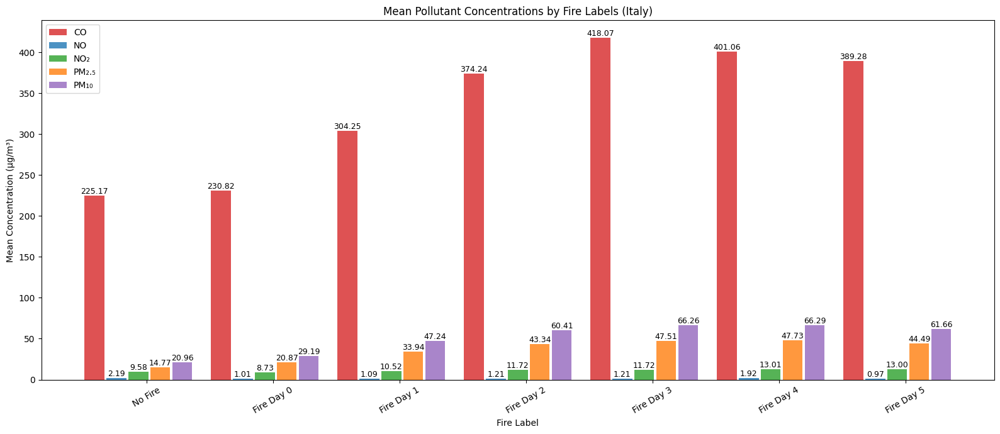

In [25]:
import xarray as xr
import matplotlib.pyplot as plt
import numpy as np

# File paths
files = {
    'CO':     r"D:\IPMA\Results\co_fire_meteo_Italy.nc",
    'NO':     r"D:\IPMA\Results\no_fire_meteo_Italy.nc",
    'NO₂':    r"D:\IPMA\Results\no2_fire_meteo_Italy.nc",
    'PM₂.₅':  r"D:\IPMA\Results\pm2p5_fire_meteo_Italy.nc",
    'PM₁₀':   r"D:\IPMA\Results\pm10_fire_meteo_Italy.nc" 
}

# Fire labels
label_map = {
    0: "No Fire",
    1: "Fire Day 0",
    2: "Fire Day 1",
    3: "Fire Day 2",
    4: "Fire Day 3",
    5: "Fire Day 4",
    6: "Fire Day 5"
}
label_values = list(label_map.keys())
ordered_labels = list(label_map.values())

pollutants = list(files.keys())
n_labels = len(label_values)
n_pollutants = len(pollutants)

# Prepare mean data for each pollutant and label
means_by_pollutant_label = {p: [] for p in pollutants}

for pollutant_name, file_path in files.items():
    ds = xr.open_dataset(file_path)
    conc = ds['Mean'].transpose('time', 'latitude', 'longitude').values.flatten()

    # Convert CO from mg/m³ to µg/m³
    if pollutant_name == 'CO':
        conc = conc * 1000
    
    labels = ds['fire_label_Italy'].values.flatten().astype(int)

    valid = ~np.isnan(conc) & ~np.isnan(labels)
    conc = conc[valid]
    labels = labels[valid]

    for lv in label_values:
        data_lv = conc[labels == lv]
        mean_val = np.nan if len(data_lv) == 0 else np.nanmean(data_lv)
        means_by_pollutant_label[pollutant_name].append(mean_val)

# Convert means to array for easier plotting
mean_matrix = np.array([means_by_pollutant_label[p] for p in pollutants])  # shape (pollutants, labels)

# Colorblind-friendly colors for pollutants
pollutant_colors = {
    'CO': 'tab:red',
    'NO': 'tab:blue',
    'NO₂': 'tab:green',
    'PM₂.₅': 'tab:orange',
    'PM₁₀': 'tab:purple'
}

# Plot grouped bar chart
fig, ax = plt.subplots(figsize=(16, 7))
bar_width = 0.13
group_width = n_pollutants * bar_width + 0.1

# x-ticks positions for bar groups
xticks_pos = [i * group_width + (group_width - bar_width)/2 for i in range(n_labels)]

# Plot bars
for j, pollutant_name in enumerate(pollutants):
    pos = [i * group_width + j * bar_width for i in range(n_labels)]
    color = pollutant_colors[pollutant_name]
    bars = ax.bar(pos, mean_matrix[j], width=bar_width*0.9, label=pollutant_name, color=color, alpha=0.8)
    
    # Add numbers on top of each bar
    for bar in bars:
        height = bar.get_height()
        if not np.isnan(height):
            ax.text(bar.get_x() + bar.get_width()/2, height, f"{height:.2f}", ha='center', va='bottom', fontsize=9)

# Labels and title
ax.set_xticks(xticks_pos)
ax.set_xticklabels(ordered_labels, rotation=30)
ax.set_ylabel("Mean Concentration (µg/m³)")
ax.set_xlabel("Fire Label")
ax.set_title("Mean Pollutant Concentrations by Fire Labels (Italy)")

# Legend
ax.legend(loc='upper left')
ax.grid(False)
plt.tight_layout()
plt.show()


### Spain

C:\Users\sofia\AppData\Local\Temp\ipykernel_16176\2599147465.py:37: RuntimeWarning: invalid value encountered in cast
  labels = ds['fire_label_Spain'].values.flatten().astype(int)
C:\Users\sofia\AppData\Local\Temp\ipykernel_16176\2599147465.py:37: RuntimeWarning: invalid value encountered in cast
  labels = ds['fire_label_Spain'].values.flatten().astype(int)
C:\Users\sofia\AppData\Local\Temp\ipykernel_16176\2599147465.py:37: RuntimeWarning: invalid value encountered in cast
  labels = ds['fire_label_Spain'].values.flatten().astype(int)
C:\Users\sofia\AppData\Local\Temp\ipykernel_16176\2599147465.py:37: RuntimeWarning: invalid value encountered in cast
  labels = ds['fire_label_Spain'].values.flatten().astype(int)
C:\Users\sofia\AppData\Local\Temp\ipykernel_16176\2599147465.py:37: RuntimeWarning: invalid value encountered in cast
  labels = ds['fire_label_Spain'].values.flatten().astype(int)


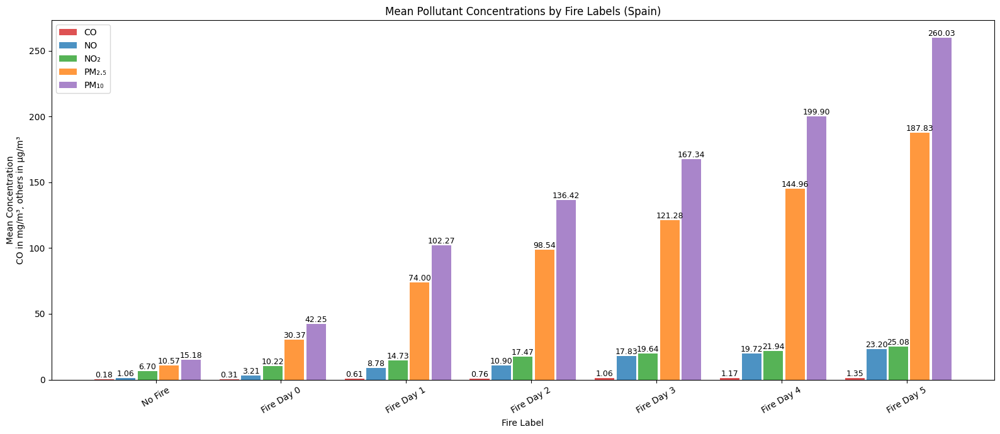

In [26]:
import xarray as xr
import matplotlib.pyplot as plt
import numpy as np

# File paths
files = {
    'CO':     r"D:\IPMA\Results\co_fire_meteo_Spain.nc",
    'NO':     r"D:\IPMA\Results\no_fire_meteo_Spain.nc",
    'NO₂':    r"D:\IPMA\Results\no2_fire_meteo_Spain.nc",
    'PM₂.₅':  r"D:\IPMA\Results\pm2p5_fire_meteo_Spain.nc",
    'PM₁₀':   r"D:\IPMA\Results\pm10_fire_meteo_Spain.nc"   
}

# Fire labels
label_map = {
    0: "No Fire",
    1: "Fire Day 0",
    2: "Fire Day 1",
    3: "Fire Day 2",
    4: "Fire Day 3",
    5: "Fire Day 4",
    6: "Fire Day 5"
}
label_values = list(label_map.keys())
ordered_labels = list(label_map.values())

pollutants = list(files.keys())
n_labels = len(label_values)
n_pollutants = len(pollutants)

# Prepare mean data for each pollutant and label
means_by_pollutant_label = {p: [] for p in pollutants}

for pollutant_name, file_path in files.items():
    ds = xr.open_dataset(file_path)
    conc = ds['Mean'].transpose('time', 'latitude', 'longitude').values.flatten()
    labels = ds['fire_label_Spain'].values.flatten().astype(int)

    valid = ~np.isnan(conc) & ~np.isnan(labels)
    conc = conc[valid]
    labels = labels[valid]

    for lv in label_values:
        data_lv = conc[labels == lv]
        mean_val = np.nan if len(data_lv) == 0 else np.nanmean(data_lv)
        means_by_pollutant_label[pollutant_name].append(mean_val)

# Convert means to array for easier plotting
mean_matrix = np.array([means_by_pollutant_label[p] for p in pollutants])  # shape (pollutants, labels)

# Colorblind-friendly colors for pollutants
pollutant_colors = {
    'CO': 'tab:red',
    'NO': 'tab:blue',
    'NO₂': 'tab:green',
    'PM₂.₅': 'tab:orange',
    'PM₁₀': 'tab:purple'
}

# Plot grouped bar chart
fig, ax = plt.subplots(figsize=(16, 7))
bar_width = 0.13
group_width = n_pollutants * bar_width + 0.1

# x-ticks positions for bar groups
xticks_pos = [i * group_width + (group_width - bar_width)/2 for i in range(n_labels)]

# Plot bars
for j, pollutant_name in enumerate(pollutants):
    pos = [i * group_width + j * bar_width for i in range(n_labels)]
    color = pollutant_colors[pollutant_name]
    bars = ax.bar(pos, mean_matrix[j], width=bar_width*0.9, label=pollutant_name, color=color, alpha=0.8)
    
    # Add numbers on top of each bar
    for bar in bars:
        height = bar.get_height()
        if not np.isnan(height):
            ax.text(bar.get_x() + bar.get_width()/2, height, f"{height:.2f}", ha='center', va='bottom', fontsize=9)

# Labels and title
ax.set_xticks(xticks_pos)
ax.set_xticklabels(ordered_labels, rotation=30)
ax.set_ylabel("Mean Concentration\nCO in mg/m³, others in µg/m³")
ax.set_xlabel("Fire Label")
ax.set_title("Mean Pollutant Concentrations by Fire Labels (Spain)")

# Legend
ax.legend(loc='upper left')
ax.grid(False)
plt.tight_layout()
plt.show()


C:\Users\sofia\AppData\Local\Temp\ipykernel_16176\3117544093.py:42: RuntimeWarning: invalid value encountered in cast
  labels = ds['fire_label_Spain'].values.flatten().astype(int)
C:\Users\sofia\AppData\Local\Temp\ipykernel_16176\3117544093.py:42: RuntimeWarning: invalid value encountered in cast
  labels = ds['fire_label_Spain'].values.flatten().astype(int)
C:\Users\sofia\AppData\Local\Temp\ipykernel_16176\3117544093.py:42: RuntimeWarning: invalid value encountered in cast
  labels = ds['fire_label_Spain'].values.flatten().astype(int)
C:\Users\sofia\AppData\Local\Temp\ipykernel_16176\3117544093.py:42: RuntimeWarning: invalid value encountered in cast
  labels = ds['fire_label_Spain'].values.flatten().astype(int)
C:\Users\sofia\AppData\Local\Temp\ipykernel_16176\3117544093.py:42: RuntimeWarning: invalid value encountered in cast
  labels = ds['fire_label_Spain'].values.flatten().astype(int)


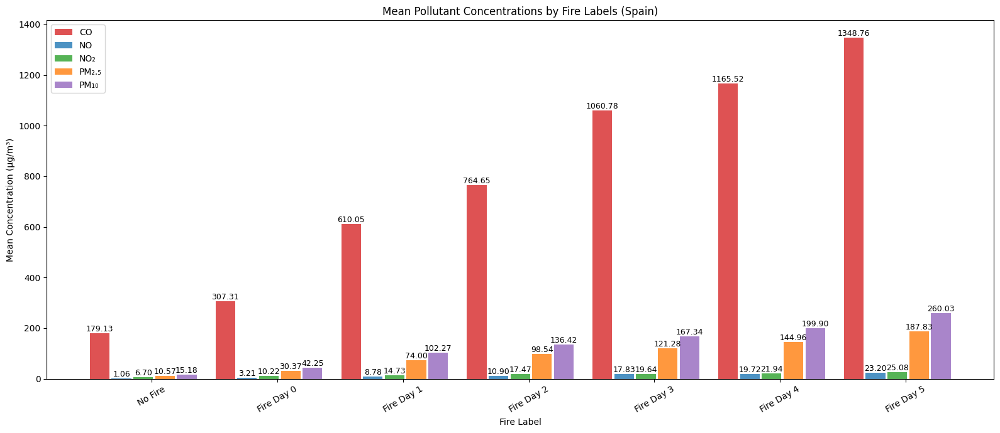

In [27]:
import xarray as xr
import matplotlib.pyplot as plt
import numpy as np

# File paths
files = {
    'CO':     r"D:\IPMA\Results\co_fire_meteo_Spain.nc",
    'NO':     r"D:\IPMA\Results\no_fire_meteo_Spain.nc",
    'NO₂':    r"D:\IPMA\Results\no2_fire_meteo_Spain.nc",
    'PM₂.₅':  r"D:\IPMA\Results\pm2p5_fire_meteo_Spain.nc",
    'PM₁₀':   r"D:\IPMA\Results\pm10_fire_meteo_Spain.nc"    
}

# Fire labels
label_map = {
    0: "No Fire",
    1: "Fire Day 0",
    2: "Fire Day 1",
    3: "Fire Day 2",
    4: "Fire Day 3",
    5: "Fire Day 4",
    6: "Fire Day 5"
}
label_values = list(label_map.keys())
ordered_labels = list(label_map.values())

pollutants = list(files.keys())
n_labels = len(label_values)
n_pollutants = len(pollutants)

# Prepare mean data for each pollutant and label
means_by_pollutant_label = {p: [] for p in pollutants}

for pollutant_name, file_path in files.items():
    ds = xr.open_dataset(file_path)
    conc = ds['Mean'].transpose('time', 'latitude', 'longitude').values.flatten()

    # Convert CO from mg/m³ to µg/m³
    if pollutant_name == 'CO':
        conc = conc * 1000
    
    labels = ds['fire_label_Spain'].values.flatten().astype(int)

    valid = ~np.isnan(conc) & ~np.isnan(labels)
    conc = conc[valid]
    labels = labels[valid]

    for lv in label_values:
        data_lv = conc[labels == lv]
        mean_val = np.nan if len(data_lv) == 0 else np.nanmean(data_lv)
        means_by_pollutant_label[pollutant_name].append(mean_val)

# Convert means to array for easier plotting
mean_matrix = np.array([means_by_pollutant_label[p] for p in pollutants])  # shape (pollutants, labels)

# Colorblind-friendly colors for pollutants
pollutant_colors = {
    'CO': 'tab:red',
    'NO': 'tab:blue',
    'NO₂': 'tab:green',
    'PM₂.₅': 'tab:orange',
    'PM₁₀': 'tab:purple'
}

# Plot grouped bar chart
fig, ax = plt.subplots(figsize=(16, 7))
bar_width = 0.13
group_width = n_pollutants * bar_width + 0.1

# x-ticks positions for bar groups
xticks_pos = [i * group_width + (group_width - bar_width)/2 for i in range(n_labels)]

# Plot bars
for j, pollutant_name in enumerate(pollutants):
    pos = [i * group_width + j * bar_width for i in range(n_labels)]
    color = pollutant_colors[pollutant_name]
    bars = ax.bar(pos, mean_matrix[j], width=bar_width*0.9, label=pollutant_name, color=color, alpha=0.8)
    
    # Add numbers on top of each bar
    for bar in bars:
        height = bar.get_height()
        if not np.isnan(height):
            ax.text(bar.get_x() + bar.get_width()/2, height, f"{height:.2f}", ha='center', va='bottom', fontsize=9)

# Labels and title
ax.set_xticks(xticks_pos)
ax.set_xticklabels(ordered_labels, rotation=30)
ax.set_ylabel("Mean Concentration (µg/m³)")
ax.set_xlabel("Fire Label")
ax.set_title("Mean Pollutant Concentrations by Fire Labels (Spain)")

# Legend
ax.legend(loc='upper left')
ax.grid(False)
plt.tight_layout()
plt.show()


### Greece

C:\Users\sofia\AppData\Local\Temp\ipykernel_16176\3423950041.py:37: RuntimeWarning: invalid value encountered in cast
  labels = ds['fire_label_Greece'].values.flatten().astype(int)
C:\Users\sofia\AppData\Local\Temp\ipykernel_16176\3423950041.py:37: RuntimeWarning: invalid value encountered in cast
  labels = ds['fire_label_Greece'].values.flatten().astype(int)
C:\Users\sofia\AppData\Local\Temp\ipykernel_16176\3423950041.py:37: RuntimeWarning: invalid value encountered in cast
  labels = ds['fire_label_Greece'].values.flatten().astype(int)
C:\Users\sofia\AppData\Local\Temp\ipykernel_16176\3423950041.py:37: RuntimeWarning: invalid value encountered in cast
  labels = ds['fire_label_Greece'].values.flatten().astype(int)
C:\Users\sofia\AppData\Local\Temp\ipykernel_16176\3423950041.py:37: RuntimeWarning: invalid value encountered in cast
  labels = ds['fire_label_Greece'].values.flatten().astype(int)


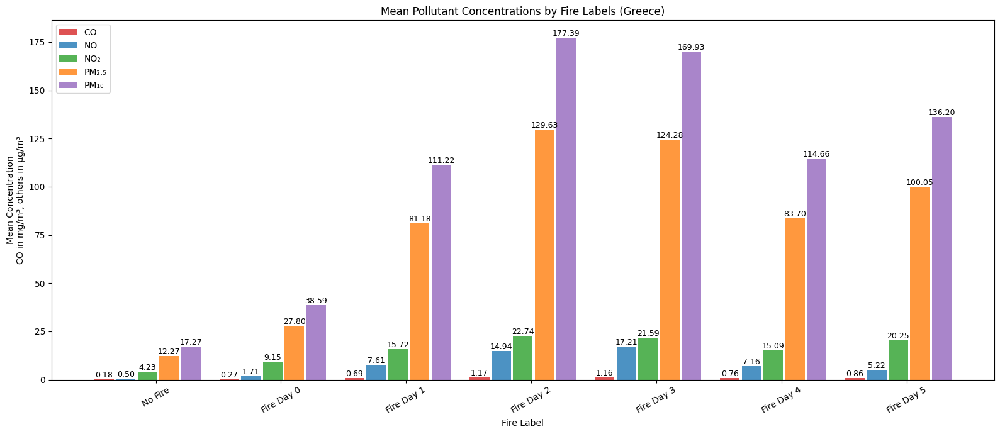

In [28]:
import xarray as xr
import matplotlib.pyplot as plt
import numpy as np

# File paths
files = {
    'CO':     r"D:\IPMA\Results\co_fire_meteo_Greece.nc",
    'NO':     r"D:\IPMA\Results\no_fire_meteo_Greece.nc",
    'NO₂':    r"D:\IPMA\Results\no2_fire_meteo_Greece.nc",
    'PM₂.₅':  r"D:\IPMA\Results\pm2p5_fire_meteo_Greece.nc",
    'PM₁₀':   r"D:\IPMA\Results\pm10_fire_meteo_Greece.nc"    
}

# Fire labels
label_map = {
    0: "No Fire",
    1: "Fire Day 0",
    2: "Fire Day 1",
    3: "Fire Day 2",
    4: "Fire Day 3",
    5: "Fire Day 4",
    6: "Fire Day 5"
}
label_values = list(label_map.keys())
ordered_labels = list(label_map.values())

pollutants = list(files.keys())
n_labels = len(label_values)
n_pollutants = len(pollutants)

# Prepare mean data for each pollutant and label
means_by_pollutant_label = {p: [] for p in pollutants}

for pollutant_name, file_path in files.items():
    ds = xr.open_dataset(file_path)
    conc = ds['Mean'].transpose('time', 'latitude', 'longitude').values.flatten()
    labels = ds['fire_label_Greece'].values.flatten().astype(int)

    valid = ~np.isnan(conc) & ~np.isnan(labels)
    conc = conc[valid]
    labels = labels[valid]

    for lv in label_values:
        data_lv = conc[labels == lv]
        mean_val = np.nan if len(data_lv) == 0 else np.nanmean(data_lv)
        means_by_pollutant_label[pollutant_name].append(mean_val)

# Convert means to array for easier plotting
mean_matrix = np.array([means_by_pollutant_label[p] for p in pollutants])  # shape (pollutants, labels)

# Colorblind-friendly colors for pollutants
pollutant_colors = {
    'CO': 'tab:red',
    'NO': 'tab:blue',
    'NO₂': 'tab:green',
    'PM₂.₅': 'tab:orange',
    'PM₁₀': 'tab:purple'
}

# Plot grouped bar chart
fig, ax = plt.subplots(figsize=(16, 7))
bar_width = 0.13
group_width = n_pollutants * bar_width + 0.1

# x-ticks positions for bar groups
xticks_pos = [i * group_width + (group_width - bar_width)/2 for i in range(n_labels)]

# Plot bars
for j, pollutant_name in enumerate(pollutants):
    pos = [i * group_width + j * bar_width for i in range(n_labels)]
    color = pollutant_colors[pollutant_name]
    bars = ax.bar(pos, mean_matrix[j], width=bar_width*0.9, label=pollutant_name, color=color, alpha=0.8)
    
    # Add numbers on top of each bar
    for bar in bars:
        height = bar.get_height()
        if not np.isnan(height):
            ax.text(bar.get_x() + bar.get_width()/2, height, f"{height:.2f}", ha='center', va='bottom', fontsize=9)

# Labels and title
ax.set_xticks(xticks_pos)
ax.set_xticklabels(ordered_labels, rotation=30)
ax.set_ylabel("Mean Concentration\nCO in mg/m³, others in µg/m³")
ax.set_xlabel("Fire Label")
ax.set_title("Mean Pollutant Concentrations by Fire Labels (Greece)")

# Legend
ax.legend(loc='upper left')
ax.grid(False)
plt.tight_layout()
plt.show()


C:\Users\sofia\AppData\Local\Temp\ipykernel_16176\230671836.py:42: RuntimeWarning: invalid value encountered in cast
  labels = ds['fire_label_Greece'].values.flatten().astype(int)
C:\Users\sofia\AppData\Local\Temp\ipykernel_16176\230671836.py:42: RuntimeWarning: invalid value encountered in cast
  labels = ds['fire_label_Greece'].values.flatten().astype(int)
C:\Users\sofia\AppData\Local\Temp\ipykernel_16176\230671836.py:42: RuntimeWarning: invalid value encountered in cast
  labels = ds['fire_label_Greece'].values.flatten().astype(int)
C:\Users\sofia\AppData\Local\Temp\ipykernel_16176\230671836.py:42: RuntimeWarning: invalid value encountered in cast
  labels = ds['fire_label_Greece'].values.flatten().astype(int)
C:\Users\sofia\AppData\Local\Temp\ipykernel_16176\230671836.py:42: RuntimeWarning: invalid value encountered in cast
  labels = ds['fire_label_Greece'].values.flatten().astype(int)


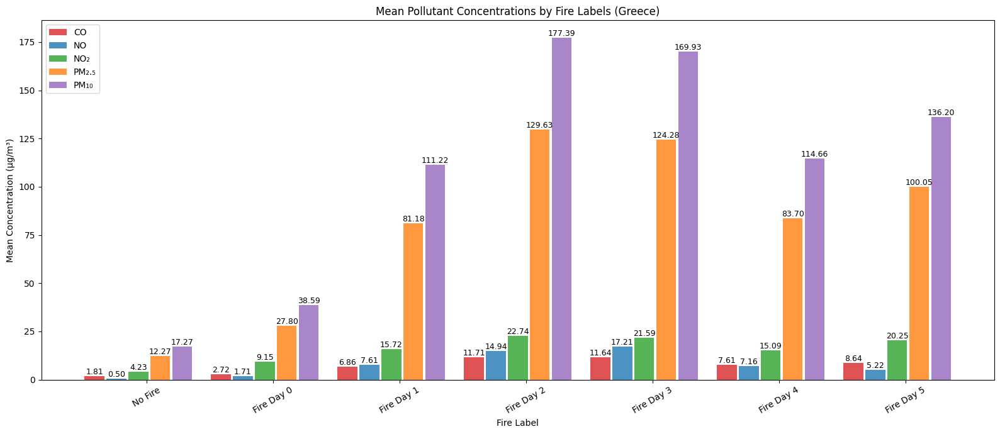

In [29]:
import xarray as xr
import matplotlib.pyplot as plt
import numpy as np

# File paths
files = {
    'CO':     r"D:\IPMA\Results\co_fire_meteo_Greece.nc",
    'NO':     r"D:\IPMA\Results\no_fire_meteo_Greece.nc",
    'NO₂':    r"D:\IPMA\Results\no2_fire_meteo_Greece.nc",
    'PM₂.₅':  r"D:\IPMA\Results\pm2p5_fire_meteo_Greece.nc",
    'PM₁₀':   r"D:\IPMA\Results\pm10_fire_meteo_Greece.nc"  
}

# Fire labels
label_map = {
    0: "No Fire",
    1: "Fire Day 0",
    2: "Fire Day 1",
    3: "Fire Day 2",
    4: "Fire Day 3",
    5: "Fire Day 4",
    6: "Fire Day 5"
}
label_values = list(label_map.keys())
ordered_labels = list(label_map.values())

pollutants = list(files.keys())
n_labels = len(label_values)
n_pollutants = len(pollutants)

# Prepare mean data for each pollutant and label
means_by_pollutant_label = {p: [] for p in pollutants}

for pollutant_name, file_path in files.items():
    ds = xr.open_dataset(file_path)
    conc = ds['Mean'].transpose('time', 'latitude', 'longitude').values.flatten()

    # Convert CO from mg/m³ to µg/m³
    if pollutant_name == 'CO':
        conc = conc * 10
    
    labels = ds['fire_label_Greece'].values.flatten().astype(int)

    valid = ~np.isnan(conc) & ~np.isnan(labels)
    conc = conc[valid]
    labels = labels[valid]

    for lv in label_values:
        data_lv = conc[labels == lv]
        mean_val = np.nan if len(data_lv) == 0 else np.nanmean(data_lv)
        means_by_pollutant_label[pollutant_name].append(mean_val)

# Convert means to array for easier plotting
mean_matrix = np.array([means_by_pollutant_label[p] for p in pollutants])  # shape (pollutants, labels)

# Colorblind-friendly colors for pollutants
pollutant_colors = {
    'CO': 'tab:red',
    'NO': 'tab:blue',
    'NO₂': 'tab:green',
    'PM₂.₅': 'tab:orange',
    'PM₁₀': 'tab:purple'
}

# Plot grouped bar chart
fig, ax = plt.subplots(figsize=(16, 7))
bar_width = 0.13
group_width = n_pollutants * bar_width + 0.1

# x-ticks positions for bar groups
xticks_pos = [i * group_width + (group_width - bar_width)/2 for i in range(n_labels)]

# Plot bars
for j, pollutant_name in enumerate(pollutants):
    pos = [i * group_width + j * bar_width for i in range(n_labels)]
    color = pollutant_colors[pollutant_name]
    bars = ax.bar(pos, mean_matrix[j], width=bar_width*0.9, label=pollutant_name, color=color, alpha=0.8)
    
    # Add numbers on top of each bar
    for bar in bars:
        height = bar.get_height()
        if not np.isnan(height):
            ax.text(bar.get_x() + bar.get_width()/2, height, f"{height:.2f}", ha='center', va='bottom', fontsize=9)

# Labels and title
ax.set_xticks(xticks_pos)
ax.set_xticklabels(ordered_labels, rotation=30)
ax.set_ylabel("Mean Concentration (µg/m³)")
ax.set_xlabel("Fire Label")
ax.set_title("Mean Pollutant Concentrations by Fire Labels (Greece)")

# Legend
ax.legend(loc='upper left')
ax.grid(False)
plt.tight_layout()
plt.show()


### Iberia

C:\Users\sofia\AppData\Local\Temp\ipykernel_16176\4173749006.py:37: RuntimeWarning: invalid value encountered in cast
  labels = ds['fire_label_Iberia'].values.flatten().astype(int)
C:\Users\sofia\AppData\Local\Temp\ipykernel_16176\4173749006.py:37: RuntimeWarning: invalid value encountered in cast
  labels = ds['fire_label_Iberia'].values.flatten().astype(int)
C:\Users\sofia\AppData\Local\Temp\ipykernel_16176\4173749006.py:37: RuntimeWarning: invalid value encountered in cast
  labels = ds['fire_label_Iberia'].values.flatten().astype(int)
C:\Users\sofia\AppData\Local\Temp\ipykernel_16176\4173749006.py:37: RuntimeWarning: invalid value encountered in cast
  labels = ds['fire_label_Iberia'].values.flatten().astype(int)
C:\Users\sofia\AppData\Local\Temp\ipykernel_16176\4173749006.py:37: RuntimeWarning: invalid value encountered in cast
  labels = ds['fire_label_Iberia'].values.flatten().astype(int)


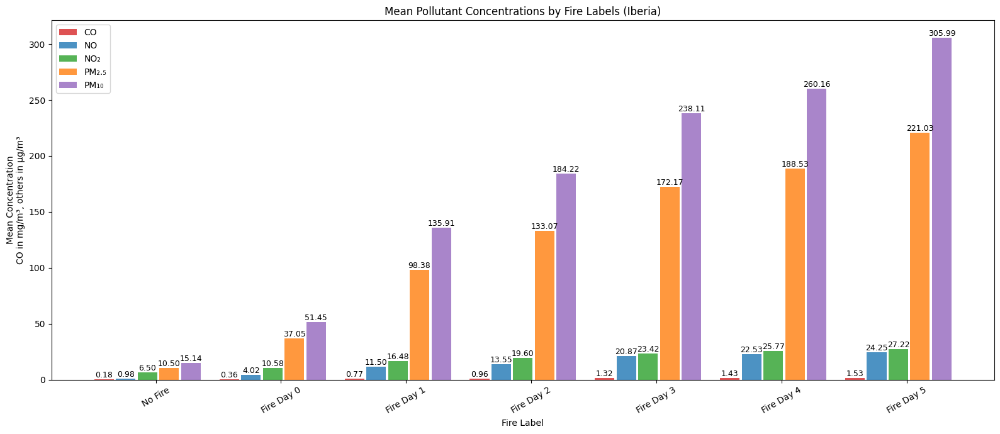

In [30]:
import xarray as xr
import matplotlib.pyplot as plt
import numpy as np

# File paths
files = {
    'CO':     r"D:\IPMA\Results\co_fire_meteo_Iberia.nc",
    'NO':     r"D:\IPMA\Results\no_fire_meteo_Iberia.nc",
    'NO₂':    r"D:\IPMA\Results\no2_fire_meteo_Iberia.nc",
    'PM₂.₅':  r"D:\IPMA\Results\pm2p5_fire_meteo_Iberia.nc",
    'PM₁₀':   r"D:\IPMA\Results\pm10_fire_meteo_Iberia.nc"     
}

# Fire labels
label_map = {
    0: "No Fire",
    1: "Fire Day 0",
    2: "Fire Day 1",
    3: "Fire Day 2",
    4: "Fire Day 3",
    5: "Fire Day 4",
    6: "Fire Day 5"
}
label_values = list(label_map.keys())
ordered_labels = list(label_map.values())

pollutants = list(files.keys())
n_labels = len(label_values)
n_pollutants = len(pollutants)

# Prepare mean data for each pollutant and label
means_by_pollutant_label = {p: [] for p in pollutants}

for pollutant_name, file_path in files.items():
    ds = xr.open_dataset(file_path)
    conc = ds['Mean'].transpose('time', 'latitude', 'longitude').values.flatten()
    labels = ds['fire_label_Iberia'].values.flatten().astype(int)

    valid = ~np.isnan(conc) & ~np.isnan(labels)
    conc = conc[valid]
    labels = labels[valid]

    for lv in label_values:
        data_lv = conc[labels == lv]
        mean_val = np.nan if len(data_lv) == 0 else np.nanmean(data_lv)
        means_by_pollutant_label[pollutant_name].append(mean_val)

# Convert means to array for easier plotting
mean_matrix = np.array([means_by_pollutant_label[p] for p in pollutants])  # shape (pollutants, labels)

# Colorblind-friendly colors for pollutants
pollutant_colors = {
    'CO': 'tab:red',
    'NO': 'tab:blue',
    'NO₂': 'tab:green',
    'PM₂.₅': 'tab:orange',
    'PM₁₀': 'tab:purple'
}

# Plot grouped bar chart
fig, ax = plt.subplots(figsize=(16, 7))
bar_width = 0.13
group_width = n_pollutants * bar_width + 0.1

# x-ticks positions for bar groups
xticks_pos = [i * group_width + (group_width - bar_width)/2 for i in range(n_labels)]

# Plot bars
for j, pollutant_name in enumerate(pollutants):
    pos = [i * group_width + j * bar_width for i in range(n_labels)]
    color = pollutant_colors[pollutant_name]
    bars = ax.bar(pos, mean_matrix[j], width=bar_width*0.9, label=pollutant_name, color=color, alpha=0.8)
    
    # Add numbers on top of each bar
    for bar in bars:
        height = bar.get_height()
        if not np.isnan(height):
            ax.text(bar.get_x() + bar.get_width()/2, height, f"{height:.2f}", ha='center', va='bottom', fontsize=9)

# Labels and title
ax.set_xticks(xticks_pos)
ax.set_xticklabels(ordered_labels, rotation=30)
ax.set_ylabel("Mean Concentration\nCO in mg/m³, others in µg/m³")
ax.set_xlabel("Fire Label")
ax.set_title("Mean Pollutant Concentrations by Fire Labels (Iberia)")

# Move legend to left
ax.legend(loc='upper left')
ax.grid(False)
plt.tight_layout()
plt.show()

C:\Users\sofia\AppData\Local\Temp\ipykernel_16176\2372331054.py:42: RuntimeWarning: invalid value encountered in cast
  labels = ds['fire_label_Iberia'].values.flatten().astype(int)
C:\Users\sofia\AppData\Local\Temp\ipykernel_16176\2372331054.py:42: RuntimeWarning: invalid value encountered in cast
  labels = ds['fire_label_Iberia'].values.flatten().astype(int)
C:\Users\sofia\AppData\Local\Temp\ipykernel_16176\2372331054.py:42: RuntimeWarning: invalid value encountered in cast
  labels = ds['fire_label_Iberia'].values.flatten().astype(int)
C:\Users\sofia\AppData\Local\Temp\ipykernel_16176\2372331054.py:42: RuntimeWarning: invalid value encountered in cast
  labels = ds['fire_label_Iberia'].values.flatten().astype(int)
C:\Users\sofia\AppData\Local\Temp\ipykernel_16176\2372331054.py:42: RuntimeWarning: invalid value encountered in cast
  labels = ds['fire_label_Iberia'].values.flatten().astype(int)


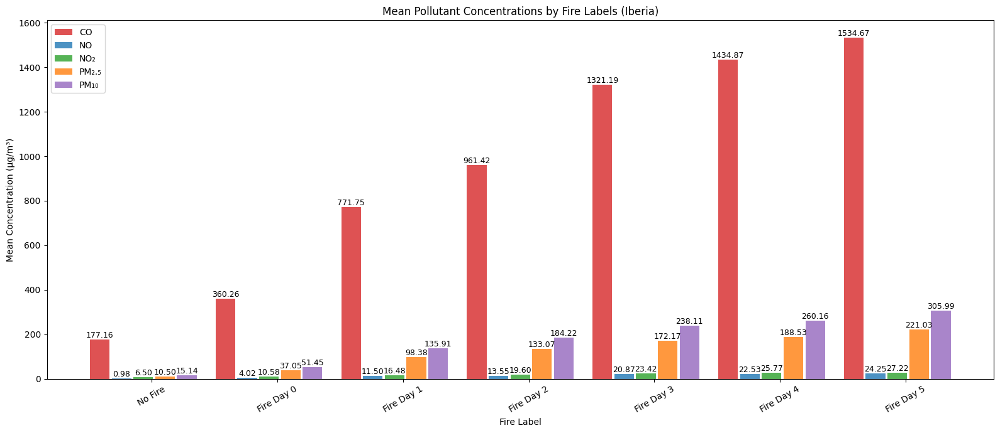

In [31]:
import xarray as xr
import matplotlib.pyplot as plt
import numpy as np

# File paths
files = {
    'CO':     r"D:\IPMA\Results\co_fire_meteo_Iberia.nc",
    'NO':     r"D:\IPMA\Results\no_fire_meteo_Iberia.nc",
    'NO₂':    r"D:\IPMA\Results\no2_fire_meteo_Iberia.nc",
    'PM₂.₅':  r"D:\IPMA\Results\pm2p5_fire_meteo_Iberia.nc",
    'PM₁₀':   r"D:\IPMA\Results\pm10_fire_meteo_Iberia.nc"   
}

# Fire labels
label_map = {
    0: "No Fire",
    1: "Fire Day 0",
    2: "Fire Day 1",
    3: "Fire Day 2",
    4: "Fire Day 3",
    5: "Fire Day 4",
    6: "Fire Day 5"
}
label_values = list(label_map.keys())
ordered_labels = list(label_map.values())

pollutants = list(files.keys())
n_labels = len(label_values)
n_pollutants = len(pollutants)

# Prepare mean data for each pollutant and label
means_by_pollutant_label = {p: [] for p in pollutants}

for pollutant_name, file_path in files.items():
    ds = xr.open_dataset(file_path)
    conc = ds['Mean'].transpose('time', 'latitude', 'longitude').values.flatten()

    # Convert CO from mg/m³ to µg/m³
    if pollutant_name == 'CO':
        conc = conc * 1000
    
    labels = ds['fire_label_Iberia'].values.flatten().astype(int)

    valid = ~np.isnan(conc) & ~np.isnan(labels)
    conc = conc[valid]
    labels = labels[valid]

    for lv in label_values:
        data_lv = conc[labels == lv]
        mean_val = np.nan if len(data_lv) == 0 else np.nanmean(data_lv)
        means_by_pollutant_label[pollutant_name].append(mean_val)

# Convert means to array for easier plotting
mean_matrix = np.array([means_by_pollutant_label[p] for p in pollutants])  # shape (pollutants, labels)

# Colorblind-friendly colors for pollutants
pollutant_colors = {
    'CO': 'tab:red',
    'NO': 'tab:blue',
    'NO₂': 'tab:green',
    'PM₂.₅': 'tab:orange',
    'PM₁₀': 'tab:purple'
}

# Plot grouped bar chart
fig, ax = plt.subplots(figsize=(16, 7))
bar_width = 0.13
group_width = n_pollutants * bar_width + 0.1

# x-ticks positions for bar groups
xticks_pos = [i * group_width + (group_width - bar_width)/2 for i in range(n_labels)]

# Plot bars
for j, pollutant_name in enumerate(pollutants):
    pos = [i * group_width + j * bar_width for i in range(n_labels)]
    color = pollutant_colors[pollutant_name]
    bars = ax.bar(pos, mean_matrix[j], width=bar_width*0.9, label=pollutant_name, color=color, alpha=0.8)
    
    # Add numbers on top of each bar
    for bar in bars:
        height = bar.get_height()
        if not np.isnan(height):
            ax.text(bar.get_x() + bar.get_width()/2, height, f"{height:.2f}", ha='center', va='bottom', fontsize=9)

# Labels and title
ax.set_xticks(xticks_pos)
ax.set_xticklabels(ordered_labels, rotation=30)
ax.set_ylabel("Mean Concentration (µg/m³)")
ax.set_xlabel("Fire Label")
ax.set_title("Mean Pollutant Concentrations by Fire Labels (Iberia)")

# Legend
ax.legend(loc='upper left')
ax.grid(False)
plt.tight_layout()
plt.show()


## Crossover of Meteo and FRP or Pollutants - Timeseries

### Portugal

#### All Years


Plotting: Total Precipitation (m) (mean)


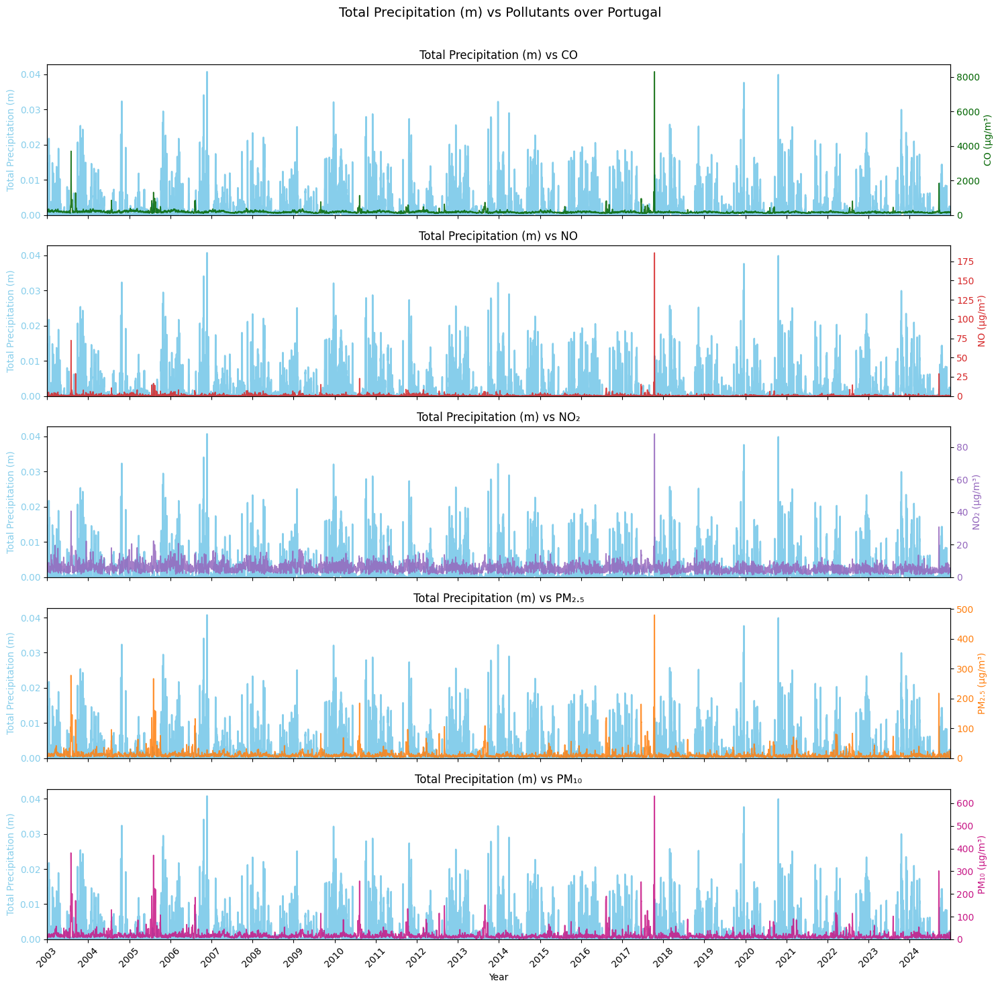


Plotting: Max Temperature (°C) (mean)


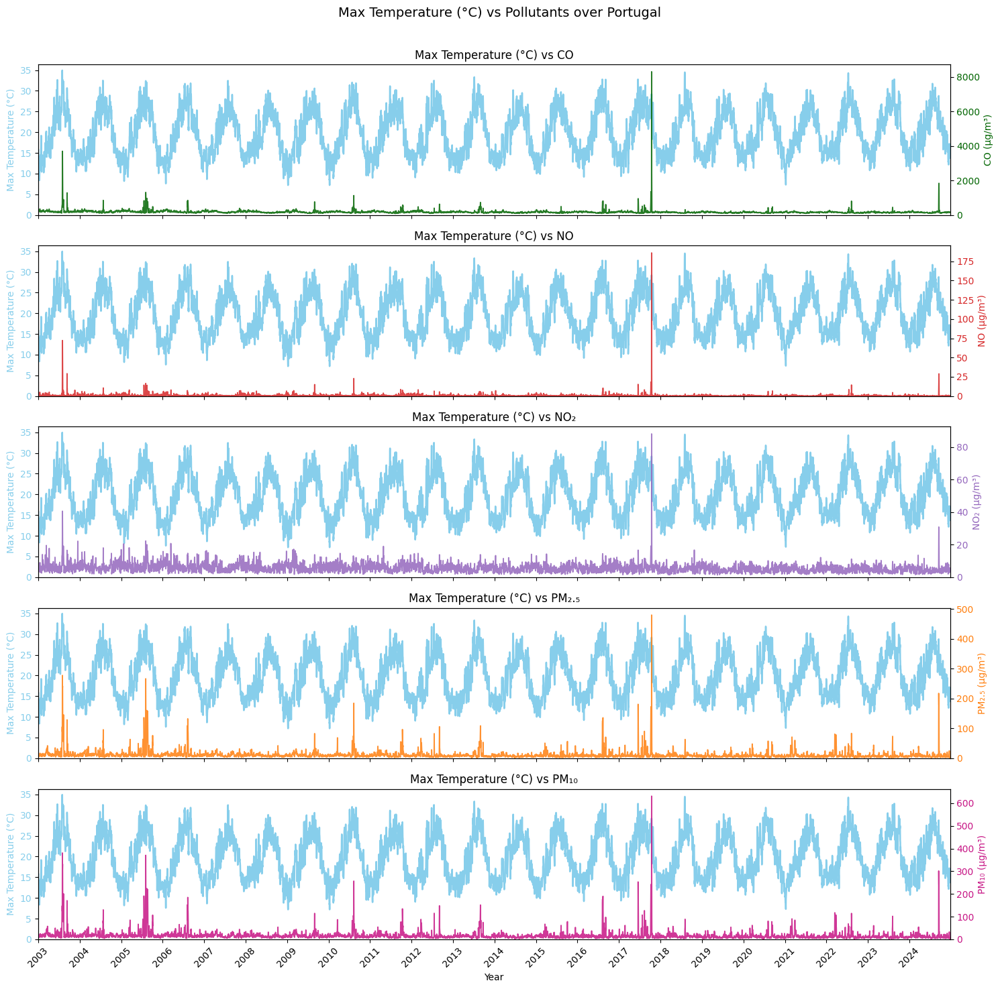


Plotting: Max Wind Speed (m/s) (mean)


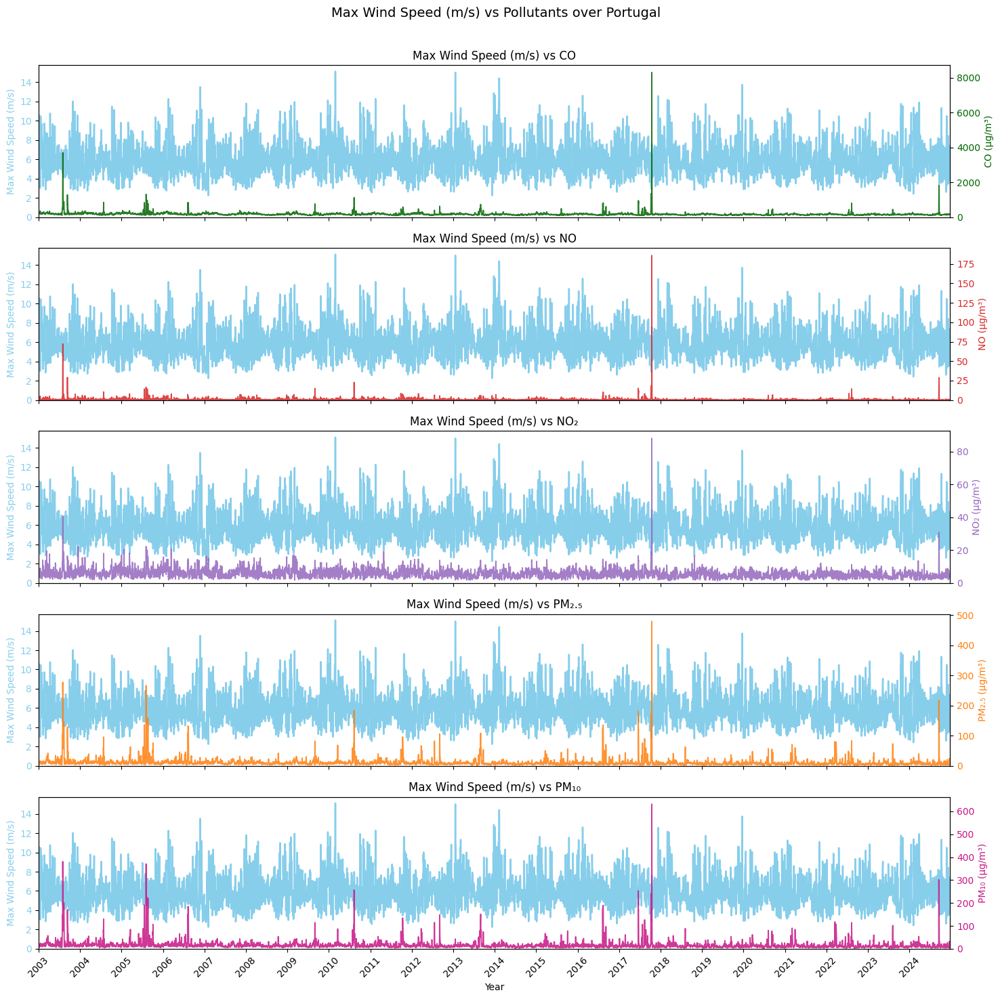

In [32]:
import xarray as xr
import matplotlib.pyplot as plt
import pandas as pd

# ============================================================
# Choose mode: "FRP" or "POLLUTANTS"
# ============================================================
mode = "POLLUTANTS" 

# ============================================================
# File paths for each pollutant
# ============================================================
files = {
    'CO':     r"D:\IPMA\Results\co_fire_meteo_Portugal.nc",
    'NO':     r"D:\IPMA\Results\no_fire_meteo_Portugal.nc",
    'NO₂':    r"D:\IPMA\Results\no2_fire_meteo_Portugal.nc",
    'PM₂.₅':  r"D:\IPMA\Results\pm2p5_fire_meteo_Portugal.nc",
    'PM₁₀':   r"D:\IPMA\Results\pm10_fire_meteo_Portugal.nc"
}

# ============================================================
# Units for pollutants
# ============================================================
units = {
    'CO': 'µg/m³',
    'NO': 'µg/m³',
    'NO₂': 'µg/m³',
    'PM₂.₅': 'µg/m³',
    'PM₁₀': 'µg/m³'
}

# ============================================================
# Selected meteorological variables (Label, Statistic)
# Options for statistic: 'mean', 'sum', 'max', 'min', 'median'
# ============================================================
meteo_vars = {
    'precip_Total_Precipitation': ('Total Precipitation (m)', 'mean'),
    'temp_Max': ('Max Temperature (°C)', 'mean'),
    'wind_Max': ('Max Wind Speed (m/s)', 'mean')
}

# ============================================================
# Load a sample dataset (same meteo vars in all)
# ============================================================
sample_file = list(files.values())[0]
ds_sample = xr.open_dataset(sample_file)
time = ds_sample.time
tmin, tmax = pd.to_datetime(time.min().values), pd.to_datetime(time.max().values)

# ============================================================
# Define colors
# ============================================================
meteo_color = 'skyblue'
frp_color = 'crimson'
pollutant_colors = {
    'CO': 'darkgreen',
    'NO': 'tab:red',
    'NO₂': 'tab:purple',
    'PM₂.₅': 'tab:orange',
    'PM₁₀': 'mediumvioletred'
}

# ============================================================
# Prepare x-axis: all years
# ============================================================
years = pd.to_datetime(time.values).year
unique_years = sorted(list(set(years)))
xticks = [time.values[years.tolist().index(y)] for y in unique_years]

# ============================================================
# Main loop: one figure per METEO variable
# ============================================================
for var_name, (label, stat) in meteo_vars.items():
    print(f"\nPlotting: {label} ({stat})")

    # Spatial statistic of the meteorological variable
    da = ds_sample[var_name]
    if stat == 'mean':
        meteo = da.mean(dim=['latitude', 'longitude'])
    elif stat == 'sum':
        meteo = da.sum(dim=['latitude', 'longitude'])
    elif stat == 'max':
        meteo = da.max(dim=['latitude', 'longitude'])
    elif stat == 'min':
        meteo = da.min(dim=['latitude', 'longitude'])
    elif stat == 'median':
        meteo = da.median(dim=['latitude', 'longitude'])
    else:
        raise ValueError(f"Unsupported stat '{stat}' for variable '{var_name}'")

    # ========================================================
    # MODE 1: FRP comparison
    # ========================================================
    if mode == "FRP":
        fig, ax = plt.subplots(figsize=(15, 4))
        ax.plot(time, meteo, color=meteo_color, linewidth=1.8, label=f"{label} ({stat})")
        ax.set_ylabel(label, color=meteo_color)
        ax.tick_params(axis='y', labelcolor=meteo_color)

        frp = ds_sample['frp_sum_Portugal'].mean(dim=['latitude', 'longitude'])
        ax2 = ax.twinx()
        ax2.plot(time, frp, color=frp_color, alpha=0.8, linewidth=1.5, label='FRP (MW)')
        ax2.set_ylabel('FRP (MW)', color=frp_color)
        ax2.tick_params(axis='y', labelcolor=frp_color)

        # Formatting
        ax.set_ylim(bottom=0)
        ax2.set_ylim(bottom=0)
        ax.set_xlim([tmin, tmax])
        ax.set_xticks(xticks)
        ax.set_xticklabels(unique_years, rotation=45)
        ax.set_xlabel('Year')
        ax.set_title(f'{label} vs FRP over Portugal')
        ax.grid(False)
        plt.tight_layout()
        plt.show()

    # ========================================================
    # MODE 2: Pollutant comparison
    # ========================================================
    elif mode == "POLLUTANTS":
        n_pollutants = len(files)
        fig, axs = plt.subplots(n_pollutants, 1, figsize=(15, 3 * n_pollutants), sharex=True)
        fig.suptitle(f'{label} vs Pollutants over Portugal', fontsize=14)

        for ax, (pollutant_name, file_path) in zip(axs, files.items()):
            ds = xr.open_dataset(file_path)
            pollutant = ds['Mean'].mean(dim=['latitude', 'longitude'])
            if pollutant_name == 'CO':
                pollutant *= 1000  # mg/m³ → µg/m³

            # Meteo (left y-axis)
            ax.plot(time, meteo, color=meteo_color, linewidth=1.8, label=f"{label} ({stat})")
            ax.set_ylabel(label, color=meteo_color)
            ax.tick_params(axis='y', labelcolor=meteo_color)

            # Pollutant (right y-axis)
            color = pollutant_colors.get(pollutant_name, 'tab:blue')
            ax2 = ax.twinx()
            ax2.plot(time, pollutant, color=color, alpha=0.85, linewidth=1.3,
                     label=f'{pollutant_name} ({units[pollutant_name]})')
            ax2.set_ylabel(f'{pollutant_name} ({units[pollutant_name]})', color=color)
            ax2.tick_params(axis='y', labelcolor=color)

            # Formatting
            ax.set_ylim(bottom=0)
            ax2.set_ylim(bottom=0)
            ax.set_xlim([tmin, tmax])
            ax.set_xticks(xticks)
            ax.set_xticklabels(unique_years, rotation=45)
            ax.set_title(f'{label} vs {pollutant_name}')
            ax.grid(False)

        axs[-1].set_xlabel('Year')
        plt.tight_layout(rect=[0, 0, 1, 0.97])
        plt.show()



Plotting: Total Precipitation (m) (mean)


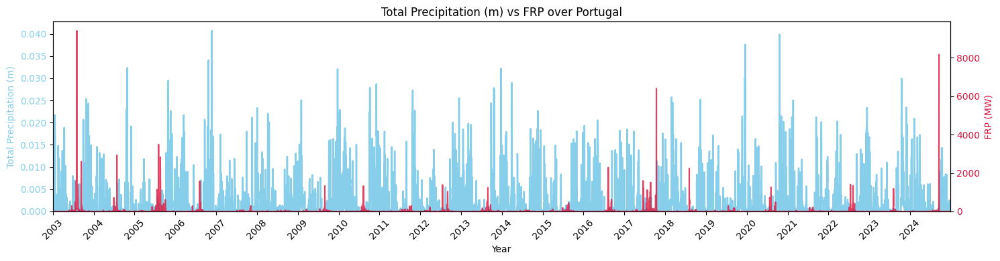


Plotting: Max Temperature (°C) (mean)


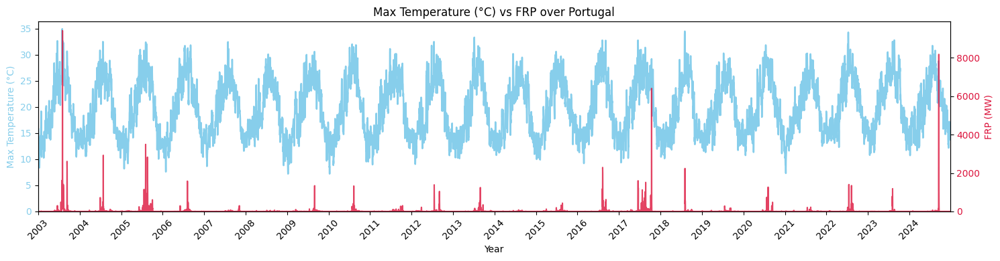


Plotting: Max Wind Speed (m/s) (mean)


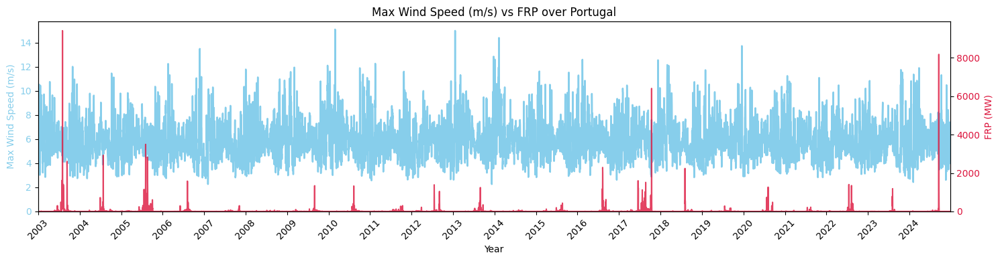

In [33]:
import xarray as xr
import matplotlib.pyplot as plt
import pandas as pd

# ============================================================
# Choose mode: "FRP" or "POLLUTANTS"
# ============================================================
mode = "FRP" 

# ============================================================
# File paths for each pollutant
# ============================================================
files = {
    'CO':     r"D:\IPMA\Results\co_fire_meteo_Portugal.nc",
    'NO':     r"D:\IPMA\Results\no_fire_meteo_Portugal.nc",
    'NO₂':    r"D:\IPMA\Results\no2_fire_meteo_Portugal.nc",
    'PM₂.₅':  r"D:\IPMA\Results\pm2p5_fire_meteo_Portugal.nc",
    'PM₁₀':   r"D:\IPMA\Results\pm10_fire_meteo_Portugal.nc"
}

# ============================================================
# Units for pollutants
# ============================================================
units = {
    'CO': 'µg/m³',
    'NO': 'µg/m³',
    'NO₂': 'µg/m³',
    'PM₂.₅': 'µg/m³',
    'PM₁₀': 'µg/m³'
}

# ============================================================
# Selected meteorological variables (Label, Statistic)
# Options for statistic: 'mean', 'sum', 'max', 'min', 'median'
# ============================================================
meteo_vars = {
    'precip_Total_Precipitation': ('Total Precipitation (m)', 'mean'),
    'temp_Max': ('Max Temperature (°C)', 'mean'),
    'wind_Max': ('Max Wind Speed (m/s)', 'mean')
}

# ============================================================
# Load a sample dataset (same meteo vars in all)
# ============================================================
sample_file = list(files.values())[0]
ds_sample = xr.open_dataset(sample_file)
time = ds_sample.time
tmin, tmax = pd.to_datetime(time.min().values), pd.to_datetime(time.max().values)

# ============================================================
# Define colors
# ============================================================
meteo_color = 'skyblue'
frp_color = 'crimson'
pollutant_colors = {
    'CO': 'darkgreen',
    'NO': 'tab:red',
    'NO₂': 'tab:purple',
    'PM₂.₅': 'tab:orange',
    'PM₁₀': 'mediumvioletred'
}

# ============================================================
# Prepare x-axis: all years
# ============================================================
years = pd.to_datetime(time.values).year
unique_years = sorted(list(set(years)))
xticks = [time.values[years.tolist().index(y)] for y in unique_years]

# ============================================================
# Main loop: one figure per METEO variable
# ============================================================
for var_name, (label, stat) in meteo_vars.items():
    print(f"\nPlotting: {label} ({stat})")

    # Spatial statistic of the meteorological variable
    da = ds_sample[var_name]
    if stat == 'mean':
        meteo = da.mean(dim=['latitude', 'longitude'])
    elif stat == 'sum':
        meteo = da.sum(dim=['latitude', 'longitude'])
    elif stat == 'max':
        meteo = da.max(dim=['latitude', 'longitude'])
    elif stat == 'min':
        meteo = da.min(dim=['latitude', 'longitude'])
    elif stat == 'median':
        meteo = da.median(dim=['latitude', 'longitude'])
    else:
        raise ValueError(f"Unsupported stat '{stat}' for variable '{var_name}'")

    # ========================================================
    # MODE 1: FRP comparison
    # ========================================================
    if mode == "FRP":
        fig, ax = plt.subplots(figsize=(15, 4))
        ax.plot(time, meteo, color=meteo_color, linewidth=1.8, label=f"{label} ({stat})")
        ax.set_ylabel(label, color=meteo_color)
        ax.tick_params(axis='y', labelcolor=meteo_color)

        frp = ds_sample['frp_sum_Portugal'].mean(dim=['latitude', 'longitude'])
        ax2 = ax.twinx()
        ax2.plot(time, frp, color=frp_color, alpha=0.8, linewidth=1.5, label='FRP (MW)')
        ax2.set_ylabel('FRP (MW)', color=frp_color)
        ax2.tick_params(axis='y', labelcolor=frp_color)

        # Formatting
        ax.set_ylim(bottom=0)
        ax2.set_ylim(bottom=0)
        ax.set_xlim([tmin, tmax])
        ax.set_xticks(xticks)
        ax.set_xticklabels(unique_years, rotation=45)
        ax.set_xlabel('Year')
        ax.set_title(f'{label} vs FRP over Portugal')
        ax.grid(False)
        plt.tight_layout()
        plt.show()

    # ========================================================
    # MODE 2: Pollutant comparison
    # ========================================================
    elif mode == "POLLUTANTS":
        n_pollutants = len(files)
        fig, axs = plt.subplots(n_pollutants, 1, figsize=(15, 3 * n_pollutants), sharex=True)
        fig.suptitle(f'{label} vs Pollutants over Portugal', fontsize=14)

        for ax, (pollutant_name, file_path) in zip(axs, files.items()):
            ds = xr.open_dataset(file_path)
            pollutant = ds['Mean'].mean(dim=['latitude', 'longitude'])
            if pollutant_name == 'CO':
                pollutant *= 1000  # mg/m³ → µg/m³

            # Meteo (left y-axis)
            ax.plot(time, meteo, color=meteo_color, linewidth=1.8, label=f"{label} ({stat})")
            ax.set_ylabel(label, color=meteo_color)
            ax.tick_params(axis='y', labelcolor=meteo_color)

            # Pollutant (right y-axis)
            color = pollutant_colors.get(pollutant_name, 'tab:blue')
            ax2 = ax.twinx()
            ax2.plot(time, pollutant, color=color, alpha=0.85, linewidth=1.3,
                     label=f'{pollutant_name} ({units[pollutant_name]})')
            ax2.set_ylabel(f'{pollutant_name} ({units[pollutant_name]})', color=color)
            ax2.tick_params(axis='y', labelcolor=color)

            # Formatting
            ax.set_ylim(bottom=0)
            ax2.set_ylim(bottom=0)
            ax.set_xlim([tmin, tmax])
            ax.set_xticks(xticks)
            ax.set_xticklabels(unique_years, rotation=45)
            ax.set_title(f'{label} vs {pollutant_name}')
            ax.grid(False)

        axs[-1].set_xlabel('Year')
        plt.tight_layout(rect=[0, 0, 1, 0.97])
        plt.show()


#### Certain Year


Plotting Total Precipitation (m) (mean) for 2017


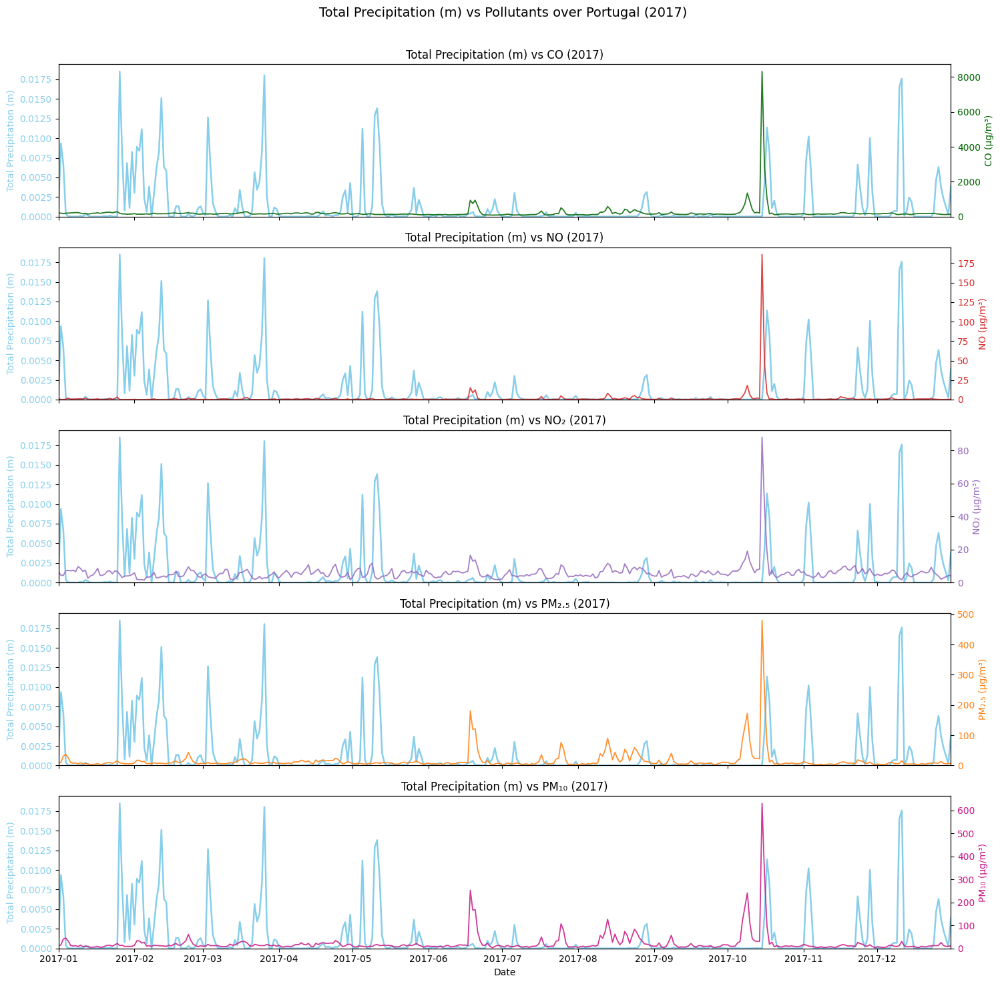


Plotting Max Temperature (°C) (mean) for 2017


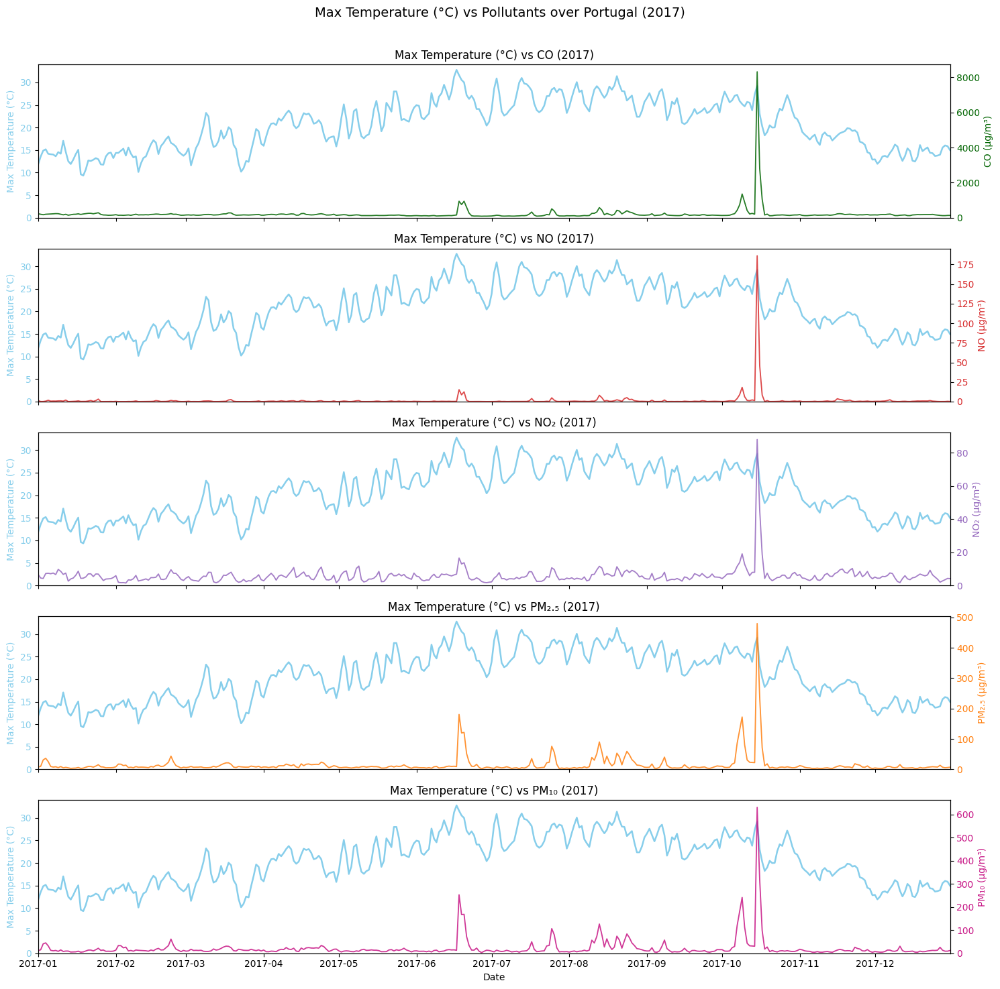


Plotting Max Wind Speed (m/s) (mean) for 2017


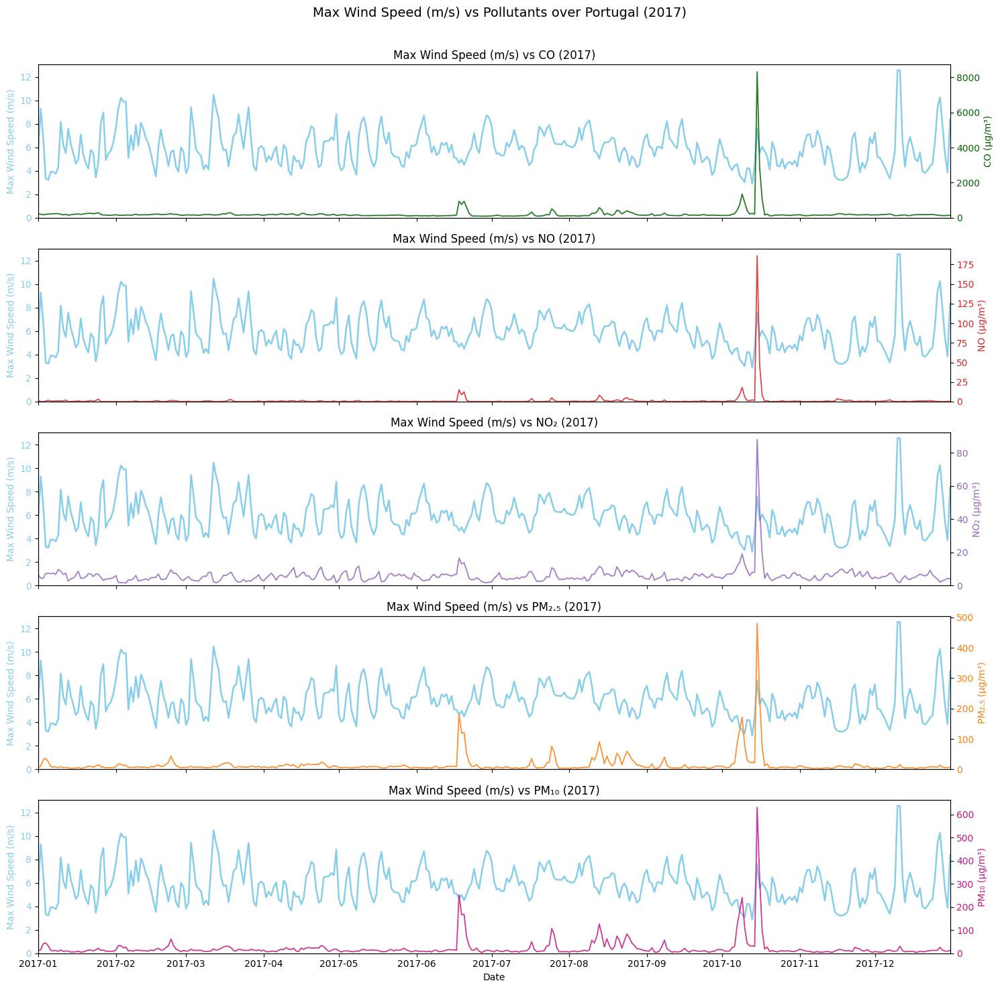

In [34]:
import xarray as xr
import matplotlib.pyplot as plt
import pandas as pd

# ============================================================
# Choose mode: "FRP" or "POLLUTANTS"
# ============================================================
mode = "POLLUTANTS" 

# ============================================================
# Choose which year to plot
# ============================================================
selected_year = 2017  # <<<<<< CHANGE THIS to select another year

# ============================================================
# File paths for each pollutant
# ============================================================
files = {
    'CO':     r"D:\IPMA\Results\co_fire_meteo_Portugal.nc",
    'NO':     r"D:\IPMA\Results\no_fire_meteo_Portugal.nc",
    'NO₂':    r"D:\IPMA\Results\no2_fire_meteo_Portugal.nc",
    'PM₂.₅':  r"D:\IPMA\Results\pm2p5_fire_meteo_Portugal.nc",
    'PM₁₀':   r"D:\IPMA\Results\pm10_fire_meteo_Portugal.nc"
}

# ============================================================
# Units for pollutants
# ============================================================
units = {
    'CO': 'µg/m³',
    'NO': 'µg/m³',
    'NO₂': 'µg/m³',
    'PM₂.₅': 'µg/m³',
    'PM₁₀': 'µg/m³'
}

# ============================================================
# Selected meteorological variables (Label, Statistic)
# ============================================================
meteo_vars = {
    'precip_Total_Precipitation': ('Total Precipitation (m)', 'mean'),
    'temp_Max': ('Max Temperature (°C)', 'mean'),
    'wind_Max': ('Max Wind Speed (m/s)', 'mean')
}

# ============================================================
# Load a sample dataset (same meteo vars in all)
# ============================================================
sample_file = list(files.values())[0]
ds_sample = xr.open_dataset(sample_file)
time = pd.to_datetime(ds_sample.time.values)

# ============================================================
# Filter dataset for the selected year
# ============================================================
mask = time.year == selected_year
if not mask.any():
    raise ValueError(f"No data available for year {selected_year}. Available years: {sorted(set(time.year))}")
time = time[mask]
tmin, tmax = time.min(), time.max()

# ============================================================
# Define colors
# ============================================================
meteo_color = 'skyblue'
frp_color = 'crimson'
pollutant_colors = {
    'CO': 'darkgreen',
    'NO': 'tab:red',
    'NO₂': 'tab:purple',
    'PM₂.₅': 'tab:orange',
    'PM₁₀': 'mediumvioletred'
}

# ============================================================
# Main loop: one figure per METEO variable
# ============================================================
for var_name, (label, stat) in meteo_vars.items():
    print(f"\nPlotting {label} ({stat}) for {selected_year}")

    # Select and spatially aggregate meteorological variable
    da = ds_sample[var_name].isel(time=mask)
    if stat == 'mean':
        meteo = da.mean(dim=['latitude', 'longitude'])
    elif stat == 'sum':
        meteo = da.sum(dim=['latitude', 'longitude'])
    elif stat == 'max':
        meteo = da.max(dim=['latitude', 'longitude'])
    elif stat == 'min':
        meteo = da.min(dim=['latitude', 'longitude'])
    elif stat == 'median':
        meteo = da.median(dim=['latitude', 'longitude'])
    else:
        raise ValueError(f"Unsupported stat '{stat}' for variable '{var_name}'")

    # ========================================================
    # MODE 1: FRP comparison
    # ========================================================
    if mode == "FRP":
        fig, ax = plt.subplots(figsize=(15, 4))
        ax.plot(time, meteo, color=meteo_color, linewidth=1.8, label=f"{label} ({stat})")
        ax.set_ylabel(label, color=meteo_color)
        ax.tick_params(axis='y', labelcolor=meteo_color)

        frp = ds_sample['frp_sum_Portugal'].isel(time=mask).mean(dim=['latitude', 'longitude'])
        ax2 = ax.twinx()
        ax2.plot(time, frp, color=frp_color, alpha=0.8, linewidth=1.5, label='FRP (MW)')
        ax2.set_ylabel('FRP (MW)', color=frp_color)
        ax2.tick_params(axis='y', labelcolor=frp_color)

        ax.set_ylim(bottom=0)
        ax2.set_ylim(bottom=0)
        ax.set_xlim([tmin, tmax])
        ax.set_xlabel('Date')
        ax.set_title(f'{label} vs FRP over Portugal ({selected_year})')
        ax.grid(False)
        plt.tight_layout()
        plt.show()

    # ========================================================
    # MODE 2: Pollutant comparison
    # ========================================================
    elif mode == "POLLUTANTS":
        n_pollutants = len(files)
        fig, axs = plt.subplots(n_pollutants, 1, figsize=(15, 3 * n_pollutants), sharex=True)
        fig.suptitle(f'{label} vs Pollutants over Portugal ({selected_year})', fontsize=14)

        for ax, (pollutant_name, file_path) in zip(axs, files.items()):
            ds = xr.open_dataset(file_path)
            pollutant = ds['Mean'].isel(time=mask).mean(dim=['latitude', 'longitude'])
            if pollutant_name == 'CO':
                pollutant *= 1000  # mg/m³ → µg/m³

            ax.plot(time, meteo, color=meteo_color, linewidth=1.8, label=f"{label} ({stat})")
            ax.set_ylabel(label, color=meteo_color)
            ax.tick_params(axis='y', labelcolor=meteo_color)

            color = pollutant_colors.get(pollutant_name, 'tab:blue')
            ax2 = ax.twinx()
            ax2.plot(time, pollutant, color=color, alpha=0.85, linewidth=1.3,
                     label=f'{pollutant_name} ({units[pollutant_name]})')
            ax2.set_ylabel(f'{pollutant_name} ({units[pollutant_name]})', color=color)
            ax2.tick_params(axis='y', labelcolor=color)

            ax.set_ylim(bottom=0)
            ax2.set_ylim(bottom=0)
            ax.set_xlim([tmin, tmax])
            ax.set_title(f'{label} vs {pollutant_name} ({selected_year})')
            ax.grid(False)

        axs[-1].set_xlabel('Date')
        plt.tight_layout(rect=[0, 0, 1, 0.97])
        plt.show()



Plotting Total Precipitation (m) (mean) for 2017


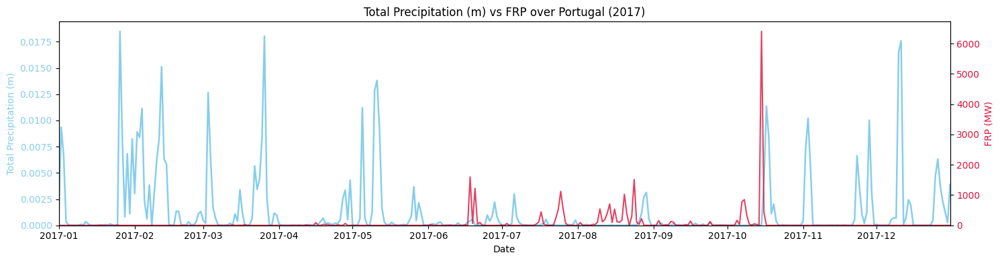


Plotting Max Temperature (°C) (mean) for 2017


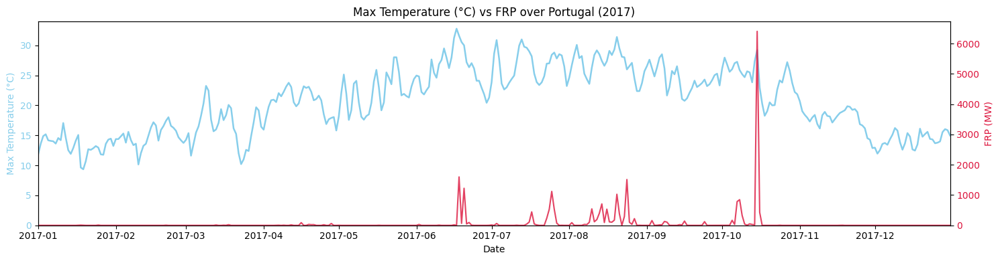


Plotting Max Wind Speed (m/s) (mean) for 2017


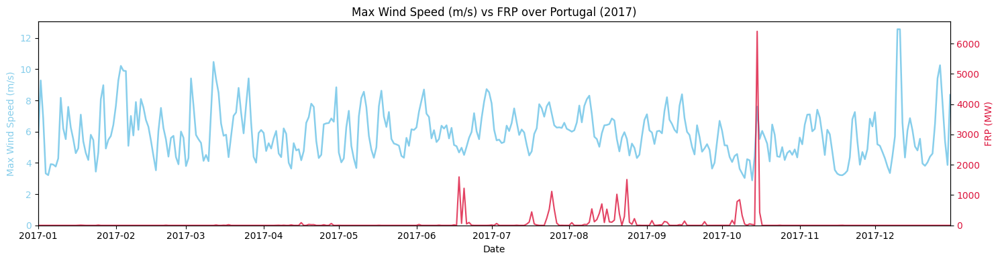

In [35]:
import xarray as xr
import matplotlib.pyplot as plt
import pandas as pd

# ============================================================
# Choose mode: "FRP" or "POLLUTANTS"
# ============================================================
mode = "FRP" 

# ============================================================
# Choose which year to plot
# ============================================================
selected_year = 2017  # <<<<<< CHANGE THIS to select another year

# ============================================================
# File paths for each pollutant
# ============================================================
files = {
    'CO':     r"D:\IPMA\Results\co_fire_meteo_Portugal.nc",
    'NO':     r"D:\IPMA\Results\no_fire_meteo_Portugal.nc",
    'NO₂':    r"D:\IPMA\Results\no2_fire_meteo_Portugal.nc",
    'PM₂.₅':  r"D:\IPMA\Results\pm2p5_fire_meteo_Portugal.nc",
    'PM₁₀':   r"D:\IPMA\Results\pm10_fire_meteo_Portugal.nc"
}

# ============================================================
# Units for pollutants
# ============================================================
units = {
    'CO': 'µg/m³',
    'NO': 'µg/m³',
    'NO₂': 'µg/m³',
    'PM₂.₅': 'µg/m³',
    'PM₁₀': 'µg/m³'
}

# ============================================================
# Selected meteorological variables (Label, Statistic)
# ============================================================
meteo_vars = {
    'precip_Total_Precipitation': ('Total Precipitation (m)', 'mean'),
    'temp_Max': ('Max Temperature (°C)', 'mean'),
    'wind_Max': ('Max Wind Speed (m/s)', 'mean')
}

# ============================================================
# Load a sample dataset (same meteo vars in all)
# ============================================================
sample_file = list(files.values())[0]
ds_sample = xr.open_dataset(sample_file)
time = pd.to_datetime(ds_sample.time.values)

# ============================================================
# Filter dataset for the selected year
# ============================================================
mask = time.year == selected_year
if not mask.any():
    raise ValueError(f"No data available for year {selected_year}. Available years: {sorted(set(time.year))}")
time = time[mask]
tmin, tmax = time.min(), time.max()

# ============================================================
# Define colors
# ============================================================
meteo_color = 'skyblue'
frp_color = 'crimson'
pollutant_colors = {
    'CO': 'darkgreen',
    'NO': 'tab:red',
    'NO₂': 'tab:purple',
    'PM₂.₅': 'tab:orange',
    'PM₁₀': 'mediumvioletred'
}

# ============================================================
# Main loop: one figure per METEO variable
# ============================================================
for var_name, (label, stat) in meteo_vars.items():
    print(f"\nPlotting {label} ({stat}) for {selected_year}")

    # Select and spatially aggregate meteorological variable
    da = ds_sample[var_name].isel(time=mask)
    if stat == 'mean':
        meteo = da.mean(dim=['latitude', 'longitude'])
    elif stat == 'sum':
        meteo = da.sum(dim=['latitude', 'longitude'])
    elif stat == 'max':
        meteo = da.max(dim=['latitude', 'longitude'])
    elif stat == 'min':
        meteo = da.min(dim=['latitude', 'longitude'])
    elif stat == 'median':
        meteo = da.median(dim=['latitude', 'longitude'])
    else:
        raise ValueError(f"Unsupported stat '{stat}' for variable '{var_name}'")

    # ========================================================
    # MODE 1: FRP comparison
    # ========================================================
    if mode == "FRP":
        fig, ax = plt.subplots(figsize=(15, 4))
        ax.plot(time, meteo, color=meteo_color, linewidth=1.8, label=f"{label} ({stat})")
        ax.set_ylabel(label, color=meteo_color)
        ax.tick_params(axis='y', labelcolor=meteo_color)

        frp = ds_sample['frp_sum_Portugal'].isel(time=mask).mean(dim=['latitude', 'longitude'])
        ax2 = ax.twinx()
        ax2.plot(time, frp, color=frp_color, alpha=0.8, linewidth=1.5, label='FRP (MW)')
        ax2.set_ylabel('FRP (MW)', color=frp_color)
        ax2.tick_params(axis='y', labelcolor=frp_color)

        ax.set_ylim(bottom=0)
        ax2.set_ylim(bottom=0)
        ax.set_xlim([tmin, tmax])
        ax.set_xlabel('Date')
        ax.set_title(f'{label} vs FRP over Portugal ({selected_year})')
        ax.grid(False)
        plt.tight_layout()
        plt.show()

    # ========================================================
    # MODE 2: Pollutant comparison
    # ========================================================
    elif mode == "POLLUTANTS":
        n_pollutants = len(files)
        fig, axs = plt.subplots(n_pollutants, 1, figsize=(15, 3 * n_pollutants), sharex=True)
        fig.suptitle(f'{label} vs Pollutants over Portugal ({selected_year})', fontsize=14)

        for ax, (pollutant_name, file_path) in zip(axs, files.items()):
            ds = xr.open_dataset(file_path)
            pollutant = ds['Mean'].isel(time=mask).mean(dim=['latitude', 'longitude'])
            if pollutant_name == 'CO':
                pollutant *= 1000  # mg/m³ → µg/m³

            ax.plot(time, meteo, color=meteo_color, linewidth=1.8, label=f"{label} ({stat})")
            ax.set_ylabel(label, color=meteo_color)
            ax.tick_params(axis='y', labelcolor=meteo_color)

            color = pollutant_colors.get(pollutant_name, 'tab:blue')
            ax2 = ax.twinx()
            ax2.plot(time, pollutant, color=color, alpha=0.85, linewidth=1.3,
                     label=f'{pollutant_name} ({units[pollutant_name]})')
            ax2.set_ylabel(f'{pollutant_name} ({units[pollutant_name]})', color=color)
            ax2.tick_params(axis='y', labelcolor=color)

            ax.set_ylim(bottom=0)
            ax2.set_ylim(bottom=0)
            ax.set_xlim([tmin, tmax])
            ax.set_title(f'{label} vs {pollutant_name} ({selected_year})')
            ax.grid(False)

        axs[-1].set_xlabel('Date')
        plt.tight_layout(rect=[0, 0, 1, 0.97])
        plt.show()


### Spain

#### All Years


Plotting: Total Precipitation (m) (mean)


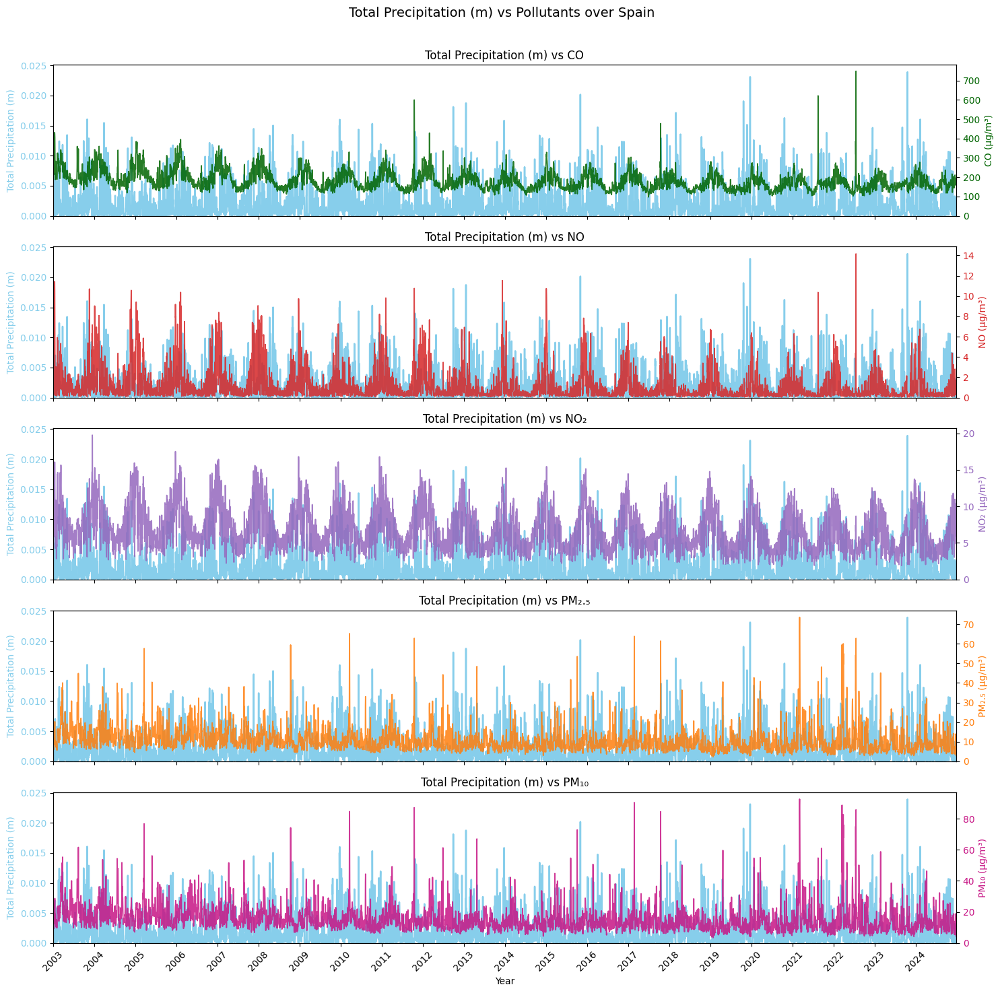


Plotting: Max Temperature (°C) (mean)


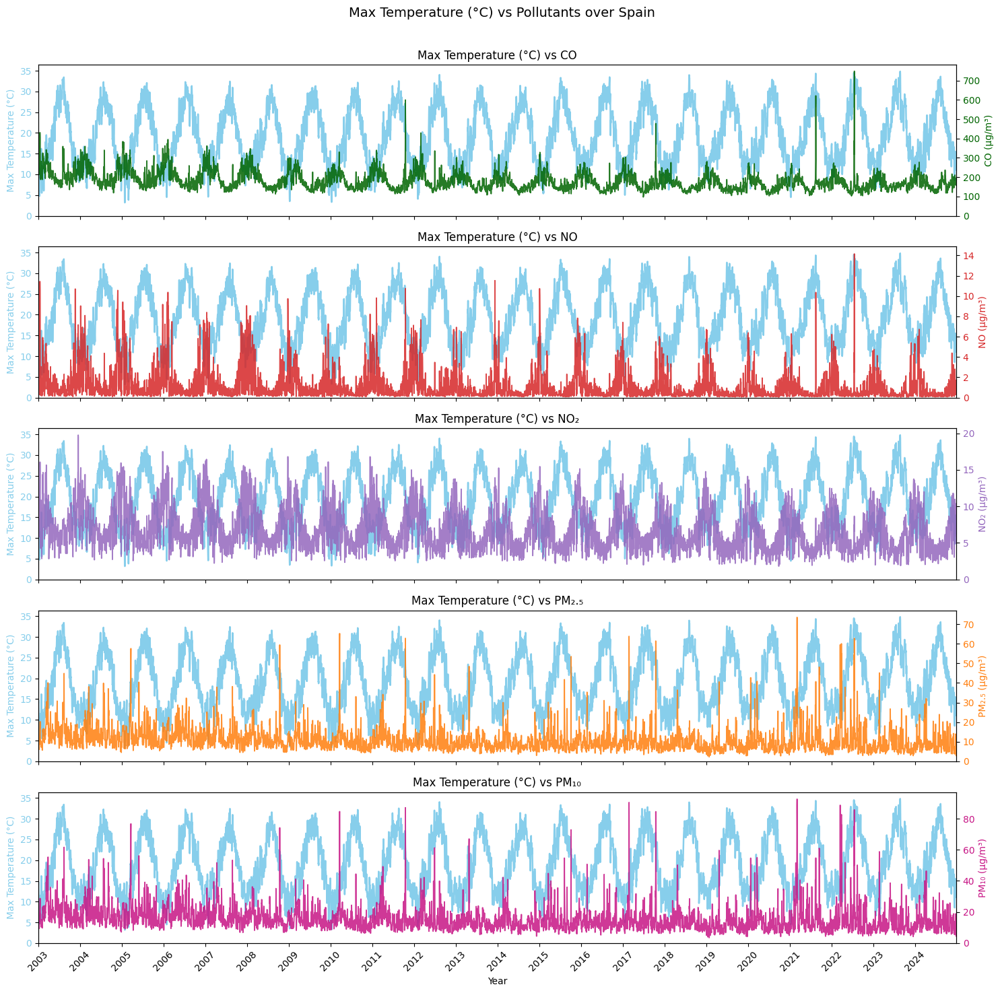


Plotting: Max Wind Speed (m/s) (mean)


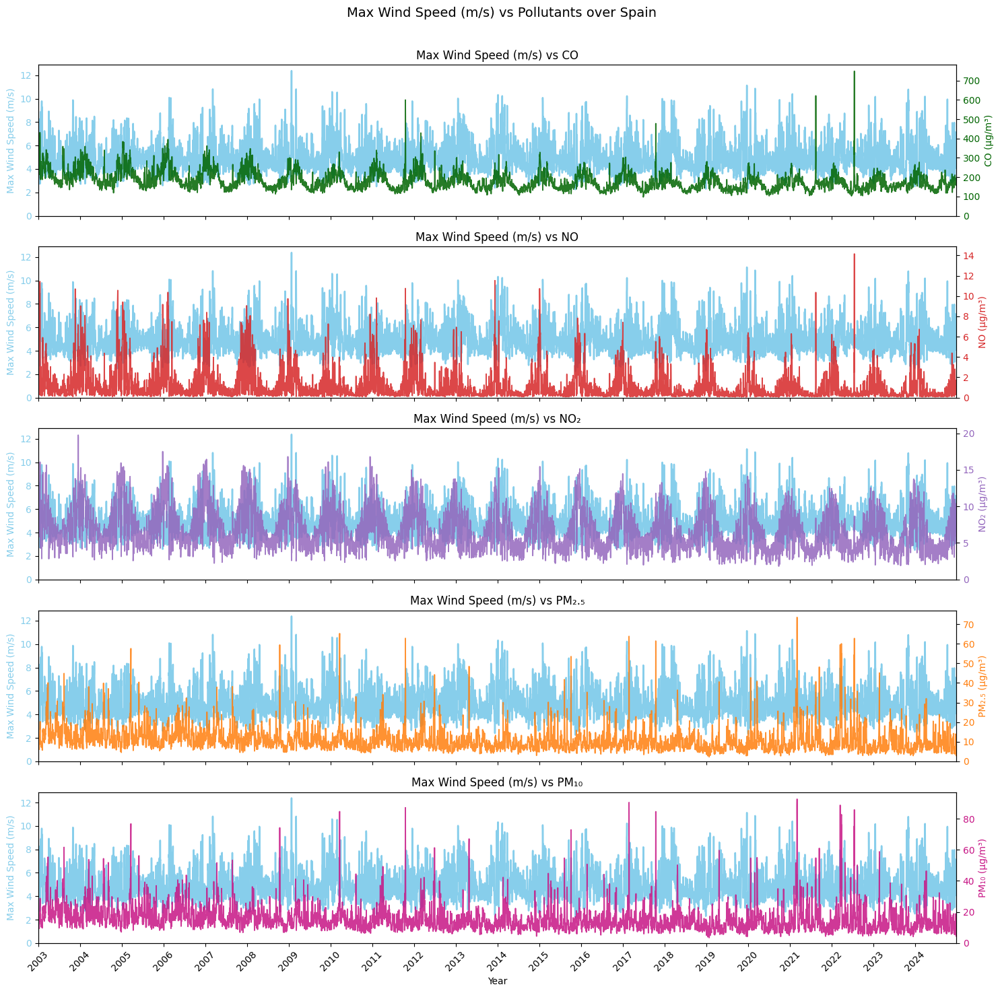

In [36]:
import xarray as xr
import matplotlib.pyplot as plt
import pandas as pd

# ============================================================
# Choose mode: "FRP" or "POLLUTANTS"
# ============================================================
mode = "POLLUTANTS" 

# ============================================================
# File paths for each pollutant
# ============================================================
files = {
    'CO':     r"D:\IPMA\Results\co_fire_meteo_Spain.nc",
    'NO':     r"D:\IPMA\Results\no_fire_meteo_Spain.nc",
    'NO₂':    r"D:\IPMA\Results\no2_fire_meteo_Spain.nc",
    'PM₂.₅':  r"D:\IPMA\Results\pm2p5_fire_meteo_Spain.nc",
    'PM₁₀':   r"D:\IPMA\Results\pm10_fire_meteo_Spain.nc"
}

# ============================================================
# Units for pollutants
# ============================================================
units = {
    'CO': 'µg/m³',
    'NO': 'µg/m³',
    'NO₂': 'µg/m³',
    'PM₂.₅': 'µg/m³',
    'PM₁₀': 'µg/m³'
}

# ============================================================
# Selected meteorological variables (Label, Statistic)
# Options for statistic: 'mean', 'sum', 'max', 'min', 'median'
# ============================================================
meteo_vars = {
    'precip_Total_Precipitation': ('Total Precipitation (m)', 'mean'),
    'temp_Max': ('Max Temperature (°C)', 'mean'),
    'wind_Max': ('Max Wind Speed (m/s)', 'mean')
}

# ============================================================
# Load a sample dataset (same meteo vars in all)
# ============================================================
sample_file = list(files.values())[0]
ds_sample = xr.open_dataset(sample_file)
time = ds_sample.time
tmin, tmax = pd.to_datetime(time.min().values), pd.to_datetime(time.max().values)

# ============================================================
# Define colors
# ============================================================
meteo_color = 'skyblue'
frp_color = 'crimson'
pollutant_colors = {
    'CO': 'darkgreen',
    'NO': 'tab:red',
    'NO₂': 'tab:purple',
    'PM₂.₅': 'tab:orange',
    'PM₁₀': 'mediumvioletred'
}

# ============================================================
# Prepare x-axis: all years
# ============================================================
years = pd.to_datetime(time.values).year
unique_years = sorted(list(set(years)))
xticks = [time.values[years.tolist().index(y)] for y in unique_years]

# ============================================================
# Main loop: one figure per METEO variable
# ============================================================
for var_name, (label, stat) in meteo_vars.items():
    print(f"\nPlotting: {label} ({stat})")

    # Spatial statistic of the meteorological variable
    da = ds_sample[var_name]
    if stat == 'mean':
        meteo = da.mean(dim=['latitude', 'longitude'])
    elif stat == 'sum':
        meteo = da.sum(dim=['latitude', 'longitude'])
    elif stat == 'max':
        meteo = da.max(dim=['latitude', 'longitude'])
    elif stat == 'min':
        meteo = da.min(dim=['latitude', 'longitude'])
    elif stat == 'median':
        meteo = da.median(dim=['latitude', 'longitude'])
    else:
        raise ValueError(f"Unsupported stat '{stat}' for variable '{var_name}'")

    # ========================================================
    # MODE 1: FRP comparison
    # ========================================================
    if mode == "FRP":
        fig, ax = plt.subplots(figsize=(15, 4))
        ax.plot(time, meteo, color=meteo_color, linewidth=1.8, label=f"{label} ({stat})")
        ax.set_ylabel(label, color=meteo_color)
        ax.tick_params(axis='y', labelcolor=meteo_color)

        frp = ds_sample['frp_sum_Spain'].mean(dim=['latitude', 'longitude'])
        ax2 = ax.twinx()
        ax2.plot(time, frp, color=frp_color, alpha=0.8, linewidth=1.5, label='FRP (MW)')
        ax2.set_ylabel('FRP (MW)', color=frp_color)
        ax2.tick_params(axis='y', labelcolor=frp_color)

        # Formatting
        ax.set_ylim(bottom=0)
        ax2.set_ylim(bottom=0)
        ax.set_xlim([tmin, tmax])
        ax.set_xticks(xticks)
        ax.set_xticklabels(unique_years, rotation=45)
        ax.set_xlabel('Year')
        ax.set_title(f'{label} vs FRP over Spain')
        ax.grid(False)
        plt.tight_layout()
        plt.show()

    # ========================================================
    # MODE 2: Pollutant comparison
    # ========================================================
    elif mode == "POLLUTANTS":
        n_pollutants = len(files)
        fig, axs = plt.subplots(n_pollutants, 1, figsize=(15, 3 * n_pollutants), sharex=True)
        fig.suptitle(f'{label} vs Pollutants over Spain', fontsize=14)

        for ax, (pollutant_name, file_path) in zip(axs, files.items()):
            ds = xr.open_dataset(file_path)
            pollutant = ds['Mean'].mean(dim=['latitude', 'longitude'])
            if pollutant_name == 'CO':
                pollutant *= 1000  # mg/m³ → µg/m³

            # Meteo (left y-axis)
            ax.plot(time, meteo, color=meteo_color, linewidth=1.8, label=f"{label} ({stat})")
            ax.set_ylabel(label, color=meteo_color)
            ax.tick_params(axis='y', labelcolor=meteo_color)

            # Pollutant (right y-axis)
            color = pollutant_colors.get(pollutant_name, 'tab:blue')
            ax2 = ax.twinx()
            ax2.plot(time, pollutant, color=color, alpha=0.85, linewidth=1.3,
                     label=f'{pollutant_name} ({units[pollutant_name]})')
            ax2.set_ylabel(f'{pollutant_name} ({units[pollutant_name]})', color=color)
            ax2.tick_params(axis='y', labelcolor=color)

            # Formatting
            ax.set_ylim(bottom=0)
            ax2.set_ylim(bottom=0)
            ax.set_xlim([tmin, tmax])
            ax.set_xticks(xticks)
            ax.set_xticklabels(unique_years, rotation=45)
            ax.set_title(f'{label} vs {pollutant_name}')
            ax.grid(False)

        axs[-1].set_xlabel('Year')
        plt.tight_layout(rect=[0, 0, 1, 0.97])
        plt.show()



Plotting: Total Precipitation (m) (mean)


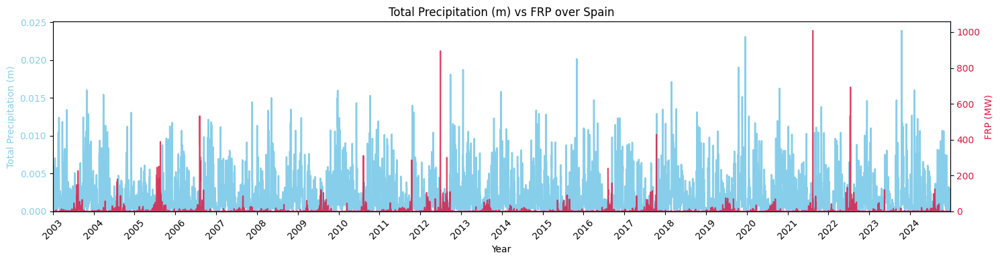


Plotting: Max Temperature (°C) (mean)


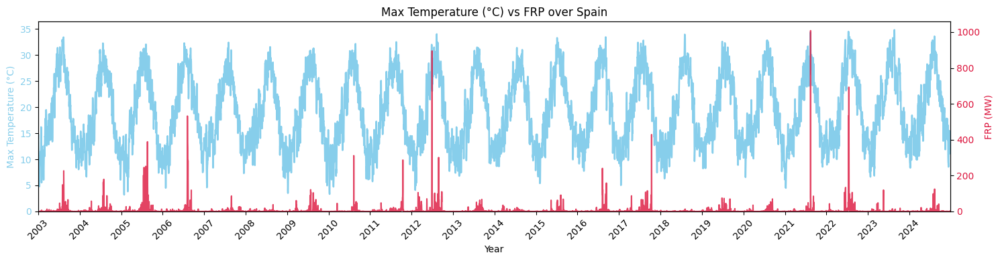


Plotting: Max Wind Speed (m/s) (mean)


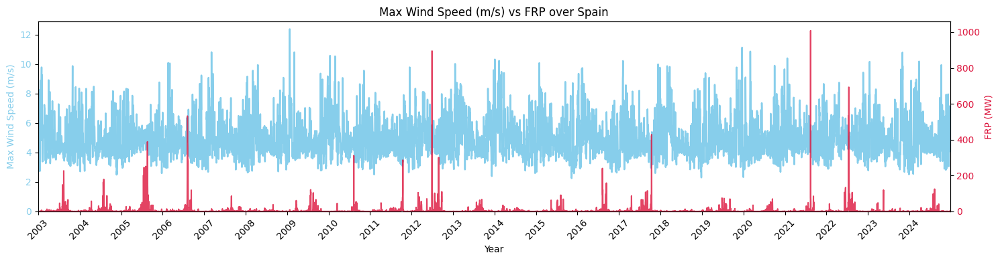

In [37]:
import xarray as xr
import matplotlib.pyplot as plt
import pandas as pd

# ============================================================
# Choose mode: "FRP" or "POLLUTANTS"
# ============================================================
mode = "FRP" 

# ============================================================
# File paths for each pollutant
# ============================================================
files = {
    'CO':     r"D:\IPMA\Results\co_fire_meteo_Spain.nc",
    'NO':     r"D:\IPMA\Results\no_fire_meteo_Spain.nc",
    'NO₂':    r"D:\IPMA\Results\no2_fire_meteo_Spain.nc",
    'PM₂.₅':  r"D:\IPMA\Results\pm2p5_fire_meteo_Spain.nc",
    'PM₁₀':   r"D:\IPMA\Results\pm10_fire_meteo_Spain.nc"
}

# ============================================================
# Units for pollutants
# ============================================================
units = {
    'CO': 'µg/m³',
    'NO': 'µg/m³',
    'NO₂': 'µg/m³',
    'PM₂.₅': 'µg/m³',
    'PM₁₀': 'µg/m³'
}

# ============================================================
# Selected meteorological variables (Label, Statistic)
# Options for statistic: 'mean', 'sum', 'max', 'min', 'median'
# ============================================================
meteo_vars = {
    'precip_Total_Precipitation': ('Total Precipitation (m)', 'mean'),
    'temp_Max': ('Max Temperature (°C)', 'mean'),
    'wind_Max': ('Max Wind Speed (m/s)', 'mean')
}

# ============================================================
# Load a sample dataset (same meteo vars in all)
# ============================================================
sample_file = list(files.values())[0]
ds_sample = xr.open_dataset(sample_file)
time = ds_sample.time
tmin, tmax = pd.to_datetime(time.min().values), pd.to_datetime(time.max().values)

# ============================================================
# Define colors
# ============================================================
meteo_color = 'skyblue'
frp_color = 'crimson'
pollutant_colors = {
    'CO': 'darkgreen',
    'NO': 'tab:red',
    'NO₂': 'tab:purple',
    'PM₂.₅': 'tab:orange',
    'PM₁₀': 'mediumvioletred'
}

# ============================================================
# Prepare x-axis: all years
# ============================================================
years = pd.to_datetime(time.values).year
unique_years = sorted(list(set(years)))
xticks = [time.values[years.tolist().index(y)] for y in unique_years]

# ============================================================
# Main loop: one figure per METEO variable
# ============================================================
for var_name, (label, stat) in meteo_vars.items():
    print(f"\nPlotting: {label} ({stat})")

    # Spatial statistic of the meteorological variable
    da = ds_sample[var_name]
    if stat == 'mean':
        meteo = da.mean(dim=['latitude', 'longitude'])
    elif stat == 'sum':
        meteo = da.sum(dim=['latitude', 'longitude'])
    elif stat == 'max':
        meteo = da.max(dim=['latitude', 'longitude'])
    elif stat == 'min':
        meteo = da.min(dim=['latitude', 'longitude'])
    elif stat == 'median':
        meteo = da.median(dim=['latitude', 'longitude'])
    else:
        raise ValueError(f"Unsupported stat '{stat}' for variable '{var_name}'")

    # ========================================================
    # MODE 1: FRP comparison
    # ========================================================
    if mode == "FRP":
        fig, ax = plt.subplots(figsize=(15, 4))
        ax.plot(time, meteo, color=meteo_color, linewidth=1.8, label=f"{label} ({stat})")
        ax.set_ylabel(label, color=meteo_color)
        ax.tick_params(axis='y', labelcolor=meteo_color)

        frp = ds_sample['frp_sum_Spain'].mean(dim=['latitude', 'longitude'])
        ax2 = ax.twinx()
        ax2.plot(time, frp, color=frp_color, alpha=0.8, linewidth=1.5, label='FRP (MW)')
        ax2.set_ylabel('FRP (MW)', color=frp_color)
        ax2.tick_params(axis='y', labelcolor=frp_color)

        # Formatting
        ax.set_ylim(bottom=0)
        ax2.set_ylim(bottom=0)
        ax.set_xlim([tmin, tmax])
        ax.set_xticks(xticks)
        ax.set_xticklabels(unique_years, rotation=45)
        ax.set_xlabel('Year')
        ax.set_title(f'{label} vs FRP over Spain')
        ax.grid(False)
        plt.tight_layout()
        plt.show()

    # ========================================================
    # MODE 2: Pollutant comparison
    # ========================================================
    elif mode == "POLLUTANTS":
        n_pollutants = len(files)
        fig, axs = plt.subplots(n_pollutants, 1, figsize=(15, 3 * n_pollutants), sharex=True)
        fig.suptitle(f'{label} vs Pollutants over Spain', fontsize=14)

        for ax, (pollutant_name, file_path) in zip(axs, files.items()):
            ds = xr.open_dataset(file_path)
            pollutant = ds['Mean'].mean(dim=['latitude', 'longitude'])
            if pollutant_name == 'CO':
                pollutant *= 1000  # mg/m³ → µg/m³

            # Meteo (left y-axis)
            ax.plot(time, meteo, color=meteo_color, linewidth=1.8, label=f"{label} ({stat})")
            ax.set_ylabel(label, color=meteo_color)
            ax.tick_params(axis='y', labelcolor=meteo_color)

            # Pollutant (right y-axis)
            color = pollutant_colors.get(pollutant_name, 'tab:blue')
            ax2 = ax.twinx()
            ax2.plot(time, pollutant, color=color, alpha=0.85, linewidth=1.3,
                     label=f'{pollutant_name} ({units[pollutant_name]})')
            ax2.set_ylabel(f'{pollutant_name} ({units[pollutant_name]})', color=color)
            ax2.tick_params(axis='y', labelcolor=color)

            # Formatting
            ax.set_ylim(bottom=0)
            ax2.set_ylim(bottom=0)
            ax.set_xlim([tmin, tmax])
            ax.set_xticks(xticks)
            ax.set_xticklabels(unique_years, rotation=45)
            ax.set_title(f'{label} vs {pollutant_name}')
            ax.grid(False)

        axs[-1].set_xlabel('Year')
        plt.tight_layout(rect=[0, 0, 1, 0.97])
        plt.show()


#### Certain Year


Plotting Total Precipitation (m) (mean) for 2022


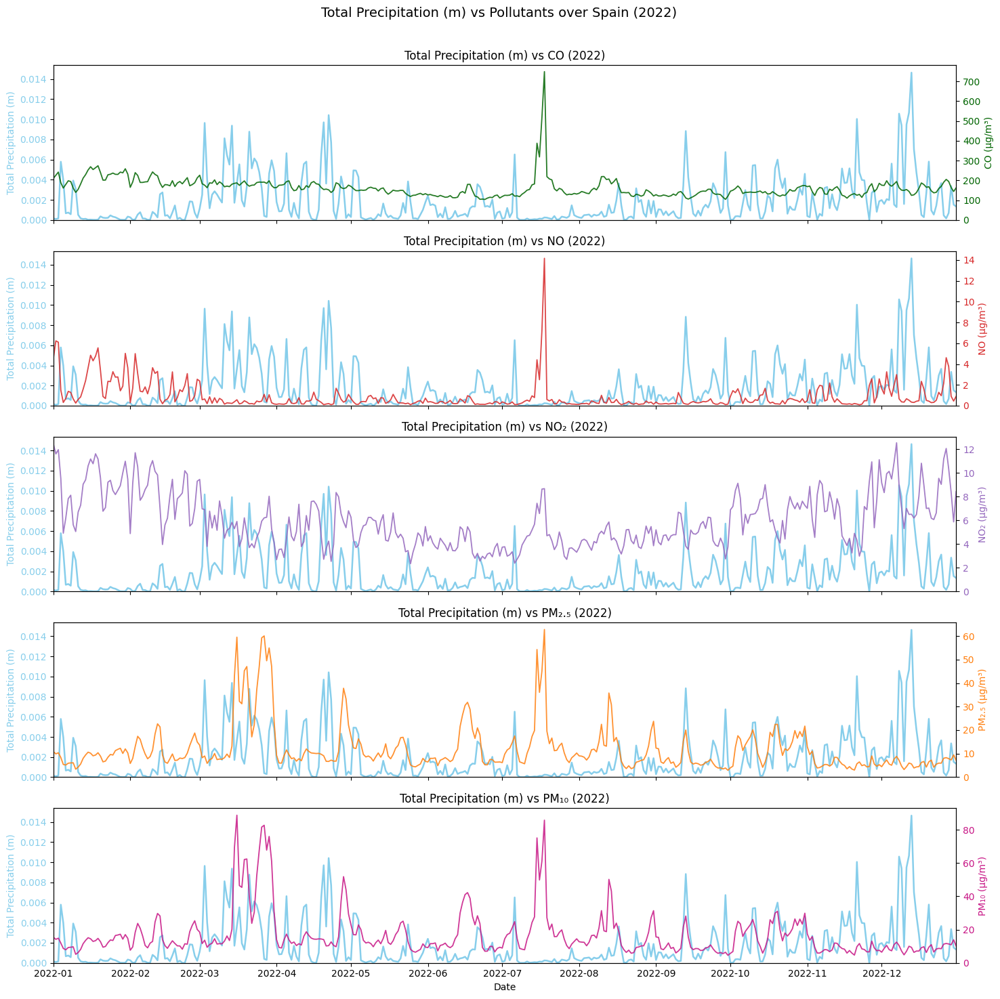


Plotting Max Temperature (°C) (mean) for 2022


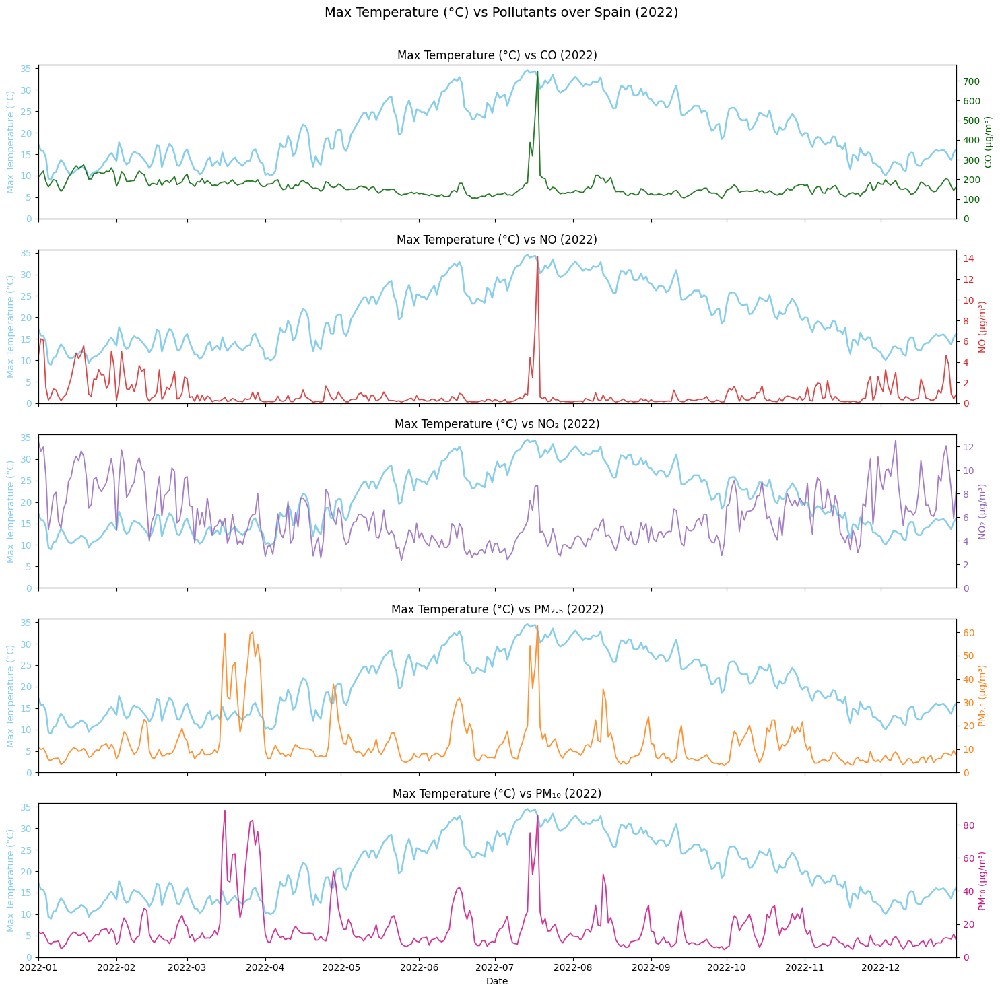


Plotting Max Wind Speed (m/s) (mean) for 2022


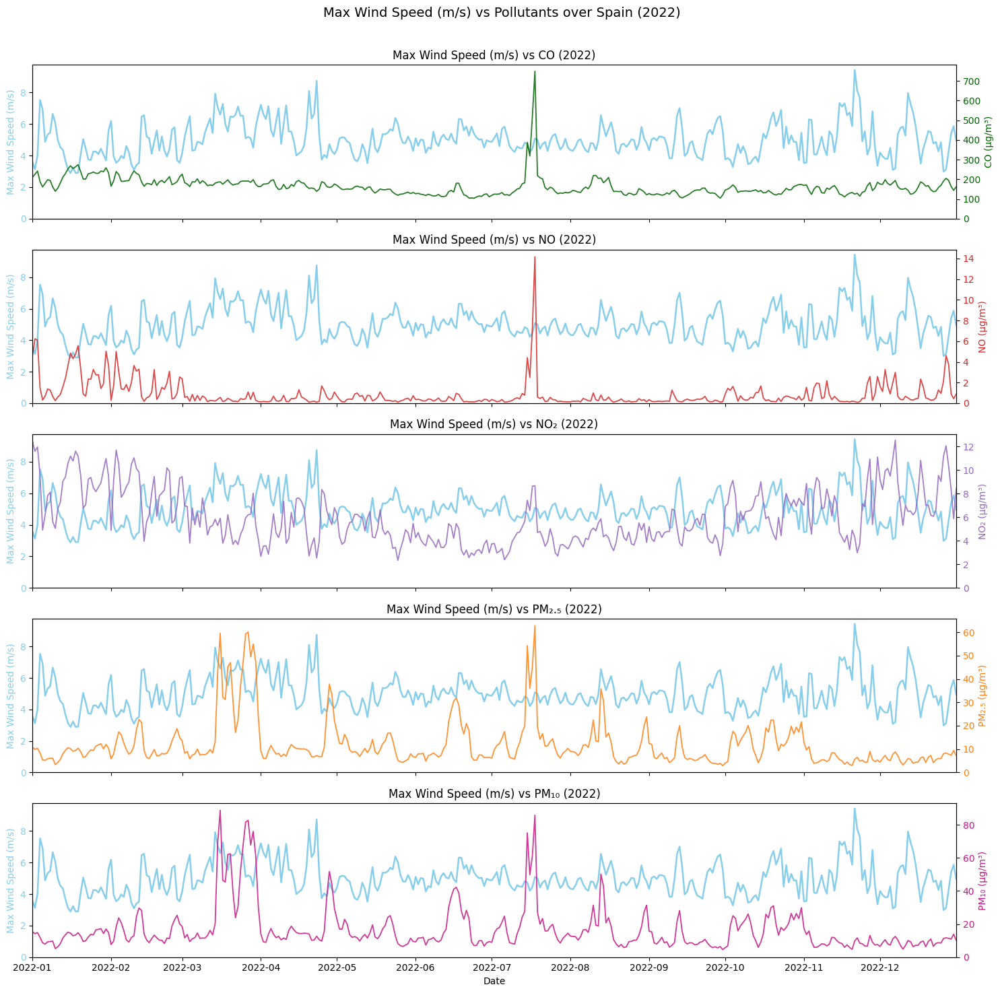

In [38]:
import xarray as xr
import matplotlib.pyplot as plt
import pandas as pd

# ============================================================
# Choose mode: "FRP" or "POLLUTANTS"
# ============================================================
mode = "POLLUTANTS" 

# ============================================================
# Choose which year to plot
# ============================================================
selected_year = 2022  # <<<<<< CHANGE THIS to select another year

# ============================================================
# File paths for each pollutant
# ============================================================
files = {
    'CO':     r"D:\IPMA\Results\co_fire_meteo_Spain.nc",
    'NO':     r"D:\IPMA\Results\no_fire_meteo_Spain.nc",
    'NO₂':    r"D:\IPMA\Results\no2_fire_meteo_Spain.nc",
    'PM₂.₅':  r"D:\IPMA\Results\pm2p5_fire_meteo_Spain.nc",
    'PM₁₀':   r"D:\IPMA\Results\pm10_fire_meteo_Spain.nc"
}

# ============================================================
# Units for pollutants
# ============================================================
units = {
    'CO': 'µg/m³',
    'NO': 'µg/m³',
    'NO₂': 'µg/m³',
    'PM₂.₅': 'µg/m³',
    'PM₁₀': 'µg/m³'
}

# ============================================================
# Selected meteorological variables (Label, Statistic)
# ============================================================
meteo_vars = {
    'precip_Total_Precipitation': ('Total Precipitation (m)', 'mean'),
    'temp_Max': ('Max Temperature (°C)', 'mean'),
    'wind_Max': ('Max Wind Speed (m/s)', 'mean')
}

# ============================================================
# Load a sample dataset (same meteo vars in all)
# ============================================================
sample_file = list(files.values())[0]
ds_sample = xr.open_dataset(sample_file)
time = pd.to_datetime(ds_sample.time.values)

# ============================================================
# Filter dataset for the selected year
# ============================================================
mask = time.year == selected_year
if not mask.any():
    raise ValueError(f"No data available for year {selected_year}. Available years: {sorted(set(time.year))}")
time = time[mask]
tmin, tmax = time.min(), time.max()

# ============================================================
# Define colors
# ============================================================
meteo_color = 'skyblue'
frp_color = 'crimson'
pollutant_colors = {
    'CO': 'darkgreen',
    'NO': 'tab:red',
    'NO₂': 'tab:purple',
    'PM₂.₅': 'tab:orange',
    'PM₁₀': 'mediumvioletred'
}

# ============================================================
# Main loop: one figure per METEO variable
# ============================================================
for var_name, (label, stat) in meteo_vars.items():
    print(f"\nPlotting {label} ({stat}) for {selected_year}")

    # Select and spatially aggregate meteorological variable
    da = ds_sample[var_name].isel(time=mask)
    if stat == 'mean':
        meteo = da.mean(dim=['latitude', 'longitude'])
    elif stat == 'sum':
        meteo = da.sum(dim=['latitude', 'longitude'])
    elif stat == 'max':
        meteo = da.max(dim=['latitude', 'longitude'])
    elif stat == 'min':
        meteo = da.min(dim=['latitude', 'longitude'])
    elif stat == 'median':
        meteo = da.median(dim=['latitude', 'longitude'])
    else:
        raise ValueError(f"Unsupported stat '{stat}' for variable '{var_name}'")

    # ========================================================
    # MODE 1: FRP comparison
    # ========================================================
    if mode == "FRP":
        fig, ax = plt.subplots(figsize=(15, 4))
        ax.plot(time, meteo, color=meteo_color, linewidth=1.8, label=f"{label} ({stat})")
        ax.set_ylabel(label, color=meteo_color)
        ax.tick_params(axis='y', labelcolor=meteo_color)

        frp = ds_sample['frp_sum_Spain'].isel(time=mask).mean(dim=['latitude', 'longitude'])
        ax2 = ax.twinx()
        ax2.plot(time, frp, color=frp_color, alpha=0.8, linewidth=1.5, label='FRP (MW)')
        ax2.set_ylabel('FRP (MW)', color=frp_color)
        ax2.tick_params(axis='y', labelcolor=frp_color)

        ax.set_ylim(bottom=0)
        ax2.set_ylim(bottom=0)
        ax.set_xlim([tmin, tmax])
        ax.set_xlabel('Date')
        ax.set_title(f'{label} vs FRP over Spain ({selected_year})')
        ax.grid(False)
        plt.tight_layout()
        plt.show()

    # ========================================================
    # MODE 2: Pollutant comparison
    # ========================================================
    elif mode == "POLLUTANTS":
        n_pollutants = len(files)
        fig, axs = plt.subplots(n_pollutants, 1, figsize=(15, 3 * n_pollutants), sharex=True)
        fig.suptitle(f'{label} vs Pollutants over Spain ({selected_year})', fontsize=14)

        for ax, (pollutant_name, file_path) in zip(axs, files.items()):
            ds = xr.open_dataset(file_path)
            pollutant = ds['Mean'].isel(time=mask).mean(dim=['latitude', 'longitude'])
            if pollutant_name == 'CO':
                pollutant *= 1000  # mg/m³ → µg/m³

            ax.plot(time, meteo, color=meteo_color, linewidth=1.8, label=f"{label} ({stat})")
            ax.set_ylabel(label, color=meteo_color)
            ax.tick_params(axis='y', labelcolor=meteo_color)

            color = pollutant_colors.get(pollutant_name, 'tab:blue')
            ax2 = ax.twinx()
            ax2.plot(time, pollutant, color=color, alpha=0.85, linewidth=1.3,
                     label=f'{pollutant_name} ({units[pollutant_name]})')
            ax2.set_ylabel(f'{pollutant_name} ({units[pollutant_name]})', color=color)
            ax2.tick_params(axis='y', labelcolor=color)

            ax.set_ylim(bottom=0)
            ax2.set_ylim(bottom=0)
            ax.set_xlim([tmin, tmax])
            ax.set_title(f'{label} vs {pollutant_name} ({selected_year})')
            ax.grid(False)

        axs[-1].set_xlabel('Date')
        plt.tight_layout(rect=[0, 0, 1, 0.97])
        plt.show()



Plotting Total Precipitation (m) (mean) for 2022


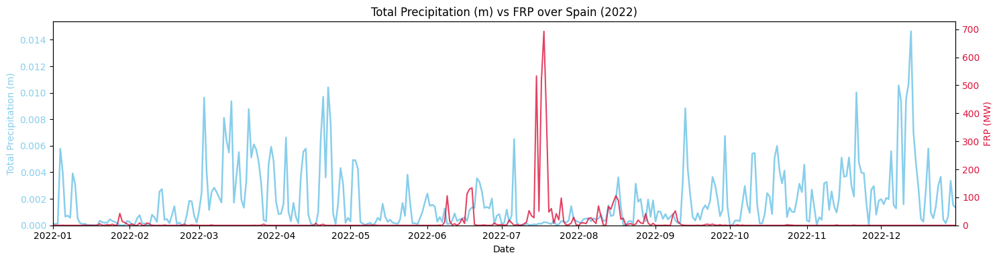


Plotting Max Temperature (°C) (mean) for 2022


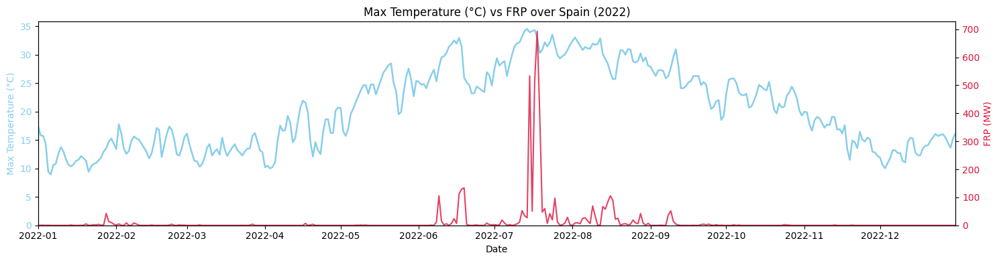


Plotting Max Wind Speed (m/s) (mean) for 2022


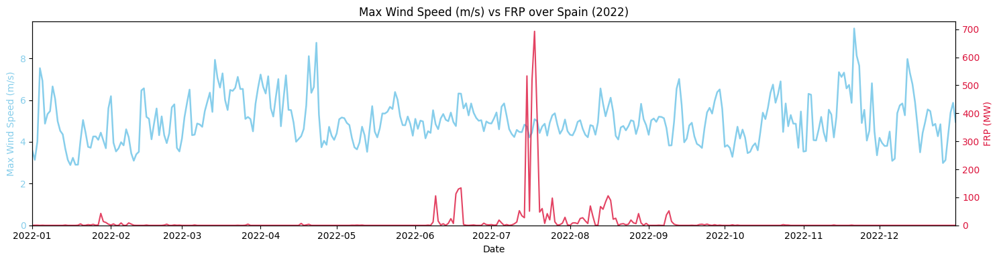

In [39]:
import xarray as xr
import matplotlib.pyplot as plt
import pandas as pd

# ============================================================
# Choose mode: "FRP" or "POLLUTANTS"
# ============================================================
mode = "FRP" 

# ============================================================
# Choose which year to plot
# ============================================================
selected_year = 2022  # <<<<<< CHANGE THIS to select another year

# ============================================================
# File paths for each pollutant
# ============================================================
files = {
    'CO':     r"D:\IPMA\Results\co_fire_meteo_Spain.nc",
    'NO':     r"D:\IPMA\Results\no_fire_meteo_Spain.nc",
    'NO₂':    r"D:\IPMA\Results\no2_fire_meteo_Spain.nc",
    'PM₂.₅':  r"D:\IPMA\Results\pm2p5_fire_meteo_Spain.nc",
    'PM₁₀':   r"D:\IPMA\Results\pm10_fire_meteo_Spain.nc"
}

# ============================================================
# Units for pollutants
# ============================================================
units = {
    'CO': 'µg/m³',
    'NO': 'µg/m³',
    'NO₂': 'µg/m³',
    'PM₂.₅': 'µg/m³',
    'PM₁₀': 'µg/m³'
}

# ============================================================
# Selected meteorological variables (Label, Statistic)
# ============================================================
meteo_vars = {
    'precip_Total_Precipitation': ('Total Precipitation (m)', 'mean'),
    'temp_Max': ('Max Temperature (°C)', 'mean'),
    'wind_Max': ('Max Wind Speed (m/s)', 'mean')
}

# ============================================================
# Load a sample dataset (same meteo vars in all)
# ============================================================
sample_file = list(files.values())[0]
ds_sample = xr.open_dataset(sample_file)
time = pd.to_datetime(ds_sample.time.values)

# ============================================================
# Filter dataset for the selected year
# ============================================================
mask = time.year == selected_year
if not mask.any():
    raise ValueError(f"No data available for year {selected_year}. Available years: {sorted(set(time.year))}")
time = time[mask]
tmin, tmax = time.min(), time.max()

# ============================================================
# Define colors
# ============================================================
meteo_color = 'skyblue'
frp_color = 'crimson'
pollutant_colors = {
    'CO': 'darkgreen',
    'NO': 'tab:red',
    'NO₂': 'tab:purple',
    'PM₂.₅': 'tab:orange',
    'PM₁₀': 'mediumvioletred'
}

# ============================================================
# Main loop: one figure per METEO variable
# ============================================================
for var_name, (label, stat) in meteo_vars.items():
    print(f"\nPlotting {label} ({stat}) for {selected_year}")

    # Select and spatially aggregate meteorological variable
    da = ds_sample[var_name].isel(time=mask)
    if stat == 'mean':
        meteo = da.mean(dim=['latitude', 'longitude'])
    elif stat == 'sum':
        meteo = da.sum(dim=['latitude', 'longitude'])
    elif stat == 'max':
        meteo = da.max(dim=['latitude', 'longitude'])
    elif stat == 'min':
        meteo = da.min(dim=['latitude', 'longitude'])
    elif stat == 'median':
        meteo = da.median(dim=['latitude', 'longitude'])
    else:
        raise ValueError(f"Unsupported stat '{stat}' for variable '{var_name}'")

    # ========================================================
    # MODE 1: FRP comparison
    # ========================================================
    if mode == "FRP":
        fig, ax = plt.subplots(figsize=(15, 4))
        ax.plot(time, meteo, color=meteo_color, linewidth=1.8, label=f"{label} ({stat})")
        ax.set_ylabel(label, color=meteo_color)
        ax.tick_params(axis='y', labelcolor=meteo_color)

        frp = ds_sample['frp_sum_Spain'].isel(time=mask).mean(dim=['latitude', 'longitude'])
        ax2 = ax.twinx()
        ax2.plot(time, frp, color=frp_color, alpha=0.8, linewidth=1.5, label='FRP (MW)')
        ax2.set_ylabel('FRP (MW)', color=frp_color)
        ax2.tick_params(axis='y', labelcolor=frp_color)

        ax.set_ylim(bottom=0)
        ax2.set_ylim(bottom=0)
        ax.set_xlim([tmin, tmax])
        ax.set_xlabel('Date')
        ax.set_title(f'{label} vs FRP over Spain ({selected_year})')
        ax.grid(False)
        plt.tight_layout()
        plt.show()

    # ========================================================
    # MODE 2: Pollutant comparison
    # ========================================================
    elif mode == "POLLUTANTS":
        n_pollutants = len(files)
        fig, axs = plt.subplots(n_pollutants, 1, figsize=(15, 3 * n_pollutants), sharex=True)
        fig.suptitle(f'{label} vs Pollutants over Spain ({selected_year})', fontsize=14)

        for ax, (pollutant_name, file_path) in zip(axs, files.items()):
            ds = xr.open_dataset(file_path)
            pollutant = ds['Mean'].isel(time=mask).mean(dim=['latitude', 'longitude'])
            if pollutant_name == 'CO':
                pollutant *= 1000  # mg/m³ → µg/m³

            ax.plot(time, meteo, color=meteo_color, linewidth=1.8, label=f"{label} ({stat})")
            ax.set_ylabel(label, color=meteo_color)
            ax.tick_params(axis='y', labelcolor=meteo_color)

            color = pollutant_colors.get(pollutant_name, 'tab:blue')
            ax2 = ax.twinx()
            ax2.plot(time, pollutant, color=color, alpha=0.85, linewidth=1.3,
                     label=f'{pollutant_name} ({units[pollutant_name]})')
            ax2.set_ylabel(f'{pollutant_name} ({units[pollutant_name]})', color=color)
            ax2.tick_params(axis='y', labelcolor=color)

            ax.set_ylim(bottom=0)
            ax2.set_ylim(bottom=0)
            ax.set_xlim([tmin, tmax])
            ax.set_title(f'{label} vs {pollutant_name} ({selected_year})')
            ax.grid(False)

        axs[-1].set_xlabel('Date')
        plt.tight_layout(rect=[0, 0, 1, 0.97])
        plt.show()


### Iberia

#### All Years


Plotting: Total Precipitation (m) (mean)


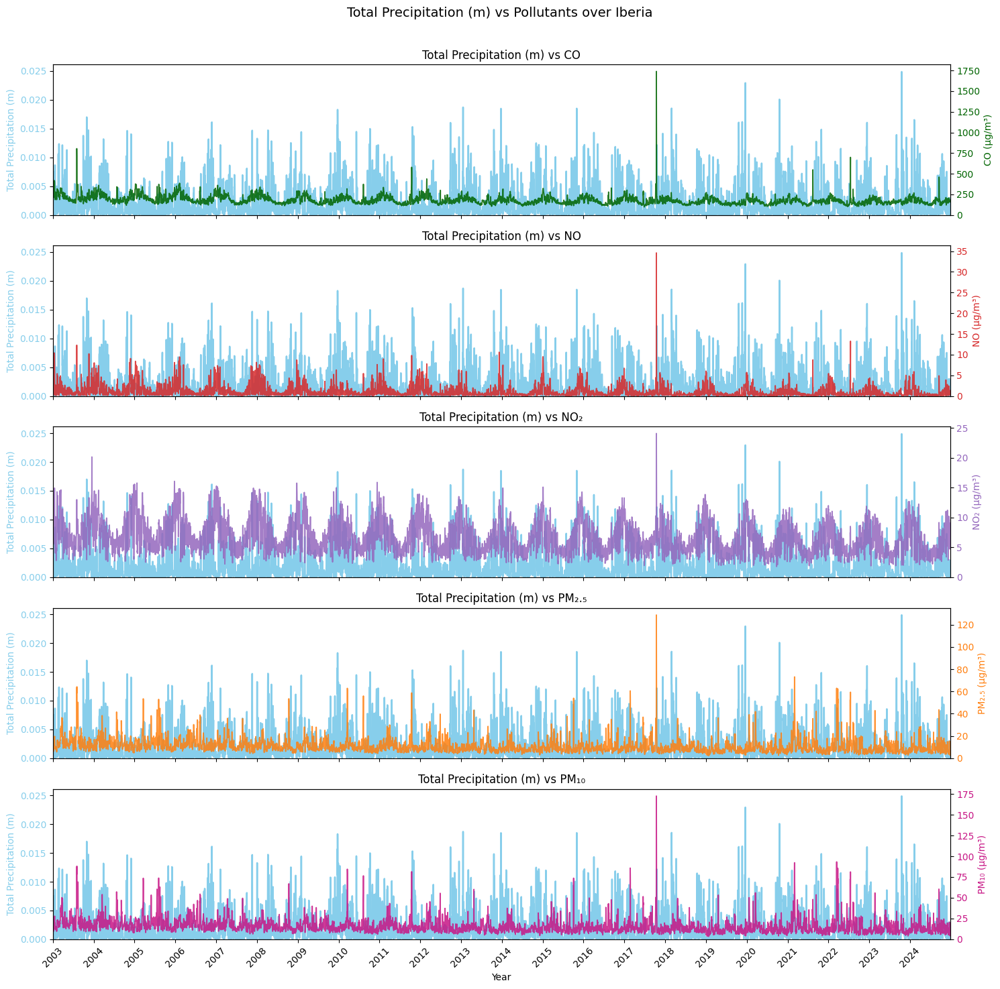


Plotting: Max Temperature (°C) (mean)


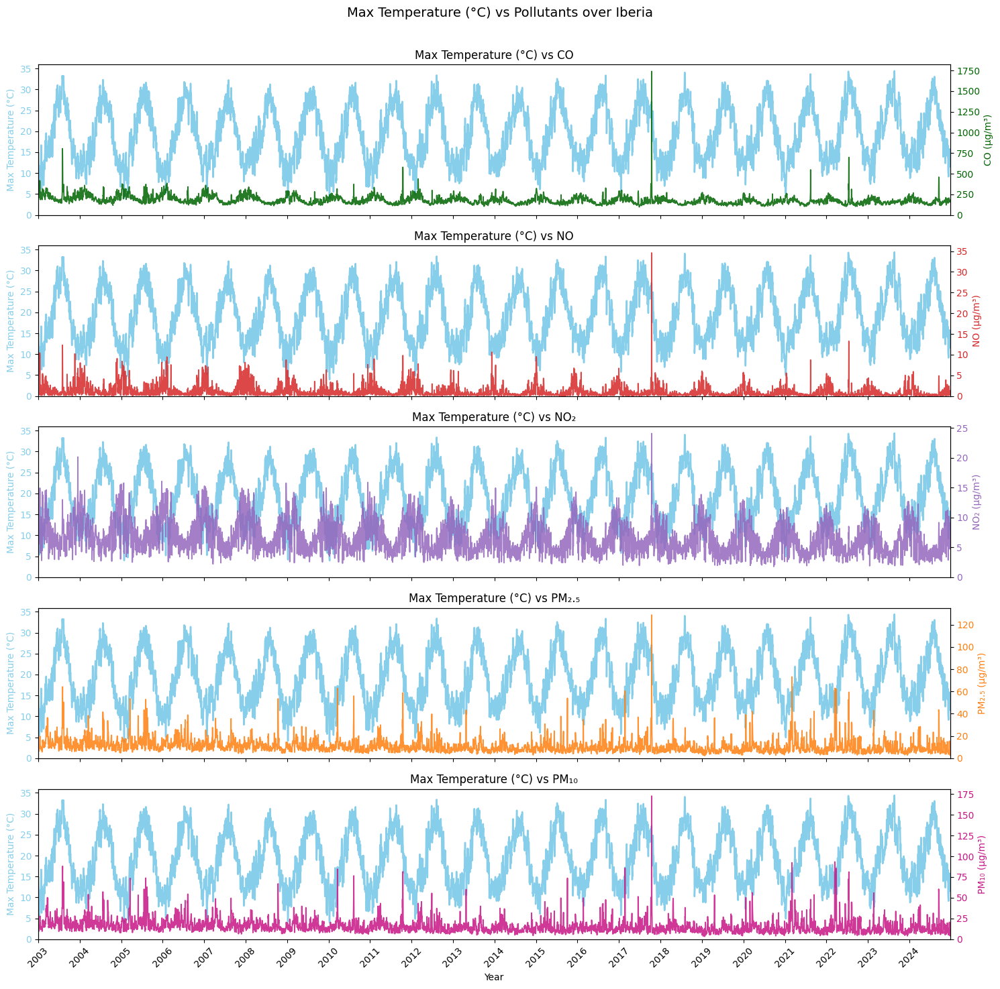


Plotting: Max Wind Speed (m/s) (mean)


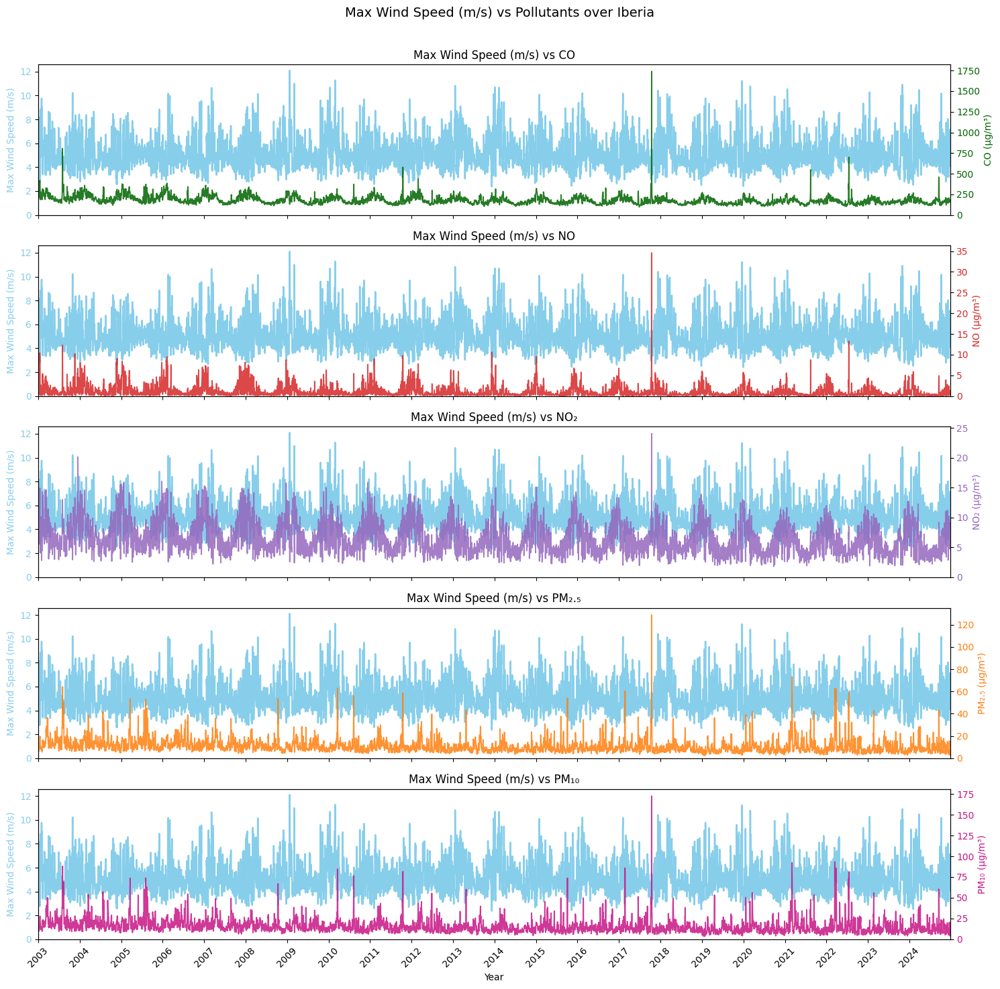

In [40]:
import xarray as xr
import matplotlib.pyplot as plt
import pandas as pd

# ============================================================
# Choose mode: "FRP" or "POLLUTANTS"
# ============================================================
mode = "POLLUTANTS" 

# ============================================================
# File paths for each pollutant
# ============================================================
files = {
    'CO':     r"D:\IPMA\Results\co_fire_meteo_Iberia.nc",
    'NO':     r"D:\IPMA\Results\no_fire_meteo_Iberia.nc",
    'NO₂':    r"D:\IPMA\Results\no2_fire_meteo_Iberia.nc",
    'PM₂.₅':  r"D:\IPMA\Results\pm2p5_fire_meteo_Iberia.nc",
    'PM₁₀':   r"D:\IPMA\Results\pm10_fire_meteo_Iberia.nc"
}

# ============================================================
# Units for pollutants
# ============================================================
units = {
    'CO': 'µg/m³',
    'NO': 'µg/m³',
    'NO₂': 'µg/m³',
    'PM₂.₅': 'µg/m³',
    'PM₁₀': 'µg/m³'
}

# ============================================================
# Selected meteorological variables (Label, Statistic)
# Options for statistic: 'mean', 'sum', 'max', 'min', 'median'
# ============================================================
meteo_vars = {
    'precip_Total_Precipitation': ('Total Precipitation (m)', 'mean'),
    'temp_Max': ('Max Temperature (°C)', 'mean'),
    'wind_Max': ('Max Wind Speed (m/s)', 'mean')
}

# ============================================================
# Load a sample dataset (same meteo vars in all)
# ============================================================
sample_file = list(files.values())[0]
ds_sample = xr.open_dataset(sample_file)
time = ds_sample.time
tmin, tmax = pd.to_datetime(time.min().values), pd.to_datetime(time.max().values)

# ============================================================
# Define colors
# ============================================================
meteo_color = 'skyblue'
frp_color = 'crimson'
pollutant_colors = {
    'CO': 'darkgreen',
    'NO': 'tab:red',
    'NO₂': 'tab:purple',
    'PM₂.₅': 'tab:orange',
    'PM₁₀': 'mediumvioletred'
}

# ============================================================
# Prepare x-axis: all years
# ============================================================
years = pd.to_datetime(time.values).year
unique_years = sorted(list(set(years)))
xticks = [time.values[years.tolist().index(y)] for y in unique_years]

# ============================================================
# Main loop: one figure per METEO variable
# ============================================================
for var_name, (label, stat) in meteo_vars.items():
    print(f"\nPlotting: {label} ({stat})")

    # Spatial statistic of the meteorological variable
    da = ds_sample[var_name]
    if stat == 'mean':
        meteo = da.mean(dim=['latitude', 'longitude'])
    elif stat == 'sum':
        meteo = da.sum(dim=['latitude', 'longitude'])
    elif stat == 'max':
        meteo = da.max(dim=['latitude', 'longitude'])
    elif stat == 'min':
        meteo = da.min(dim=['latitude', 'longitude'])
    elif stat == 'median':
        meteo = da.median(dim=['latitude', 'longitude'])
    else:
        raise ValueError(f"Unsupported stat '{stat}' for variable '{var_name}'")

    # ========================================================
    # MODE 1: FRP comparison
    # ========================================================
    if mode == "FRP":
        fig, ax = plt.subplots(figsize=(15, 4))
        ax.plot(time, meteo, color=meteo_color, linewidth=1.8, label=f"{label} ({stat})")
        ax.set_ylabel(label, color=meteo_color)
        ax.tick_params(axis='y', labelcolor=meteo_color)

        frp = ds_sample['frp_sum_Iberia'].mean(dim=['latitude', 'longitude'])
        ax2 = ax.twinx()
        ax2.plot(time, frp, color=frp_color, alpha=0.8, linewidth=1.5, label='FRP (MW)')
        ax2.set_ylabel('FRP (MW)', color=frp_color)
        ax2.tick_params(axis='y', labelcolor=frp_color)

        # Formatting
        ax.set_ylim(bottom=0)
        ax2.set_ylim(bottom=0)
        ax.set_xlim([tmin, tmax])
        ax.set_xticks(xticks)
        ax.set_xticklabels(unique_years, rotation=45)
        ax.set_xlabel('Year')
        ax.set_title(f'{label} vs FRP over Iberia')
        ax.grid(False)
        plt.tight_layout()
        plt.show()

    # ========================================================
    # MODE 2: Pollutant comparison
    # ========================================================
    elif mode == "POLLUTANTS":
        n_pollutants = len(files)
        fig, axs = plt.subplots(n_pollutants, 1, figsize=(15, 3 * n_pollutants), sharex=True)
        fig.suptitle(f'{label} vs Pollutants over Iberia', fontsize=14)

        for ax, (pollutant_name, file_path) in zip(axs, files.items()):
            ds = xr.open_dataset(file_path)
            pollutant = ds['Mean'].mean(dim=['latitude', 'longitude'])
            if pollutant_name == 'CO':
                pollutant *= 1000  # mg/m³ → µg/m³

            # Meteo (left y-axis)
            ax.plot(time, meteo, color=meteo_color, linewidth=1.8, label=f"{label} ({stat})")
            ax.set_ylabel(label, color=meteo_color)
            ax.tick_params(axis='y', labelcolor=meteo_color)

            # Pollutant (right y-axis)
            color = pollutant_colors.get(pollutant_name, 'tab:blue')
            ax2 = ax.twinx()
            ax2.plot(time, pollutant, color=color, alpha=0.85, linewidth=1.3,
                     label=f'{pollutant_name} ({units[pollutant_name]})')
            ax2.set_ylabel(f'{pollutant_name} ({units[pollutant_name]})', color=color)
            ax2.tick_params(axis='y', labelcolor=color)

            # Formatting
            ax.set_ylim(bottom=0)
            ax2.set_ylim(bottom=0)
            ax.set_xlim([tmin, tmax])
            ax.set_xticks(xticks)
            ax.set_xticklabels(unique_years, rotation=45)
            ax.set_title(f'{label} vs {pollutant_name}')
            ax.grid(False)

        axs[-1].set_xlabel('Year')
        plt.tight_layout(rect=[0, 0, 1, 0.97])
        plt.show()



Plotting: Total Precipitation (m) (mean)


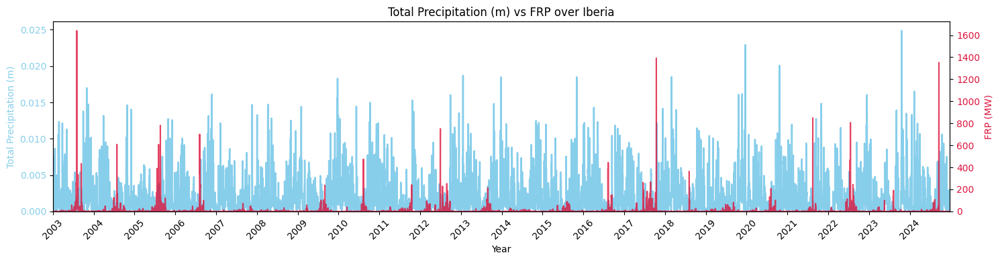


Plotting: Max Temperature (°C) (mean)


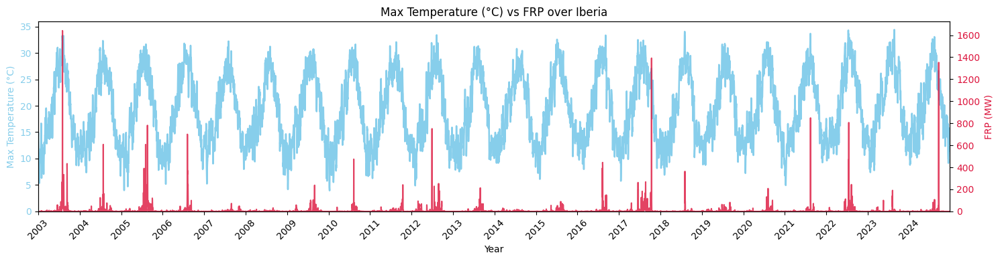


Plotting: Max Wind Speed (m/s) (mean)


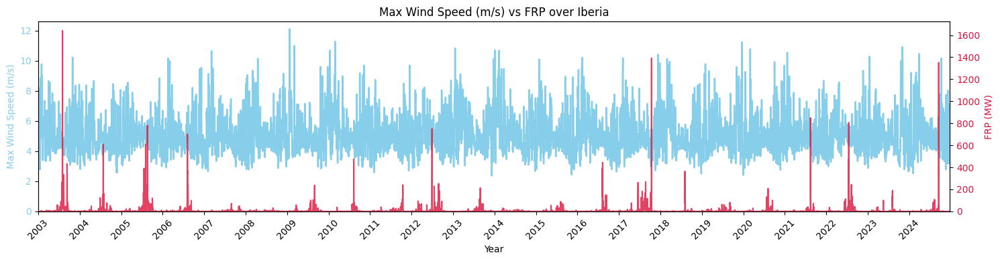

In [41]:
import xarray as xr
import matplotlib.pyplot as plt
import pandas as pd

# ============================================================
# Choose mode: "FRP" or "POLLUTANTS"
# ============================================================
mode = "FRP" 

# ============================================================
# File paths for each pollutant
# ============================================================
files = {
    'CO':     r"D:\IPMA\Results\co_fire_meteo_Iberia.nc",
    'NO':     r"D:\IPMA\Results\no_fire_meteo_Iberia.nc",
    'NO₂':    r"D:\IPMA\Results\no2_fire_meteo_Iberia.nc",
    'PM₂.₅':  r"D:\IPMA\Results\pm2p5_fire_meteo_Iberia.nc",
    'PM₁₀':   r"D:\IPMA\Results\pm10_fire_meteo_Iberia.nc"
}

# ============================================================
# Units for pollutants
# ============================================================
units = {
    'CO': 'µg/m³',
    'NO': 'µg/m³',
    'NO₂': 'µg/m³',
    'PM₂.₅': 'µg/m³',
    'PM₁₀': 'µg/m³'
}

# ============================================================
# Selected meteorological variables (Label, Statistic)
# Options for statistic: 'mean', 'sum', 'max', 'min', 'median'
# ============================================================
meteo_vars = {
    'precip_Total_Precipitation': ('Total Precipitation (m)', 'mean'),
    'temp_Max': ('Max Temperature (°C)', 'mean'),
    'wind_Max': ('Max Wind Speed (m/s)', 'mean')
}

# ============================================================
# Load a sample dataset (same meteo vars in all)
# ============================================================
sample_file = list(files.values())[0]
ds_sample = xr.open_dataset(sample_file)
time = ds_sample.time
tmin, tmax = pd.to_datetime(time.min().values), pd.to_datetime(time.max().values)

# ============================================================
# Define colors
# ============================================================
meteo_color = 'skyblue'
frp_color = 'crimson'
pollutant_colors = {
    'CO': 'darkgreen',
    'NO': 'tab:red',
    'NO₂': 'tab:purple',
    'PM₂.₅': 'tab:orange',
    'PM₁₀': 'mediumvioletred'
}

# ============================================================
# Prepare x-axis: all years
# ============================================================
years = pd.to_datetime(time.values).year
unique_years = sorted(list(set(years)))
xticks = [time.values[years.tolist().index(y)] for y in unique_years]

# ============================================================
# Main loop: one figure per METEO variable
# ============================================================
for var_name, (label, stat) in meteo_vars.items():
    print(f"\nPlotting: {label} ({stat})")

    # Spatial statistic of the meteorological variable
    da = ds_sample[var_name]
    if stat == 'mean':
        meteo = da.mean(dim=['latitude', 'longitude'])
    elif stat == 'sum':
        meteo = da.sum(dim=['latitude', 'longitude'])
    elif stat == 'max':
        meteo = da.max(dim=['latitude', 'longitude'])
    elif stat == 'min':
        meteo = da.min(dim=['latitude', 'longitude'])
    elif stat == 'median':
        meteo = da.median(dim=['latitude', 'longitude'])
    else:
        raise ValueError(f"Unsupported stat '{stat}' for variable '{var_name}'")

    # ========================================================
    # MODE 1: FRP comparison
    # ========================================================
    if mode == "FRP":
        fig, ax = plt.subplots(figsize=(15, 4))
        ax.plot(time, meteo, color=meteo_color, linewidth=1.8, label=f"{label} ({stat})")
        ax.set_ylabel(label, color=meteo_color)
        ax.tick_params(axis='y', labelcolor=meteo_color)

        frp = ds_sample['frp_sum_Iberia'].mean(dim=['latitude', 'longitude'])
        ax2 = ax.twinx()
        ax2.plot(time, frp, color=frp_color, alpha=0.8, linewidth=1.5, label='FRP (MW)')
        ax2.set_ylabel('FRP (MW)', color=frp_color)
        ax2.tick_params(axis='y', labelcolor=frp_color)

        # Formatting
        ax.set_ylim(bottom=0)
        ax2.set_ylim(bottom=0)
        ax.set_xlim([tmin, tmax])
        ax.set_xticks(xticks)
        ax.set_xticklabels(unique_years, rotation=45)
        ax.set_xlabel('Year')
        ax.set_title(f'{label} vs FRP over Iberia')
        ax.grid(False)
        plt.tight_layout()
        plt.show()

    # ========================================================
    # MODE 2: Pollutant comparison
    # ========================================================
    elif mode == "POLLUTANTS":
        n_pollutants = len(files)
        fig, axs = plt.subplots(n_pollutants, 1, figsize=(15, 3 * n_pollutants), sharex=True)
        fig.suptitle(f'{label} vs Pollutants over Iberia', fontsize=14)

        for ax, (pollutant_name, file_path) in zip(axs, files.items()):
            ds = xr.open_dataset(file_path)
            pollutant = ds['Mean'].mean(dim=['latitude', 'longitude'])
            if pollutant_name == 'CO':
                pollutant *= 1000  # mg/m³ → µg/m³

            # Meteo (left y-axis)
            ax.plot(time, meteo, color=meteo_color, linewidth=1.8, label=f"{label} ({stat})")
            ax.set_ylabel(label, color=meteo_color)
            ax.tick_params(axis='y', labelcolor=meteo_color)

            # Pollutant (right y-axis)
            color = pollutant_colors.get(pollutant_name, 'tab:blue')
            ax2 = ax.twinx()
            ax2.plot(time, pollutant, color=color, alpha=0.85, linewidth=1.3,
                     label=f'{pollutant_name} ({units[pollutant_name]})')
            ax2.set_ylabel(f'{pollutant_name} ({units[pollutant_name]})', color=color)
            ax2.tick_params(axis='y', labelcolor=color)

            # Formatting
            ax.set_ylim(bottom=0)
            ax2.set_ylim(bottom=0)
            ax.set_xlim([tmin, tmax])
            ax.set_xticks(xticks)
            ax.set_xticklabels(unique_years, rotation=45)
            ax.set_title(f'{label} vs {pollutant_name}')
            ax.grid(False)

        axs[-1].set_xlabel('Year')
        plt.tight_layout(rect=[0, 0, 1, 0.97])
        plt.show()


#### Certain Year


Plotting Total Precipitation (m) (mean) for 2017


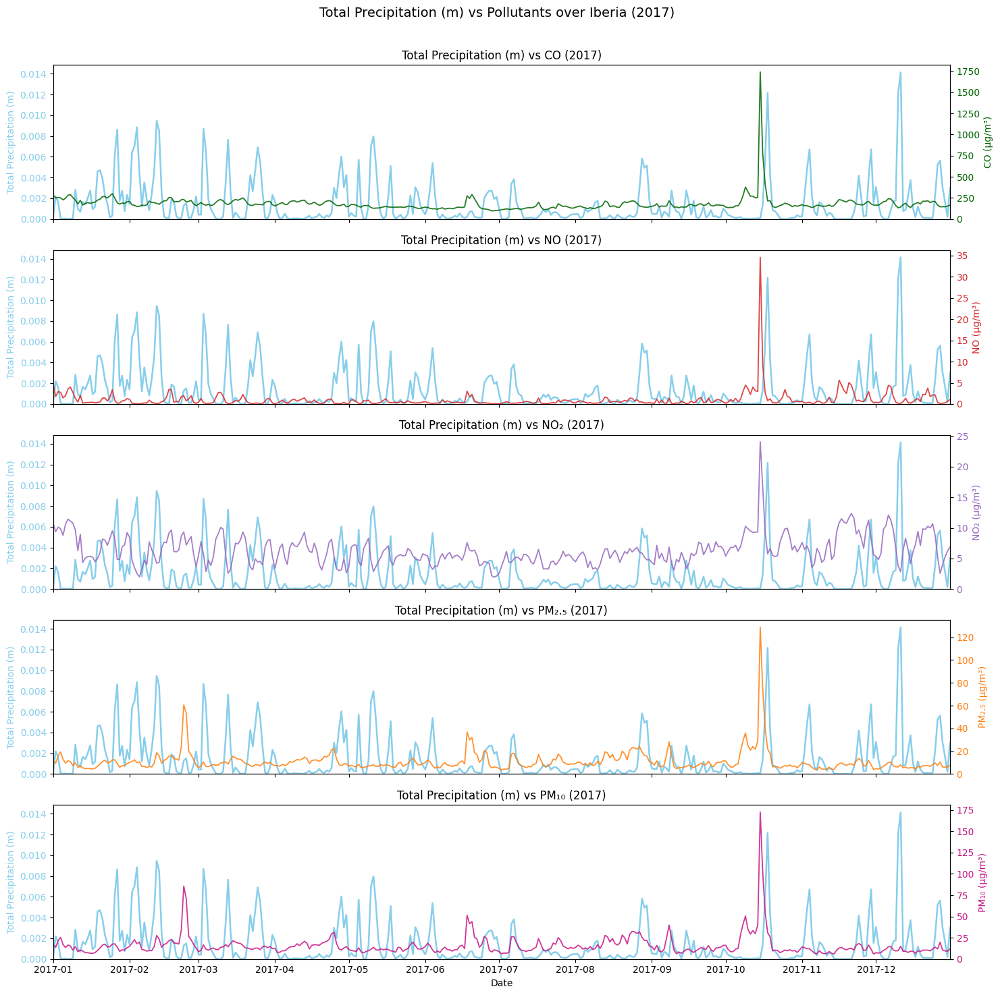


Plotting Max Temperature (°C) (mean) for 2017


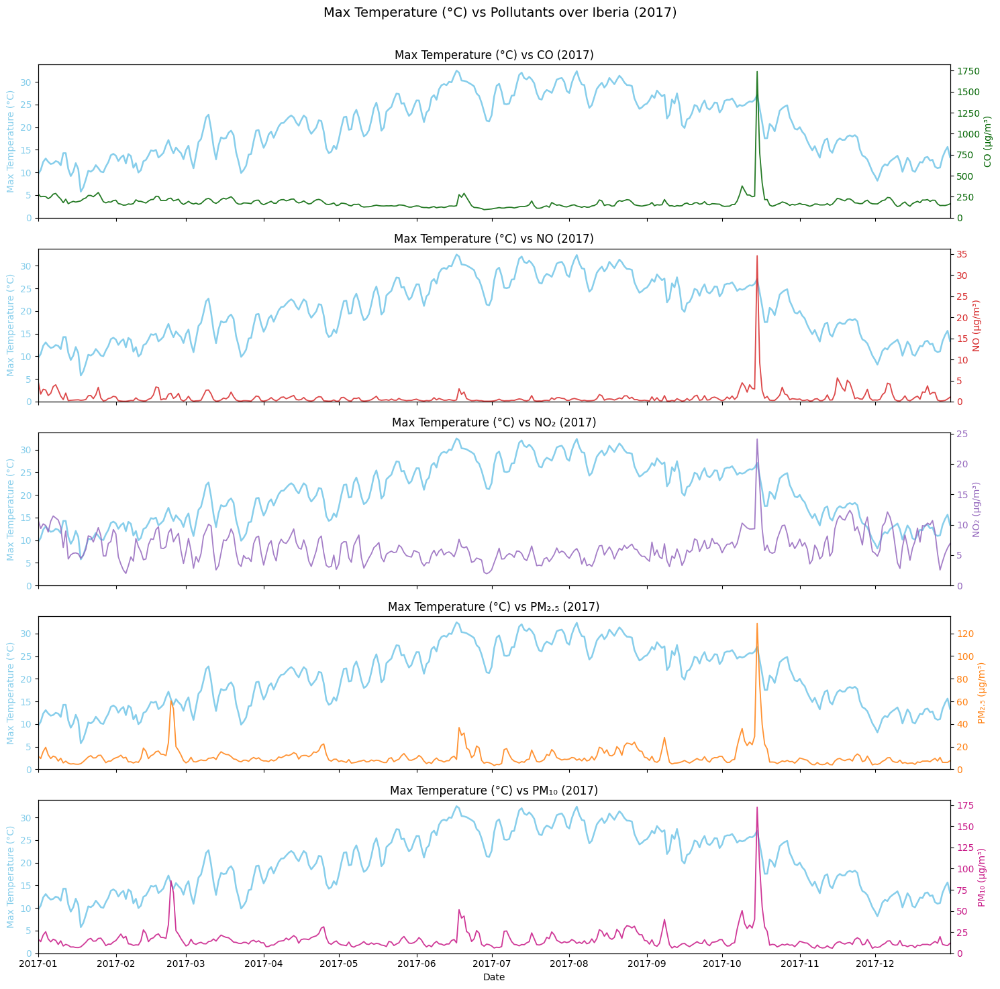


Plotting Max Wind Speed (m/s) (mean) for 2017


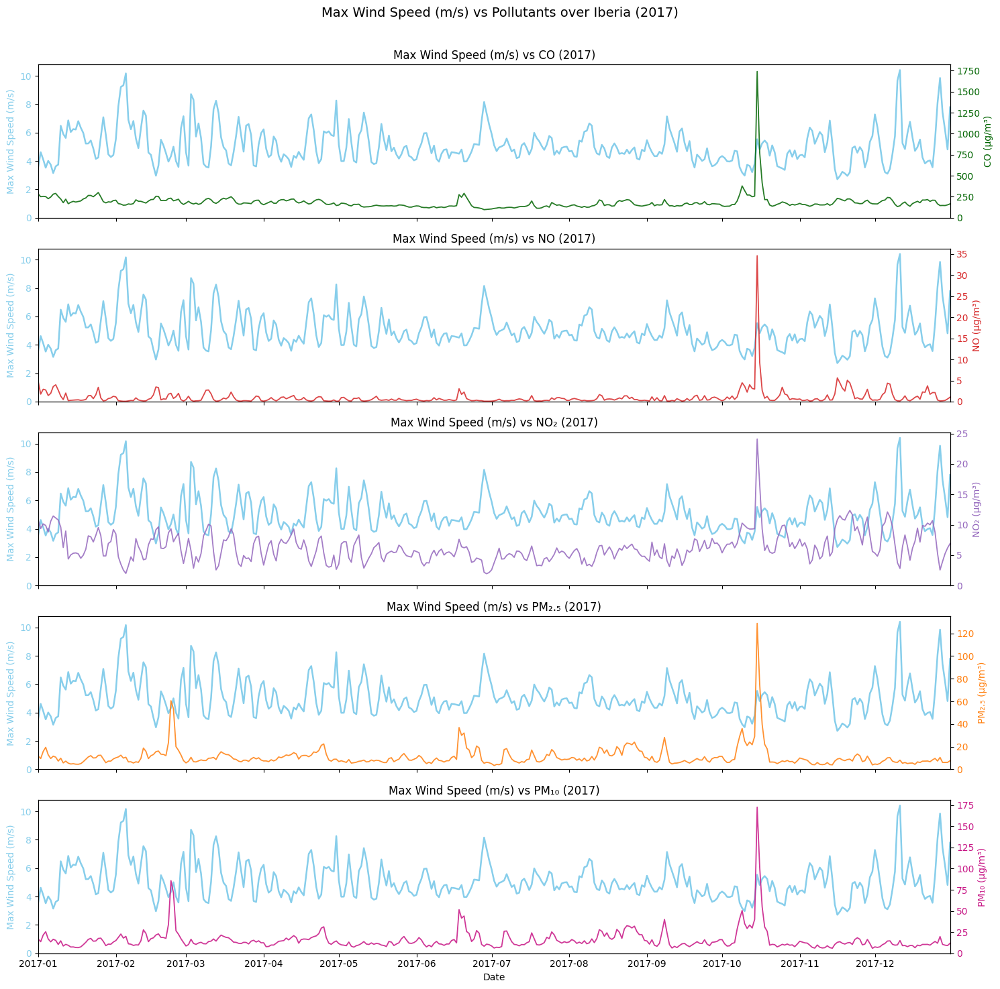

In [42]:
import xarray as xr
import matplotlib.pyplot as plt
import pandas as pd

# ============================================================
# Choose mode: "FRP" or "POLLUTANTS"
# ============================================================
mode = "POLLUTANTS" 

# ============================================================
# Choose which year to plot
# ============================================================
selected_year = 2017  # <<<<<< CHANGE THIS to select another year

# ============================================================
# File paths for each pollutant
# ============================================================
files = {
    'CO':     r"D:\IPMA\Results\co_fire_meteo_Iberia.nc",
    'NO':     r"D:\IPMA\Results\no_fire_meteo_Iberia.nc",
    'NO₂':    r"D:\IPMA\Results\no2_fire_meteo_Iberia.nc",
    'PM₂.₅':  r"D:\IPMA\Results\pm2p5_fire_meteo_Iberia.nc",
    'PM₁₀':   r"D:\IPMA\Results\pm10_fire_meteo_Iberia.nc"
}

# ============================================================
# Units for pollutants
# ============================================================
units = {
    'CO': 'µg/m³',
    'NO': 'µg/m³',
    'NO₂': 'µg/m³',
    'PM₂.₅': 'µg/m³',
    'PM₁₀': 'µg/m³'
}

# ============================================================
# Selected meteorological variables (Label, Statistic)
# ============================================================
meteo_vars = {
    'precip_Total_Precipitation': ('Total Precipitation (m)', 'mean'),
    'temp_Max': ('Max Temperature (°C)', 'mean'),
    'wind_Max': ('Max Wind Speed (m/s)', 'mean')
}

# ============================================================
# Load a sample dataset (same meteo vars in all)
# ============================================================
sample_file = list(files.values())[0]
ds_sample = xr.open_dataset(sample_file)
time = pd.to_datetime(ds_sample.time.values)

# ============================================================
# Filter dataset for the selected year
# ============================================================
mask = time.year == selected_year
if not mask.any():
    raise ValueError(f"No data available for year {selected_year}. Available years: {sorted(set(time.year))}")
time = time[mask]
tmin, tmax = time.min(), time.max()

# ============================================================
# Define colors
# ============================================================
meteo_color = 'skyblue'
frp_color = 'crimson'
pollutant_colors = {
    'CO': 'darkgreen',
    'NO': 'tab:red',
    'NO₂': 'tab:purple',
    'PM₂.₅': 'tab:orange',
    'PM₁₀': 'mediumvioletred'
}

# ============================================================
# Main loop: one figure per METEO variable
# ============================================================
for var_name, (label, stat) in meteo_vars.items():
    print(f"\nPlotting {label} ({stat}) for {selected_year}")

    # Select and spatially aggregate meteorological variable
    da = ds_sample[var_name].isel(time=mask)
    if stat == 'mean':
        meteo = da.mean(dim=['latitude', 'longitude'])
    elif stat == 'sum':
        meteo = da.sum(dim=['latitude', 'longitude'])
    elif stat == 'max':
        meteo = da.max(dim=['latitude', 'longitude'])
    elif stat == 'min':
        meteo = da.min(dim=['latitude', 'longitude'])
    elif stat == 'median':
        meteo = da.median(dim=['latitude', 'longitude'])
    else:
        raise ValueError(f"Unsupported stat '{stat}' for variable '{var_name}'")

    # ========================================================
    # MODE 1: FRP comparison
    # ========================================================
    if mode == "FRP":
        fig, ax = plt.subplots(figsize=(15, 4))
        ax.plot(time, meteo, color=meteo_color, linewidth=1.8, label=f"{label} ({stat})")
        ax.set_ylabel(label, color=meteo_color)
        ax.tick_params(axis='y', labelcolor=meteo_color)

        frp = ds_sample['frp_sum_Iberia'].isel(time=mask).mean(dim=['latitude', 'longitude'])
        ax2 = ax.twinx()
        ax2.plot(time, frp, color=frp_color, alpha=0.8, linewidth=1.5, label='FRP (MW)')
        ax2.set_ylabel('FRP (MW)', color=frp_color)
        ax2.tick_params(axis='y', labelcolor=frp_color)

        ax.set_ylim(bottom=0)
        ax2.set_ylim(bottom=0)
        ax.set_xlim([tmin, tmax])
        ax.set_xlabel('Date')
        ax.set_title(f'{label} vs FRP over Iberia ({selected_year})')
        ax.grid(False)
        plt.tight_layout()
        plt.show()

    # ========================================================
    # MODE 2: Pollutant comparison
    # ========================================================
    elif mode == "POLLUTANTS":
        n_pollutants = len(files)
        fig, axs = plt.subplots(n_pollutants, 1, figsize=(15, 3 * n_pollutants), sharex=True)
        fig.suptitle(f'{label} vs Pollutants over Iberia ({selected_year})', fontsize=14)

        for ax, (pollutant_name, file_path) in zip(axs, files.items()):
            ds = xr.open_dataset(file_path)
            pollutant = ds['Mean'].isel(time=mask).mean(dim=['latitude', 'longitude'])
            if pollutant_name == 'CO':
                pollutant *= 1000  # mg/m³ → µg/m³

            ax.plot(time, meteo, color=meteo_color, linewidth=1.8, label=f"{label} ({stat})")
            ax.set_ylabel(label, color=meteo_color)
            ax.tick_params(axis='y', labelcolor=meteo_color)

            color = pollutant_colors.get(pollutant_name, 'tab:blue')
            ax2 = ax.twinx()
            ax2.plot(time, pollutant, color=color, alpha=0.85, linewidth=1.3,
                     label=f'{pollutant_name} ({units[pollutant_name]})')
            ax2.set_ylabel(f'{pollutant_name} ({units[pollutant_name]})', color=color)
            ax2.tick_params(axis='y', labelcolor=color)

            ax.set_ylim(bottom=0)
            ax2.set_ylim(bottom=0)
            ax.set_xlim([tmin, tmax])
            ax.set_title(f'{label} vs {pollutant_name} ({selected_year})')
            ax.grid(False)

        axs[-1].set_xlabel('Date')
        plt.tight_layout(rect=[0, 0, 1, 0.97])
        plt.show()



Plotting Total Precipitation (m) (mean) for 2017


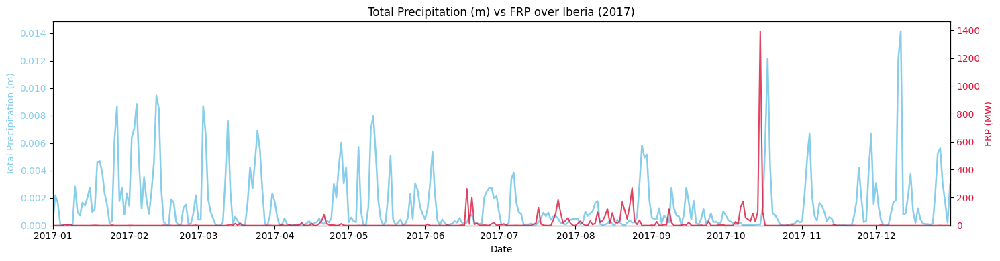


Plotting Max Temperature (°C) (mean) for 2017


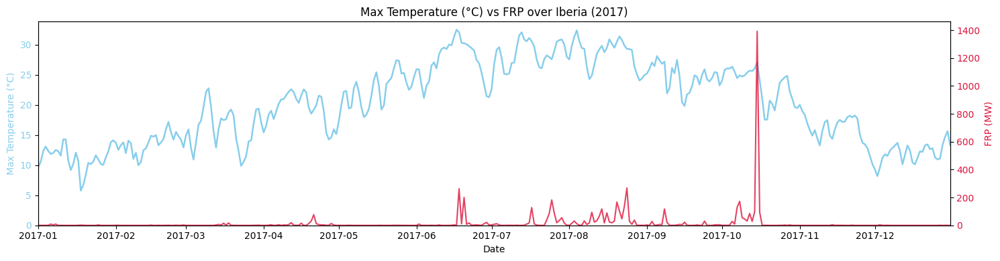


Plotting Max Wind Speed (m/s) (mean) for 2017


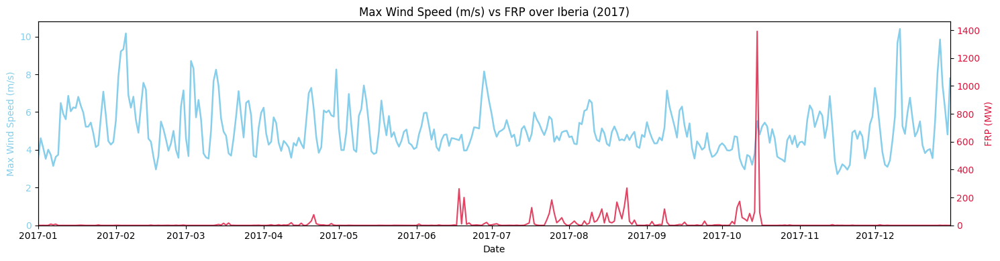

In [43]:
import xarray as xr
import matplotlib.pyplot as plt
import pandas as pd

# ============================================================
# Choose mode: "FRP" or "POLLUTANTS"
# ============================================================
mode = "FRP" 

# ============================================================
# Choose which year to plot
# ============================================================
selected_year = 2017  # <<<<<< CHANGE THIS to select another year

# ============================================================
# File paths for each pollutant
# ============================================================
files = {
    'CO':     r"D:\IPMA\Results\co_fire_meteo_Iberia.nc",
    'NO':     r"D:\IPMA\Results\no_fire_meteo_Iberia.nc",
    'NO₂':    r"D:\IPMA\Results\no2_fire_meteo_Iberia.nc",
    'PM₂.₅':  r"D:\IPMA\Results\pm2p5_fire_meteo_Iberia.nc",
    'PM₁₀':   r"D:\IPMA\Results\pm10_fire_meteo_Iberia.nc"
}

# ============================================================
# Units for pollutants
# ============================================================
units = {
    'CO': 'µg/m³',
    'NO': 'µg/m³',
    'NO₂': 'µg/m³',
    'PM₂.₅': 'µg/m³',
    'PM₁₀': 'µg/m³'
}

# ============================================================
# Selected meteorological variables (Label, Statistic)
# ============================================================
meteo_vars = {
    'precip_Total_Precipitation': ('Total Precipitation (m)', 'mean'),
    'temp_Max': ('Max Temperature (°C)', 'mean'),
    'wind_Max': ('Max Wind Speed (m/s)', 'mean')
}

# ============================================================
# Load a sample dataset (same meteo vars in all)
# ============================================================
sample_file = list(files.values())[0]
ds_sample = xr.open_dataset(sample_file)
time = pd.to_datetime(ds_sample.time.values)

# ============================================================
# Filter dataset for the selected year
# ============================================================
mask = time.year == selected_year
if not mask.any():
    raise ValueError(f"No data available for year {selected_year}. Available years: {sorted(set(time.year))}")
time = time[mask]
tmin, tmax = time.min(), time.max()

# ============================================================
# Define colors
# ============================================================
meteo_color = 'skyblue'
frp_color = 'crimson'
pollutant_colors = {
    'CO': 'darkgreen',
    'NO': 'tab:red',
    'NO₂': 'tab:purple',
    'PM₂.₅': 'tab:orange',
    'PM₁₀': 'mediumvioletred'
}

# ============================================================
# Main loop: one figure per METEO variable
# ============================================================
for var_name, (label, stat) in meteo_vars.items():
    print(f"\nPlotting {label} ({stat}) for {selected_year}")

    # Select and spatially aggregate meteorological variable
    da = ds_sample[var_name].isel(time=mask)
    if stat == 'mean':
        meteo = da.mean(dim=['latitude', 'longitude'])
    elif stat == 'sum':
        meteo = da.sum(dim=['latitude', 'longitude'])
    elif stat == 'max':
        meteo = da.max(dim=['latitude', 'longitude'])
    elif stat == 'min':
        meteo = da.min(dim=['latitude', 'longitude'])
    elif stat == 'median':
        meteo = da.median(dim=['latitude', 'longitude'])
    else:
        raise ValueError(f"Unsupported stat '{stat}' for variable '{var_name}'")

    # ========================================================
    # MODE 1: FRP comparison
    # ========================================================
    if mode == "FRP":
        fig, ax = plt.subplots(figsize=(15, 4))
        ax.plot(time, meteo, color=meteo_color, linewidth=1.8, label=f"{label} ({stat})")
        ax.set_ylabel(label, color=meteo_color)
        ax.tick_params(axis='y', labelcolor=meteo_color)

        frp = ds_sample['frp_sum_Iberia'].isel(time=mask).mean(dim=['latitude', 'longitude'])
        ax2 = ax.twinx()
        ax2.plot(time, frp, color=frp_color, alpha=0.8, linewidth=1.5, label='FRP (MW)')
        ax2.set_ylabel('FRP (MW)', color=frp_color)
        ax2.tick_params(axis='y', labelcolor=frp_color)

        ax.set_ylim(bottom=0)
        ax2.set_ylim(bottom=0)
        ax.set_xlim([tmin, tmax])
        ax.set_xlabel('Date')
        ax.set_title(f'{label} vs FRP over Iberia ({selected_year})')
        ax.grid(False)
        plt.tight_layout()
        plt.show()

    # ========================================================
    # MODE 2: Pollutant comparison
    # ========================================================
    elif mode == "POLLUTANTS":
        n_pollutants = len(files)
        fig, axs = plt.subplots(n_pollutants, 1, figsize=(15, 3 * n_pollutants), sharex=True)
        fig.suptitle(f'{label} vs Pollutants over Iberia ({selected_year})', fontsize=14)

        for ax, (pollutant_name, file_path) in zip(axs, files.items()):
            ds = xr.open_dataset(file_path)
            pollutant = ds['Mean'].isel(time=mask).mean(dim=['latitude', 'longitude'])
            if pollutant_name == 'CO':
                pollutant *= 1000  # mg/m³ → µg/m³

            ax.plot(time, meteo, color=meteo_color, linewidth=1.8, label=f"{label} ({stat})")
            ax.set_ylabel(label, color=meteo_color)
            ax.tick_params(axis='y', labelcolor=meteo_color)

            color = pollutant_colors.get(pollutant_name, 'tab:blue')
            ax2 = ax.twinx()
            ax2.plot(time, pollutant, color=color, alpha=0.85, linewidth=1.3,
                     label=f'{pollutant_name} ({units[pollutant_name]})')
            ax2.set_ylabel(f'{pollutant_name} ({units[pollutant_name]})', color=color)
            ax2.tick_params(axis='y', labelcolor=color)

            ax.set_ylim(bottom=0)
            ax2.set_ylim(bottom=0)
            ax.set_xlim([tmin, tmax])
            ax.set_title(f'{label} vs {pollutant_name} ({selected_year})')
            ax.grid(False)

        axs[-1].set_xlabel('Date')
        plt.tight_layout(rect=[0, 0, 1, 0.97])
        plt.show()


### Italy

#### All Years


Plotting: Total Precipitation (m) (mean)


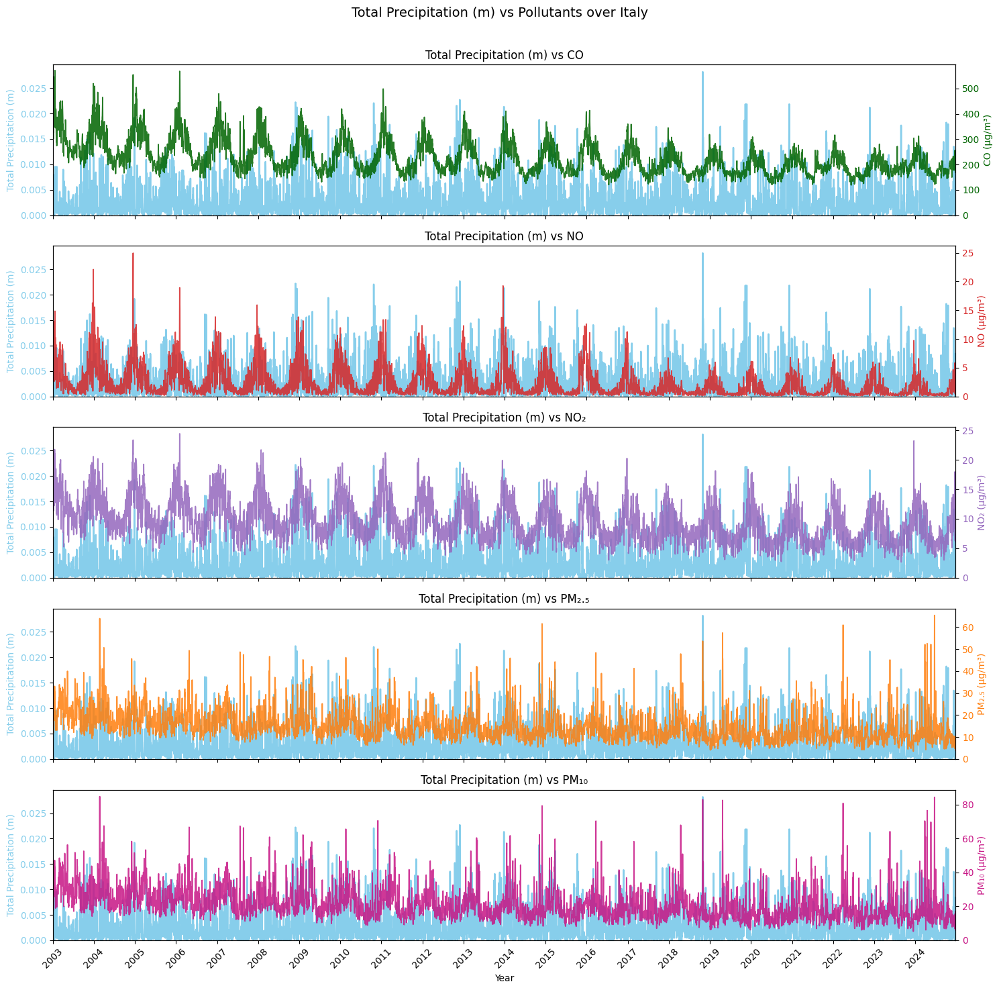


Plotting: Max Temperature (°C) (mean)


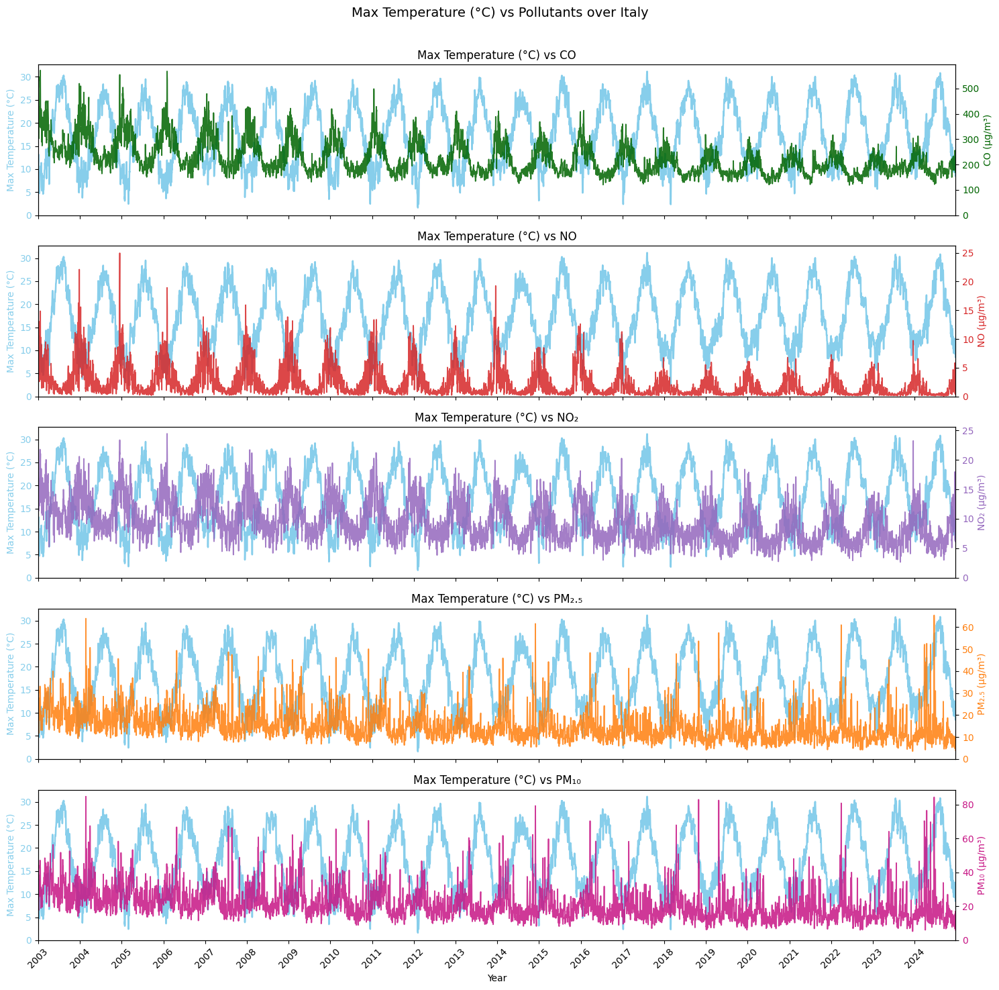


Plotting: Max Wind Speed (m/s) (mean)


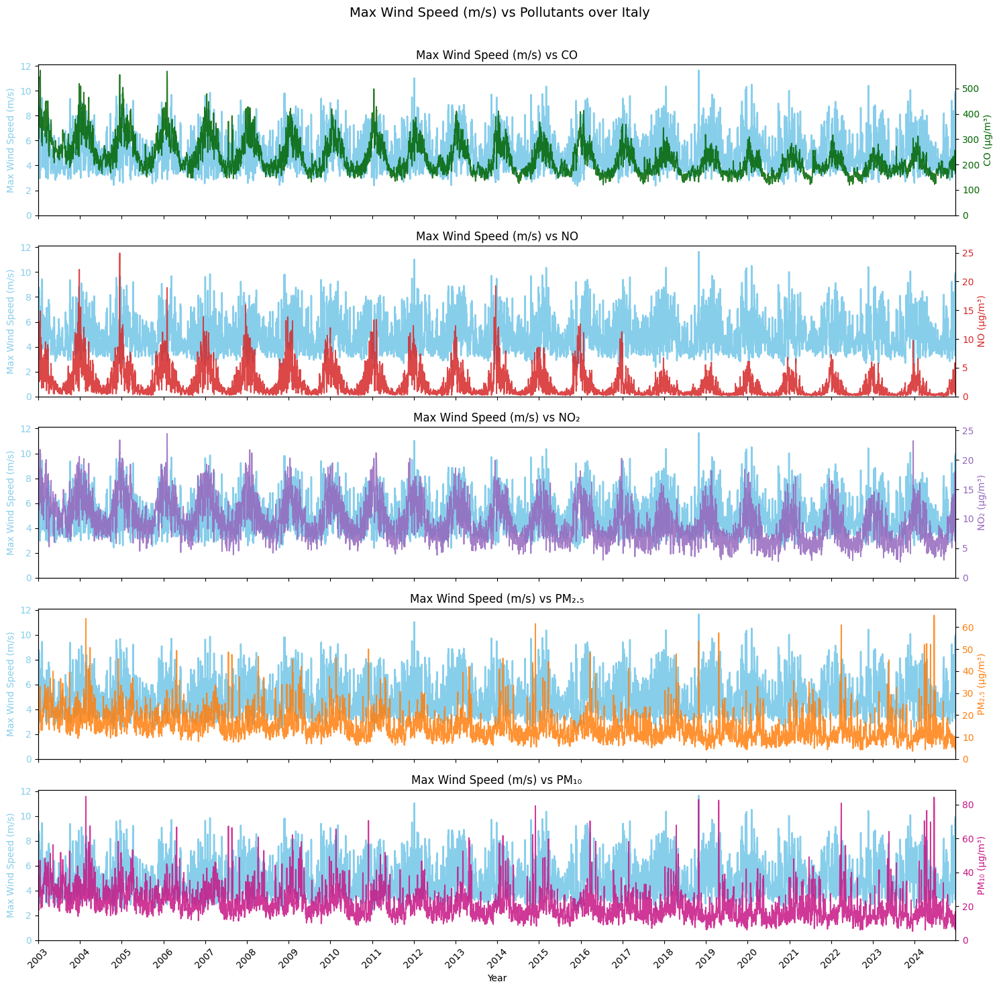

In [44]:
import xarray as xr
import matplotlib.pyplot as plt
import pandas as pd

# ============================================================
# Choose mode: "FRP" or "POLLUTANTS"
# ============================================================
mode = "POLLUTANTS" 

# ============================================================
# File paths for each pollutant
# ============================================================
files = {
    'CO':     r"D:\IPMA\Results\co_fire_meteo_Italy.nc",
    'NO':     r"D:\IPMA\Results\no_fire_meteo_Italy.nc",
    'NO₂':    r"D:\IPMA\Results\no2_fire_meteo_Italy.nc",
    'PM₂.₅':  r"D:\IPMA\Results\pm2p5_fire_meteo_Italy.nc",
    'PM₁₀':   r"D:\IPMA\Results\pm10_fire_meteo_Italy.nc"
}

# ============================================================
# Units for pollutants
# ============================================================
units = {
    'CO': 'µg/m³',
    'NO': 'µg/m³',
    'NO₂': 'µg/m³',
    'PM₂.₅': 'µg/m³',
    'PM₁₀': 'µg/m³'
}

# ============================================================
# Selected meteorological variables (Label, Statistic)
# Options for statistic: 'mean', 'sum', 'max', 'min', 'median'
# ============================================================
meteo_vars = {
    'precip_Total_Precipitation': ('Total Precipitation (m)', 'mean'),
    'temp_Max': ('Max Temperature (°C)', 'mean'),
    'wind_Max': ('Max Wind Speed (m/s)', 'mean')
}

# ============================================================
# Load a sample dataset (same meteo vars in all)
# ============================================================
sample_file = list(files.values())[0]
ds_sample = xr.open_dataset(sample_file)
time = ds_sample.time
tmin, tmax = pd.to_datetime(time.min().values), pd.to_datetime(time.max().values)

# ============================================================
# Define colors
# ============================================================
meteo_color = 'skyblue'
frp_color = 'crimson'
pollutant_colors = {
    'CO': 'darkgreen',
    'NO': 'tab:red',
    'NO₂': 'tab:purple',
    'PM₂.₅': 'tab:orange',
    'PM₁₀': 'mediumvioletred'
}

# ============================================================
# Prepare x-axis: all years
# ============================================================
years = pd.to_datetime(time.values).year
unique_years = sorted(list(set(years)))
xticks = [time.values[years.tolist().index(y)] for y in unique_years]

# ============================================================
# Main loop: one figure per METEO variable
# ============================================================
for var_name, (label, stat) in meteo_vars.items():
    print(f"\nPlotting: {label} ({stat})")

    # Spatial statistic of the meteorological variable
    da = ds_sample[var_name]
    if stat == 'mean':
        meteo = da.mean(dim=['latitude', 'longitude'])
    elif stat == 'sum':
        meteo = da.sum(dim=['latitude', 'longitude'])
    elif stat == 'max':
        meteo = da.max(dim=['latitude', 'longitude'])
    elif stat == 'min':
        meteo = da.min(dim=['latitude', 'longitude'])
    elif stat == 'median':
        meteo = da.median(dim=['latitude', 'longitude'])
    else:
        raise ValueError(f"Unsupported stat '{stat}' for variable '{var_name}'")

    # ========================================================
    # MODE 1: FRP comparison
    # ========================================================
    if mode == "FRP":
        fig, ax = plt.subplots(figsize=(15, 4))
        ax.plot(time, meteo, color=meteo_color, linewidth=1.8, label=f"{label} ({stat})")
        ax.set_ylabel(label, color=meteo_color)
        ax.tick_params(axis='y', labelcolor=meteo_color)

        frp = ds_sample['frp_sum_Italy'].mean(dim=['latitude', 'longitude'])
        ax2 = ax.twinx()
        ax2.plot(time, frp, color=frp_color, alpha=0.8, linewidth=1.5, label='FRP (MW)')
        ax2.set_ylabel('FRP (MW)', color=frp_color)
        ax2.tick_params(axis='y', labelcolor=frp_color)

        # Formatting
        ax.set_ylim(bottom=0)
        ax2.set_ylim(bottom=0)
        ax.set_xlim([tmin, tmax])
        ax.set_xticks(xticks)
        ax.set_xticklabels(unique_years, rotation=45)
        ax.set_xlabel('Year')
        ax.set_title(f'{label} vs FRP over Italy')
        ax.grid(False)
        plt.tight_layout()
        plt.show()

    # ========================================================
    # MODE 2: Pollutant comparison
    # ========================================================
    elif mode == "POLLUTANTS":
        n_pollutants = len(files)
        fig, axs = plt.subplots(n_pollutants, 1, figsize=(15, 3 * n_pollutants), sharex=True)
        fig.suptitle(f'{label} vs Pollutants over Italy', fontsize=14)

        for ax, (pollutant_name, file_path) in zip(axs, files.items()):
            ds = xr.open_dataset(file_path)
            pollutant = ds['Mean'].mean(dim=['latitude', 'longitude'])
            if pollutant_name == 'CO':
                pollutant *= 1000  # mg/m³ → µg/m³

            # Meteo (left y-axis)
            ax.plot(time, meteo, color=meteo_color, linewidth=1.8, label=f"{label} ({stat})")
            ax.set_ylabel(label, color=meteo_color)
            ax.tick_params(axis='y', labelcolor=meteo_color)

            # Pollutant (right y-axis)
            color = pollutant_colors.get(pollutant_name, 'tab:blue')
            ax2 = ax.twinx()
            ax2.plot(time, pollutant, color=color, alpha=0.85, linewidth=1.3,
                     label=f'{pollutant_name} ({units[pollutant_name]})')
            ax2.set_ylabel(f'{pollutant_name} ({units[pollutant_name]})', color=color)
            ax2.tick_params(axis='y', labelcolor=color)

            # Formatting
            ax.set_ylim(bottom=0)
            ax2.set_ylim(bottom=0)
            ax.set_xlim([tmin, tmax])
            ax.set_xticks(xticks)
            ax.set_xticklabels(unique_years, rotation=45)
            ax.set_title(f'{label} vs {pollutant_name}')
            ax.grid(False)

        axs[-1].set_xlabel('Year')
        plt.tight_layout(rect=[0, 0, 1, 0.97])
        plt.show()



Plotting: Total Precipitation (m) (mean)


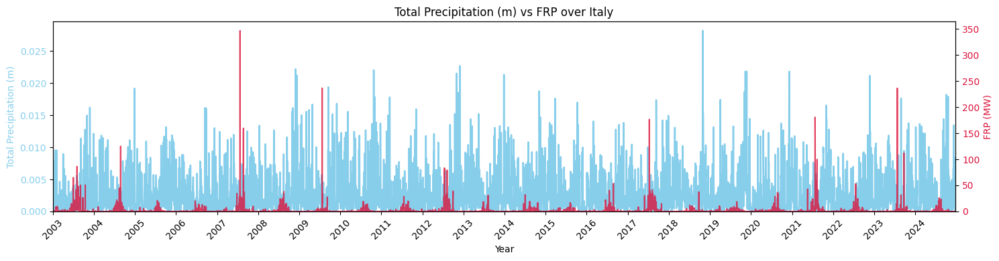


Plotting: Max Temperature (°C) (mean)


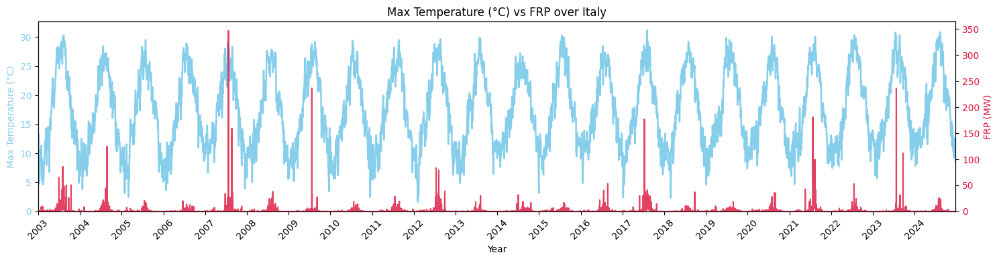


Plotting: Max Wind Speed (m/s) (mean)


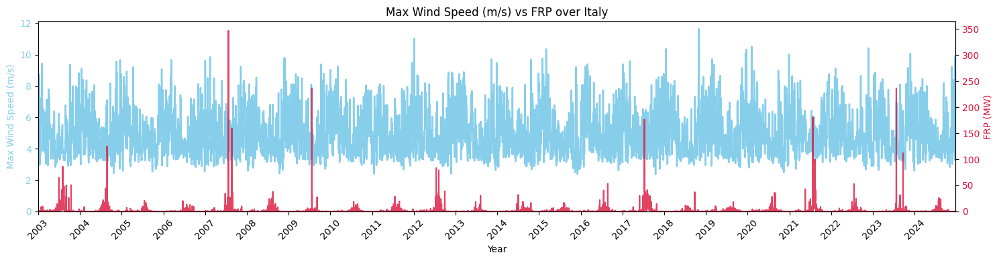

In [45]:
import xarray as xr
import matplotlib.pyplot as plt
import pandas as pd

# ============================================================
# Choose mode: "FRP" or "POLLUTANTS"
# ============================================================
mode = "FRP" 

# ============================================================
# File paths for each pollutant
# ============================================================
files = {
    'CO':     r"D:\IPMA\Results\co_fire_meteo_Italy.nc",
    'NO':     r"D:\IPMA\Results\no_fire_meteo_Italy.nc",
    'NO₂':    r"D:\IPMA\Results\no2_fire_meteo_Italy.nc",
    'PM₂.₅':  r"D:\IPMA\Results\pm2p5_fire_meteo_Italy.nc",
    'PM₁₀':   r"D:\IPMA\Results\pm10_fire_meteo_Italy.nc"
}

# ============================================================
# Units for pollutants
# ============================================================
units = {
    'CO': 'µg/m³',
    'NO': 'µg/m³',
    'NO₂': 'µg/m³',
    'PM₂.₅': 'µg/m³',
    'PM₁₀': 'µg/m³'
}

# ============================================================
# Selected meteorological variables (Label, Statistic)
# Options for statistic: 'mean', 'sum', 'max', 'min', 'median'
# ============================================================
meteo_vars = {
    'precip_Total_Precipitation': ('Total Precipitation (m)', 'mean'),
    'temp_Max': ('Max Temperature (°C)', 'mean'),
    'wind_Max': ('Max Wind Speed (m/s)', 'mean')
}

# ============================================================
# Load a sample dataset (same meteo vars in all)
# ============================================================
sample_file = list(files.values())[0]
ds_sample = xr.open_dataset(sample_file)
time = ds_sample.time
tmin, tmax = pd.to_datetime(time.min().values), pd.to_datetime(time.max().values)

# ============================================================
# Define colors
# ============================================================
meteo_color = 'skyblue'
frp_color = 'crimson'
pollutant_colors = {
    'CO': 'darkgreen',
    'NO': 'tab:red',
    'NO₂': 'tab:purple',
    'PM₂.₅': 'tab:orange',
    'PM₁₀': 'mediumvioletred'
}

# ============================================================
# Prepare x-axis: all years
# ============================================================
years = pd.to_datetime(time.values).year
unique_years = sorted(list(set(years)))
xticks = [time.values[years.tolist().index(y)] for y in unique_years]

# ============================================================
# Main loop: one figure per METEO variable
# ============================================================
for var_name, (label, stat) in meteo_vars.items():
    print(f"\nPlotting: {label} ({stat})")

    # Spatial statistic of the meteorological variable
    da = ds_sample[var_name]
    if stat == 'mean':
        meteo = da.mean(dim=['latitude', 'longitude'])
    elif stat == 'sum':
        meteo = da.sum(dim=['latitude', 'longitude'])
    elif stat == 'max':
        meteo = da.max(dim=['latitude', 'longitude'])
    elif stat == 'min':
        meteo = da.min(dim=['latitude', 'longitude'])
    elif stat == 'median':
        meteo = da.median(dim=['latitude', 'longitude'])
    else:
        raise ValueError(f"Unsupported stat '{stat}' for variable '{var_name}'")

    # ========================================================
    # MODE 1: FRP comparison
    # ========================================================
    if mode == "FRP":
        fig, ax = plt.subplots(figsize=(15, 4))
        ax.plot(time, meteo, color=meteo_color, linewidth=1.8, label=f"{label} ({stat})")
        ax.set_ylabel(label, color=meteo_color)
        ax.tick_params(axis='y', labelcolor=meteo_color)

        frp = ds_sample['frp_sum_Italy'].mean(dim=['latitude', 'longitude'])
        ax2 = ax.twinx()
        ax2.plot(time, frp, color=frp_color, alpha=0.8, linewidth=1.5, label='FRP (MW)')
        ax2.set_ylabel('FRP (MW)', color=frp_color)
        ax2.tick_params(axis='y', labelcolor=frp_color)

        # Formatting
        ax.set_ylim(bottom=0)
        ax2.set_ylim(bottom=0)
        ax.set_xlim([tmin, tmax])
        ax.set_xticks(xticks)
        ax.set_xticklabels(unique_years, rotation=45)
        ax.set_xlabel('Year')
        ax.set_title(f'{label} vs FRP over Italy')
        ax.grid(False)
        plt.tight_layout()
        plt.show()

    # ========================================================
    # MODE 2: Pollutant comparison
    # ========================================================
    elif mode == "POLLUTANTS":
        n_pollutants = len(files)
        fig, axs = plt.subplots(n_pollutants, 1, figsize=(15, 3 * n_pollutants), sharex=True)
        fig.suptitle(f'{label} vs Pollutants over Italy', fontsize=14)

        for ax, (pollutant_name, file_path) in zip(axs, files.items()):
            ds = xr.open_dataset(file_path)
            pollutant = ds['Mean'].mean(dim=['latitude', 'longitude'])
            if pollutant_name == 'CO':
                pollutant *= 1000  # mg/m³ → µg/m³

            # Meteo (left y-axis)
            ax.plot(time, meteo, color=meteo_color, linewidth=1.8, label=f"{label} ({stat})")
            ax.set_ylabel(label, color=meteo_color)
            ax.tick_params(axis='y', labelcolor=meteo_color)

            # Pollutant (right y-axis)
            color = pollutant_colors.get(pollutant_name, 'tab:blue')
            ax2 = ax.twinx()
            ax2.plot(time, pollutant, color=color, alpha=0.85, linewidth=1.3,
                     label=f'{pollutant_name} ({units[pollutant_name]})')
            ax2.set_ylabel(f'{pollutant_name} ({units[pollutant_name]})', color=color)
            ax2.tick_params(axis='y', labelcolor=color)

            # Formatting
            ax.set_ylim(bottom=0)
            ax2.set_ylim(bottom=0)
            ax.set_xlim([tmin, tmax])
            ax.set_xticks(xticks)
            ax.set_xticklabels(unique_years, rotation=45)
            ax.set_title(f'{label} vs {pollutant_name}')
            ax.grid(False)

        axs[-1].set_xlabel('Year')
        plt.tight_layout(rect=[0, 0, 1, 0.97])
        plt.show()


#### Certain Year


Plotting Total Precipitation (m) (mean) for 2007


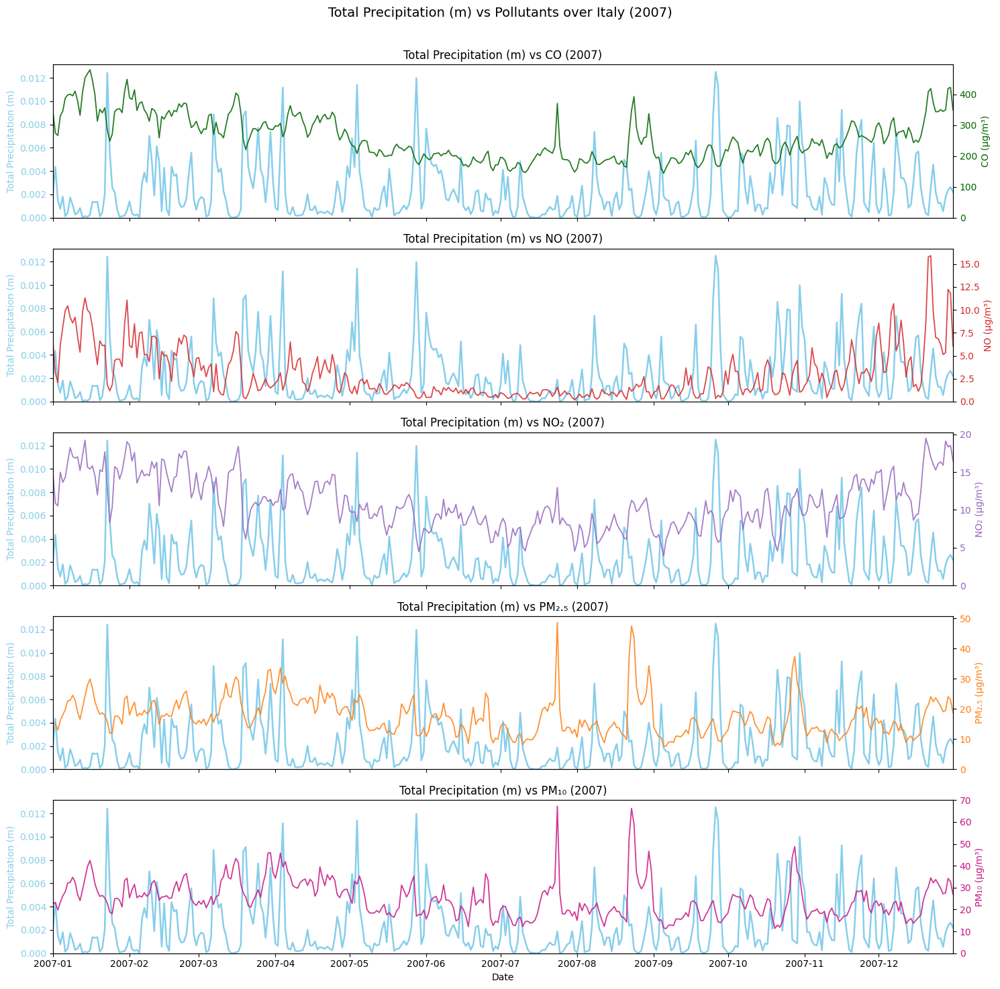


Plotting Max Temperature (°C) (mean) for 2007


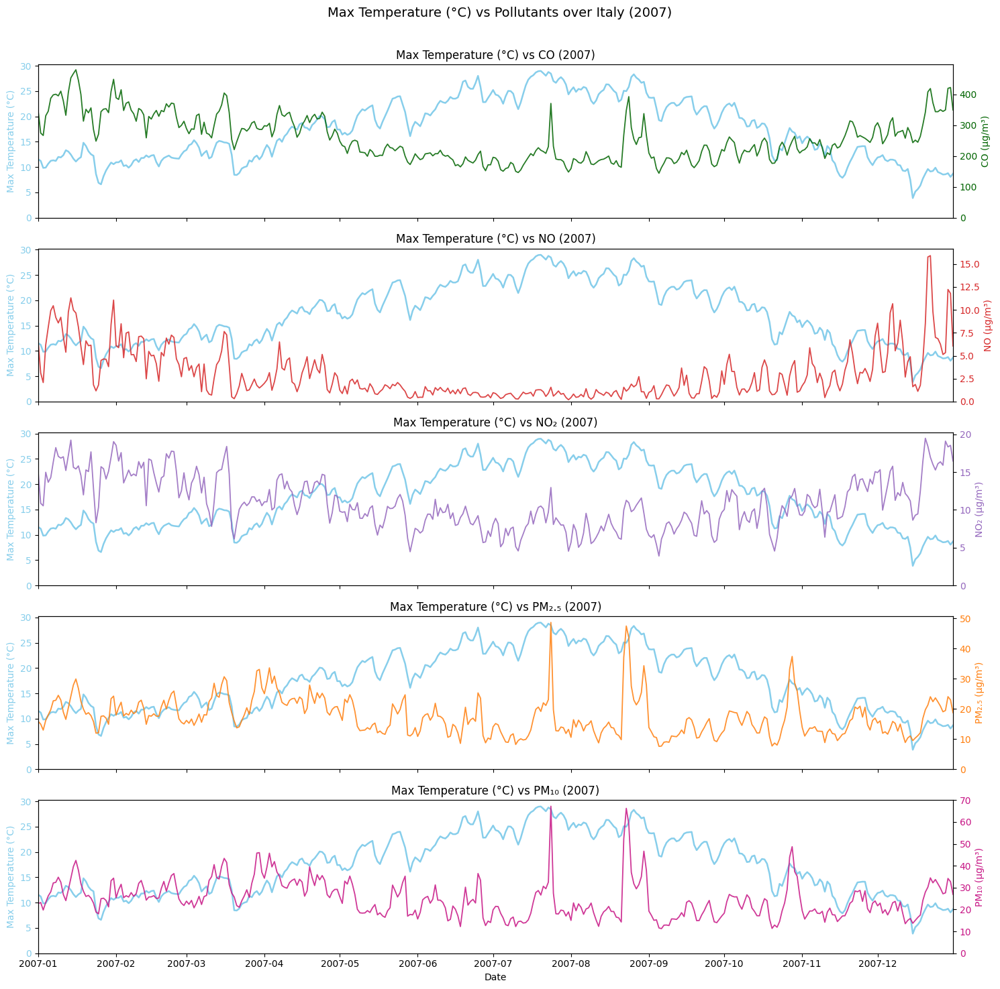


Plotting Max Wind Speed (m/s) (mean) for 2007


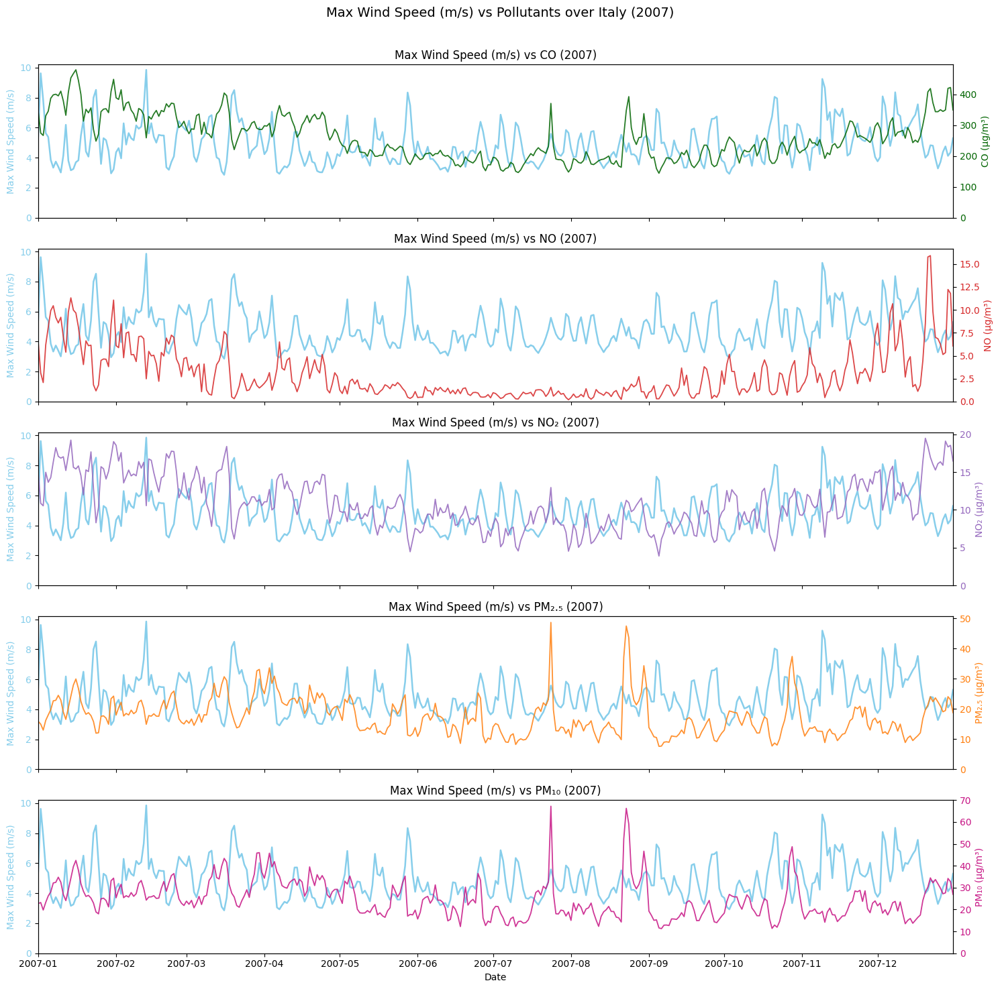

In [46]:
import xarray as xr
import matplotlib.pyplot as plt
import pandas as pd

# ============================================================
# Choose mode: "FRP" or "POLLUTANTS"
# ============================================================
mode = "POLLUTANTS" 

# ============================================================
# Choose which year to plot
# ============================================================
selected_year = 2007  # <<<<<< CHANGE THIS to select another year

# ============================================================
# File paths for each pollutant
# ============================================================
files = {
    'CO':     r"D:\IPMA\Results\co_fire_meteo_Italy.nc",
    'NO':     r"D:\IPMA\Results\no_fire_meteo_Italy.nc",
    'NO₂':    r"D:\IPMA\Results\no2_fire_meteo_Italy.nc",
    'PM₂.₅':  r"D:\IPMA\Results\pm2p5_fire_meteo_Italy.nc",
    'PM₁₀':   r"D:\IPMA\Results\pm10_fire_meteo_Italy.nc"
}

# ============================================================
# Units for pollutants
# ============================================================
units = {
    'CO': 'µg/m³',
    'NO': 'µg/m³',
    'NO₂': 'µg/m³',
    'PM₂.₅': 'µg/m³',
    'PM₁₀': 'µg/m³'
}

# ============================================================
# Selected meteorological variables (Label, Statistic)
# ============================================================
meteo_vars = {
    'precip_Total_Precipitation': ('Total Precipitation (m)', 'mean'),
    'temp_Max': ('Max Temperature (°C)', 'mean'),
    'wind_Max': ('Max Wind Speed (m/s)', 'mean')
}

# ============================================================
# Load a sample dataset (same meteo vars in all)
# ============================================================
sample_file = list(files.values())[0]
ds_sample = xr.open_dataset(sample_file)
time = pd.to_datetime(ds_sample.time.values)

# ============================================================
# Filter dataset for the selected year
# ============================================================
mask = time.year == selected_year
if not mask.any():
    raise ValueError(f"No data available for year {selected_year}. Available years: {sorted(set(time.year))}")
time = time[mask]
tmin, tmax = time.min(), time.max()

# ============================================================
# Define colors
# ============================================================
meteo_color = 'skyblue'
frp_color = 'crimson'
pollutant_colors = {
    'CO': 'darkgreen',
    'NO': 'tab:red',
    'NO₂': 'tab:purple',
    'PM₂.₅': 'tab:orange',
    'PM₁₀': 'mediumvioletred'
}

# ============================================================
# Main loop: one figure per METEO variable
# ============================================================
for var_name, (label, stat) in meteo_vars.items():
    print(f"\nPlotting {label} ({stat}) for {selected_year}")

    # Select and spatially aggregate meteorological variable
    da = ds_sample[var_name].isel(time=mask)
    if stat == 'mean':
        meteo = da.mean(dim=['latitude', 'longitude'])
    elif stat == 'sum':
        meteo = da.sum(dim=['latitude', 'longitude'])
    elif stat == 'max':
        meteo = da.max(dim=['latitude', 'longitude'])
    elif stat == 'min':
        meteo = da.min(dim=['latitude', 'longitude'])
    elif stat == 'median':
        meteo = da.median(dim=['latitude', 'longitude'])
    else:
        raise ValueError(f"Unsupported stat '{stat}' for variable '{var_name}'")

    # ========================================================
    # MODE 1: FRP comparison
    # ========================================================
    if mode == "FRP":
        fig, ax = plt.subplots(figsize=(15, 4))
        ax.plot(time, meteo, color=meteo_color, linewidth=1.8, label=f"{label} ({stat})")
        ax.set_ylabel(label, color=meteo_color)
        ax.tick_params(axis='y', labelcolor=meteo_color)

        frp = ds_sample['frp_sum_Italy'].isel(time=mask).mean(dim=['latitude', 'longitude'])
        ax2 = ax.twinx()
        ax2.plot(time, frp, color=frp_color, alpha=0.8, linewidth=1.5, label='FRP (MW)')
        ax2.set_ylabel('FRP (MW)', color=frp_color)
        ax2.tick_params(axis='y', labelcolor=frp_color)

        ax.set_ylim(bottom=0)
        ax2.set_ylim(bottom=0)
        ax.set_xlim([tmin, tmax])
        ax.set_xlabel('Date')
        ax.set_title(f'{label} vs FRP over Italy ({selected_year})')
        ax.grid(False)
        plt.tight_layout()
        plt.show()

    # ========================================================
    # MODE 2: Pollutant comparison
    # ========================================================
    elif mode == "POLLUTANTS":
        n_pollutants = len(files)
        fig, axs = plt.subplots(n_pollutants, 1, figsize=(15, 3 * n_pollutants), sharex=True)
        fig.suptitle(f'{label} vs Pollutants over Italy ({selected_year})', fontsize=14)

        for ax, (pollutant_name, file_path) in zip(axs, files.items()):
            ds = xr.open_dataset(file_path)
            pollutant = ds['Mean'].isel(time=mask).mean(dim=['latitude', 'longitude'])
            if pollutant_name == 'CO':
                pollutant *= 1000  # mg/m³ → µg/m³

            ax.plot(time, meteo, color=meteo_color, linewidth=1.8, label=f"{label} ({stat})")
            ax.set_ylabel(label, color=meteo_color)
            ax.tick_params(axis='y', labelcolor=meteo_color)

            color = pollutant_colors.get(pollutant_name, 'tab:blue')
            ax2 = ax.twinx()
            ax2.plot(time, pollutant, color=color, alpha=0.85, linewidth=1.3,
                     label=f'{pollutant_name} ({units[pollutant_name]})')
            ax2.set_ylabel(f'{pollutant_name} ({units[pollutant_name]})', color=color)
            ax2.tick_params(axis='y', labelcolor=color)

            ax.set_ylim(bottom=0)
            ax2.set_ylim(bottom=0)
            ax.set_xlim([tmin, tmax])
            ax.set_title(f'{label} vs {pollutant_name} ({selected_year})')
            ax.grid(False)

        axs[-1].set_xlabel('Date')
        plt.tight_layout(rect=[0, 0, 1, 0.97])
        plt.show()



Plotting Total Precipitation (m) (mean) for 2007


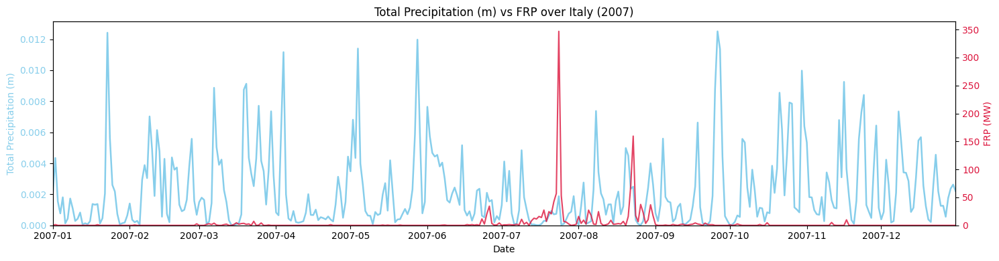


Plotting Max Temperature (°C) (mean) for 2007


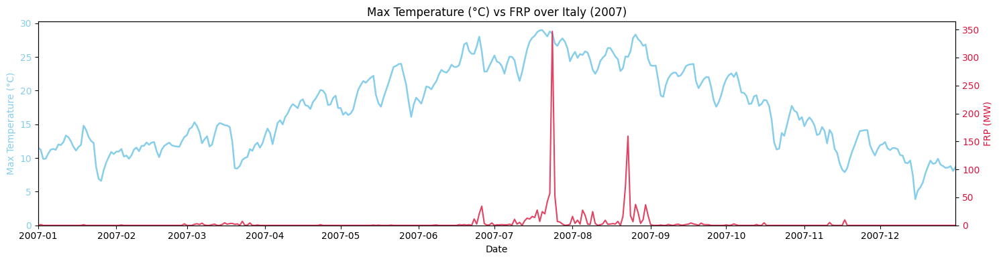


Plotting Max Wind Speed (m/s) (mean) for 2007


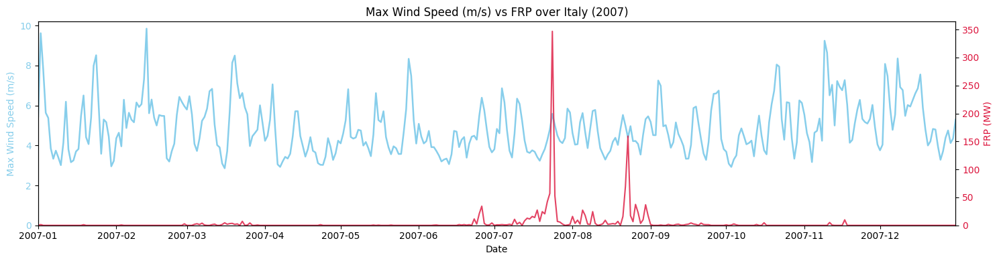

In [47]:
import xarray as xr
import matplotlib.pyplot as plt
import pandas as pd

# ============================================================
# Choose mode: "FRP" or "POLLUTANTS"
# ============================================================
mode = "FRP" 

# ============================================================
# Choose which year to plot
# ============================================================
selected_year = 2007  # <<<<<< CHANGE THIS to select another year

# ============================================================
# File paths for each pollutant
# ============================================================
files = {
    'CO':     r"D:\IPMA\Results\co_fire_meteo_Italy.nc",
    'NO':     r"D:\IPMA\Results\no_fire_meteo_Italy.nc",
    'NO₂':    r"D:\IPMA\Results\no2_fire_meteo_Italy.nc",
    'PM₂.₅':  r"D:\IPMA\Results\pm2p5_fire_meteo_Italy.nc",
    'PM₁₀':   r"D:\IPMA\Results\pm10_fire_meteo_Italy.nc"
}

# ============================================================
# Units for pollutants
# ============================================================
units = {
    'CO': 'µg/m³',
    'NO': 'µg/m³',
    'NO₂': 'µg/m³',
    'PM₂.₅': 'µg/m³',
    'PM₁₀': 'µg/m³'
}

# ============================================================
# Selected meteorological variables (Label, Statistic)
# ============================================================
meteo_vars = {
    'precip_Total_Precipitation': ('Total Precipitation (m)', 'mean'),
    'temp_Max': ('Max Temperature (°C)', 'mean'),
    'wind_Max': ('Max Wind Speed (m/s)', 'mean')
}

# ============================================================
# Load a sample dataset (same meteo vars in all)
# ============================================================
sample_file = list(files.values())[0]
ds_sample = xr.open_dataset(sample_file)
time = pd.to_datetime(ds_sample.time.values)

# ============================================================
# Filter dataset for the selected year
# ============================================================
mask = time.year == selected_year
if not mask.any():
    raise ValueError(f"No data available for year {selected_year}. Available years: {sorted(set(time.year))}")
time = time[mask]
tmin, tmax = time.min(), time.max()

# ============================================================
# Define colors
# ============================================================
meteo_color = 'skyblue'
frp_color = 'crimson'
pollutant_colors = {
    'CO': 'darkgreen',
    'NO': 'tab:red',
    'NO₂': 'tab:purple',
    'PM₂.₅': 'tab:orange',
    'PM₁₀': 'mediumvioletred'
}

# ============================================================
# Main loop: one figure per METEO variable
# ============================================================
for var_name, (label, stat) in meteo_vars.items():
    print(f"\nPlotting {label} ({stat}) for {selected_year}")

    # Select and spatially aggregate meteorological variable
    da = ds_sample[var_name].isel(time=mask)
    if stat == 'mean':
        meteo = da.mean(dim=['latitude', 'longitude'])
    elif stat == 'sum':
        meteo = da.sum(dim=['latitude', 'longitude'])
    elif stat == 'max':
        meteo = da.max(dim=['latitude', 'longitude'])
    elif stat == 'min':
        meteo = da.min(dim=['latitude', 'longitude'])
    elif stat == 'median':
        meteo = da.median(dim=['latitude', 'longitude'])
    else:
        raise ValueError(f"Unsupported stat '{stat}' for variable '{var_name}'")

    # ========================================================
    # MODE 1: FRP comparison
    # ========================================================
    if mode == "FRP":
        fig, ax = plt.subplots(figsize=(15, 4))
        ax.plot(time, meteo, color=meteo_color, linewidth=1.8, label=f"{label} ({stat})")
        ax.set_ylabel(label, color=meteo_color)
        ax.tick_params(axis='y', labelcolor=meteo_color)

        frp = ds_sample['frp_sum_Italy'].isel(time=mask).mean(dim=['latitude', 'longitude'])
        ax2 = ax.twinx()
        ax2.plot(time, frp, color=frp_color, alpha=0.8, linewidth=1.5, label='FRP (MW)')
        ax2.set_ylabel('FRP (MW)', color=frp_color)
        ax2.tick_params(axis='y', labelcolor=frp_color)

        ax.set_ylim(bottom=0)
        ax2.set_ylim(bottom=0)
        ax.set_xlim([tmin, tmax])
        ax.set_xlabel('Date')
        ax.set_title(f'{label} vs FRP over Italy ({selected_year})')
        ax.grid(False)
        plt.tight_layout()
        plt.show()

    # ========================================================
    # MODE 2: Pollutant comparison
    # ========================================================
    elif mode == "POLLUTANTS":
        n_pollutants = len(files)
        fig, axs = plt.subplots(n_pollutants, 1, figsize=(15, 3 * n_pollutants), sharex=True)
        fig.suptitle(f'{label} vs Pollutants over Italy ({selected_year})', fontsize=14)

        for ax, (pollutant_name, file_path) in zip(axs, files.items()):
            ds = xr.open_dataset(file_path)
            pollutant = ds['Mean'].isel(time=mask).mean(dim=['latitude', 'longitude'])
            if pollutant_name == 'CO':
                pollutant *= 1000  # mg/m³ → µg/m³

            ax.plot(time, meteo, color=meteo_color, linewidth=1.8, label=f"{label} ({stat})")
            ax.set_ylabel(label, color=meteo_color)
            ax.tick_params(axis='y', labelcolor=meteo_color)

            color = pollutant_colors.get(pollutant_name, 'tab:blue')
            ax2 = ax.twinx()
            ax2.plot(time, pollutant, color=color, alpha=0.85, linewidth=1.3,
                     label=f'{pollutant_name} ({units[pollutant_name]})')
            ax2.set_ylabel(f'{pollutant_name} ({units[pollutant_name]})', color=color)
            ax2.tick_params(axis='y', labelcolor=color)

            ax.set_ylim(bottom=0)
            ax2.set_ylim(bottom=0)
            ax.set_xlim([tmin, tmax])
            ax.set_title(f'{label} vs {pollutant_name} ({selected_year})')
            ax.grid(False)

        axs[-1].set_xlabel('Date')
        plt.tight_layout(rect=[0, 0, 1, 0.97])
        plt.show()


### Greece

#### All Years


Plotting: Total Precipitation (m) (mean)


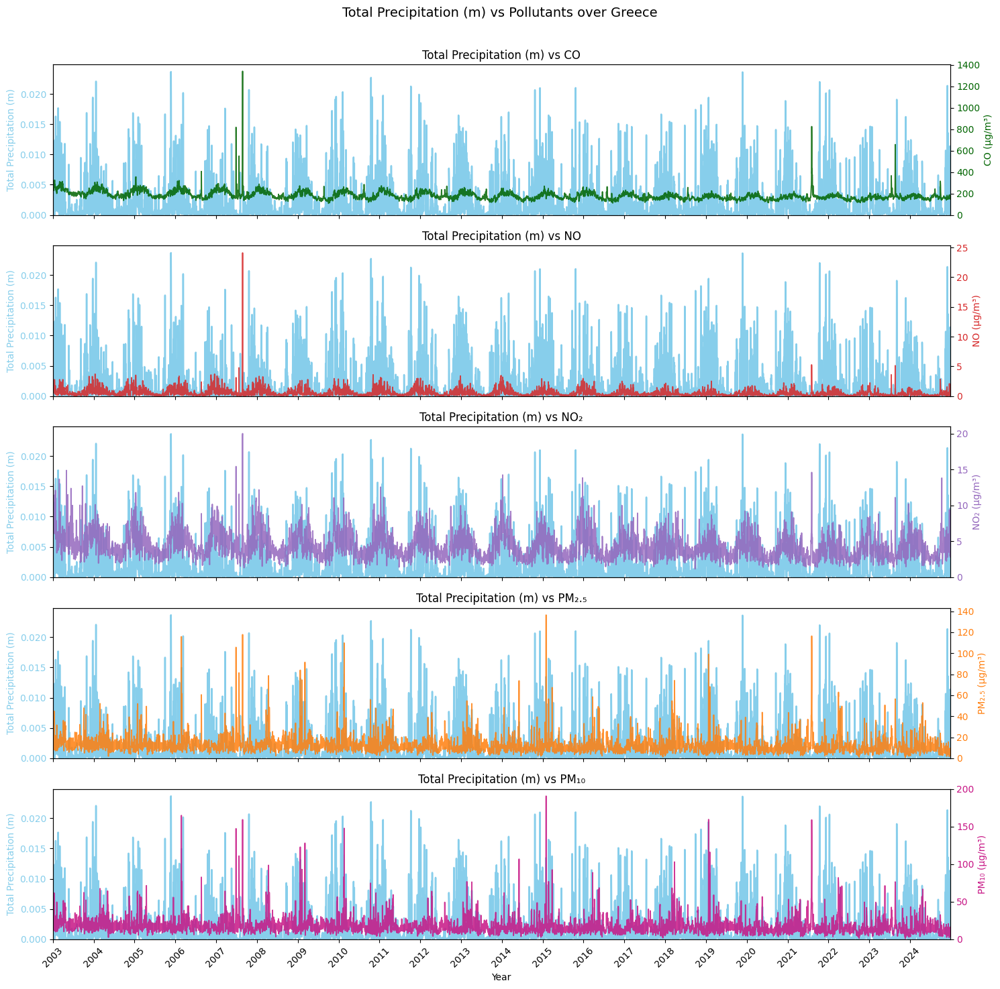


Plotting: Max Temperature (°C) (mean)


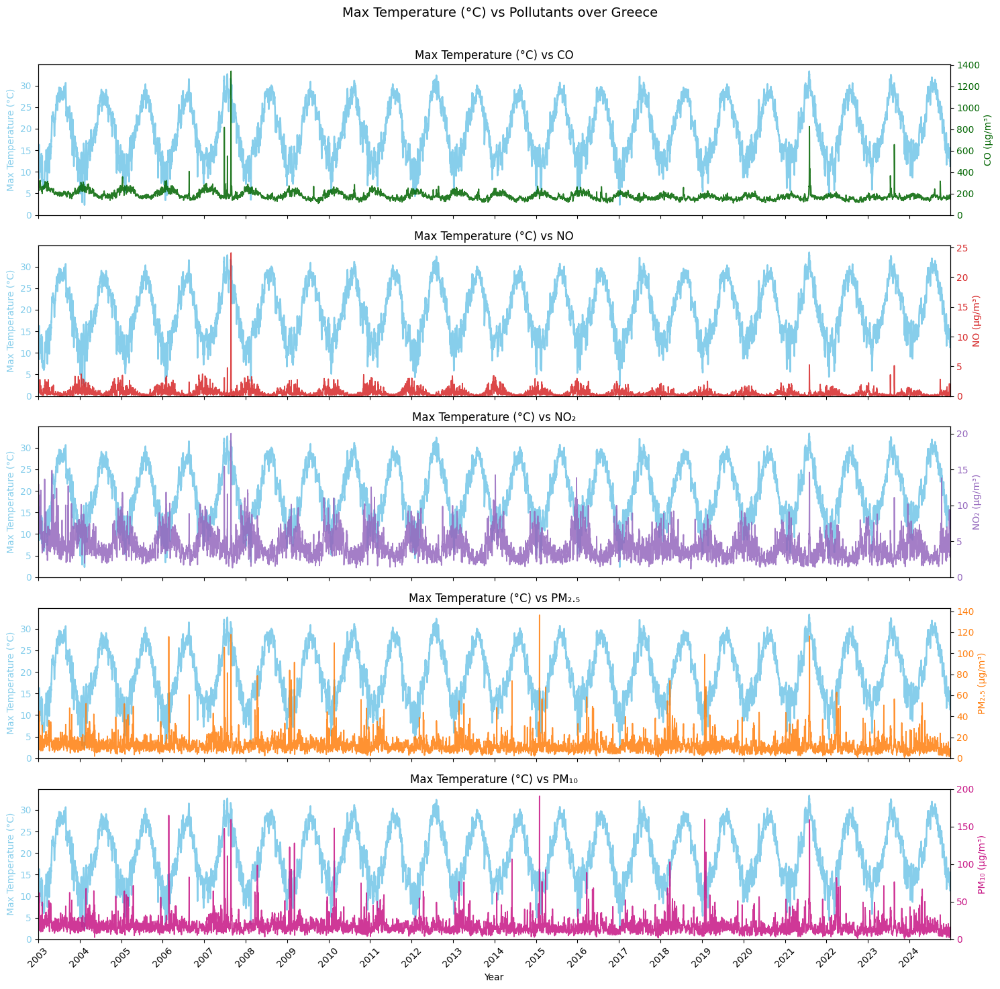


Plotting: Max Wind Speed (m/s) (mean)


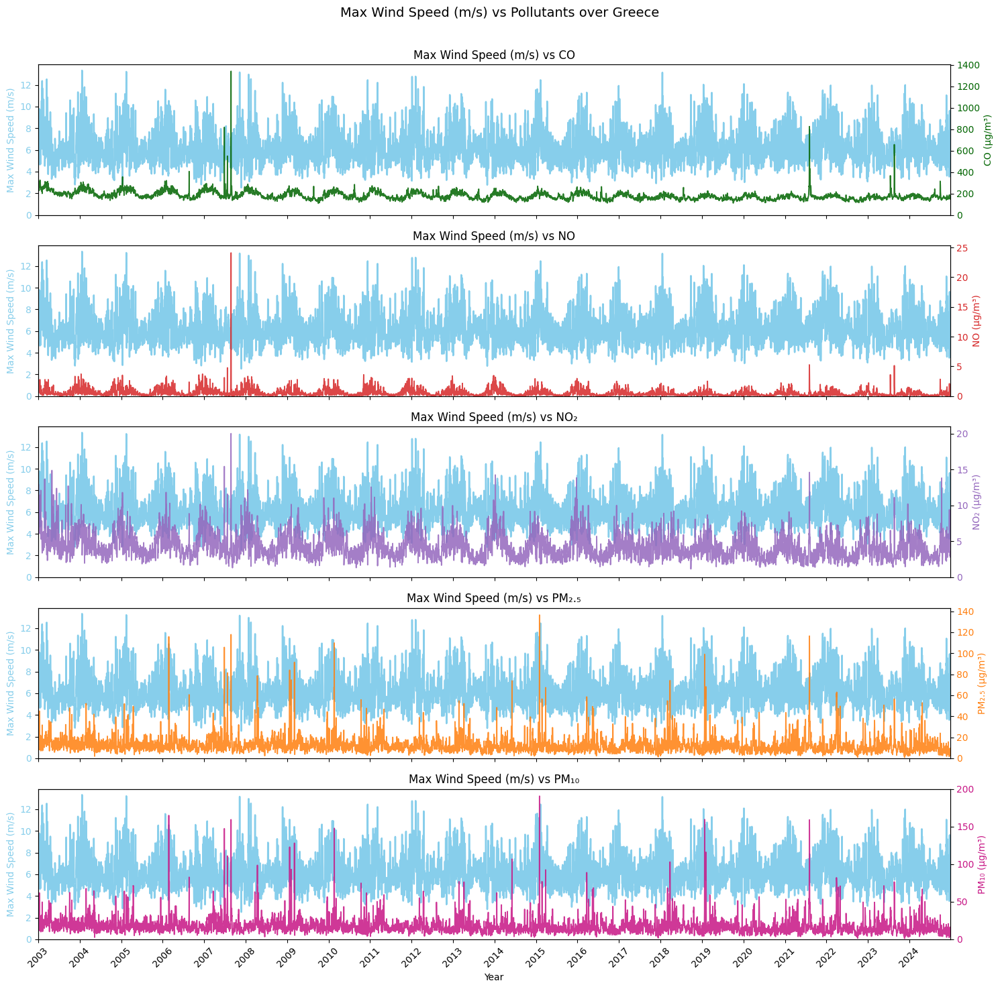

In [48]:
import xarray as xr
import matplotlib.pyplot as plt
import pandas as pd

# ============================================================
# Choose mode: "FRP" or "POLLUTANTS"
# ============================================================
mode = "POLLUTANTS" 

# ============================================================
# File paths for each pollutant
# ============================================================
files = {
    'CO':     r"D:\IPMA\Results\co_fire_meteo_Greece.nc",
    'NO':     r"D:\IPMA\Results\no_fire_meteo_Greece.nc",
    'NO₂':    r"D:\IPMA\Results\no2_fire_meteo_Greece.nc",
    'PM₂.₅':  r"D:\IPMA\Results\pm2p5_fire_meteo_Greece.nc",
    'PM₁₀':   r"D:\IPMA\Results\pm10_fire_meteo_Greece.nc"
}

# ============================================================
# Units for pollutants
# ============================================================
units = {
    'CO': 'µg/m³',
    'NO': 'µg/m³',
    'NO₂': 'µg/m³',
    'PM₂.₅': 'µg/m³',
    'PM₁₀': 'µg/m³'
}

# ============================================================
# Selected meteorological variables (Label, Statistic)
# Options for statistic: 'mean', 'sum', 'max', 'min', 'median'
# ============================================================
meteo_vars = {
    'precip_Total_Precipitation': ('Total Precipitation (m)', 'mean'),
    'temp_Max': ('Max Temperature (°C)', 'mean'),
    'wind_Max': ('Max Wind Speed (m/s)', 'mean')
}

# ============================================================
# Load a sample dataset (same meteo vars in all)
# ============================================================
sample_file = list(files.values())[0]
ds_sample = xr.open_dataset(sample_file)
time = ds_sample.time
tmin, tmax = pd.to_datetime(time.min().values), pd.to_datetime(time.max().values)

# ============================================================
# Define colors
# ============================================================
meteo_color = 'skyblue'
frp_color = 'crimson'
pollutant_colors = {
    'CO': 'darkgreen',
    'NO': 'tab:red',
    'NO₂': 'tab:purple',
    'PM₂.₅': 'tab:orange',
    'PM₁₀': 'mediumvioletred'
}

# ============================================================
# Prepare x-axis: all years
# ============================================================
years = pd.to_datetime(time.values).year
unique_years = sorted(list(set(years)))
xticks = [time.values[years.tolist().index(y)] for y in unique_years]

# ============================================================
# Main loop: one figure per METEO variable
# ============================================================
for var_name, (label, stat) in meteo_vars.items():
    print(f"\nPlotting: {label} ({stat})")

    # Spatial statistic of the meteorological variable
    da = ds_sample[var_name]
    if stat == 'mean':
        meteo = da.mean(dim=['latitude', 'longitude'])
    elif stat == 'sum':
        meteo = da.sum(dim=['latitude', 'longitude'])
    elif stat == 'max':
        meteo = da.max(dim=['latitude', 'longitude'])
    elif stat == 'min':
        meteo = da.min(dim=['latitude', 'longitude'])
    elif stat == 'median':
        meteo = da.median(dim=['latitude', 'longitude'])
    else:
        raise ValueError(f"Unsupported stat '{stat}' for variable '{var_name}'")

    # ========================================================
    # MODE 1: FRP comparison
    # ========================================================
    if mode == "FRP":
        fig, ax = plt.subplots(figsize=(15, 4))
        ax.plot(time, meteo, color=meteo_color, linewidth=1.8, label=f"{label} ({stat})")
        ax.set_ylabel(label, color=meteo_color)
        ax.tick_params(axis='y', labelcolor=meteo_color)

        frp = ds_sample['frp_sum_Greece'].mean(dim=['latitude', 'longitude'])
        ax2 = ax.twinx()
        ax2.plot(time, frp, color=frp_color, alpha=0.8, linewidth=1.5, label='FRP (MW)')
        ax2.set_ylabel('FRP (MW)', color=frp_color)
        ax2.tick_params(axis='y', labelcolor=frp_color)

        # Formatting
        ax.set_ylim(bottom=0)
        ax2.set_ylim(bottom=0)
        ax.set_xlim([tmin, tmax])
        ax.set_xticks(xticks)
        ax.set_xticklabels(unique_years, rotation=45)
        ax.set_xlabel('Year')
        ax.set_title(f'{label} vs FRP over Greece')
        ax.grid(False)
        plt.tight_layout()
        plt.show()

    # ========================================================
    # MODE 2: Pollutant comparison
    # ========================================================
    elif mode == "POLLUTANTS":
        n_pollutants = len(files)
        fig, axs = plt.subplots(n_pollutants, 1, figsize=(15, 3 * n_pollutants), sharex=True)
        fig.suptitle(f'{label} vs Pollutants over Greece', fontsize=14)

        for ax, (pollutant_name, file_path) in zip(axs, files.items()):
            ds = xr.open_dataset(file_path)
            pollutant = ds['Mean'].mean(dim=['latitude', 'longitude'])
            if pollutant_name == 'CO':
                pollutant *= 1000  # mg/m³ → µg/m³

            # Meteo (left y-axis)
            ax.plot(time, meteo, color=meteo_color, linewidth=1.8, label=f"{label} ({stat})")
            ax.set_ylabel(label, color=meteo_color)
            ax.tick_params(axis='y', labelcolor=meteo_color)

            # Pollutant (right y-axis)
            color = pollutant_colors.get(pollutant_name, 'tab:blue')
            ax2 = ax.twinx()
            ax2.plot(time, pollutant, color=color, alpha=0.85, linewidth=1.3,
                     label=f'{pollutant_name} ({units[pollutant_name]})')
            ax2.set_ylabel(f'{pollutant_name} ({units[pollutant_name]})', color=color)
            ax2.tick_params(axis='y', labelcolor=color)

            # Formatting
            ax.set_ylim(bottom=0)
            ax2.set_ylim(bottom=0)
            ax.set_xlim([tmin, tmax])
            ax.set_xticks(xticks)
            ax.set_xticklabels(unique_years, rotation=45)
            ax.set_title(f'{label} vs {pollutant_name}')
            ax.grid(False)

        axs[-1].set_xlabel('Year')
        plt.tight_layout(rect=[0, 0, 1, 0.97])
        plt.show()



Plotting: Total Precipitation (m) (mean)


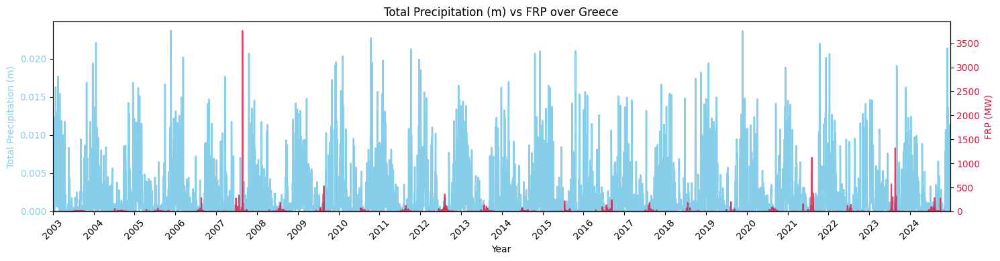


Plotting: Max Temperature (°C) (mean)


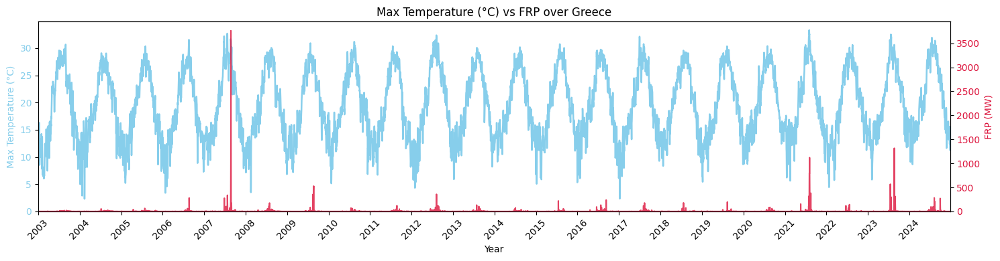


Plotting: Max Wind Speed (m/s) (mean)


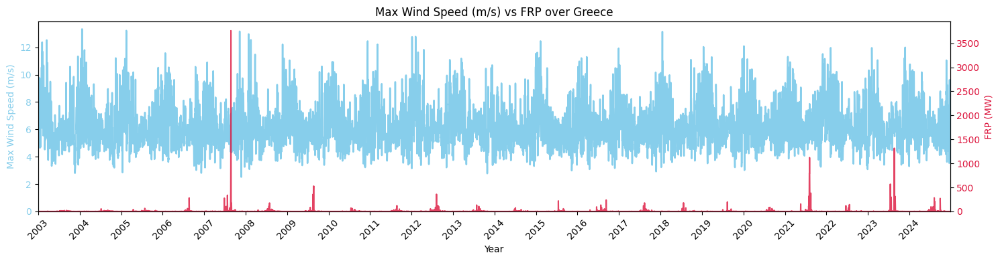

In [49]:
import xarray as xr
import matplotlib.pyplot as plt
import pandas as pd

# ============================================================
# Choose mode: "FRP" or "POLLUTANTS"
# ============================================================
mode = "FRP" 

# ============================================================
# File paths for each pollutant
# ============================================================
files = {
    'CO':     r"D:\IPMA\Results\co_fire_meteo_Greece.nc",
    'NO':     r"D:\IPMA\Results\no_fire_meteo_Greece.nc",
    'NO₂':    r"D:\IPMA\Results\no2_fire_meteo_Greece.nc",
    'PM₂.₅':  r"D:\IPMA\Results\pm2p5_fire_meteo_Greece.nc",
    'PM₁₀':   r"D:\IPMA\Results\pm10_fire_meteo_Greece.nc"
}

# ============================================================
# Units for pollutants
# ============================================================
units = {
    'CO': 'µg/m³',
    'NO': 'µg/m³',
    'NO₂': 'µg/m³',
    'PM₂.₅': 'µg/m³',
    'PM₁₀': 'µg/m³'
}

# ============================================================
# Selected meteorological variables (Label, Statistic)
# Options for statistic: 'mean', 'sum', 'max', 'min', 'median'
# ============================================================
meteo_vars = {
    'precip_Total_Precipitation': ('Total Precipitation (m)', 'mean'),
    'temp_Max': ('Max Temperature (°C)', 'mean'),
    'wind_Max': ('Max Wind Speed (m/s)', 'mean')
}

# ============================================================
# Load a sample dataset (same meteo vars in all)
# ============================================================
sample_file = list(files.values())[0]
ds_sample = xr.open_dataset(sample_file)
time = ds_sample.time
tmin, tmax = pd.to_datetime(time.min().values), pd.to_datetime(time.max().values)

# ============================================================
# Define colors
# ============================================================
meteo_color = 'skyblue'
frp_color = 'crimson'
pollutant_colors = {
    'CO': 'darkgreen',
    'NO': 'tab:red',
    'NO₂': 'tab:purple',
    'PM₂.₅': 'tab:orange',
    'PM₁₀': 'mediumvioletred'
}

# ============================================================
# Prepare x-axis: all years
# ============================================================
years = pd.to_datetime(time.values).year
unique_years = sorted(list(set(years)))
xticks = [time.values[years.tolist().index(y)] for y in unique_years]

# ============================================================
# Main loop: one figure per METEO variable
# ============================================================
for var_name, (label, stat) in meteo_vars.items():
    print(f"\nPlotting: {label} ({stat})")

    # Spatial statistic of the meteorological variable
    da = ds_sample[var_name]
    if stat == 'mean':
        meteo = da.mean(dim=['latitude', 'longitude'])
    elif stat == 'sum':
        meteo = da.sum(dim=['latitude', 'longitude'])
    elif stat == 'max':
        meteo = da.max(dim=['latitude', 'longitude'])
    elif stat == 'min':
        meteo = da.min(dim=['latitude', 'longitude'])
    elif stat == 'median':
        meteo = da.median(dim=['latitude', 'longitude'])
    else:
        raise ValueError(f"Unsupported stat '{stat}' for variable '{var_name}'")

    # ========================================================
    # MODE 1: FRP comparison
    # ========================================================
    if mode == "FRP":
        fig, ax = plt.subplots(figsize=(15, 4))
        ax.plot(time, meteo, color=meteo_color, linewidth=1.8, label=f"{label} ({stat})")
        ax.set_ylabel(label, color=meteo_color)
        ax.tick_params(axis='y', labelcolor=meteo_color)

        frp = ds_sample['frp_sum_Greece'].mean(dim=['latitude', 'longitude'])
        ax2 = ax.twinx()
        ax2.plot(time, frp, color=frp_color, alpha=0.8, linewidth=1.5, label='FRP (MW)')
        ax2.set_ylabel('FRP (MW)', color=frp_color)
        ax2.tick_params(axis='y', labelcolor=frp_color)

        # Formatting
        ax.set_ylim(bottom=0)
        ax2.set_ylim(bottom=0)
        ax.set_xlim([tmin, tmax])
        ax.set_xticks(xticks)
        ax.set_xticklabels(unique_years, rotation=45)
        ax.set_xlabel('Year')
        ax.set_title(f'{label} vs FRP over Greece')
        ax.grid(False)
        plt.tight_layout()
        plt.show()

    # ========================================================
    # MODE 2: Pollutant comparison
    # ========================================================
    elif mode == "POLLUTANTS":
        n_pollutants = len(files)
        fig, axs = plt.subplots(n_pollutants, 1, figsize=(15, 3 * n_pollutants), sharex=True)
        fig.suptitle(f'{label} vs Pollutants over Greece', fontsize=14)

        for ax, (pollutant_name, file_path) in zip(axs, files.items()):
            ds = xr.open_dataset(file_path)
            pollutant = ds['Mean'].mean(dim=['latitude', 'longitude'])
            if pollutant_name == 'CO':
                pollutant *= 1000  # mg/m³ → µg/m³

            # Meteo (left y-axis)
            ax.plot(time, meteo, color=meteo_color, linewidth=1.8, label=f"{label} ({stat})")
            ax.set_ylabel(label, color=meteo_color)
            ax.tick_params(axis='y', labelcolor=meteo_color)

            # Pollutant (right y-axis)
            color = pollutant_colors.get(pollutant_name, 'tab:blue')
            ax2 = ax.twinx()
            ax2.plot(time, pollutant, color=color, alpha=0.85, linewidth=1.3,
                     label=f'{pollutant_name} ({units[pollutant_name]})')
            ax2.set_ylabel(f'{pollutant_name} ({units[pollutant_name]})', color=color)
            ax2.tick_params(axis='y', labelcolor=color)

            # Formatting
            ax.set_ylim(bottom=0)
            ax2.set_ylim(bottom=0)
            ax.set_xlim([tmin, tmax])
            ax.set_xticks(xticks)
            ax.set_xticklabels(unique_years, rotation=45)
            ax.set_title(f'{label} vs {pollutant_name}')
            ax.grid(False)

        axs[-1].set_xlabel('Year')
        plt.tight_layout(rect=[0, 0, 1, 0.97])
        plt.show()


#### Certain Year


Plotting Total Precipitation (m) (mean) for 2023


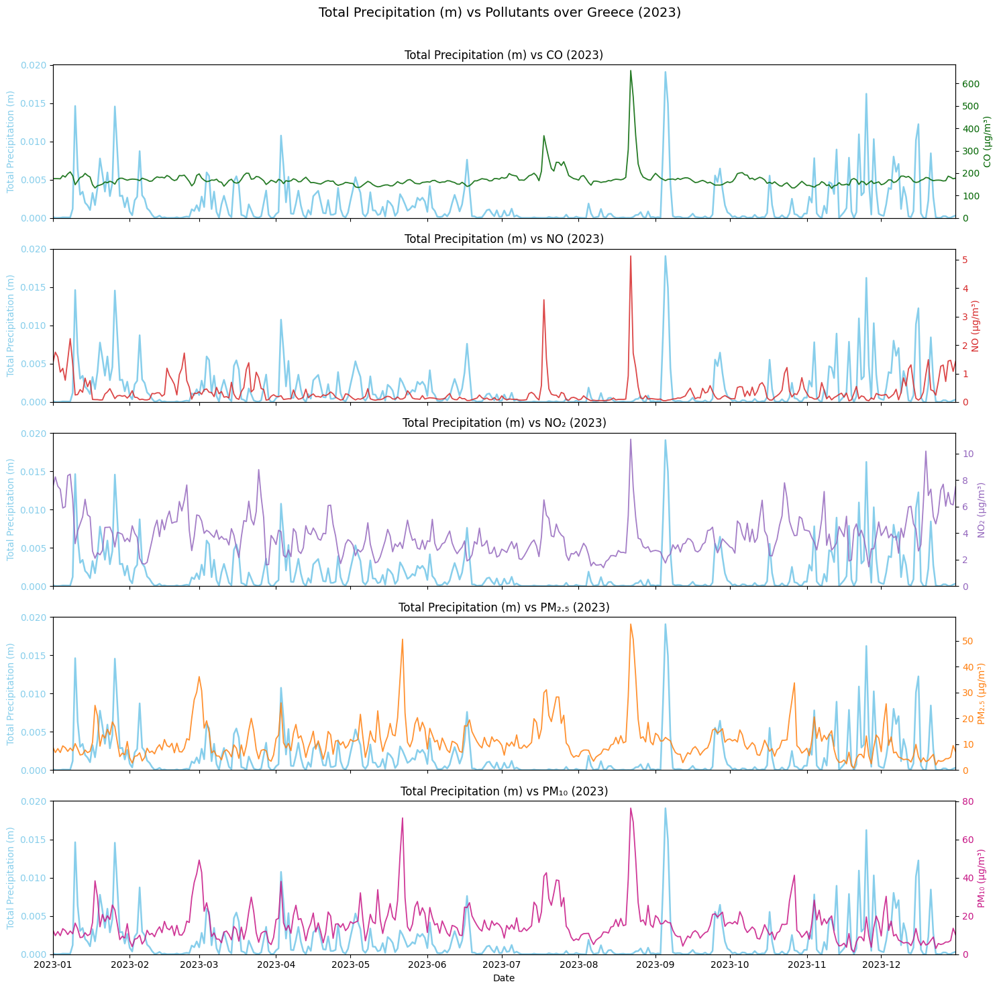


Plotting Max Temperature (°C) (mean) for 2023


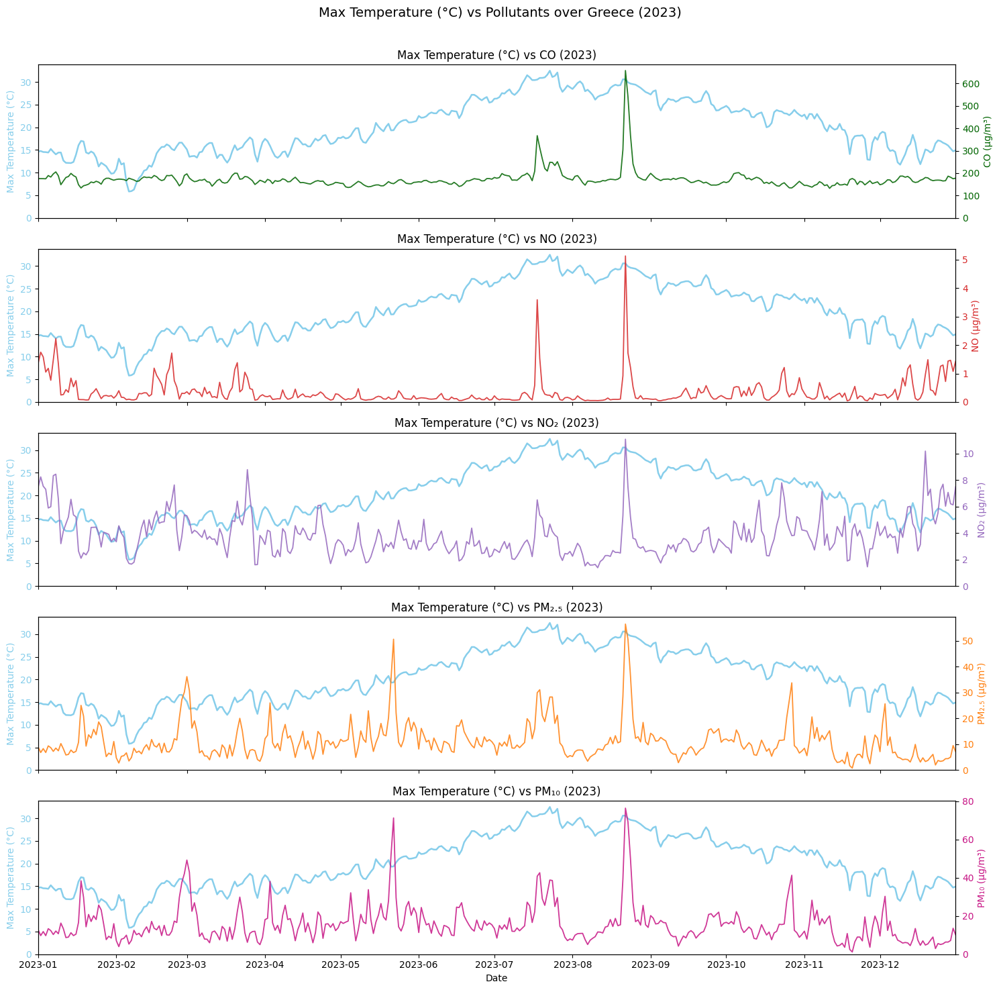


Plotting Max Wind Speed (m/s) (mean) for 2023


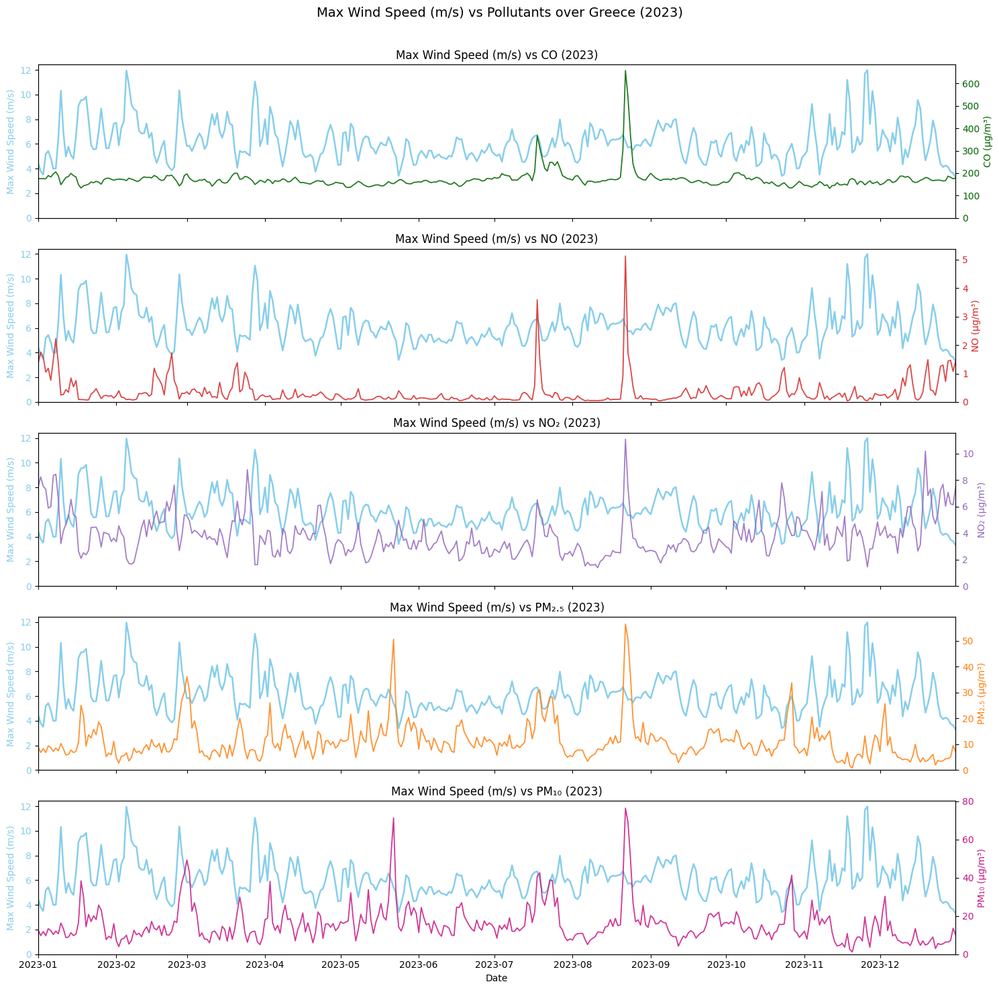

In [50]:
import xarray as xr
import matplotlib.pyplot as plt
import pandas as pd

# ============================================================
# Choose mode: "FRP" or "POLLUTANTS"
# ============================================================
mode = "POLLUTANTS" 

# ============================================================
# Choose which year to plot
# ============================================================
selected_year = 2023  # <<<<<< CHANGE THIS to select another year

# ============================================================
# File paths for each pollutant
# ============================================================
files = {
    'CO':     r"D:\IPMA\Results\co_fire_meteo_Greece.nc",
    'NO':     r"D:\IPMA\Results\no_fire_meteo_Greece.nc",
    'NO₂':    r"D:\IPMA\Results\no2_fire_meteo_Greece.nc",
    'PM₂.₅':  r"D:\IPMA\Results\pm2p5_fire_meteo_Greece.nc",
    'PM₁₀':   r"D:\IPMA\Results\pm10_fire_meteo_Greece.nc"
}

# ============================================================
# Units for pollutants
# ============================================================
units = {
    'CO': 'µg/m³',
    'NO': 'µg/m³',
    'NO₂': 'µg/m³',
    'PM₂.₅': 'µg/m³',
    'PM₁₀': 'µg/m³'
}

# ============================================================
# Selected meteorological variables (Label, Statistic)
# ============================================================
meteo_vars = {
    'precip_Total_Precipitation': ('Total Precipitation (m)', 'mean'),
    'temp_Max': ('Max Temperature (°C)', 'mean'),
    'wind_Max': ('Max Wind Speed (m/s)', 'mean')
}

# ============================================================
# Load a sample dataset (same meteo vars in all)
# ============================================================
sample_file = list(files.values())[0]
ds_sample = xr.open_dataset(sample_file)
time = pd.to_datetime(ds_sample.time.values)

# ============================================================
# Filter dataset for the selected year
# ============================================================
mask = time.year == selected_year
if not mask.any():
    raise ValueError(f"No data available for year {selected_year}. Available years: {sorted(set(time.year))}")
time = time[mask]
tmin, tmax = time.min(), time.max()

# ============================================================
# Define colors
# ============================================================
meteo_color = 'skyblue'
frp_color = 'crimson'
pollutant_colors = {
    'CO': 'darkgreen',
    'NO': 'tab:red',
    'NO₂': 'tab:purple',
    'PM₂.₅': 'tab:orange',
    'PM₁₀': 'mediumvioletred'
}

# ============================================================
# Main loop: one figure per METEO variable
# ============================================================
for var_name, (label, stat) in meteo_vars.items():
    print(f"\nPlotting {label} ({stat}) for {selected_year}")

    # Select and spatially aggregate meteorological variable
    da = ds_sample[var_name].isel(time=mask)
    if stat == 'mean':
        meteo = da.mean(dim=['latitude', 'longitude'])
    elif stat == 'sum':
        meteo = da.sum(dim=['latitude', 'longitude'])
    elif stat == 'max':
        meteo = da.max(dim=['latitude', 'longitude'])
    elif stat == 'min':
        meteo = da.min(dim=['latitude', 'longitude'])
    elif stat == 'median':
        meteo = da.median(dim=['latitude', 'longitude'])
    else:
        raise ValueError(f"Unsupported stat '{stat}' for variable '{var_name}'")

    # ========================================================
    # MODE 1: FRP comparison
    # ========================================================
    if mode == "FRP":
        fig, ax = plt.subplots(figsize=(15, 4))
        ax.plot(time, meteo, color=meteo_color, linewidth=1.8, label=f"{label} ({stat})")
        ax.set_ylabel(label, color=meteo_color)
        ax.tick_params(axis='y', labelcolor=meteo_color)

        frp = ds_sample['frp_sum_Greece'].isel(time=mask).mean(dim=['latitude', 'longitude'])
        ax2 = ax.twinx()
        ax2.plot(time, frp, color=frp_color, alpha=0.8, linewidth=1.5, label='FRP (MW)')
        ax2.set_ylabel('FRP (MW)', color=frp_color)
        ax2.tick_params(axis='y', labelcolor=frp_color)

        ax.set_ylim(bottom=0)
        ax2.set_ylim(bottom=0)
        ax.set_xlim([tmin, tmax])
        ax.set_xlabel('Date')
        ax.set_title(f'{label} vs FRP over Greece ({selected_year})')
        ax.grid(False)
        plt.tight_layout()
        plt.show()

    # ========================================================
    # MODE 2: Pollutant comparison
    # ========================================================
    elif mode == "POLLUTANTS":
        n_pollutants = len(files)
        fig, axs = plt.subplots(n_pollutants, 1, figsize=(15, 3 * n_pollutants), sharex=True)
        fig.suptitle(f'{label} vs Pollutants over Greece ({selected_year})', fontsize=14)

        for ax, (pollutant_name, file_path) in zip(axs, files.items()):
            ds = xr.open_dataset(file_path)
            pollutant = ds['Mean'].isel(time=mask).mean(dim=['latitude', 'longitude'])
            if pollutant_name == 'CO':
                pollutant *= 1000  # mg/m³ → µg/m³

            ax.plot(time, meteo, color=meteo_color, linewidth=1.8, label=f"{label} ({stat})")
            ax.set_ylabel(label, color=meteo_color)
            ax.tick_params(axis='y', labelcolor=meteo_color)

            color = pollutant_colors.get(pollutant_name, 'tab:blue')
            ax2 = ax.twinx()
            ax2.plot(time, pollutant, color=color, alpha=0.85, linewidth=1.3,
                     label=f'{pollutant_name} ({units[pollutant_name]})')
            ax2.set_ylabel(f'{pollutant_name} ({units[pollutant_name]})', color=color)
            ax2.tick_params(axis='y', labelcolor=color)

            ax.set_ylim(bottom=0)
            ax2.set_ylim(bottom=0)
            ax.set_xlim([tmin, tmax])
            ax.set_title(f'{label} vs {pollutant_name} ({selected_year})')
            ax.grid(False)

        axs[-1].set_xlabel('Date')
        plt.tight_layout(rect=[0, 0, 1, 0.97])
        plt.show()



Plotting Total Precipitation (m) (mean) for 2023


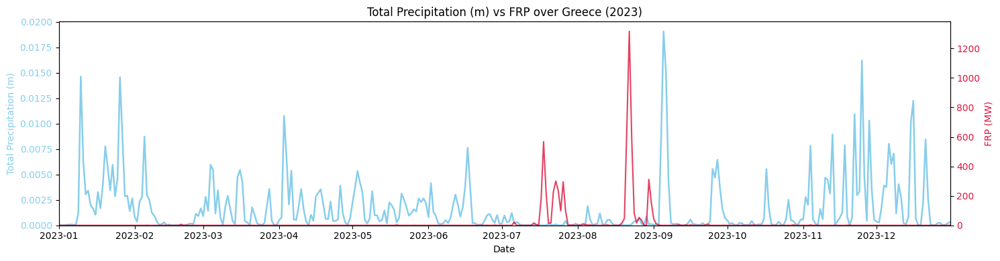


Plotting Max Temperature (°C) (mean) for 2023


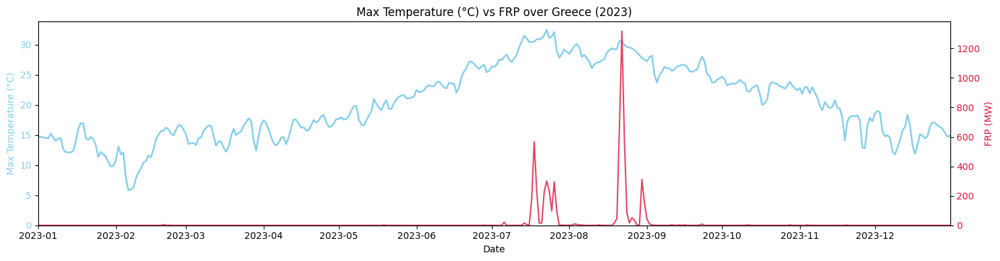


Plotting Max Wind Speed (m/s) (mean) for 2023


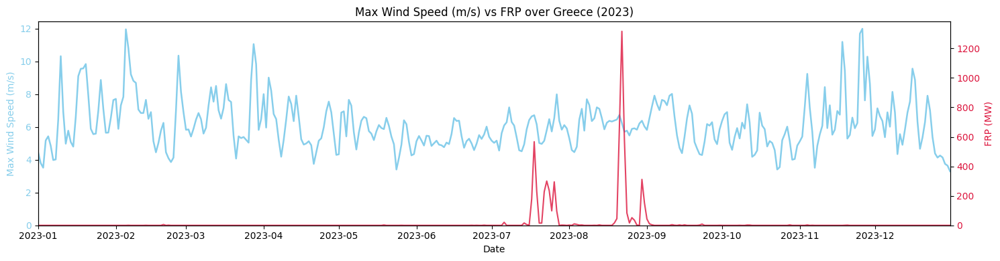

In [51]:
import xarray as xr
import matplotlib.pyplot as plt
import pandas as pd

# ============================================================
# Choose mode: "FRP" or "POLLUTANTS"
# ============================================================
mode = "FRP" 

# ============================================================
# Choose which year to plot
# ============================================================
selected_year = 2023  # <<<<<< CHANGE THIS to select another year

# ============================================================
# File paths for each pollutant
# ============================================================
files = {
    'CO':     r"D:\IPMA\Results\co_fire_meteo_Greece.nc",
    'NO':     r"D:\IPMA\Results\no_fire_meteo_Greece.nc",
    'NO₂':    r"D:\IPMA\Results\no2_fire_meteo_Greece.nc",
    'PM₂.₅':  r"D:\IPMA\Results\pm2p5_fire_meteo_Greece.nc",
    'PM₁₀':   r"D:\IPMA\Results\pm10_fire_meteo_Greece.nc"
}

# ============================================================
# Units for pollutants
# ============================================================
units = {
    'CO': 'µg/m³',
    'NO': 'µg/m³',
    'NO₂': 'µg/m³',
    'PM₂.₅': 'µg/m³',
    'PM₁₀': 'µg/m³'
}

# ============================================================
# Selected meteorological variables (Label, Statistic)
# ============================================================
meteo_vars = {
    'precip_Total_Precipitation': ('Total Precipitation (m)', 'mean'),
    'temp_Max': ('Max Temperature (°C)', 'mean'),
    'wind_Max': ('Max Wind Speed (m/s)', 'mean')
}

# ============================================================
# Load a sample dataset (same meteo vars in all)
# ============================================================
sample_file = list(files.values())[0]
ds_sample = xr.open_dataset(sample_file)
time = pd.to_datetime(ds_sample.time.values)

# ============================================================
# Filter dataset for the selected year
# ============================================================
mask = time.year == selected_year
if not mask.any():
    raise ValueError(f"No data available for year {selected_year}. Available years: {sorted(set(time.year))}")
time = time[mask]
tmin, tmax = time.min(), time.max()

# ============================================================
# Define colors
# ============================================================
meteo_color = 'skyblue'
frp_color = 'crimson'
pollutant_colors = {
    'CO': 'darkgreen',
    'NO': 'tab:red',
    'NO₂': 'tab:purple',
    'PM₂.₅': 'tab:orange',
    'PM₁₀': 'mediumvioletred'
}

# ============================================================
# Main loop: one figure per METEO variable
# ============================================================
for var_name, (label, stat) in meteo_vars.items():
    print(f"\nPlotting {label} ({stat}) for {selected_year}")

    # Select and spatially aggregate meteorological variable
    da = ds_sample[var_name].isel(time=mask)
    if stat == 'mean':
        meteo = da.mean(dim=['latitude', 'longitude'])
    elif stat == 'sum':
        meteo = da.sum(dim=['latitude', 'longitude'])
    elif stat == 'max':
        meteo = da.max(dim=['latitude', 'longitude'])
    elif stat == 'min':
        meteo = da.min(dim=['latitude', 'longitude'])
    elif stat == 'median':
        meteo = da.median(dim=['latitude', 'longitude'])
    else:
        raise ValueError(f"Unsupported stat '{stat}' for variable '{var_name}'")

    # ========================================================
    # MODE 1: FRP comparison
    # ========================================================
    if mode == "FRP":
        fig, ax = plt.subplots(figsize=(15, 4))
        ax.plot(time, meteo, color=meteo_color, linewidth=1.8, label=f"{label} ({stat})")
        ax.set_ylabel(label, color=meteo_color)
        ax.tick_params(axis='y', labelcolor=meteo_color)

        frp = ds_sample['frp_sum_Greece'].isel(time=mask).mean(dim=['latitude', 'longitude'])
        ax2 = ax.twinx()
        ax2.plot(time, frp, color=frp_color, alpha=0.8, linewidth=1.5, label='FRP (MW)')
        ax2.set_ylabel('FRP (MW)', color=frp_color)
        ax2.tick_params(axis='y', labelcolor=frp_color)

        ax.set_ylim(bottom=0)
        ax2.set_ylim(bottom=0)
        ax.set_xlim([tmin, tmax])
        ax.set_xlabel('Date')
        ax.set_title(f'{label} vs FRP over Greece ({selected_year})')
        ax.grid(False)
        plt.tight_layout()
        plt.show()

    # ========================================================
    # MODE 2: Pollutant comparison
    # ========================================================
    elif mode == "POLLUTANTS":
        n_pollutants = len(files)
        fig, axs = plt.subplots(n_pollutants, 1, figsize=(15, 3 * n_pollutants), sharex=True)
        fig.suptitle(f'{label} vs Pollutants over Greece ({selected_year})', fontsize=14)

        for ax, (pollutant_name, file_path) in zip(axs, files.items()):
            ds = xr.open_dataset(file_path)
            pollutant = ds['Mean'].isel(time=mask).mean(dim=['latitude', 'longitude'])
            if pollutant_name == 'CO':
                pollutant *= 1000  # mg/m³ → µg/m³

            ax.plot(time, meteo, color=meteo_color, linewidth=1.8, label=f"{label} ({stat})")
            ax.set_ylabel(label, color=meteo_color)
            ax.tick_params(axis='y', labelcolor=meteo_color)

            color = pollutant_colors.get(pollutant_name, 'tab:blue')
            ax2 = ax.twinx()
            ax2.plot(time, pollutant, color=color, alpha=0.85, linewidth=1.3,
                     label=f'{pollutant_name} ({units[pollutant_name]})')
            ax2.set_ylabel(f'{pollutant_name} ({units[pollutant_name]})', color=color)
            ax2.tick_params(axis='y', labelcolor=color)

            ax.set_ylim(bottom=0)
            ax2.set_ylim(bottom=0)
            ax.set_xlim([tmin, tmax])
            ax.set_title(f'{label} vs {pollutant_name} ({selected_year})')
            ax.grid(False)

        axs[-1].set_xlabel('Date')
        plt.tight_layout(rect=[0, 0, 1, 0.97])
        plt.show()


## Crossover of Meteo and Pollutants - Scatterplot

In [52]:
            # # Linear regression line + R²
            # model = LinearRegression().fit(x, y)
            # y_pred = model.predict(x)
            # r2 = r2_score(y, y_pred)
            # ax.plot(x, y_pred, color='black', linestyle='--', linewidth=1.2,
            #         label=f'Fit (R² = {r2:.2f})')

### Portugal

#### All Years


Plotting correlations for: Total Precipitation (m) (mean)


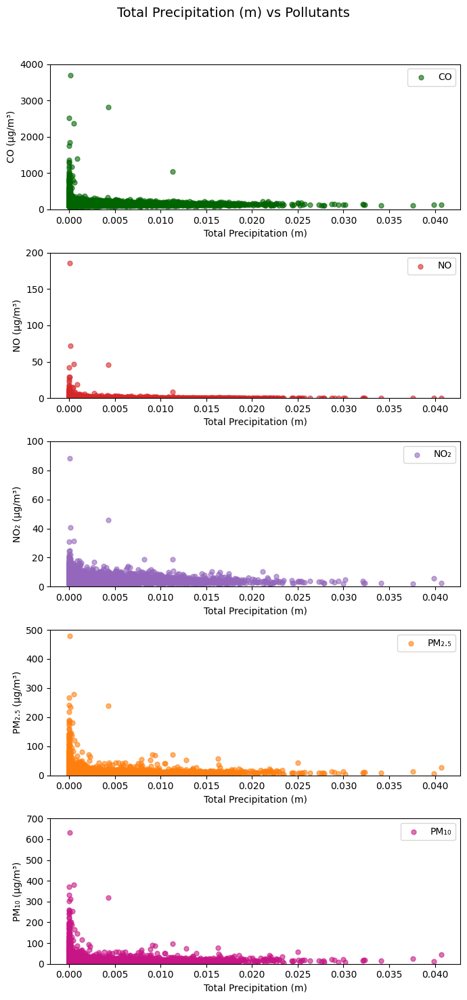


Plotting correlations for: Max Temperature (°C) (mean)


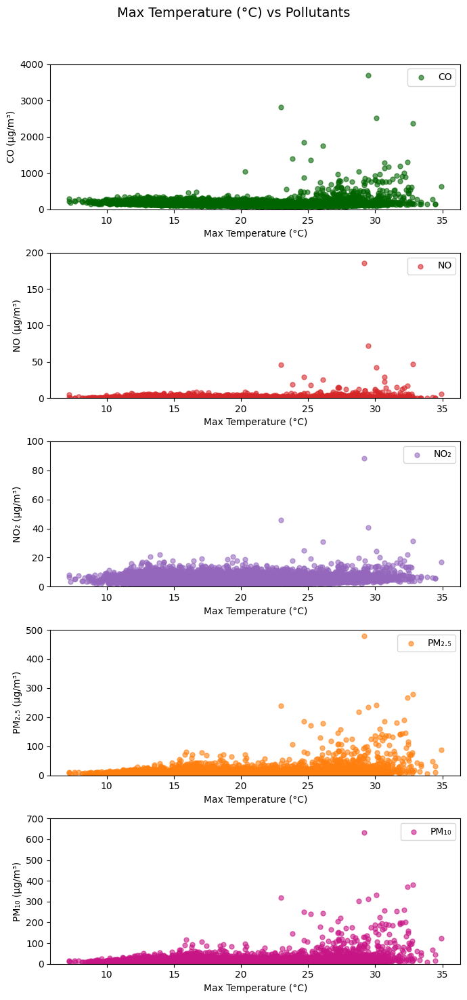


Plotting correlations for: Max Wind Speed (m/s) (mean)


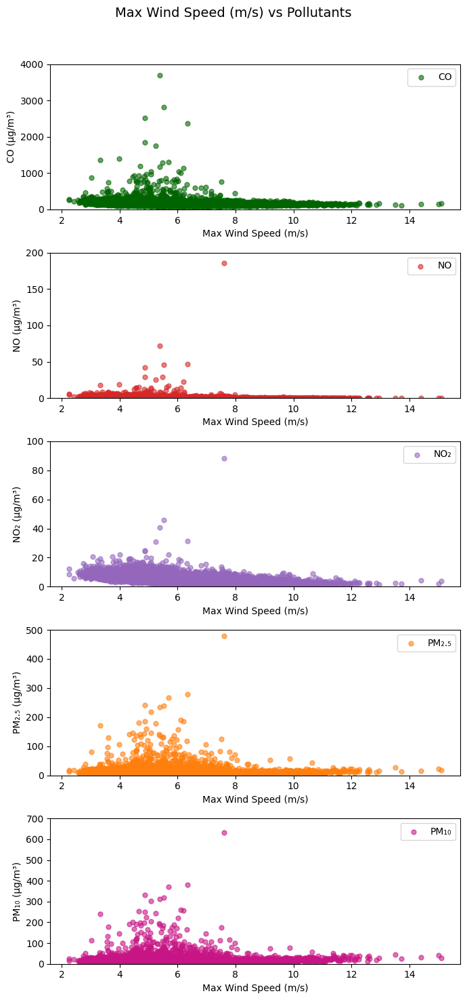

In [53]:
import xarray as xr
import matplotlib.pyplot as plt
import pandas as pd
import numpy as np
from sklearn.linear_model import LinearRegression
from sklearn.metrics import r2_score

# ============================================================
# Choose mode: "FRP" or "POLLUTANTS"
# ============================================================
mode = "POLLUTANTS"  

# ============================================================
# File paths for each pollutant
# ============================================================
files = {
    'CO':     r"D:\IPMA\Results\co_fire_meteo_Portugal.nc",
    'NO':     r"D:\IPMA\Results\no_fire_meteo_Portugal.nc",
    'NO₂':    r"D:\IPMA\Results\no2_fire_meteo_Portugal.nc",
    'PM₂.₅':  r"D:\IPMA\Results\pm2p5_fire_meteo_Portugal.nc",
    'PM₁₀':   r"D:\IPMA\Results\pm10_fire_meteo_Portugal.nc"
}

# ============================================================
# Units for pollutants
# ============================================================
units = {
    'CO': 'µg/m³',
    'NO': 'µg/m³',
    'NO₂': 'µg/m³',
    'PM₂.₅': 'µg/m³',
    'PM₁₀': 'µg/m³'
}

# ============================================================
# Selected meteorological variables (Label, Statistic)
# ============================================================
meteo_vars = {
    'precip_Total_Precipitation': ('Total Precipitation (m)', 'mean'),
    'temp_Max': ('Max Temperature (°C)', 'mean'),
    'wind_Max': ('Max Wind Speed (m/s)', 'mean')
}

# ============================================================
# Load sample dataset
# ============================================================
sample_file = list(files.values())[0]
ds_sample = xr.open_dataset(sample_file)
time = ds_sample.time
tmin, tmax = pd.to_datetime(time.min().values), pd.to_datetime(time.max().values)

# ============================================================
# Colors
# ============================================================
pollutant_colors = {
    'CO': 'darkgreen',
    'NO': 'tab:red',
    'NO₂': 'tab:purple',
    'PM₂.₅': 'tab:orange',
    'PM₁₀': 'mediumvioletred'
}
frp_color = 'crimson'

# ============================================================
# Main loop
# ============================================================
for var_name, (label, stat) in meteo_vars.items():
    print(f"\nPlotting correlations for: {label} ({stat})")

    # Get meteorological variable (spatial statistic)
    da = ds_sample[var_name]
    if stat == 'mean':
        meteo = da.mean(dim=['latitude', 'longitude'])
    elif stat == 'sum':
        meteo = da.sum(dim=['latitude', 'longitude'])
    elif stat == 'max':
        meteo = da.max(dim=['latitude', 'longitude'])
    elif stat == 'min':
        meteo = da.min(dim=['latitude', 'longitude'])
    elif stat == 'median':
        meteo = da.median(dim=['latitude', 'longitude'])
    else:
        raise ValueError(f"Unsupported stat '{stat}' for variable '{var_name}'")

    meteo_values = meteo.values
    meteo_valid = np.isfinite(meteo_values)

    # ========================================================
    # MODE 1: FRP scatter comparison
    # ========================================================
    if mode == "FRP":
        frp = ds_sample['frp_sum_Portugal'].mean(dim=['latitude', 'longitude']).values
        valid = meteo_valid & np.isfinite(frp)
        x = meteo_values[valid].reshape(-1, 1)
        y = frp[valid]

        # Scatter
        fig, ax = plt.subplots(figsize=(7, 5))
        ax.scatter(x, y, color=frp_color, alpha=0.7, s=30, label='FRP (MW)')

        # Labels and formatting
        ax.set_xlabel(label)
        ax.set_ylabel('FRP (MW)')
        ax.set_ylim(0, 10000) # Adjust accordingly
        ax.legend()
        ax.grid(False)
        ax.set_title(f'{label} vs FRP (Scatter Plot)')
        plt.tight_layout()
        plt.show()

    # ========================================================
    # MODE 2: Pollutant scatter comparison
    # ========================================================
    elif mode == "POLLUTANTS":
        n_pollutants = len(files)
        fig, axs = plt.subplots(n_pollutants, 1, figsize=(7, 3 * n_pollutants), sharex=False)
        fig.suptitle(f'{label} vs Pollutants', fontsize=14)

        for ax, (pollutant_name, file_path) in zip(axs, files.items()):
            ds = xr.open_dataset(file_path)
            pollutant = ds['Mean'].mean(dim=['latitude', 'longitude']).values
            if pollutant_name == 'CO':
                pollutant *= 1000  # mg/m³ → µg/m³

            valid = meteo_valid & np.isfinite(pollutant)
            x = meteo_values[valid].reshape(-1, 1)
            y = pollutant[valid]

            color = pollutant_colors.get(pollutant_name, 'tab:blue')
            ax.scatter(x, y, color=color, alpha=0.6, s=25, label=pollutant_name)
            ax.set_xlabel(f"{label}")
            ax.set_ylabel(f"{pollutant_name} ({units[pollutant_name]})")
            ax.legend()
            ax.grid(False)

            # ✅ Individual Y-axis limits per pollutant
            if pollutant_name == 'CO':
                ax.set_ylim(0, 4000)
            elif pollutant_name == 'NO':
                ax.set_ylim(0, 200)
            elif pollutant_name == 'NO₂':
                ax.set_ylim(0, 100)
            elif pollutant_name == 'PM₂.₅':
                ax.set_ylim(0, 500)
            elif pollutant_name == 'PM₁₀':
                ax.set_ylim(0, 700)

        plt.tight_layout(rect=[0, 0, 1, 0.96])
        plt.show()



Plotting correlations for: Total Precipitation (m) (mean)


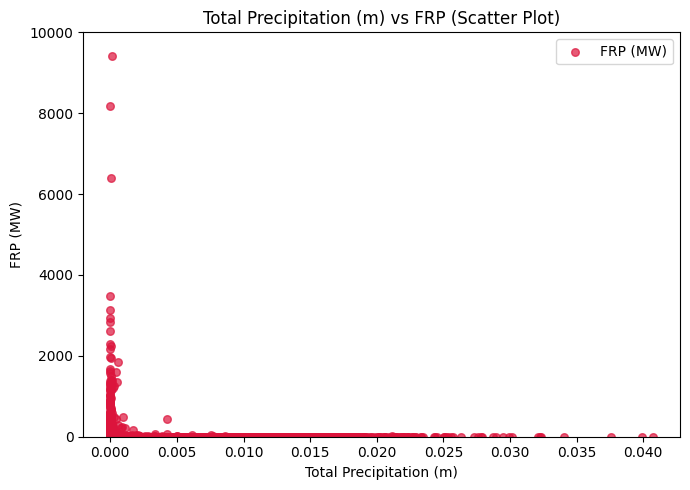


Plotting correlations for: Max Temperature (°C) (mean)


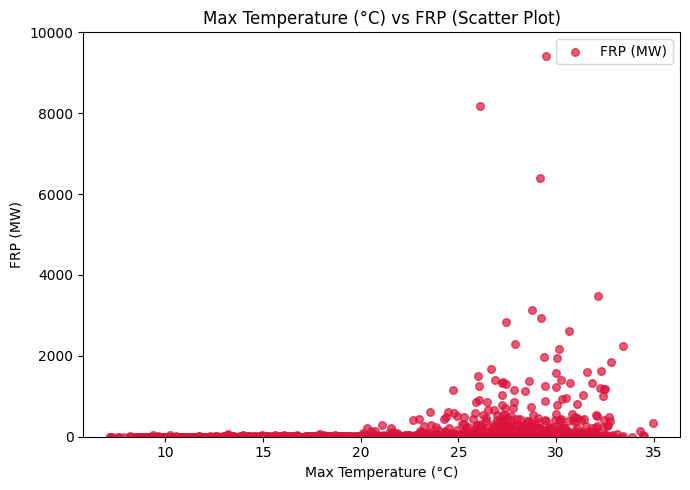


Plotting correlations for: Max Wind Speed (m/s) (mean)


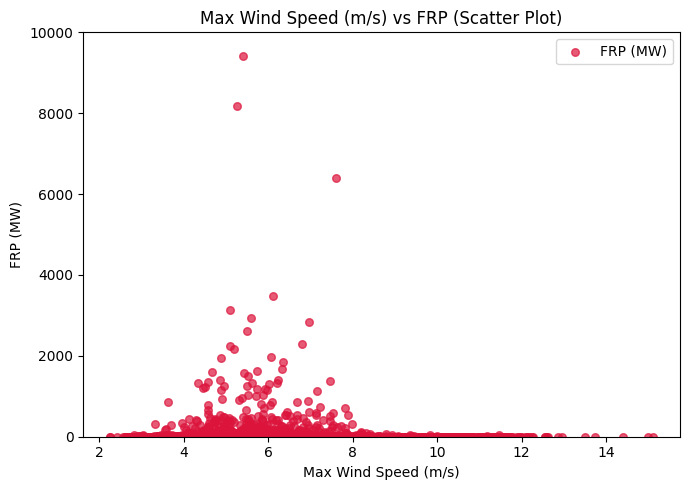

In [54]:
import xarray as xr
import matplotlib.pyplot as plt
import pandas as pd
import numpy as np
from sklearn.linear_model import LinearRegression
from sklearn.metrics import r2_score

# ============================================================
# Choose mode: "FRP" or "POLLUTANTS"
# ============================================================
mode = "FRP"  

# ============================================================
# File paths for each pollutant
# ============================================================
files = {
    'CO':     r"D:\IPMA\Results\co_fire_meteo_Portugal.nc",
    'NO':     r"D:\IPMA\Results\no_fire_meteo_Portugal.nc",
    'NO₂':    r"D:\IPMA\Results\no2_fire_meteo_Portugal.nc",
    'PM₂.₅':  r"D:\IPMA\Results\pm2p5_fire_meteo_Portugal.nc",
    'PM₁₀':   r"D:\IPMA\Results\pm10_fire_meteo_Portugal.nc"
}

# ============================================================
# Units for pollutants
# ============================================================
units = {
    'CO': 'µg/m³',
    'NO': 'µg/m³',
    'NO₂': 'µg/m³',
    'PM₂.₅': 'µg/m³',
    'PM₁₀': 'µg/m³'
}

# ============================================================
# Selected meteorological variables (Label, Statistic)
# ============================================================
meteo_vars = {
    'precip_Total_Precipitation': ('Total Precipitation (m)', 'mean'),
    'temp_Max': ('Max Temperature (°C)', 'mean'),
    'wind_Max': ('Max Wind Speed (m/s)', 'mean')
}

# ============================================================
# Load sample dataset
# ============================================================
sample_file = list(files.values())[0]
ds_sample = xr.open_dataset(sample_file)
time = ds_sample.time
tmin, tmax = pd.to_datetime(time.min().values), pd.to_datetime(time.max().values)

# ============================================================
# Colors
# ============================================================
pollutant_colors = {
    'CO': 'darkgreen',
    'NO': 'tab:red',
    'NO₂': 'tab:purple',
    'PM₂.₅': 'tab:orange',
    'PM₁₀': 'mediumvioletred'
}
frp_color = 'crimson'

# ============================================================
# Main loop
# ============================================================
for var_name, (label, stat) in meteo_vars.items():
    print(f"\nPlotting correlations for: {label} ({stat})")

    # Get meteorological variable (spatial statistic)
    da = ds_sample[var_name]
    if stat == 'mean':
        meteo = da.mean(dim=['latitude', 'longitude'])
    elif stat == 'sum':
        meteo = da.sum(dim=['latitude', 'longitude'])
    elif stat == 'max':
        meteo = da.max(dim=['latitude', 'longitude'])
    elif stat == 'min':
        meteo = da.min(dim=['latitude', 'longitude'])
    elif stat == 'median':
        meteo = da.median(dim=['latitude', 'longitude'])
    else:
        raise ValueError(f"Unsupported stat '{stat}' for variable '{var_name}'")

    meteo_values = meteo.values
    meteo_valid = np.isfinite(meteo_values)

    # ========================================================
    # MODE 1: FRP scatter comparison
    # ========================================================
    if mode == "FRP":
        frp = ds_sample['frp_sum_Portugal'].mean(dim=['latitude', 'longitude']).values
        valid = meteo_valid & np.isfinite(frp)
        x = meteo_values[valid].reshape(-1, 1)
        y = frp[valid]

        # Scatter
        fig, ax = plt.subplots(figsize=(7, 5))
        ax.scatter(x, y, color=frp_color, alpha=0.7, s=30, label='FRP (MW)')

        # Labels and formatting
        ax.set_xlabel(label)
        ax.set_ylabel('FRP (MW)')
        ax.set_ylim(0, 10000) # Adjust accordingly
        ax.legend()
        ax.grid(False)
        ax.set_title(f'{label} vs FRP (Scatter Plot)')
        plt.tight_layout()
        plt.show()

    # ========================================================
    # MODE 2: Pollutant scatter comparison
    # ========================================================
    elif mode == "POLLUTANTS":
        n_pollutants = len(files)
        fig, axs = plt.subplots(n_pollutants, 1, figsize=(7, 3 * n_pollutants), sharex=False)
        fig.suptitle(f'{label} vs Pollutants', fontsize=14)

        for ax, (pollutant_name, file_path) in zip(axs, files.items()):
            ds = xr.open_dataset(file_path)
            pollutant = ds['Mean'].mean(dim=['latitude', 'longitude']).values
            if pollutant_name == 'CO':
                pollutant *= 1000  # mg/m³ → µg/m³

            valid = meteo_valid & np.isfinite(pollutant)
            x = meteo_values[valid].reshape(-1, 1)
            y = pollutant[valid]

            color = pollutant_colors.get(pollutant_name, 'tab:blue')
            ax.scatter(x, y, color=color, alpha=0.6, s=25, label=pollutant_name)
            ax.set_xlabel(f"{label}")
            ax.set_ylabel(f"{pollutant_name} ({units[pollutant_name]})")
            ax.legend()
            ax.grid(False)

            # ✅ Individual Y-axis limits per pollutant
            if pollutant_name == 'CO':
                ax.set_ylim(0, 4000)
            elif pollutant_name == 'NO':
                ax.set_ylim(0, 200)
            elif pollutant_name == 'NO₂':
                ax.set_ylim(0, 100)
            elif pollutant_name == 'PM₂.₅':
                ax.set_ylim(0, 500)
            elif pollutant_name == 'PM₁₀':
                ax.set_ylim(0, 700)

        plt.tight_layout(rect=[0, 0, 1, 0.96])
        plt.show()


#### Certain Year


Plotting correlations for: Total Precipitation (m) (mean)


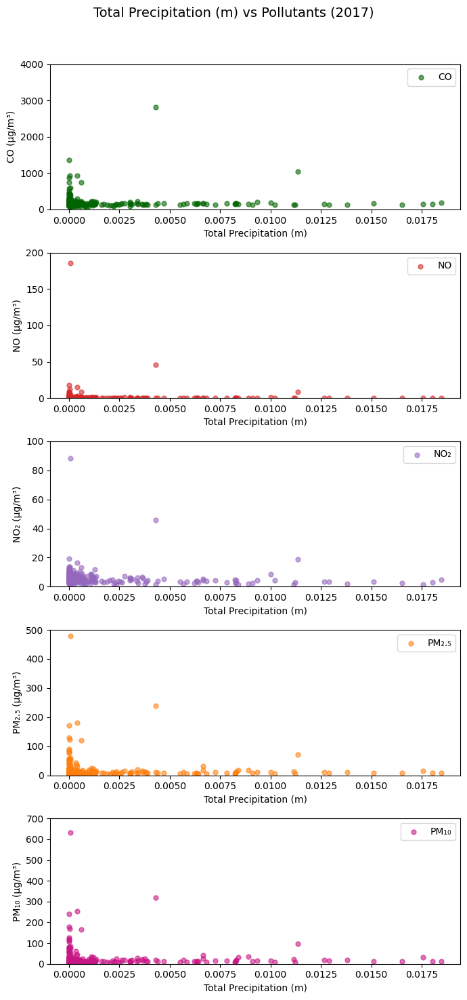


Plotting correlations for: Max Temperature (°C) (mean)


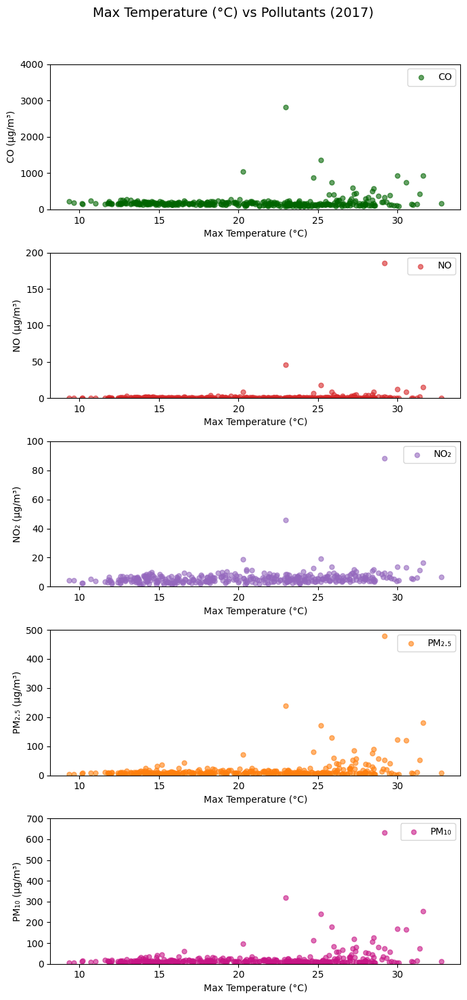


Plotting correlations for: Max Wind Speed (m/s) (mean)


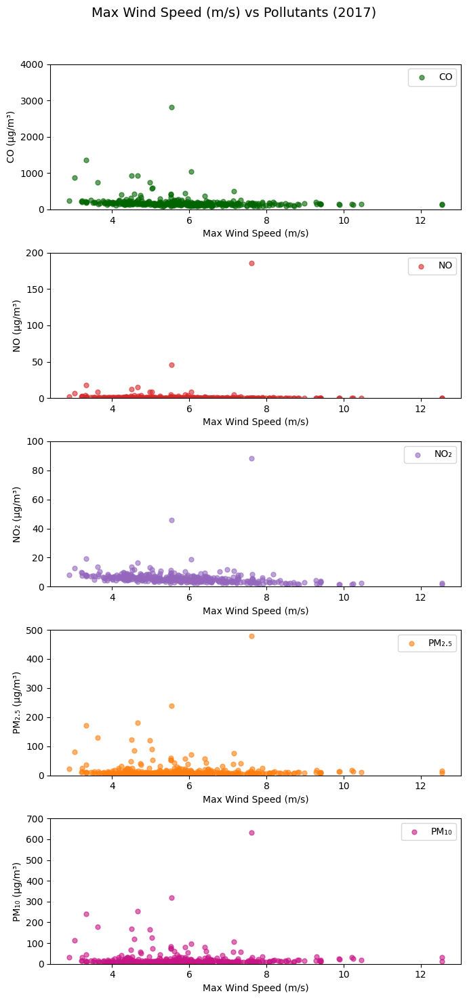

In [55]:
import xarray as xr
import matplotlib.pyplot as plt
import pandas as pd
import numpy as np
from sklearn.linear_model import LinearRegression
from sklearn.metrics import r2_score

# ============================================================
# Choose mode: "FRP" or "POLLUTANTS"
# ============================================================
mode = "POLLUTANTS"  

# ============================================================
# File paths for each pollutant
# ============================================================
files = {
    'CO':     r"D:\IPMA\Results\co_fire_meteo_Portugal.nc",
    'NO':     r"D:\IPMA\Results\no_fire_meteo_Portugal.nc",
    'NO₂':    r"D:\IPMA\Results\no2_fire_meteo_Portugal.nc",
    'PM₂.₅':  r"D:\IPMA\Results\pm2p5_fire_meteo_Portugal.nc",
    'PM₁₀':   r"D:\IPMA\Results\pm10_fire_meteo_Portugal.nc"
}

# ============================================================
# Units for pollutants
# ============================================================
units = {
    'CO': 'µg/m³',
    'NO': 'µg/m³',
    'NO₂': 'µg/m³',
    'PM₂.₅': 'µg/m³',
    'PM₁₀': 'µg/m³'
}

# ============================================================
# Selected meteorological variables (Label, Statistic)
# ============================================================
meteo_vars = {
    'precip_Total_Precipitation': ('Total Precipitation (m)', 'mean'),
    'temp_Max': ('Max Temperature (°C)', 'mean'),
    'wind_Max': ('Max Wind Speed (m/s)', 'mean')
}

# ============================================================
# Load sample dataset
# ============================================================
sample_file = list(files.values())[0]
ds_sample = xr.open_dataset(sample_file)

# ============================================================
# ✅ Select a specific year to plot
# ============================================================
selected_year = 2017  # <-- Change this to the year you want
time = pd.to_datetime(ds_sample.time.values)
year_mask = time.year == selected_year
ds_sample = ds_sample.sel(time=ds_sample.time[year_mask])

tmin, tmax = pd.to_datetime(time.min()), pd.to_datetime(time.max())

# ============================================================
# Colors
# ============================================================
pollutant_colors = {
    'CO': 'darkgreen',
    'NO': 'tab:red',
    'NO₂': 'tab:purple',
    'PM₂.₅': 'tab:orange',
    'PM₁₀': 'mediumvioletred'
}
frp_color = 'crimson'

# ============================================================
# Main loop
# ============================================================
for var_name, (label, stat) in meteo_vars.items():
    print(f"\nPlotting correlations for: {label} ({stat})")

    # Get meteorological variable (spatial statistic)
    da = ds_sample[var_name]
    if stat == 'mean':
        meteo = da.mean(dim=['latitude', 'longitude'])
    elif stat == 'sum':
        meteo = da.sum(dim=['latitude', 'longitude'])
    elif stat == 'max':
        meteo = da.max(dim=['latitude', 'longitude'])
    elif stat == 'min':
        meteo = da.min(dim=['latitude', 'longitude'])
    elif stat == 'median':
        meteo = da.median(dim=['latitude', 'longitude'])
    else:
        raise ValueError(f"Unsupported stat '{stat}' for variable '{var_name}'")

    meteo_values = meteo.values
    meteo_valid = np.isfinite(meteo_values)

    # ========================================================
    # MODE 1: FRP scatter comparison
    # ========================================================
    if mode == "FRP":
        frp = ds_sample['frp_sum_Portugal'].mean(dim=['latitude', 'longitude']).values
        valid = meteo_valid & np.isfinite(frp)
        x = meteo_values[valid].reshape(-1, 1)
        y = frp[valid]

        # Scatter
        fig, ax = plt.subplots(figsize=(7, 5))
        ax.scatter(x, y, color=frp_color, alpha=0.7, s=30, label='FRP (MW)')

        # Labels and formatting
        ax.set_xlabel(label)
        ax.set_ylabel('FRP (MW)')
        ax.set_ylim(0, 10000)  # Adjust as needed
        ax.legend()
        ax.grid(False)
        ax.set_title(f'{label} vs FRP (Scatter Plot) - {selected_year}')
        plt.tight_layout()
        plt.show()

    # ========================================================
    # MODE 2: Pollutant scatter comparison
    # ========================================================
    elif mode == "POLLUTANTS":
        n_pollutants = len(files)
        fig, axs = plt.subplots(n_pollutants, 1, figsize=(7, 3 * n_pollutants), sharex=False)
        fig.suptitle(f'{label} vs Pollutants ({selected_year})', fontsize=14)

        for ax, (pollutant_name, file_path) in zip(axs, files.items()):
            ds = xr.open_dataset(file_path)

            # ✅ Apply same year filter to pollutant dataset
            time_pollutant = pd.to_datetime(ds.time.values)
            year_mask_pollutant = time_pollutant.year == selected_year
            ds = ds.sel(time=ds.time[year_mask_pollutant])

            pollutant = ds['Mean'].mean(dim=['latitude', 'longitude']).values
            if pollutant_name == 'CO':
                pollutant *= 1000  # mg/m³ → µg/m³

            valid = meteo_valid & np.isfinite(pollutant)
            x = meteo_values[valid].reshape(-1, 1)
            y = pollutant[valid]

            color = pollutant_colors.get(pollutant_name, 'tab:blue')
            ax.scatter(x, y, color=color, alpha=0.6, s=25, label=pollutant_name)
            ax.set_xlabel(f"{label}")
            ax.set_ylabel(f"{pollutant_name} ({units[pollutant_name]})")
            ax.legend()
            ax.grid(False)

            # ✅ Individual Y-axis limits per pollutant
            if pollutant_name == 'CO':
                ax.set_ylim(0, 4000)
            elif pollutant_name == 'NO':
                ax.set_ylim(0, 200)
            elif pollutant_name == 'NO₂':
                ax.set_ylim(0, 100)
            elif pollutant_name == 'PM₂.₅':
                ax.set_ylim(0, 500)
            elif pollutant_name == 'PM₁₀':
                ax.set_ylim(0, 700)

        plt.tight_layout(rect=[0, 0, 1, 0.96])
        plt.show()


### Spain

#### All Years


Plotting correlations for: Total Precipitation (m) (mean)


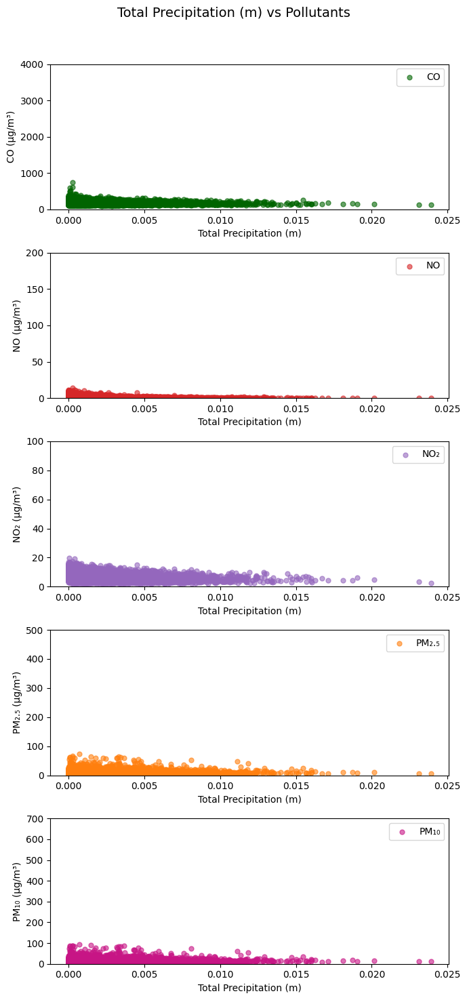


Plotting correlations for: Max Temperature (°C) (mean)


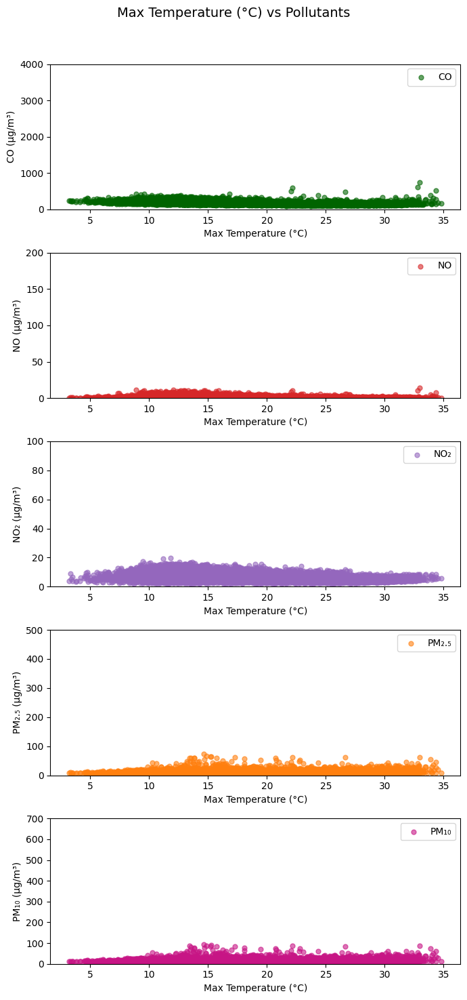


Plotting correlations for: Max Wind Speed (m/s) (mean)


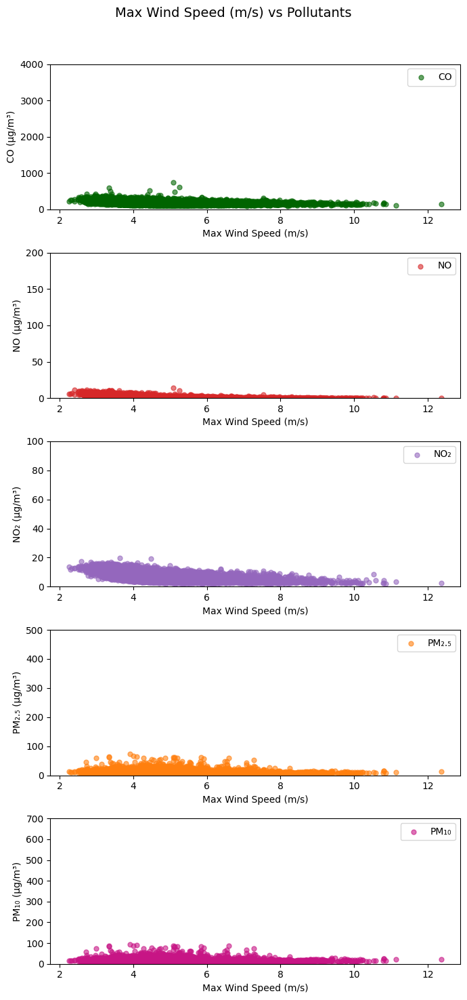

In [56]:
import xarray as xr
import matplotlib.pyplot as plt
import pandas as pd
import numpy as np
from sklearn.linear_model import LinearRegression
from sklearn.metrics import r2_score

# ============================================================
# Choose mode: "FRP" or "POLLUTANTS"
# ============================================================
mode = "POLLUTANTS"  

# ============================================================
# File paths for each pollutant
# ============================================================
files = {
    'CO':     r"D:\IPMA\Results\co_fire_meteo_Spain.nc",
    'NO':     r"D:\IPMA\Results\no_fire_meteo_Spain.nc",
    'NO₂':    r"D:\IPMA\Results\no2_fire_meteo_Spain.nc",
    'PM₂.₅':  r"D:\IPMA\Results\pm2p5_fire_meteo_Spain.nc",
    'PM₁₀':   r"D:\IPMA\Results\pm10_fire_meteo_Spain.nc"
}

# ============================================================
# Units for pollutants
# ============================================================
units = {
    'CO': 'µg/m³',
    'NO': 'µg/m³',
    'NO₂': 'µg/m³',
    'PM₂.₅': 'µg/m³',
    'PM₁₀': 'µg/m³'
}

# ============================================================
# Selected meteorological variables (Label, Statistic)
# ============================================================
meteo_vars = {
    'precip_Total_Precipitation': ('Total Precipitation (m)', 'mean'),
    'temp_Max': ('Max Temperature (°C)', 'mean'),
    'wind_Max': ('Max Wind Speed (m/s)', 'mean')
}

# ============================================================
# Load sample dataset
# ============================================================
sample_file = list(files.values())[0]
ds_sample = xr.open_dataset(sample_file)
time = ds_sample.time
tmin, tmax = pd.to_datetime(time.min().values), pd.to_datetime(time.max().values)

# ============================================================
# Colors
# ============================================================
pollutant_colors = {
    'CO': 'darkgreen',
    'NO': 'tab:red',
    'NO₂': 'tab:purple',
    'PM₂.₅': 'tab:orange',
    'PM₁₀': 'mediumvioletred'
}
frp_color = 'crimson'

# ============================================================
# Main loop
# ============================================================
for var_name, (label, stat) in meteo_vars.items():
    print(f"\nPlotting correlations for: {label} ({stat})")

    # Get meteorological variable (spatial statistic)
    da = ds_sample[var_name]
    if stat == 'mean':
        meteo = da.mean(dim=['latitude', 'longitude'])
    elif stat == 'sum':
        meteo = da.sum(dim=['latitude', 'longitude'])
    elif stat == 'max':
        meteo = da.max(dim=['latitude', 'longitude'])
    elif stat == 'min':
        meteo = da.min(dim=['latitude', 'longitude'])
    elif stat == 'median':
        meteo = da.median(dim=['latitude', 'longitude'])
    else:
        raise ValueError(f"Unsupported stat '{stat}' for variable '{var_name}'")

    meteo_values = meteo.values
    meteo_valid = np.isfinite(meteo_values)

    # ========================================================
    # MODE 1: FRP scatter comparison
    # ========================================================
    if mode == "FRP":
        frp = ds_sample['frp_sum_Spain'].mean(dim=['latitude', 'longitude']).values
        valid = meteo_valid & np.isfinite(frp)
        x = meteo_values[valid].reshape(-1, 1)
        y = frp[valid]

        # Scatter
        fig, ax = plt.subplots(figsize=(7, 5))
        ax.scatter(x, y, color=frp_color, alpha=0.7, s=30, label='FRP (MW)')

        # Labels and formatting
        ax.set_xlabel(label)
        ax.set_ylabel('FRP (MW)')
        ax.set_ylim(0, 10000) # Adjust accordingly
        ax.legend()
        ax.grid(False)
        ax.set_title(f'{label} vs FRP (Scatter Plot)')
        plt.tight_layout()
        plt.show()

    # ========================================================
    # MODE 2: Pollutant scatter comparison
    # ========================================================
    elif mode == "POLLUTANTS":
        n_pollutants = len(files)
        fig, axs = plt.subplots(n_pollutants, 1, figsize=(7, 3 * n_pollutants), sharex=False)
        fig.suptitle(f'{label} vs Pollutants', fontsize=14)

        for ax, (pollutant_name, file_path) in zip(axs, files.items()):
            ds = xr.open_dataset(file_path)
            pollutant = ds['Mean'].mean(dim=['latitude', 'longitude']).values
            if pollutant_name == 'CO':
                pollutant *= 1000  # mg/m³ → µg/m³

            valid = meteo_valid & np.isfinite(pollutant)
            x = meteo_values[valid].reshape(-1, 1)
            y = pollutant[valid]

            color = pollutant_colors.get(pollutant_name, 'tab:blue')
            ax.scatter(x, y, color=color, alpha=0.6, s=25, label=pollutant_name)
            ax.set_xlabel(f"{label}")
            ax.set_ylabel(f"{pollutant_name} ({units[pollutant_name]})")
            ax.legend()
            ax.grid(False)

            # ✅ Individual Y-axis limits per pollutant
            if pollutant_name == 'CO':
                ax.set_ylim(0, 4000)
            elif pollutant_name == 'NO':
                ax.set_ylim(0, 200)
            elif pollutant_name == 'NO₂':
                ax.set_ylim(0, 100)
            elif pollutant_name == 'PM₂.₅':
                ax.set_ylim(0, 500)
            elif pollutant_name == 'PM₁₀':
                ax.set_ylim(0, 700)

        plt.tight_layout(rect=[0, 0, 1, 0.96])
        plt.show()


#### Certain Years


Plotting correlations for: Total Precipitation (m) (mean)


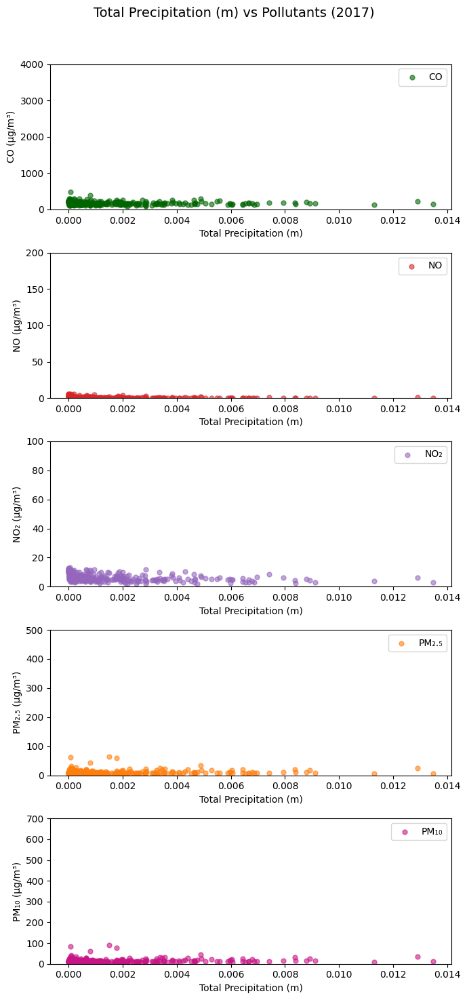


Plotting correlations for: Max Temperature (°C) (mean)


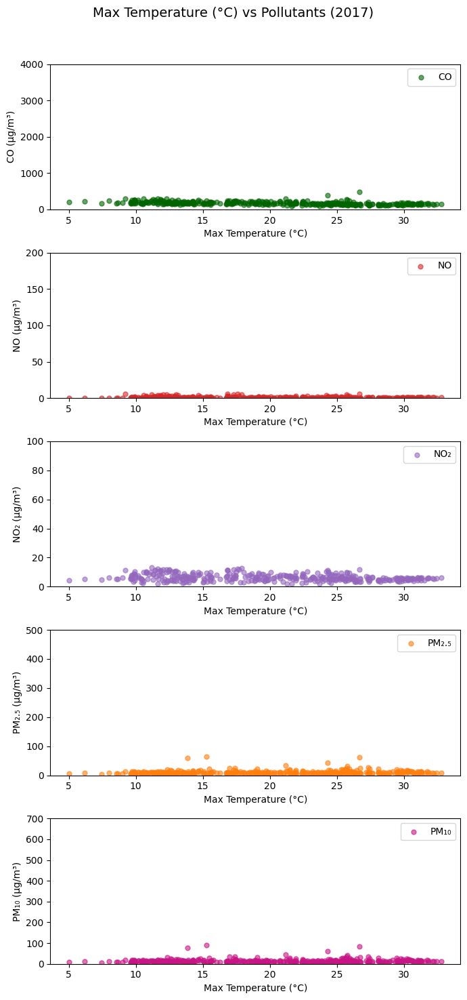


Plotting correlations for: Max Wind Speed (m/s) (mean)


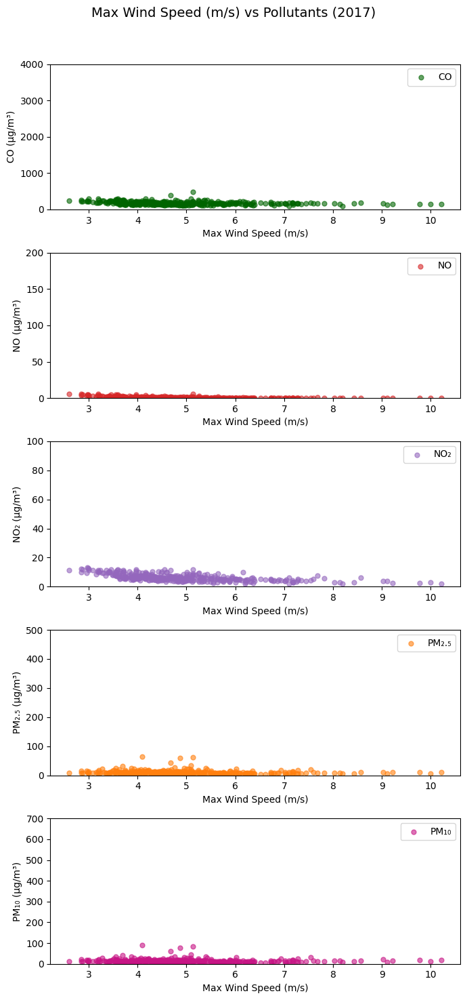

In [57]:
import xarray as xr
import matplotlib.pyplot as plt
import pandas as pd
import numpy as np
from sklearn.linear_model import LinearRegression
from sklearn.metrics import r2_score

# ============================================================
# Choose mode: "FRP" or "POLLUTANTS"
# ============================================================
mode = "POLLUTANTS"  

# ============================================================
# File paths for each pollutant
# ============================================================
files = {
    'CO':     r"D:\IPMA\Results\co_fire_meteo_Spain.nc",
    'NO':     r"D:\IPMA\Results\no_fire_meteo_Spain.nc",
    'NO₂':    r"D:\IPMA\Results\no2_fire_meteo_Spain.nc",
    'PM₂.₅':  r"D:\IPMA\Results\pm2p5_fire_meteo_Spain.nc",
    'PM₁₀':   r"D:\IPMA\Results\pm10_fire_meteo_Spain.nc"
}

# ============================================================
# Units for pollutants
# ============================================================
units = {
    'CO': 'µg/m³',
    'NO': 'µg/m³',
    'NO₂': 'µg/m³',
    'PM₂.₅': 'µg/m³',
    'PM₁₀': 'µg/m³'
}

# ============================================================
# Selected meteorological variables (Label, Statistic)
# ============================================================
meteo_vars = {
    'precip_Total_Precipitation': ('Total Precipitation (m)', 'mean'),
    'temp_Max': ('Max Temperature (°C)', 'mean'),
    'wind_Max': ('Max Wind Speed (m/s)', 'mean')
}

# ============================================================
# Load sample dataset
# ============================================================
sample_file = list(files.values())[0]
ds_sample = xr.open_dataset(sample_file)

# ============================================================
# ✅ Select a specific year to plot
# ============================================================
selected_year = 2017  # <-- Change this to the year you want
time = pd.to_datetime(ds_sample.time.values)
year_mask = time.year == selected_year
ds_sample = ds_sample.sel(time=ds_sample.time[year_mask])

tmin, tmax = pd.to_datetime(time.min()), pd.to_datetime(time.max())

# ============================================================
# Colors
# ============================================================
pollutant_colors = {
    'CO': 'darkgreen',
    'NO': 'tab:red',
    'NO₂': 'tab:purple',
    'PM₂.₅': 'tab:orange',
    'PM₁₀': 'mediumvioletred'
}
frp_color = 'crimson'

# ============================================================
# Main loop
# ============================================================
for var_name, (label, stat) in meteo_vars.items():
    print(f"\nPlotting correlations for: {label} ({stat})")

    # Get meteorological variable (spatial statistic)
    da = ds_sample[var_name]
    if stat == 'mean':
        meteo = da.mean(dim=['latitude', 'longitude'])
    elif stat == 'sum':
        meteo = da.sum(dim=['latitude', 'longitude'])
    elif stat == 'max':
        meteo = da.max(dim=['latitude', 'longitude'])
    elif stat == 'min':
        meteo = da.min(dim=['latitude', 'longitude'])
    elif stat == 'median':
        meteo = da.median(dim=['latitude', 'longitude'])
    else:
        raise ValueError(f"Unsupported stat '{stat}' for variable '{var_name}'")

    meteo_values = meteo.values
    meteo_valid = np.isfinite(meteo_values)

    # ========================================================
    # MODE 1: FRP scatter comparison
    # ========================================================
    if mode == "FRP":
        frp = ds_sample['frp_sum_Spain'].mean(dim=['latitude', 'longitude']).values
        valid = meteo_valid & np.isfinite(frp)
        x = meteo_values[valid].reshape(-1, 1)
        y = frp[valid]

        # Scatter
        fig, ax = plt.subplots(figsize=(7, 5))
        ax.scatter(x, y, color=frp_color, alpha=0.7, s=30, label='FRP (MW)')

        # Labels and formatting
        ax.set_xlabel(label)
        ax.set_ylabel('FRP (MW)')
        ax.set_ylim(0, 10000)  # Adjust as needed
        ax.legend()
        ax.grid(False)
        ax.set_title(f'{label} vs FRP (Scatter Plot) - {selected_year}')
        plt.tight_layout()
        plt.show()

    # ========================================================
    # MODE 2: Pollutant scatter comparison
    # ========================================================
    elif mode == "POLLUTANTS":
        n_pollutants = len(files)
        fig, axs = plt.subplots(n_pollutants, 1, figsize=(7, 3 * n_pollutants), sharex=False)
        fig.suptitle(f'{label} vs Pollutants ({selected_year})', fontsize=14)

        for ax, (pollutant_name, file_path) in zip(axs, files.items()):
            ds = xr.open_dataset(file_path)

            # ✅ Apply same year filter to pollutant dataset
            time_pollutant = pd.to_datetime(ds.time.values)
            year_mask_pollutant = time_pollutant.year == selected_year
            ds = ds.sel(time=ds.time[year_mask_pollutant])

            pollutant = ds['Mean'].mean(dim=['latitude', 'longitude']).values
            if pollutant_name == 'CO':
                pollutant *= 1000  # mg/m³ → µg/m³

            valid = meteo_valid & np.isfinite(pollutant)
            x = meteo_values[valid].reshape(-1, 1)
            y = pollutant[valid]

            color = pollutant_colors.get(pollutant_name, 'tab:blue')
            ax.scatter(x, y, color=color, alpha=0.6, s=25, label=pollutant_name)
            ax.set_xlabel(f"{label}")
            ax.set_ylabel(f"{pollutant_name} ({units[pollutant_name]})")
            ax.legend()
            ax.grid(False)

            # ✅ Individual Y-axis limits per pollutant
            if pollutant_name == 'CO':
                ax.set_ylim(0, 4000)
            elif pollutant_name == 'NO':
                ax.set_ylim(0, 200)
            elif pollutant_name == 'NO₂':
                ax.set_ylim(0, 100)
            elif pollutant_name == 'PM₂.₅':
                ax.set_ylim(0, 500)
            elif pollutant_name == 'PM₁₀':
                ax.set_ylim(0, 700)

        plt.tight_layout(rect=[0, 0, 1, 0.96])
        plt.show()


### Iberia

#### All Years


Plotting correlations for: Total Precipitation (m) (mean)


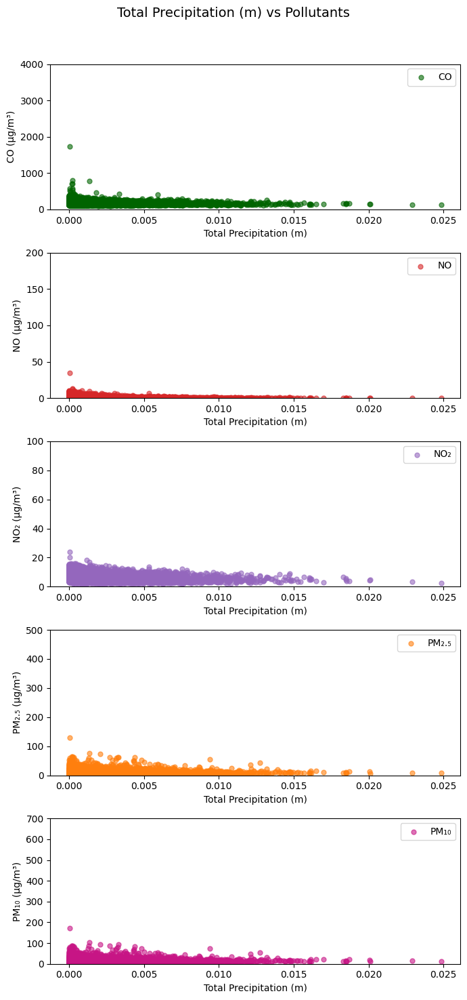


Plotting correlations for: Max Temperature (°C) (mean)


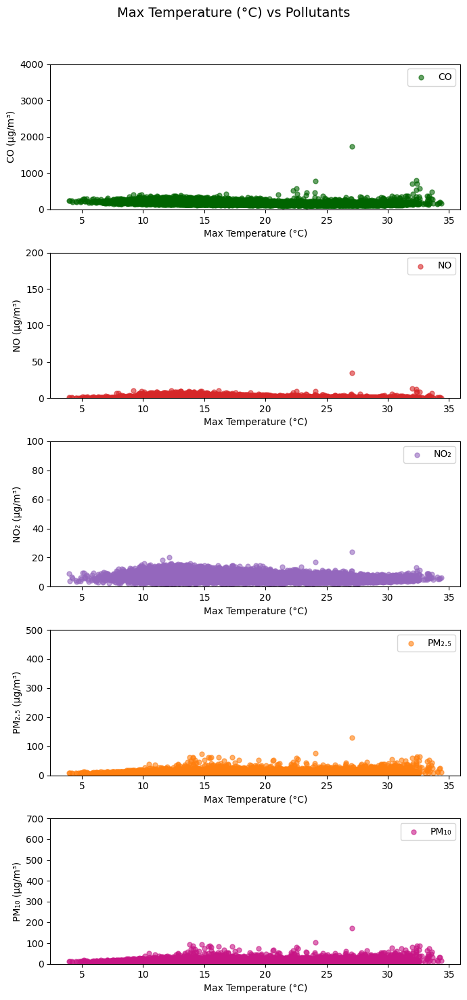


Plotting correlations for: Max Wind Speed (m/s) (mean)


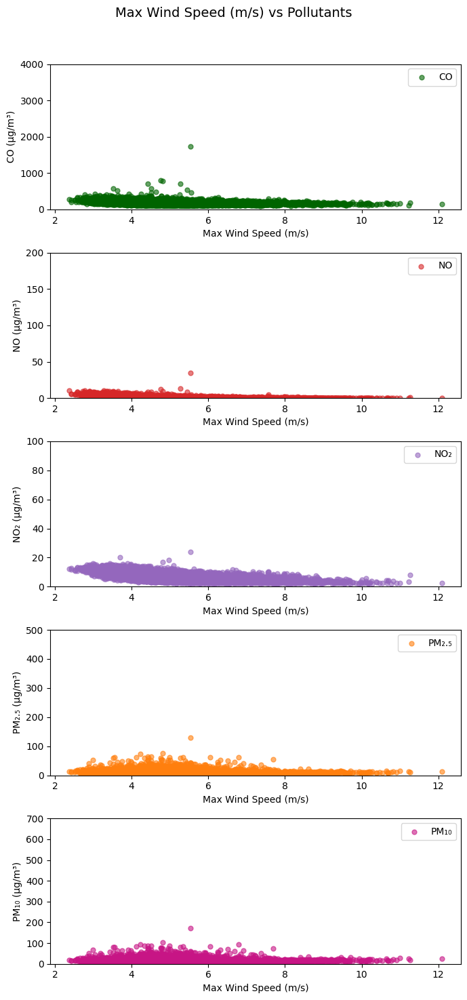

In [58]:
import xarray as xr
import matplotlib.pyplot as plt
import pandas as pd
import numpy as np
from sklearn.linear_model import LinearRegression
from sklearn.metrics import r2_score

# ============================================================
# Choose mode: "FRP" or "POLLUTANTS"
# ============================================================
mode = "POLLUTANTS"  

# ============================================================
# File paths for each pollutant
# ============================================================
files = {
    'CO':     r"D:\IPMA\Results\co_fire_meteo_Iberia.nc",
    'NO':     r"D:\IPMA\Results\no_fire_meteo_Iberia.nc",
    'NO₂':    r"D:\IPMA\Results\no2_fire_meteo_Iberia.nc",
    'PM₂.₅':  r"D:\IPMA\Results\pm2p5_fire_meteo_Iberia.nc",
    'PM₁₀':   r"D:\IPMA\Results\pm10_fire_meteo_Iberia.nc"
}

# ============================================================
# Units for pollutants
# ============================================================
units = {
    'CO': 'µg/m³',
    'NO': 'µg/m³',
    'NO₂': 'µg/m³',
    'PM₂.₅': 'µg/m³',
    'PM₁₀': 'µg/m³'
}

# ============================================================
# Selected meteorological variables (Label, Statistic)
# ============================================================
meteo_vars = {
    'precip_Total_Precipitation': ('Total Precipitation (m)', 'mean'),
    'temp_Max': ('Max Temperature (°C)', 'mean'),
    'wind_Max': ('Max Wind Speed (m/s)', 'mean')
}

# ============================================================
# Load sample dataset
# ============================================================
sample_file = list(files.values())[0]
ds_sample = xr.open_dataset(sample_file)
time = ds_sample.time
tmin, tmax = pd.to_datetime(time.min().values), pd.to_datetime(time.max().values)

# ============================================================
# Colors
# ============================================================
pollutant_colors = {
    'CO': 'darkgreen',
    'NO': 'tab:red',
    'NO₂': 'tab:purple',
    'PM₂.₅': 'tab:orange',
    'PM₁₀': 'mediumvioletred'
}
frp_color = 'crimson'

# ============================================================
# Main loop
# ============================================================
for var_name, (label, stat) in meteo_vars.items():
    print(f"\nPlotting correlations for: {label} ({stat})")

    # Get meteorological variable (spatial statistic)
    da = ds_sample[var_name]
    if stat == 'mean':
        meteo = da.mean(dim=['latitude', 'longitude'])
    elif stat == 'sum':
        meteo = da.sum(dim=['latitude', 'longitude'])
    elif stat == 'max':
        meteo = da.max(dim=['latitude', 'longitude'])
    elif stat == 'min':
        meteo = da.min(dim=['latitude', 'longitude'])
    elif stat == 'median':
        meteo = da.median(dim=['latitude', 'longitude'])
    else:
        raise ValueError(f"Unsupported stat '{stat}' for variable '{var_name}'")

    meteo_values = meteo.values
    meteo_valid = np.isfinite(meteo_values)

    # ========================================================
    # MODE 1: FRP scatter comparison
    # ========================================================
    if mode == "FRP":
        frp = ds_sample['frp_sum_Iberia'].mean(dim=['latitude', 'longitude']).values
        valid = meteo_valid & np.isfinite(frp)
        x = meteo_values[valid].reshape(-1, 1)
        y = frp[valid]

        # Scatter
        fig, ax = plt.subplots(figsize=(7, 5))
        ax.scatter(x, y, color=frp_color, alpha=0.7, s=30, label='FRP (MW)')

        # Labels and formatting
        ax.set_xlabel(label)
        ax.set_ylabel('FRP (MW)')
        ax.set_ylim(0, 10000) # Adjust accordingly
        ax.legend()
        ax.grid(False)
        ax.set_title(f'{label} vs FRP (Scatter Plot)')
        plt.tight_layout()
        plt.show()

    # ========================================================
    # MODE 2: Pollutant scatter comparison
    # ========================================================
    elif mode == "POLLUTANTS":
        n_pollutants = len(files)
        fig, axs = plt.subplots(n_pollutants, 1, figsize=(7, 3 * n_pollutants), sharex=False)
        fig.suptitle(f'{label} vs Pollutants', fontsize=14)

        for ax, (pollutant_name, file_path) in zip(axs, files.items()):
            ds = xr.open_dataset(file_path)
            pollutant = ds['Mean'].mean(dim=['latitude', 'longitude']).values
            if pollutant_name == 'CO':
                pollutant *= 1000  # mg/m³ → µg/m³

            valid = meteo_valid & np.isfinite(pollutant)
            x = meteo_values[valid].reshape(-1, 1)
            y = pollutant[valid]

            color = pollutant_colors.get(pollutant_name, 'tab:blue')
            ax.scatter(x, y, color=color, alpha=0.6, s=25, label=pollutant_name)
            ax.set_xlabel(f"{label}")
            ax.set_ylabel(f"{pollutant_name} ({units[pollutant_name]})")
            ax.legend()
            ax.grid(False)

            # ✅ Individual Y-axis limits per pollutant
            if pollutant_name == 'CO':
                ax.set_ylim(0, 4000)
            elif pollutant_name == 'NO':
                ax.set_ylim(0, 200)
            elif pollutant_name == 'NO₂':
                ax.set_ylim(0, 100)
            elif pollutant_name == 'PM₂.₅':
                ax.set_ylim(0, 500)
            elif pollutant_name == 'PM₁₀':
                ax.set_ylim(0, 700)

        plt.tight_layout(rect=[0, 0, 1, 0.96])
        plt.show()


#### Certain Years


Plotting correlations for: Total Precipitation (m) (mean)


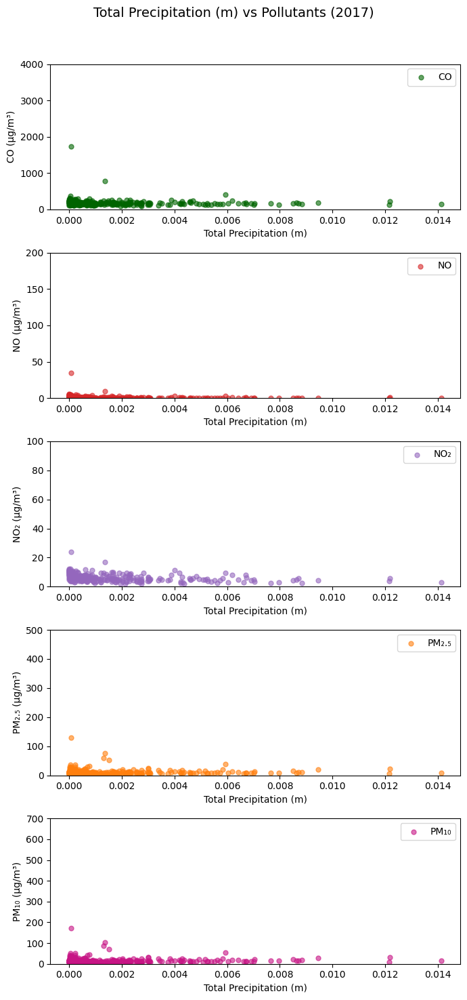


Plotting correlations for: Max Temperature (°C) (mean)


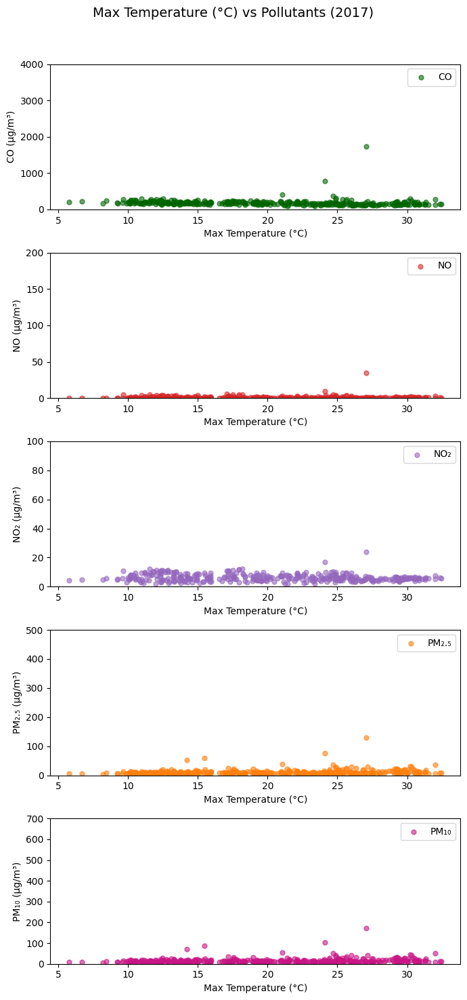


Plotting correlations for: Max Wind Speed (m/s) (mean)


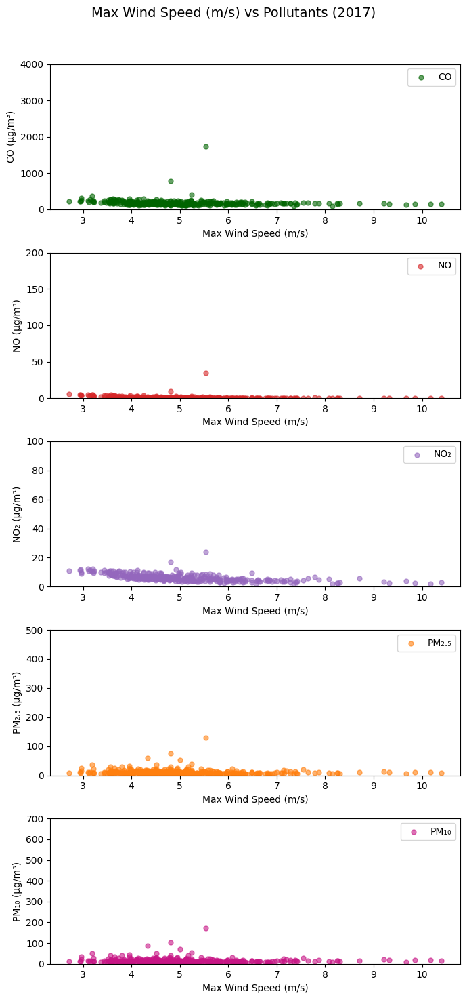

In [59]:
import xarray as xr
import matplotlib.pyplot as plt
import pandas as pd
import numpy as np
from sklearn.linear_model import LinearRegression
from sklearn.metrics import r2_score

# ============================================================
# Choose mode: "FRP" or "POLLUTANTS"
# ============================================================
mode = "POLLUTANTS"  

# ============================================================
# File paths for each pollutant
# ============================================================
files = {
    'CO':     r"D:\IPMA\Results\co_fire_meteo_Iberia.nc",
    'NO':     r"D:\IPMA\Results\no_fire_meteo_Iberia.nc",
    'NO₂':    r"D:\IPMA\Results\no2_fire_meteo_Iberia.nc",
    'PM₂.₅':  r"D:\IPMA\Results\pm2p5_fire_meteo_Iberia.nc",
    'PM₁₀':   r"D:\IPMA\Results\pm10_fire_meteo_Iberia.nc"
}

# ============================================================
# Units for pollutants
# ============================================================
units = {
    'CO': 'µg/m³',
    'NO': 'µg/m³',
    'NO₂': 'µg/m³',
    'PM₂.₅': 'µg/m³',
    'PM₁₀': 'µg/m³'
}

# ============================================================
# Selected meteorological variables (Label, Statistic)
# ============================================================
meteo_vars = {
    'precip_Total_Precipitation': ('Total Precipitation (m)', 'mean'),
    'temp_Max': ('Max Temperature (°C)', 'mean'),
    'wind_Max': ('Max Wind Speed (m/s)', 'mean')
}

# ============================================================
# Load sample dataset
# ============================================================
sample_file = list(files.values())[0]
ds_sample = xr.open_dataset(sample_file)

# ============================================================
# ✅ Select a specific year to plot
# ============================================================
selected_year = 2017  # <-- Change this to the year you want
time = pd.to_datetime(ds_sample.time.values)
year_mask = time.year == selected_year
ds_sample = ds_sample.sel(time=ds_sample.time[year_mask])

tmin, tmax = pd.to_datetime(time.min()), pd.to_datetime(time.max())

# ============================================================
# Colors
# ============================================================
pollutant_colors = {
    'CO': 'darkgreen',
    'NO': 'tab:red',
    'NO₂': 'tab:purple',
    'PM₂.₅': 'tab:orange',
    'PM₁₀': 'mediumvioletred'
}
frp_color = 'crimson'

# ============================================================
# Main loop
# ============================================================
for var_name, (label, stat) in meteo_vars.items():
    print(f"\nPlotting correlations for: {label} ({stat})")

    # Get meteorological variable (spatial statistic)
    da = ds_sample[var_name]
    if stat == 'mean':
        meteo = da.mean(dim=['latitude', 'longitude'])
    elif stat == 'sum':
        meteo = da.sum(dim=['latitude', 'longitude'])
    elif stat == 'max':
        meteo = da.max(dim=['latitude', 'longitude'])
    elif stat == 'min':
        meteo = da.min(dim=['latitude', 'longitude'])
    elif stat == 'median':
        meteo = da.median(dim=['latitude', 'longitude'])
    else:
        raise ValueError(f"Unsupported stat '{stat}' for variable '{var_name}'")

    meteo_values = meteo.values
    meteo_valid = np.isfinite(meteo_values)

    # ========================================================
    # MODE 1: FRP scatter comparison
    # ========================================================
    if mode == "FRP":
        frp = ds_sample['frp_sum_Iberia'].mean(dim=['latitude', 'longitude']).values
        valid = meteo_valid & np.isfinite(frp)
        x = meteo_values[valid].reshape(-1, 1)
        y = frp[valid]

        # Scatter
        fig, ax = plt.subplots(figsize=(7, 5))
        ax.scatter(x, y, color=frp_color, alpha=0.7, s=30, label='FRP (MW)')

        # Labels and formatting
        ax.set_xlabel(label)
        ax.set_ylabel('FRP (MW)')
        ax.set_ylim(0, 10000)  # Adjust as needed
        ax.legend()
        ax.grid(False)
        ax.set_title(f'{label} vs FRP (Scatter Plot) - {selected_year}')
        plt.tight_layout()
        plt.show()

    # ========================================================
    # MODE 2: Pollutant scatter comparison
    # ========================================================
    elif mode == "POLLUTANTS":
        n_pollutants = len(files)
        fig, axs = plt.subplots(n_pollutants, 1, figsize=(7, 3 * n_pollutants), sharex=False)
        fig.suptitle(f'{label} vs Pollutants ({selected_year})', fontsize=14)

        for ax, (pollutant_name, file_path) in zip(axs, files.items()):
            ds = xr.open_dataset(file_path)

            # ✅ Apply same year filter to pollutant dataset
            time_pollutant = pd.to_datetime(ds.time.values)
            year_mask_pollutant = time_pollutant.year == selected_year
            ds = ds.sel(time=ds.time[year_mask_pollutant])

            pollutant = ds['Mean'].mean(dim=['latitude', 'longitude']).values
            if pollutant_name == 'CO':
                pollutant *= 1000  # mg/m³ → µg/m³

            valid = meteo_valid & np.isfinite(pollutant)
            x = meteo_values[valid].reshape(-1, 1)
            y = pollutant[valid]

            color = pollutant_colors.get(pollutant_name, 'tab:blue')
            ax.scatter(x, y, color=color, alpha=0.6, s=25, label=pollutant_name)
            ax.set_xlabel(f"{label}")
            ax.set_ylabel(f"{pollutant_name} ({units[pollutant_name]})")
            ax.legend()
            ax.grid(False)

            # ✅ Individual Y-axis limits per pollutant
            if pollutant_name == 'CO':
                ax.set_ylim(0, 4000)
            elif pollutant_name == 'NO':
                ax.set_ylim(0, 200)
            elif pollutant_name == 'NO₂':
                ax.set_ylim(0, 100)
            elif pollutant_name == 'PM₂.₅':
                ax.set_ylim(0, 500)
            elif pollutant_name == 'PM₁₀':
                ax.set_ylim(0, 700)

        plt.tight_layout(rect=[0, 0, 1, 0.96])
        plt.show()


### Italy

#### All Years


Plotting correlations for: Total Precipitation (m) (mean)


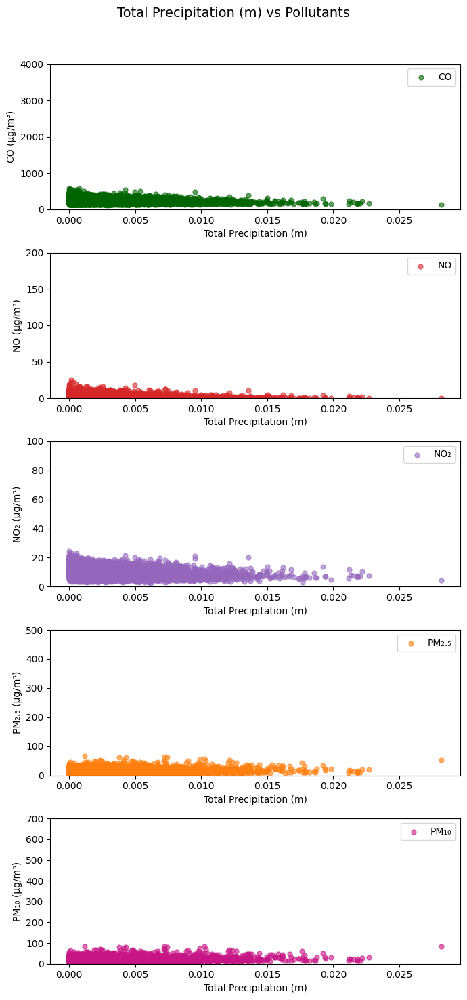


Plotting correlations for: Max Temperature (°C) (mean)


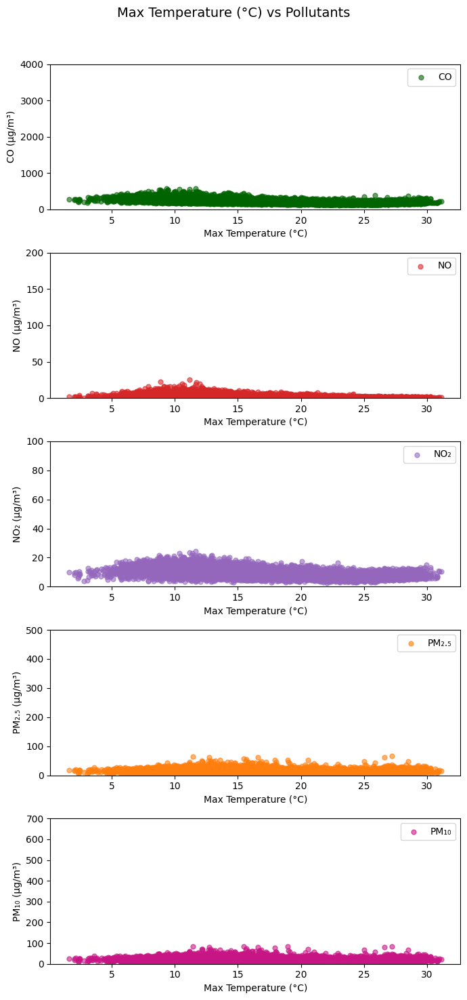


Plotting correlations for: Max Wind Speed (m/s) (mean)


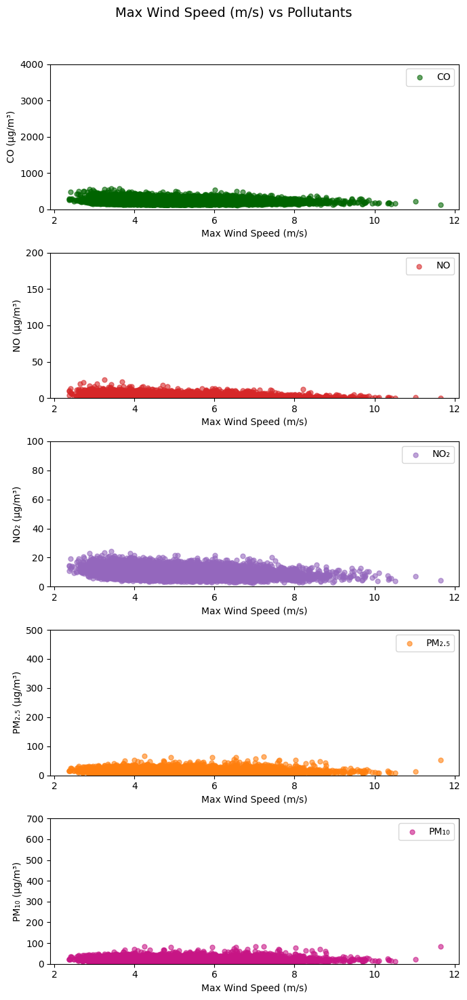

In [60]:
import xarray as xr
import matplotlib.pyplot as plt
import pandas as pd
import numpy as np
from sklearn.linear_model import LinearRegression
from sklearn.metrics import r2_score

# ============================================================
# Choose mode: "FRP" or "POLLUTANTS"
# ============================================================
mode = "POLLUTANTS"  

# ============================================================
# File paths for each pollutant
# ============================================================
files = {
    'CO':     r"D:\IPMA\Results\co_fire_meteo_Italy.nc",
    'NO':     r"D:\IPMA\Results\no_fire_meteo_Italy.nc",
    'NO₂':    r"D:\IPMA\Results\no2_fire_meteo_Italy.nc",
    'PM₂.₅':  r"D:\IPMA\Results\pm2p5_fire_meteo_Italy.nc",
    'PM₁₀':   r"D:\IPMA\Results\pm10_fire_meteo_Italy.nc"
}

# ============================================================
# Units for pollutants
# ============================================================
units = {
    'CO': 'µg/m³',
    'NO': 'µg/m³',
    'NO₂': 'µg/m³',
    'PM₂.₅': 'µg/m³',
    'PM₁₀': 'µg/m³'
}

# ============================================================
# Selected meteorological variables (Label, Statistic)
# ============================================================
meteo_vars = {
    'precip_Total_Precipitation': ('Total Precipitation (m)', 'mean'),
    'temp_Max': ('Max Temperature (°C)', 'mean'),
    'wind_Max': ('Max Wind Speed (m/s)', 'mean')
}

# ============================================================
# Load sample dataset
# ============================================================
sample_file = list(files.values())[0]
ds_sample = xr.open_dataset(sample_file)
time = ds_sample.time
tmin, tmax = pd.to_datetime(time.min().values), pd.to_datetime(time.max().values)

# ============================================================
# Colors
# ============================================================
pollutant_colors = {
    'CO': 'darkgreen',
    'NO': 'tab:red',
    'NO₂': 'tab:purple',
    'PM₂.₅': 'tab:orange',
    'PM₁₀': 'mediumvioletred'
}
frp_color = 'crimson'

# ============================================================
# Main loop
# ============================================================
for var_name, (label, stat) in meteo_vars.items():
    print(f"\nPlotting correlations for: {label} ({stat})")

    # Get meteorological variable (spatial statistic)
    da = ds_sample[var_name]
    if stat == 'mean':
        meteo = da.mean(dim=['latitude', 'longitude'])
    elif stat == 'sum':
        meteo = da.sum(dim=['latitude', 'longitude'])
    elif stat == 'max':
        meteo = da.max(dim=['latitude', 'longitude'])
    elif stat == 'min':
        meteo = da.min(dim=['latitude', 'longitude'])
    elif stat == 'median':
        meteo = da.median(dim=['latitude', 'longitude'])
    else:
        raise ValueError(f"Unsupported stat '{stat}' for variable '{var_name}'")

    meteo_values = meteo.values
    meteo_valid = np.isfinite(meteo_values)

    # ========================================================
    # MODE 1: FRP scatter comparison
    # ========================================================
    if mode == "FRP":
        frp = ds_sample['frp_sum_Italy'].mean(dim=['latitude', 'longitude']).values
        valid = meteo_valid & np.isfinite(frp)
        x = meteo_values[valid].reshape(-1, 1)
        y = frp[valid]

        # Scatter
        fig, ax = plt.subplots(figsize=(7, 5))
        ax.scatter(x, y, color=frp_color, alpha=0.7, s=30, label='FRP (MW)')

        # Labels and formatting
        ax.set_xlabel(label)
        ax.set_ylabel('FRP (MW)')
        ax.set_ylim(0, 10000) # Adjust accordingly
        ax.legend()
        ax.grid(False)
        ax.set_title(f'{label} vs FRP (Scatter Plot)')
        plt.tight_layout()
        plt.show()

    # ========================================================
    # MODE 2: Pollutant scatter comparison
    # ========================================================
    elif mode == "POLLUTANTS":
        n_pollutants = len(files)
        fig, axs = plt.subplots(n_pollutants, 1, figsize=(7, 3 * n_pollutants), sharex=False)
        fig.suptitle(f'{label} vs Pollutants', fontsize=14)

        for ax, (pollutant_name, file_path) in zip(axs, files.items()):
            ds = xr.open_dataset(file_path)
            pollutant = ds['Mean'].mean(dim=['latitude', 'longitude']).values
            if pollutant_name == 'CO':
                pollutant *= 1000  # mg/m³ → µg/m³

            valid = meteo_valid & np.isfinite(pollutant)
            x = meteo_values[valid].reshape(-1, 1)
            y = pollutant[valid]

            color = pollutant_colors.get(pollutant_name, 'tab:blue')
            ax.scatter(x, y, color=color, alpha=0.6, s=25, label=pollutant_name)
            ax.set_xlabel(f"{label}")
            ax.set_ylabel(f"{pollutant_name} ({units[pollutant_name]})")
            ax.legend()
            ax.grid(False)

            # ✅ Individual Y-axis limits per pollutant
            if pollutant_name == 'CO':
                ax.set_ylim(0, 4000)
            elif pollutant_name == 'NO':
                ax.set_ylim(0, 200)
            elif pollutant_name == 'NO₂':
                ax.set_ylim(0, 100)
            elif pollutant_name == 'PM₂.₅':
                ax.set_ylim(0, 500)
            elif pollutant_name == 'PM₁₀':
                ax.set_ylim(0, 700)

        plt.tight_layout(rect=[0, 0, 1, 0.96])
        plt.show()


#### Certain Years


Plotting correlations for: Total Precipitation (m) (mean)


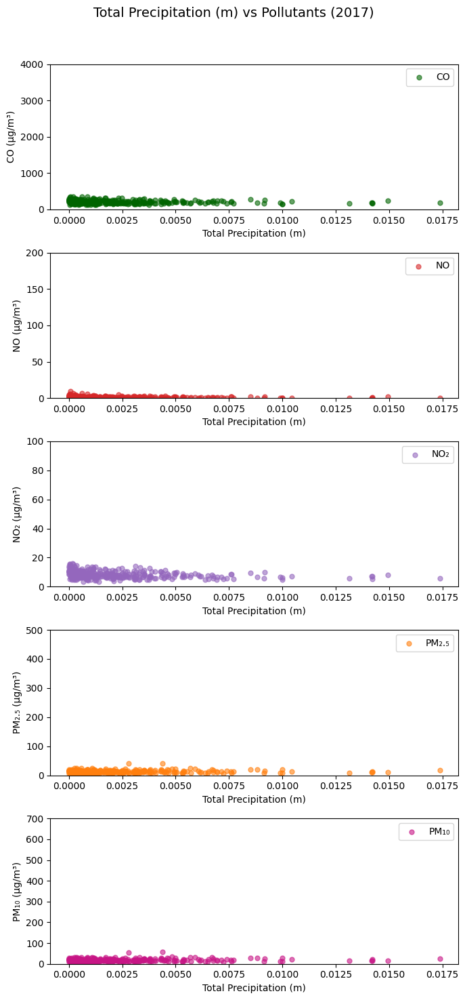


Plotting correlations for: Max Temperature (°C) (mean)


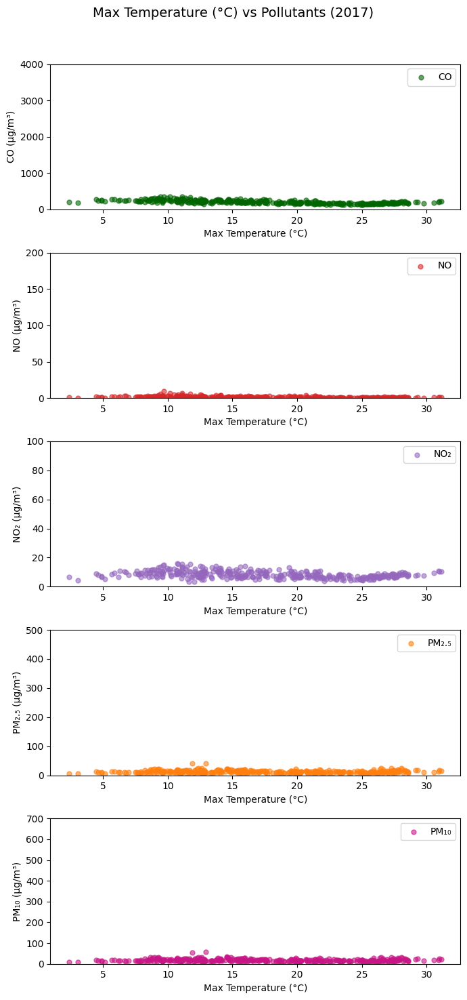


Plotting correlations for: Max Wind Speed (m/s) (mean)


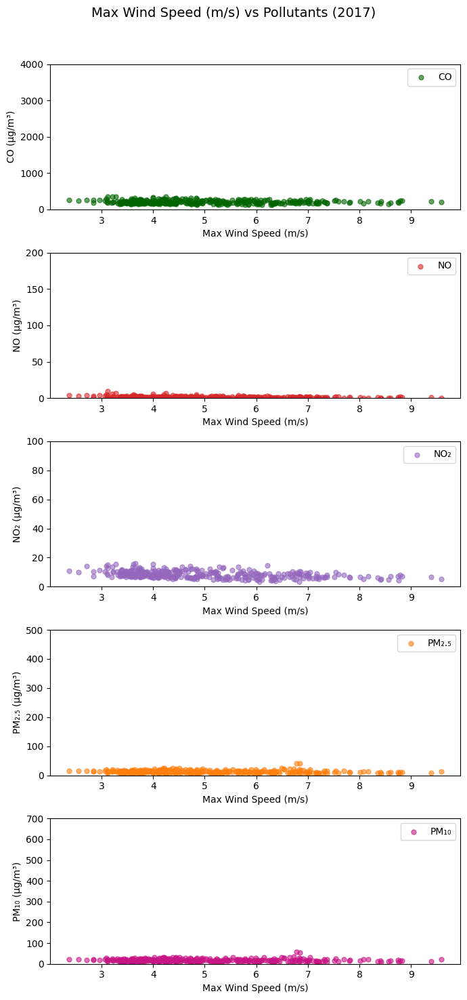

In [61]:
import xarray as xr
import matplotlib.pyplot as plt
import pandas as pd
import numpy as np
from sklearn.linear_model import LinearRegression
from sklearn.metrics import r2_score

# ============================================================
# Choose mode: "FRP" or "POLLUTANTS"
# ============================================================
mode = "POLLUTANTS"  

# ============================================================
# File paths for each pollutant
# ============================================================
files = {
    'CO':     r"D:\IPMA\Results\co_fire_meteo_Italy.nc",
    'NO':     r"D:\IPMA\Results\no_fire_meteo_Italy.nc",
    'NO₂':    r"D:\IPMA\Results\no2_fire_meteo_Italy.nc",
    'PM₂.₅':  r"D:\IPMA\Results\pm2p5_fire_meteo_Italy.nc",
    'PM₁₀':   r"D:\IPMA\Results\pm10_fire_meteo_Italy.nc"
}

# ============================================================
# Units for pollutants
# ============================================================
units = {
    'CO': 'µg/m³',
    'NO': 'µg/m³',
    'NO₂': 'µg/m³',
    'PM₂.₅': 'µg/m³',
    'PM₁₀': 'µg/m³'
}

# ============================================================
# Selected meteorological variables (Label, Statistic)
# ============================================================
meteo_vars = {
    'precip_Total_Precipitation': ('Total Precipitation (m)', 'mean'),
    'temp_Max': ('Max Temperature (°C)', 'mean'),
    'wind_Max': ('Max Wind Speed (m/s)', 'mean')
}

# ============================================================
# Load sample dataset
# ============================================================
sample_file = list(files.values())[0]
ds_sample = xr.open_dataset(sample_file)

# ============================================================
# ✅ Select a specific year to plot
# ============================================================
selected_year = 2017  # <-- Change this to the year you want
time = pd.to_datetime(ds_sample.time.values)
year_mask = time.year == selected_year
ds_sample = ds_sample.sel(time=ds_sample.time[year_mask])

tmin, tmax = pd.to_datetime(time.min()), pd.to_datetime(time.max())

# ============================================================
# Colors
# ============================================================
pollutant_colors = {
    'CO': 'darkgreen',
    'NO': 'tab:red',
    'NO₂': 'tab:purple',
    'PM₂.₅': 'tab:orange',
    'PM₁₀': 'mediumvioletred'
}
frp_color = 'crimson'

# ============================================================
# Main loop
# ============================================================
for var_name, (label, stat) in meteo_vars.items():
    print(f"\nPlotting correlations for: {label} ({stat})")

    # Get meteorological variable (spatial statistic)
    da = ds_sample[var_name]
    if stat == 'mean':
        meteo = da.mean(dim=['latitude', 'longitude'])
    elif stat == 'sum':
        meteo = da.sum(dim=['latitude', 'longitude'])
    elif stat == 'max':
        meteo = da.max(dim=['latitude', 'longitude'])
    elif stat == 'min':
        meteo = da.min(dim=['latitude', 'longitude'])
    elif stat == 'median':
        meteo = da.median(dim=['latitude', 'longitude'])
    else:
        raise ValueError(f"Unsupported stat '{stat}' for variable '{var_name}'")

    meteo_values = meteo.values
    meteo_valid = np.isfinite(meteo_values)

    # ========================================================
    # MODE 1: FRP scatter comparison
    # ========================================================
    if mode == "FRP":
        frp = ds_sample['frp_sum_Italy'].mean(dim=['latitude', 'longitude']).values
        valid = meteo_valid & np.isfinite(frp)
        x = meteo_values[valid].reshape(-1, 1)
        y = frp[valid]

        # Scatter
        fig, ax = plt.subplots(figsize=(7, 5))
        ax.scatter(x, y, color=frp_color, alpha=0.7, s=30, label='FRP (MW)')

        # Labels and formatting
        ax.set_xlabel(label)
        ax.set_ylabel('FRP (MW)')
        ax.set_ylim(0, 10000)  # Adjust as needed
        ax.legend()
        ax.grid(False)
        ax.set_title(f'{label} vs FRP (Scatter Plot) - {selected_year}')
        plt.tight_layout()
        plt.show()

    # ========================================================
    # MODE 2: Pollutant scatter comparison
    # ========================================================
    elif mode == "POLLUTANTS":
        n_pollutants = len(files)
        fig, axs = plt.subplots(n_pollutants, 1, figsize=(7, 3 * n_pollutants), sharex=False)
        fig.suptitle(f'{label} vs Pollutants ({selected_year})', fontsize=14)

        for ax, (pollutant_name, file_path) in zip(axs, files.items()):
            ds = xr.open_dataset(file_path)

            # ✅ Apply same year filter to pollutant dataset
            time_pollutant = pd.to_datetime(ds.time.values)
            year_mask_pollutant = time_pollutant.year == selected_year
            ds = ds.sel(time=ds.time[year_mask_pollutant])

            pollutant = ds['Mean'].mean(dim=['latitude', 'longitude']).values
            if pollutant_name == 'CO':
                pollutant *= 1000  # mg/m³ → µg/m³

            valid = meteo_valid & np.isfinite(pollutant)
            x = meteo_values[valid].reshape(-1, 1)
            y = pollutant[valid]

            color = pollutant_colors.get(pollutant_name, 'tab:blue')
            ax.scatter(x, y, color=color, alpha=0.6, s=25, label=pollutant_name)
            ax.set_xlabel(f"{label}")
            ax.set_ylabel(f"{pollutant_name} ({units[pollutant_name]})")
            ax.legend()
            ax.grid(False)

            # ✅ Individual Y-axis limits per pollutant
            if pollutant_name == 'CO':
                ax.set_ylim(0, 4000)
            elif pollutant_name == 'NO':
                ax.set_ylim(0, 200)
            elif pollutant_name == 'NO₂':
                ax.set_ylim(0, 100)
            elif pollutant_name == 'PM₂.₅':
                ax.set_ylim(0, 500)
            elif pollutant_name == 'PM₁₀':
                ax.set_ylim(0, 700)

        plt.tight_layout(rect=[0, 0, 1, 0.96])
        plt.show()


### Greece

#### All Years


Plotting correlations for: Total Precipitation (m) (mean)


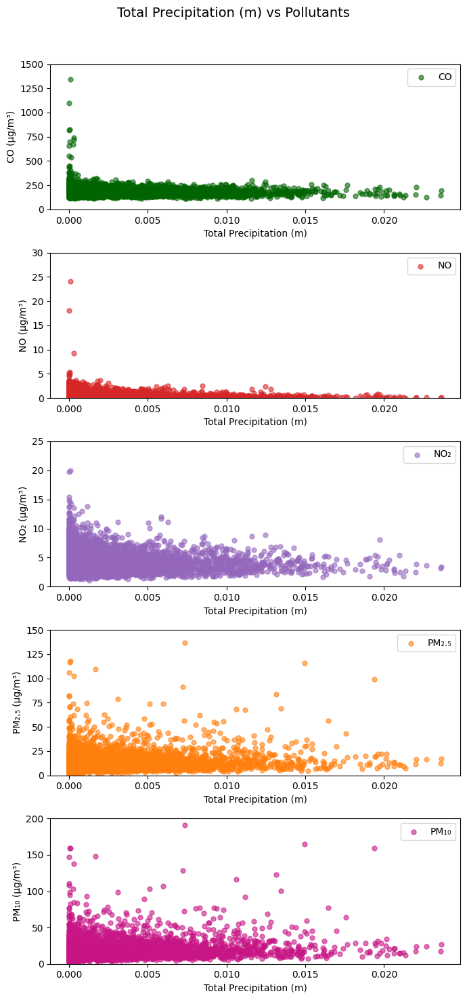


Plotting correlations for: Max Temperature (°C) (mean)


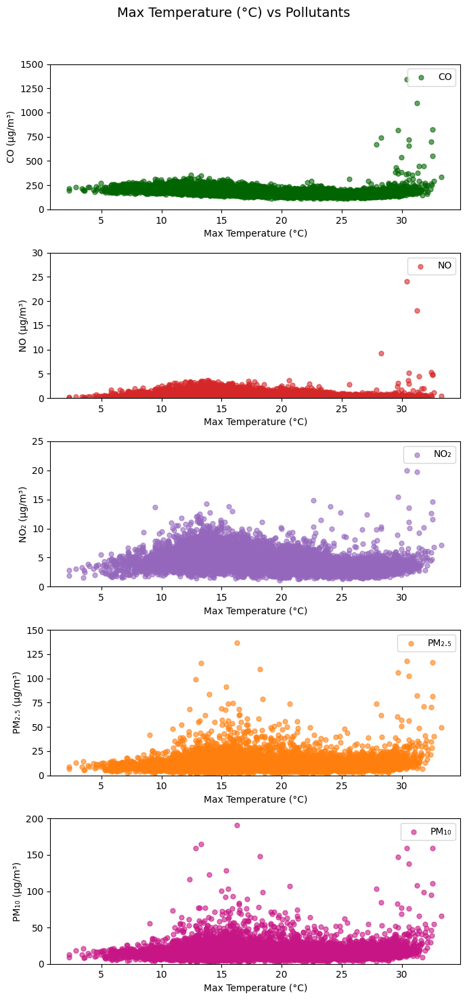


Plotting correlations for: Max Wind Speed (m/s) (mean)


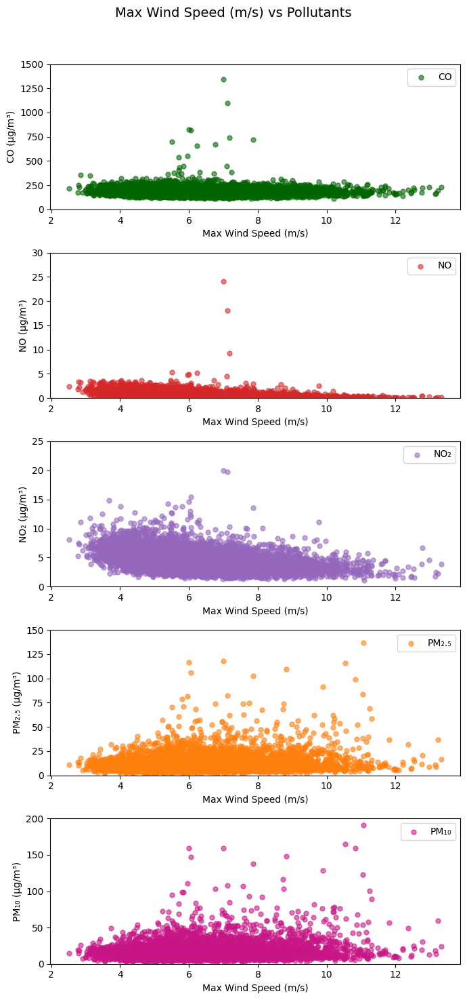

In [62]:
import xarray as xr
import matplotlib.pyplot as plt
import pandas as pd
import numpy as np
from sklearn.linear_model import LinearRegression
from sklearn.metrics import r2_score

# ============================================================
# Choose mode: "FRP" or "POLLUTANTS"
# ============================================================
mode = "POLLUTANTS"  

# ============================================================
# File paths for each pollutant
# ============================================================
files = {
    'CO':     r"D:\IPMA\Results\co_fire_meteo_Greece.nc",
    'NO':     r"D:\IPMA\Results\no_fire_meteo_Greece.nc",
    'NO₂':    r"D:\IPMA\Results\no2_fire_meteo_Greece.nc",
    'PM₂.₅':  r"D:\IPMA\Results\pm2p5_fire_meteo_Greece.nc",
    'PM₁₀':   r"D:\IPMA\Results\pm10_fire_meteo_Greece.nc"
}

# ============================================================
# Units for pollutants
# ============================================================
units = {
    'CO': 'µg/m³',
    'NO': 'µg/m³',
    'NO₂': 'µg/m³',
    'PM₂.₅': 'µg/m³',
    'PM₁₀': 'µg/m³'
}

# ============================================================
# Selected meteorological variables (Label, Statistic)
# ============================================================
meteo_vars = {
    'precip_Total_Precipitation': ('Total Precipitation (m)', 'mean'),
    'temp_Max': ('Max Temperature (°C)', 'mean'),
    'wind_Max': ('Max Wind Speed (m/s)', 'mean')
}

# ============================================================
# Load sample dataset
# ============================================================
sample_file = list(files.values())[0]
ds_sample = xr.open_dataset(sample_file)
time = ds_sample.time
tmin, tmax = pd.to_datetime(time.min().values), pd.to_datetime(time.max().values)

# ============================================================
# Colors
# ============================================================
pollutant_colors = {
    'CO': 'darkgreen',
    'NO': 'tab:red',
    'NO₂': 'tab:purple',
    'PM₂.₅': 'tab:orange',
    'PM₁₀': 'mediumvioletred'
}
frp_color = 'crimson'

# ============================================================
# Main loop
# ============================================================
for var_name, (label, stat) in meteo_vars.items():
    print(f"\nPlotting correlations for: {label} ({stat})")

    # Get meteorological variable (spatial statistic)
    da = ds_sample[var_name]
    if stat == 'mean':
        meteo = da.mean(dim=['latitude', 'longitude'])
    elif stat == 'sum':
        meteo = da.sum(dim=['latitude', 'longitude'])
    elif stat == 'max':
        meteo = da.max(dim=['latitude', 'longitude'])
    elif stat == 'min':
        meteo = da.min(dim=['latitude', 'longitude'])
    elif stat == 'median':
        meteo = da.median(dim=['latitude', 'longitude'])
    else:
        raise ValueError(f"Unsupported stat '{stat}' for variable '{var_name}'")

    meteo_values = meteo.values
    meteo_valid = np.isfinite(meteo_values)

    # ========================================================
    # MODE 1: FRP scatter comparison
    # ========================================================
    if mode == "FRP":
        frp = ds_sample['frp_sum_Greece'].mean(dim=['latitude', 'longitude']).values
        valid = meteo_valid & np.isfinite(frp)
        x = meteo_values[valid].reshape(-1, 1)
        y = frp[valid]

        # Scatter
        fig, ax = plt.subplots(figsize=(7, 5))
        ax.scatter(x, y, color=frp_color, alpha=0.7, s=30, label='FRP (MW)')

        # Labels and formatting
        ax.set_xlabel(label)
        ax.set_ylabel('FRP (MW)')
        ax.set_ylim(0, 10000) # Adjust accordingly
        ax.legend()
        ax.grid(False)
        ax.set_title(f'{label} vs FRP (Scatter Plot)')
        plt.tight_layout()
        plt.show()

    # ========================================================
    # MODE 2: Pollutant scatter comparison
    # ========================================================
    elif mode == "POLLUTANTS":
        n_pollutants = len(files)
        fig, axs = plt.subplots(n_pollutants, 1, figsize=(7, 3 * n_pollutants), sharex=False)
        fig.suptitle(f'{label} vs Pollutants', fontsize=14)

        for ax, (pollutant_name, file_path) in zip(axs, files.items()):
            ds = xr.open_dataset(file_path)
            pollutant = ds['Mean'].mean(dim=['latitude', 'longitude']).values
            if pollutant_name == 'CO':
                pollutant *= 1000  # mg/m³ → µg/m³

            valid = meteo_valid & np.isfinite(pollutant)
            x = meteo_values[valid].reshape(-1, 1)
            y = pollutant[valid]

            color = pollutant_colors.get(pollutant_name, 'tab:blue')
            ax.scatter(x, y, color=color, alpha=0.6, s=25, label=pollutant_name)
            ax.set_xlabel(f"{label}")
            ax.set_ylabel(f"{pollutant_name} ({units[pollutant_name]})")
            ax.legend()
            ax.grid(False)

            # ✅ Individual Y-axis limits per pollutant
            if pollutant_name == 'CO':
                ax.set_ylim(0, 1500)
            elif pollutant_name == 'NO':
                ax.set_ylim(0, 30)
            elif pollutant_name == 'NO₂':
                ax.set_ylim(0, 25)
            elif pollutant_name == 'PM₂.₅':
                ax.set_ylim(0, 150)
            elif pollutant_name == 'PM₁₀':
                ax.set_ylim(0, 200)

        plt.tight_layout(rect=[0, 0, 1, 0.96])
        plt.show()


#### Certain Years


Plotting correlations for: Total Precipitation (m) (mean)


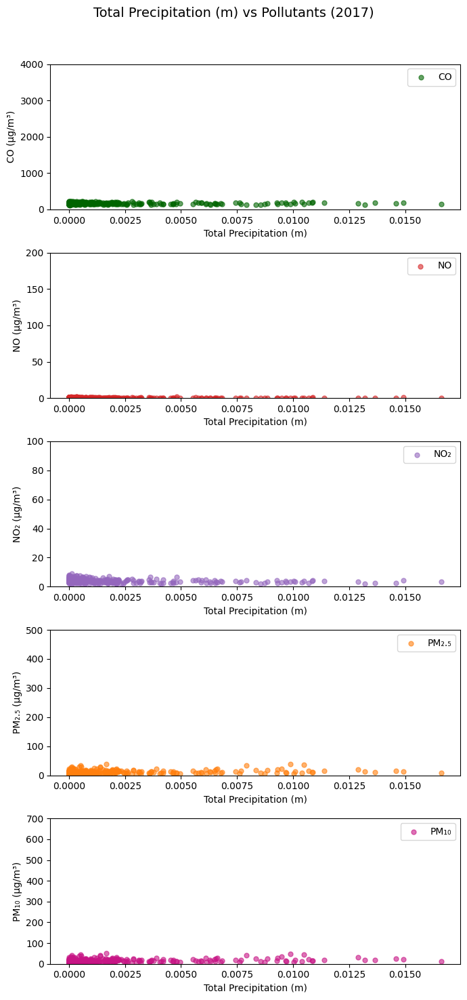


Plotting correlations for: Max Temperature (°C) (mean)


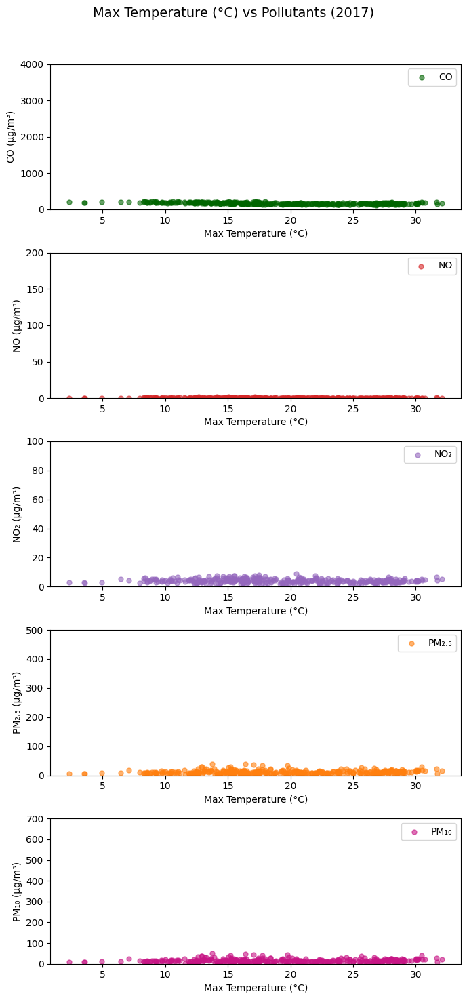


Plotting correlations for: Max Wind Speed (m/s) (mean)


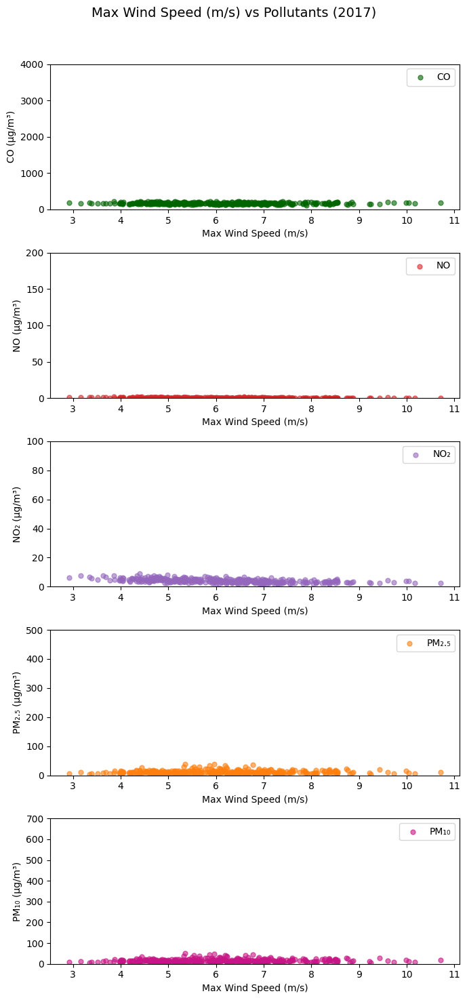

In [63]:
import xarray as xr
import matplotlib.pyplot as plt
import pandas as pd
import numpy as np
from sklearn.linear_model import LinearRegression
from sklearn.metrics import r2_score

# ============================================================
# Choose mode: "FRP" or "POLLUTANTS"
# ============================================================
mode = "POLLUTANTS"  

# ============================================================
# File paths for each pollutant
# ============================================================
files = {
    'CO':     r"D:\IPMA\Results\co_fire_meteo_Greece.nc",
    'NO':     r"D:\IPMA\Results\no_fire_meteo_Greece.nc",
    'NO₂':    r"D:\IPMA\Results\no2_fire_meteo_Greece.nc",
    'PM₂.₅':  r"D:\IPMA\Results\pm2p5_fire_meteo_Greece.nc",
    'PM₁₀':   r"D:\IPMA\Results\pm10_fire_meteo_Greece.nc"
}

# ============================================================
# Units for pollutants
# ============================================================
units = {
    'CO': 'µg/m³',
    'NO': 'µg/m³',
    'NO₂': 'µg/m³',
    'PM₂.₅': 'µg/m³',
    'PM₁₀': 'µg/m³'
}

# ============================================================
# Selected meteorological variables (Label, Statistic)
# ============================================================
meteo_vars = {
    'precip_Total_Precipitation': ('Total Precipitation (m)', 'mean'),
    'temp_Max': ('Max Temperature (°C)', 'mean'),
    'wind_Max': ('Max Wind Speed (m/s)', 'mean')
}

# ============================================================
# Load sample dataset
# ============================================================
sample_file = list(files.values())[0]
ds_sample = xr.open_dataset(sample_file)

# ============================================================
# ✅ Select a specific year to plot
# ============================================================
selected_year = 2017  # <-- Change this to the year you want
time = pd.to_datetime(ds_sample.time.values)
year_mask = time.year == selected_year
ds_sample = ds_sample.sel(time=ds_sample.time[year_mask])

tmin, tmax = pd.to_datetime(time.min()), pd.to_datetime(time.max())

# ============================================================
# Colors
# ============================================================
pollutant_colors = {
    'CO': 'darkgreen',
    'NO': 'tab:red',
    'NO₂': 'tab:purple',
    'PM₂.₅': 'tab:orange',
    'PM₁₀': 'mediumvioletred'
}
frp_color = 'crimson'

# ============================================================
# Main loop
# ============================================================
for var_name, (label, stat) in meteo_vars.items():
    print(f"\nPlotting correlations for: {label} ({stat})")

    # Get meteorological variable (spatial statistic)
    da = ds_sample[var_name]
    if stat == 'mean':
        meteo = da.mean(dim=['latitude', 'longitude'])
    elif stat == 'sum':
        meteo = da.sum(dim=['latitude', 'longitude'])
    elif stat == 'max':
        meteo = da.max(dim=['latitude', 'longitude'])
    elif stat == 'min':
        meteo = da.min(dim=['latitude', 'longitude'])
    elif stat == 'median':
        meteo = da.median(dim=['latitude', 'longitude'])
    else:
        raise ValueError(f"Unsupported stat '{stat}' for variable '{var_name}'")

    meteo_values = meteo.values
    meteo_valid = np.isfinite(meteo_values)

    # ========================================================
    # MODE 1: FRP scatter comparison
    # ========================================================
    if mode == "FRP":
        frp = ds_sample['frp_sum_Greece'].mean(dim=['latitude', 'longitude']).values
        valid = meteo_valid & np.isfinite(frp)
        x = meteo_values[valid].reshape(-1, 1)
        y = frp[valid]

        # Scatter
        fig, ax = plt.subplots(figsize=(7, 5))
        ax.scatter(x, y, color=frp_color, alpha=0.7, s=30, label='FRP (MW)')

        # Labels and formatting
        ax.set_xlabel(label)
        ax.set_ylabel('FRP (MW)')
        ax.set_ylim(0, 10000)  # Adjust as needed
        ax.legend()
        ax.grid(False)
        ax.set_title(f'{label} vs FRP (Scatter Plot) - {selected_year}')
        plt.tight_layout()
        plt.show()

    # ========================================================
    # MODE 2: Pollutant scatter comparison
    # ========================================================
    elif mode == "POLLUTANTS":
        n_pollutants = len(files)
        fig, axs = plt.subplots(n_pollutants, 1, figsize=(7, 3 * n_pollutants), sharex=False)
        fig.suptitle(f'{label} vs Pollutants ({selected_year})', fontsize=14)

        for ax, (pollutant_name, file_path) in zip(axs, files.items()):
            ds = xr.open_dataset(file_path)

            # ✅ Apply same year filter to pollutant dataset
            time_pollutant = pd.to_datetime(ds.time.values)
            year_mask_pollutant = time_pollutant.year == selected_year
            ds = ds.sel(time=ds.time[year_mask_pollutant])

            pollutant = ds['Mean'].mean(dim=['latitude', 'longitude']).values
            if pollutant_name == 'CO':
                pollutant *= 1000  # mg/m³ → µg/m³

            valid = meteo_valid & np.isfinite(pollutant)
            x = meteo_values[valid].reshape(-1, 1)
            y = pollutant[valid]

            color = pollutant_colors.get(pollutant_name, 'tab:blue')
            ax.scatter(x, y, color=color, alpha=0.6, s=25, label=pollutant_name)
            ax.set_xlabel(f"{label}")
            ax.set_ylabel(f"{pollutant_name} ({units[pollutant_name]})")
            ax.legend()
            ax.grid(False)

            # ✅ Individual Y-axis limits per pollutant
            if pollutant_name == 'CO':
                ax.set_ylim(0, 4000)
            elif pollutant_name == 'NO':
                ax.set_ylim(0, 200)
            elif pollutant_name == 'NO₂':
                ax.set_ylim(0, 100)
            elif pollutant_name == 'PM₂.₅':
                ax.set_ylim(0, 500)
            elif pollutant_name == 'PM₁₀':
                ax.set_ylim(0, 700)

        plt.tight_layout(rect=[0, 0, 1, 0.96])
        plt.show()


## Compositos

### Portugal


📊 Processing CO...
  CO: P10=117.079, P90=231.501
  803 low-pollution days, 803 high-pollution days


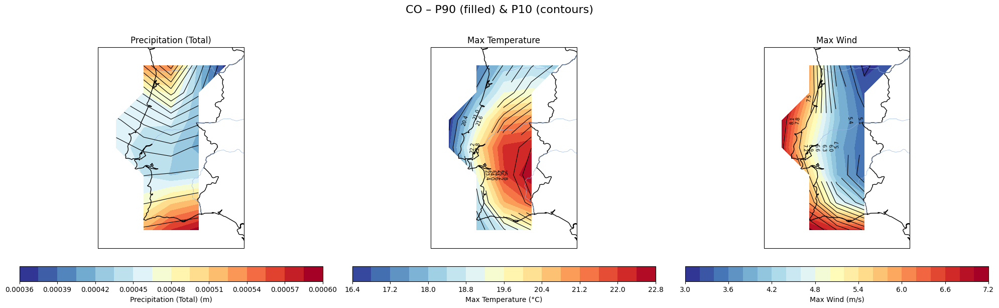


📊 Processing NO...
  NO: P10=0.108, P90=1.481
  803 low-pollution days, 803 high-pollution days


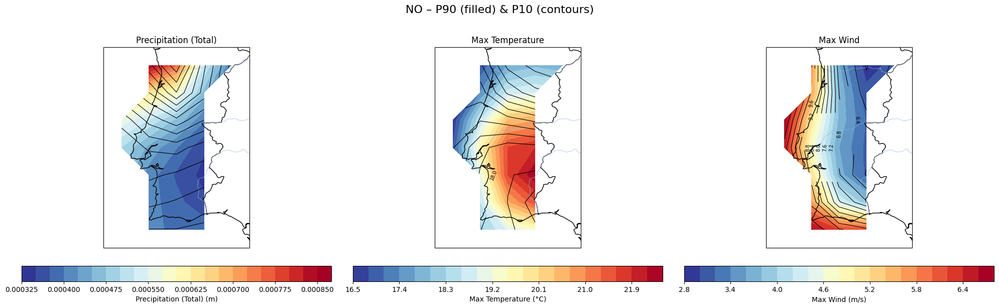


📊 Processing NO₂...
  NO₂: P10=2.865, P90=8.617
  803 low-pollution days, 803 high-pollution days


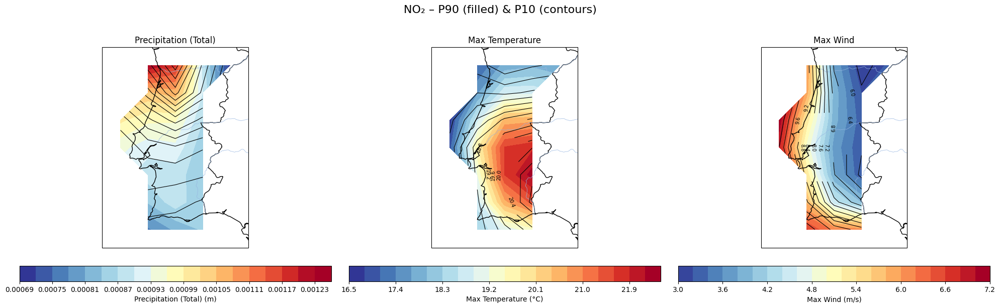


📊 Processing PM₂.₅...
  PM₂.₅: P10=4.469, P90=17.979
  803 low-pollution days, 803 high-pollution days


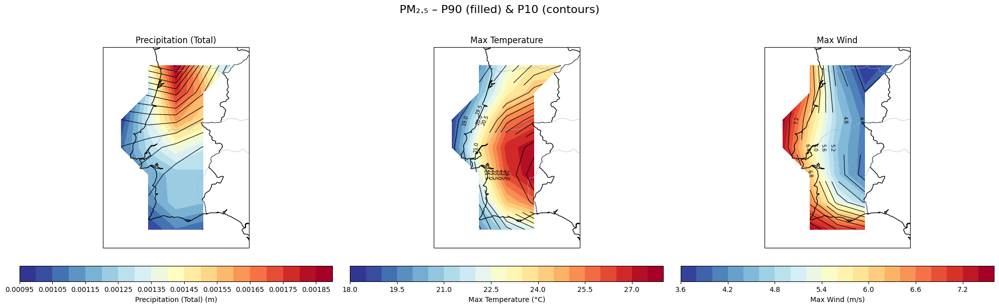


📊 Processing PM₁₀...
  PM₁₀: P10=6.670, P90=26.055
  803 low-pollution days, 803 high-pollution days


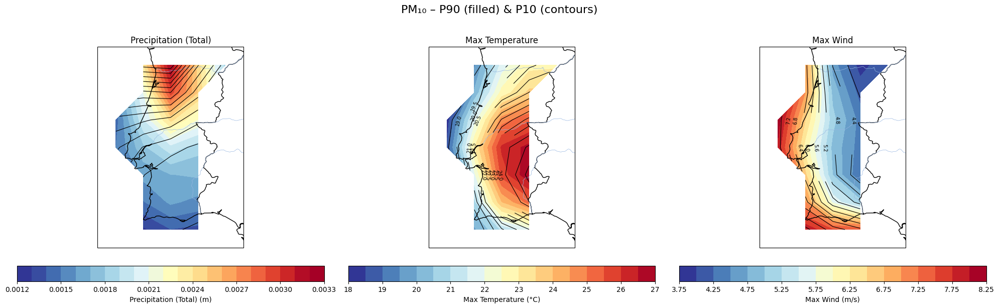


✅ All composite maps generated successfully.


In [1]:
import xarray as xr
import numpy as np
import matplotlib.pyplot as plt
import cartopy.crs as ccrs
import cartopy.feature as cfeature

# --------------------------------------------------
# 🇵🇹 FILE PATHS FOR PORTUGAL (change these later!)
# --------------------------------------------------
files = {
    'CO':     r"D:\IPMA\Results\co_fire_meteo_Portugal.nc",
    'NO':     r"D:\IPMA\Results\no_fire_meteo_Portugal.nc",
    'NO₂':    r"D:\IPMA\Results\no2_fire_meteo_Portugal.nc",
    'PM₂.₅':  r"D:\IPMA\Results\pm2p5_fire_meteo_Portugal.nc",
    'PM₁₀':   r"D:\IPMA\Results\pm10_fire_meteo_Portugal.nc"
}

# --------------------------------------------------
# Helper: automatically detect lat/lon names
# --------------------------------------------------
def detect_lat_lon(ds):
    for lat_name in ['latitude', 'lat', 'Latitude', 'LAT']:
        for lon_name in ['longitude', 'lon', 'Longitude', 'LON']:
            if lat_name in ds and lon_name in ds:
                return lat_name, lon_name
    raise ValueError("Latitude/longitude variables not found in this NetCDF file.")


# --------------------------------------------------
# Composite calculator
# --------------------------------------------------
def compute_composites(ds, pollutant_name, lat_name, lon_name):
    pollutant_var = "Mean"
    pollutant = ds[pollutant_var]

    # Convert CO to mmol/mol
    if pollutant_name == "CO":
        ds = ds.copy()
        ds[pollutant_var] = pollutant * 1000

    spatial_mean = ds[pollutant_var].mean(dim=[lat_name, lon_name], skipna=True)

    p10 = np.nanpercentile(spatial_mean, 10)
    p90 = np.nanpercentile(spatial_mean, 90)

    low_times = ds.time[spatial_mean <= p10]
    high_times = ds.time[spatial_mean >= p90]

    print(f"  {pollutant_name}: P10={p10:.3f}, P90={p90:.3f}")
    print(f"  {len(low_times)} low-pollution days, {len(high_times)} high-pollution days")

    return low_times, high_times


# --------------------------------------------------
# Auto map extent (works anywhere)
# --------------------------------------------------
def get_extent(ds, var_name, lat_name, lon_name):
    first = ds[var_name].isel(time=0)
    mask = ~np.isnan(first)

    valid_lat = np.where(mask.sum(dim=lon_name) > 0)[0]
    valid_lon = np.where(mask.sum(dim=lat_name) > 0)[0]

    if len(valid_lat) == 0 or len(valid_lon) == 0:
        print("⚠ Using fallback extent (Portugal).")
        return [-10, 0, 35, 45]  # Portugal default

    lat_min = float(ds[lat_name][valid_lat].min())
    lat_max = float(ds[lat_name][valid_lat].max())
    lon_min = float(ds[lon_name][valid_lon].min())
    lon_max = float(ds[lon_name][valid_lon].max())

    # small margin
    return [lon_min - 0.5, lon_max + 0.5, lat_min - 0.5, lat_max + 0.5]


# --------------------------------------------------
# Main plotting routine
# --------------------------------------------------
def plot_pollutant_composites(pollutant_name, file_path):
    print(f"\n📊 Processing {pollutant_name}...")

    ds = xr.open_dataset(file_path)
    lat_name, lon_name = detect_lat_lon(ds)

    # Meteorological variables (update here if needed)
    meteo_vars = {
        "Precipitation (Total)": ("precip_Total_Precipitation", "m"),
        "Max Temperature": ("temp_Max", "°C"),
        "Max Wind": ("wind_Max", "m/s")
    }

    low_times, high_times = compute_composites(ds, pollutant_name, lat_name, lon_name)
    extent = get_extent(ds, "Mean", lat_name, lon_name)

    fig, axes = plt.subplots(1, len(meteo_vars), figsize=(20, 6),
                             subplot_kw={'projection': ccrs.PlateCarree()})

    if len(meteo_vars) == 1:
        axes = [axes]

    for ax, (meteo_label, (var_name, unit)) in zip(axes, meteo_vars.items()):
        if var_name not in ds:
            print(f"⚠ Variable {var_name} not found — skipping.")
            continue

        data = ds[var_name]
        low_comp = data.sel(time=low_times).mean(dim="time", skipna=True)
        high_comp = data.sel(time=high_times).mean(dim="time", skipna=True)

        vmin = float(np.nanmin(high_comp))
        vmax = float(np.nanmax(high_comp))

        # High pollution (P90)
        im = ax.contourf(
            ds[lon_name], ds[lat_name], high_comp,
            cmap="RdYlBu_r", levels=20, vmin=vmin, vmax=vmax,
            transform=ccrs.PlateCarree()
        )

        # Low pollution (P10)
        cont = ax.contour(
            ds[lon_name], ds[lat_name], low_comp,
            levels=15, colors="k", linewidths=0.8,
            transform=ccrs.PlateCarree()
        )
        ax.clabel(cont, inline=True, fontsize=7)

        # Map style
        ax.set_title(meteo_label)
        ax.set_extent(extent, crs=ccrs.PlateCarree())
        ax.coastlines("10m")
        ax.add_feature(cfeature.BORDERS.with_scale("10m"))
        ax.add_feature(cfeature.LAKES.with_scale("10m"), alpha=0.5)
        ax.add_feature(cfeature.RIVERS.with_scale("10m"), linewidth=0.5)

        cbar = fig.colorbar(im, ax=ax, orientation="horizontal", pad=0.07)
        cbar.set_label(f"{meteo_label} ({unit})")

    fig.suptitle(f"{pollutant_name} – P90 (filled) & P10 (contours)", fontsize=16, y=1.02)
    plt.tight_layout()
    plt.show()


# --------------------------------------------------
# Run script for all pollutants
# --------------------------------------------------
for pollutant_name, path in files.items():
    plot_pollutant_composites(pollutant_name, path)

print("\n✅ All composite maps generated successfully.")


#### Spain


📊 Processing CO...
  CO: P10=132.178, P90=243.518
  803 low-pollution days, 803 high-pollution days


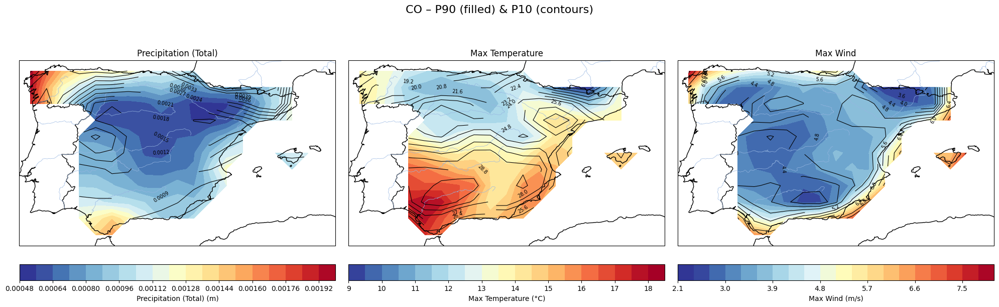


📊 Processing NO...
  NO: P10=0.169, P90=2.725
  803 low-pollution days, 803 high-pollution days


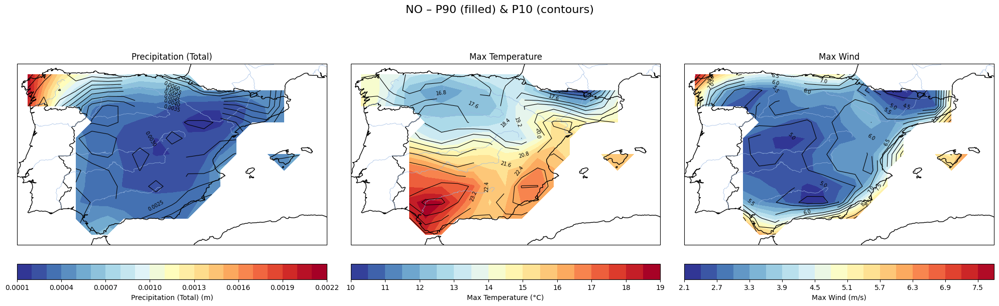


📊 Processing NO₂...
  NO₂: P10=3.701, P90=10.822
  803 low-pollution days, 803 high-pollution days


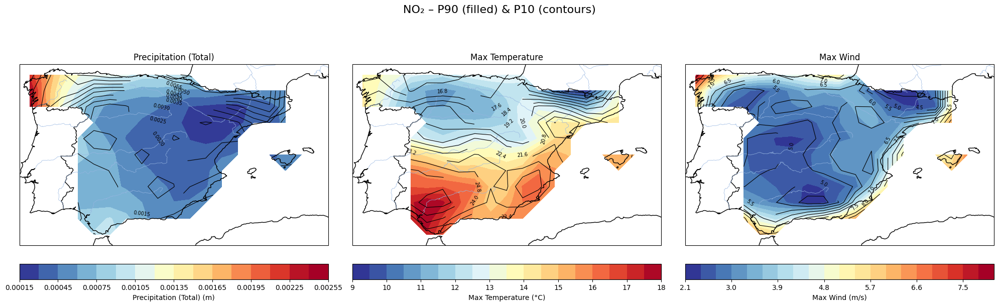


📊 Processing PM₂.₅...
  PM₂.₅: P10=5.711, P90=17.139
  803 low-pollution days, 803 high-pollution days


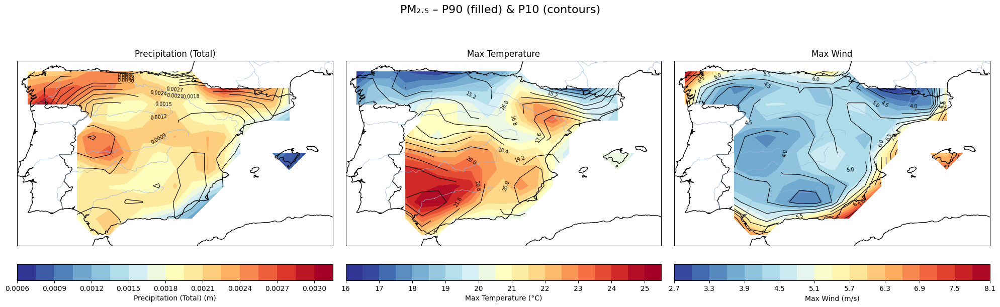


📊 Processing PM₁₀...
  PM₁₀: P10=8.502, P90=24.055
  803 low-pollution days, 803 high-pollution days


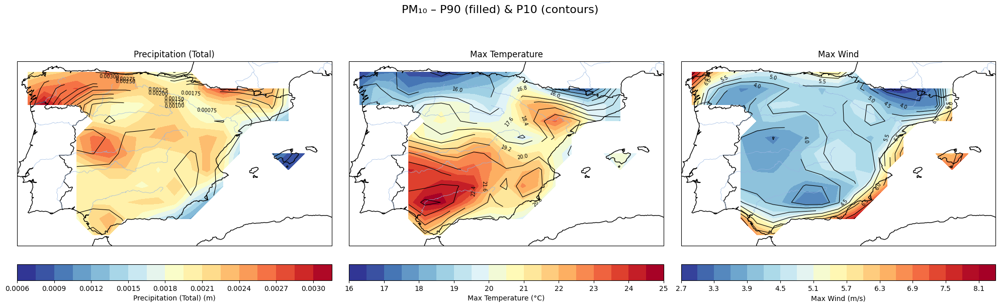


✅ All composite maps generated successfully.


In [3]:
import xarray as xr
import numpy as np
import matplotlib.pyplot as plt
import cartopy.crs as ccrs
import cartopy.feature as cfeature

# --------------------------------------------------
# 🇵🇹 FILE PATHS FOR Spain (change these later!)
# --------------------------------------------------
files = {
    'CO':     r"D:\IPMA\Results\co_fire_meteo_Spain.nc",
    'NO':     r"D:\IPMA\Results\no_fire_meteo_Spain.nc",
    'NO₂':    r"D:\IPMA\Results\no2_fire_meteo_Spain.nc",
    'PM₂.₅':  r"D:\IPMA\Results\pm2p5_fire_meteo_Spain.nc",
    'PM₁₀':   r"D:\IPMA\Results\pm10_fire_meteo_Spain.nc"
}

# --------------------------------------------------
# Helper: automatically detect lat/lon names
# --------------------------------------------------
def detect_lat_lon(ds):
    for lat_name in ['latitude', 'lat', 'Latitude', 'LAT']:
        for lon_name in ['longitude', 'lon', 'Longitude', 'LON']:
            if lat_name in ds and lon_name in ds:
                return lat_name, lon_name
    raise ValueError("Latitude/longitude variables not found in this NetCDF file.")


# --------------------------------------------------
# Composite calculator
# --------------------------------------------------
def compute_composites(ds, pollutant_name, lat_name, lon_name):
    pollutant_var = "Mean"
    pollutant = ds[pollutant_var]

    # Convert CO to mmol/mol
    if pollutant_name == "CO":
        ds = ds.copy()
        ds[pollutant_var] = pollutant * 1000

    spatial_mean = ds[pollutant_var].mean(dim=[lat_name, lon_name], skipna=True)

    p10 = np.nanpercentile(spatial_mean, 10)
    p90 = np.nanpercentile(spatial_mean, 90)

    low_times = ds.time[spatial_mean <= p10]
    high_times = ds.time[spatial_mean >= p90]

    print(f"  {pollutant_name}: P10={p10:.3f}, P90={p90:.3f}")
    print(f"  {len(low_times)} low-pollution days, {len(high_times)} high-pollution days")

    return low_times, high_times


# --------------------------------------------------
# Auto map extent (works anywhere)
# --------------------------------------------------
def get_extent(ds, var_name, lat_name, lon_name):
    first = ds[var_name].isel(time=0)
    mask = ~np.isnan(first)

    valid_lat = np.where(mask.sum(dim=lon_name) > 0)[0]
    valid_lon = np.where(mask.sum(dim=lat_name) > 0)[0]

    if len(valid_lat) == 0 or len(valid_lon) == 0:
        print("⚠ Using fallback extent (Spain).")
        return [-10, 0, 35, 45]  # Spain default

    lat_min = float(ds[lat_name][valid_lat].min())
    lat_max = float(ds[lat_name][valid_lat].max())
    lon_min = float(ds[lon_name][valid_lon].min())
    lon_max = float(ds[lon_name][valid_lon].max())

    # small margin
    return [lon_min - 0.5, lon_max + 0.5, lat_min - 0.5, lat_max + 0.5]


# --------------------------------------------------
# Main plotting routine
# --------------------------------------------------
def plot_pollutant_composites(pollutant_name, file_path):
    print(f"\n📊 Processing {pollutant_name}...")

    ds = xr.open_dataset(file_path)
    lat_name, lon_name = detect_lat_lon(ds)

    # Meteorological variables (update here if needed)
    meteo_vars = {
        "Precipitation (Total)": ("precip_Total_Precipitation", "m"),
        "Max Temperature": ("temp_Max", "°C"),
        "Max Wind": ("wind_Max", "m/s")
    }

    low_times, high_times = compute_composites(ds, pollutant_name, lat_name, lon_name)
    extent = get_extent(ds, "Mean", lat_name, lon_name)

    fig, axes = plt.subplots(1, len(meteo_vars), figsize=(20, 6),
                             subplot_kw={'projection': ccrs.PlateCarree()})

    if len(meteo_vars) == 1:
        axes = [axes]

    for ax, (meteo_label, (var_name, unit)) in zip(axes, meteo_vars.items()):
        if var_name not in ds:
            print(f"⚠ Variable {var_name} not found — skipping.")
            continue

        data = ds[var_name]
        low_comp = data.sel(time=low_times).mean(dim="time", skipna=True)
        high_comp = data.sel(time=high_times).mean(dim="time", skipna=True)

        vmin = float(np.nanmin(high_comp))
        vmax = float(np.nanmax(high_comp))

        # High pollution (P90)
        im = ax.contourf(
            ds[lon_name], ds[lat_name], high_comp,
            cmap="RdYlBu_r", levels=20, vmin=vmin, vmax=vmax,
            transform=ccrs.PlateCarree()
        )

        # Low pollution (P10)
        cont = ax.contour(
            ds[lon_name], ds[lat_name], low_comp,
            levels=15, colors="k", linewidths=0.8,
            transform=ccrs.PlateCarree()
        )
        ax.clabel(cont, inline=True, fontsize=7)

        # Map style
        ax.set_title(meteo_label)
        ax.set_extent(extent, crs=ccrs.PlateCarree())
        ax.coastlines("10m")
        ax.add_feature(cfeature.BORDERS.with_scale("10m"))
        ax.add_feature(cfeature.LAKES.with_scale("10m"), alpha=0.5)
        ax.add_feature(cfeature.RIVERS.with_scale("10m"), linewidth=0.5)

        cbar = fig.colorbar(im, ax=ax, orientation="horizontal", pad=0.07)
        cbar.set_label(f"{meteo_label} ({unit})")

    fig.suptitle(f"{pollutant_name} – P90 (filled) & P10 (contours)", fontsize=16, y=1.02)
    plt.tight_layout()
    plt.show()


# --------------------------------------------------
# Run script for all pollutants
# --------------------------------------------------
for pollutant_name, path in files.items():
    plot_pollutant_composites(pollutant_name, path)

print("\n✅ All composite maps generated successfully.")


### Iberia


📊 Processing CO...
  CO: P10=130.445, P90=242.035
  803 low-pollution days, 803 high-pollution days


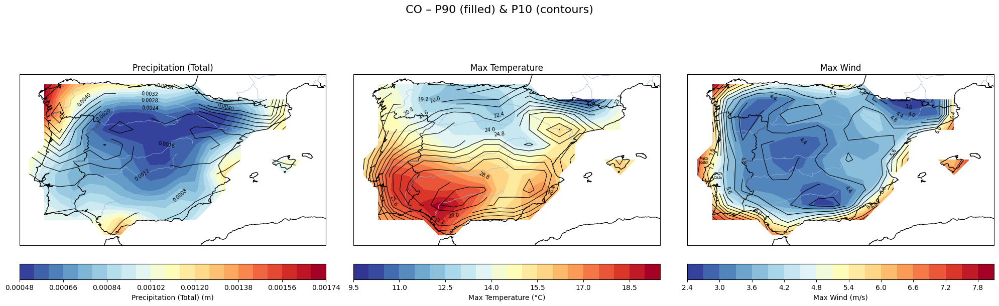


📊 Processing NO...
  NO: P10=0.168, P90=2.568
  803 low-pollution days, 803 high-pollution days


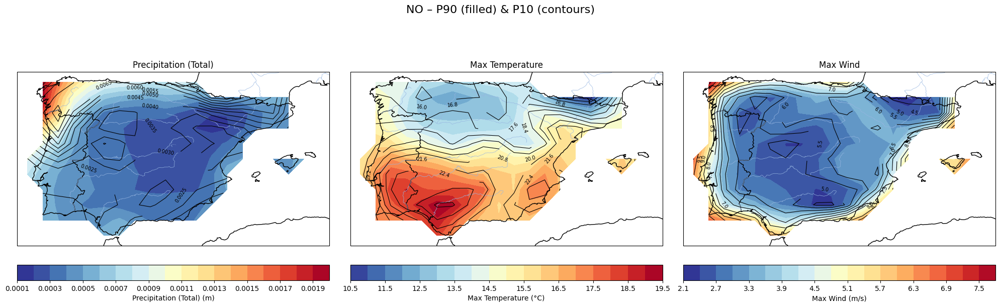


📊 Processing NO₂...
  NO₂: P10=3.654, P90=10.353
  803 low-pollution days, 803 high-pollution days


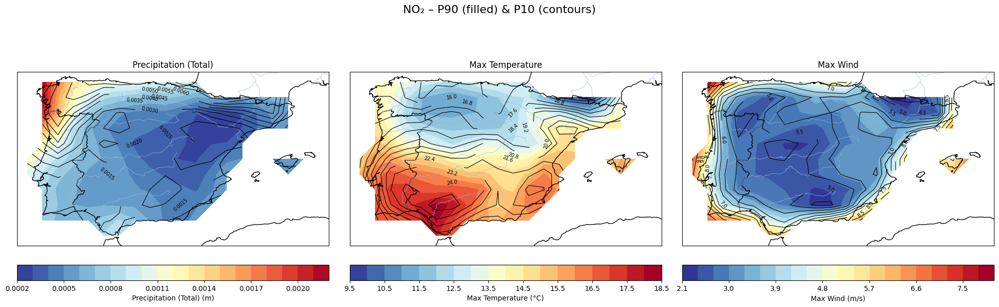


📊 Processing PM₂.₅...
  PM₂.₅: P10=5.712, P90=17.416
  803 low-pollution days, 803 high-pollution days


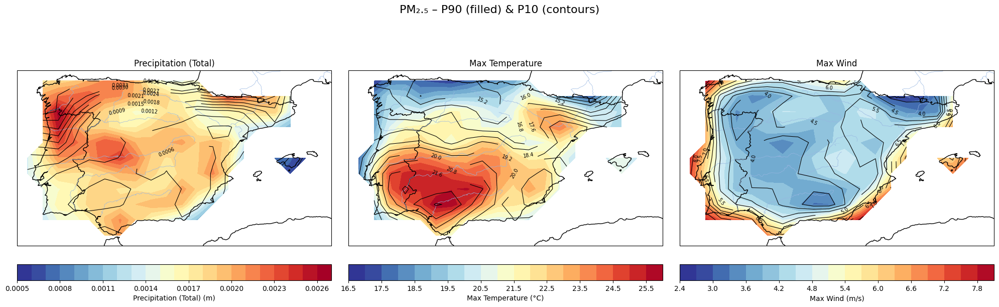


📊 Processing PM₁₀...
  PM₁₀: P10=8.521, P90=24.366
  803 low-pollution days, 803 high-pollution days


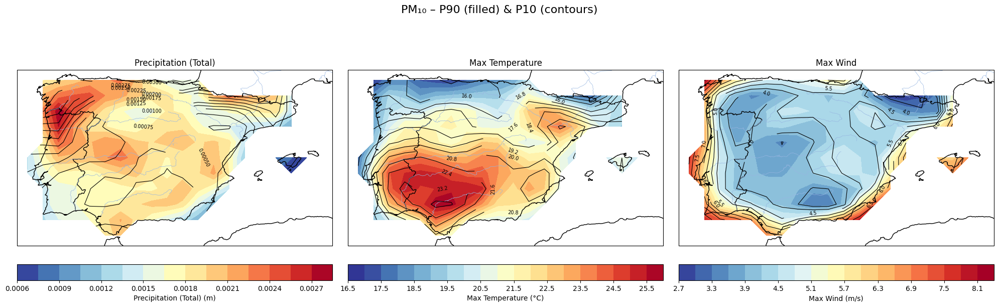


✅ All composite maps generated successfully.


In [4]:
import xarray as xr
import numpy as np
import matplotlib.pyplot as plt
import cartopy.crs as ccrs
import cartopy.feature as cfeature

# --------------------------------------------------
# 🇵🇹 FILE PATHS FOR Iberia (change these later!)
# --------------------------------------------------
files = {
    'CO':     r"D:\IPMA\Results\co_fire_meteo_Iberia.nc",
    'NO':     r"D:\IPMA\Results\no_fire_meteo_Iberia.nc",
    'NO₂':    r"D:\IPMA\Results\no2_fire_meteo_Iberia.nc",
    'PM₂.₅':  r"D:\IPMA\Results\pm2p5_fire_meteo_Iberia.nc",
    'PM₁₀':   r"D:\IPMA\Results\pm10_fire_meteo_Iberia.nc"
}

# --------------------------------------------------
# Helper: automatically detect lat/lon names
# --------------------------------------------------
def detect_lat_lon(ds):
    for lat_name in ['latitude', 'lat', 'Latitude', 'LAT']:
        for lon_name in ['longitude', 'lon', 'Longitude', 'LON']:
            if lat_name in ds and lon_name in ds:
                return lat_name, lon_name
    raise ValueError("Latitude/longitude variables not found in this NetCDF file.")


# --------------------------------------------------
# Composite calculator
# --------------------------------------------------
def compute_composites(ds, pollutant_name, lat_name, lon_name):
    pollutant_var = "Mean"
    pollutant = ds[pollutant_var]

    # Convert CO to mmol/mol
    if pollutant_name == "CO":
        ds = ds.copy()
        ds[pollutant_var] = pollutant * 1000

    spatial_mean = ds[pollutant_var].mean(dim=[lat_name, lon_name], skipna=True)

    p10 = np.nanpercentile(spatial_mean, 10)
    p90 = np.nanpercentile(spatial_mean, 90)

    low_times = ds.time[spatial_mean <= p10]
    high_times = ds.time[spatial_mean >= p90]

    print(f"  {pollutant_name}: P10={p10:.3f}, P90={p90:.3f}")
    print(f"  {len(low_times)} low-pollution days, {len(high_times)} high-pollution days")

    return low_times, high_times


# --------------------------------------------------
# Auto map extent (works anywhere)
# --------------------------------------------------
def get_extent(ds, var_name, lat_name, lon_name):
    first = ds[var_name].isel(time=0)
    mask = ~np.isnan(first)

    valid_lat = np.where(mask.sum(dim=lon_name) > 0)[0]
    valid_lon = np.where(mask.sum(dim=lat_name) > 0)[0]

    if len(valid_lat) == 0 or len(valid_lon) == 0:
        print("⚠ Using fallback extent (Iberia).")
        return [-10, 0, 35, 45]  # Iberia default

    lat_min = float(ds[lat_name][valid_lat].min())
    lat_max = float(ds[lat_name][valid_lat].max())
    lon_min = float(ds[lon_name][valid_lon].min())
    lon_max = float(ds[lon_name][valid_lon].max())

    # small margin
    return [lon_min - 0.5, lon_max + 0.5, lat_min - 0.5, lat_max + 0.5]


# --------------------------------------------------
# Main plotting routine
# --------------------------------------------------
def plot_pollutant_composites(pollutant_name, file_path):
    print(f"\n📊 Processing {pollutant_name}...")

    ds = xr.open_dataset(file_path)
    lat_name, lon_name = detect_lat_lon(ds)

    # Meteorological variables (update here if needed)
    meteo_vars = {
        "Precipitation (Total)": ("precip_Total_Precipitation", "m"),
        "Max Temperature": ("temp_Max", "°C"),
        "Max Wind": ("wind_Max", "m/s")
    }

    low_times, high_times = compute_composites(ds, pollutant_name, lat_name, lon_name)
    extent = get_extent(ds, "Mean", lat_name, lon_name)

    fig, axes = plt.subplots(1, len(meteo_vars), figsize=(20, 6),
                             subplot_kw={'projection': ccrs.PlateCarree()})

    if len(meteo_vars) == 1:
        axes = [axes]

    for ax, (meteo_label, (var_name, unit)) in zip(axes, meteo_vars.items()):
        if var_name not in ds:
            print(f"⚠ Variable {var_name} not found — skipping.")
            continue

        data = ds[var_name]
        low_comp = data.sel(time=low_times).mean(dim="time", skipna=True)
        high_comp = data.sel(time=high_times).mean(dim="time", skipna=True)

        vmin = float(np.nanmin(high_comp))
        vmax = float(np.nanmax(high_comp))

        # High pollution (P90)
        im = ax.contourf(
            ds[lon_name], ds[lat_name], high_comp,
            cmap="RdYlBu_r", levels=20, vmin=vmin, vmax=vmax,
            transform=ccrs.PlateCarree()
        )

        # Low pollution (P10)
        cont = ax.contour(
            ds[lon_name], ds[lat_name], low_comp,
            levels=15, colors="k", linewidths=0.8,
            transform=ccrs.PlateCarree()
        )
        ax.clabel(cont, inline=True, fontsize=7)

        # Map style
        ax.set_title(meteo_label)
        ax.set_extent(extent, crs=ccrs.PlateCarree())
        ax.coastlines("10m")
        ax.add_feature(cfeature.BORDERS.with_scale("10m"))
        ax.add_feature(cfeature.LAKES.with_scale("10m"), alpha=0.5)
        ax.add_feature(cfeature.RIVERS.with_scale("10m"), linewidth=0.5)

        cbar = fig.colorbar(im, ax=ax, orientation="horizontal", pad=0.07)
        cbar.set_label(f"{meteo_label} ({unit})")

    fig.suptitle(f"{pollutant_name} – P90 (filled) & P10 (contours)", fontsize=16, y=1.02)
    plt.tight_layout()
    plt.show()


# --------------------------------------------------
# Run script for all pollutants
# --------------------------------------------------
for pollutant_name, path in files.items():
    plot_pollutant_composites(pollutant_name, path)

print("\n✅ All composite maps generated successfully.")


### Italy


📊 Processing CO...
  CO: P10=158.243, P90=316.926
  803 low-pollution days, 803 high-pollution days


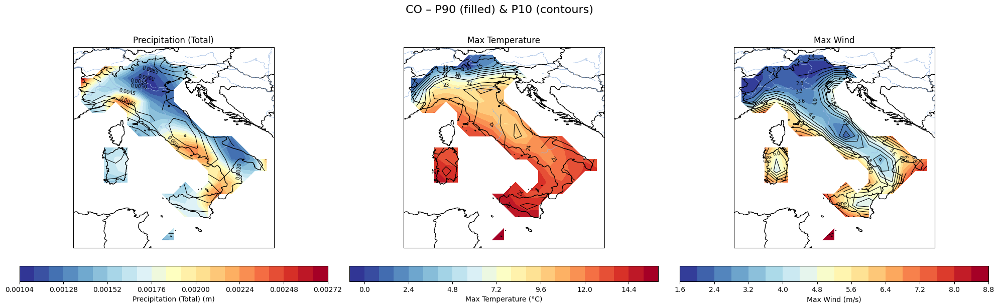


📊 Processing NO...
  NO: P10=0.336, P90=5.451
  803 low-pollution days, 803 high-pollution days


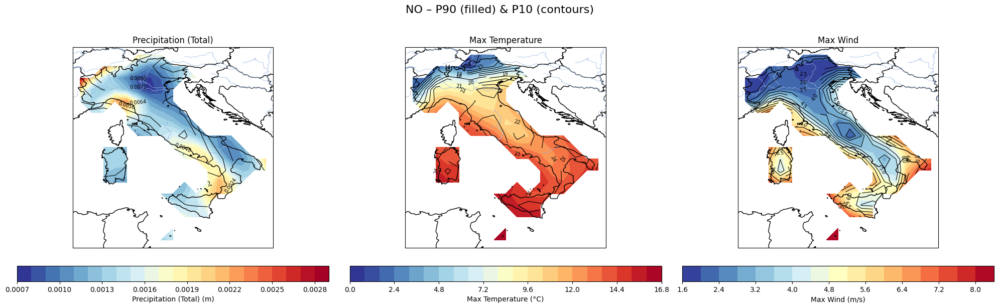


📊 Processing NO₂...
  NO₂: P10=5.709, P90=14.247
  803 low-pollution days, 803 high-pollution days


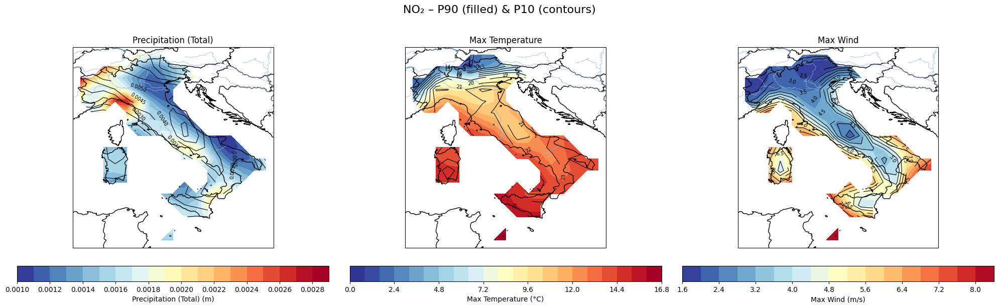


📊 Processing PM₂.₅...
  PM₂.₅: P10=8.375, P90=22.868
  803 low-pollution days, 803 high-pollution days


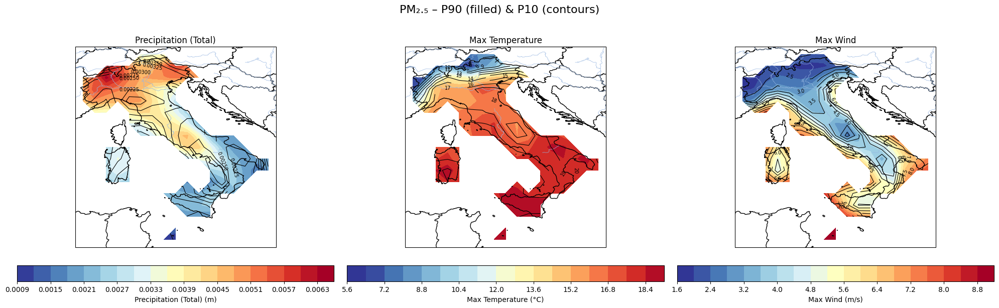


📊 Processing PM₁₀...
  PM₁₀: P10=12.116, P90=32.115
  803 low-pollution days, 803 high-pollution days


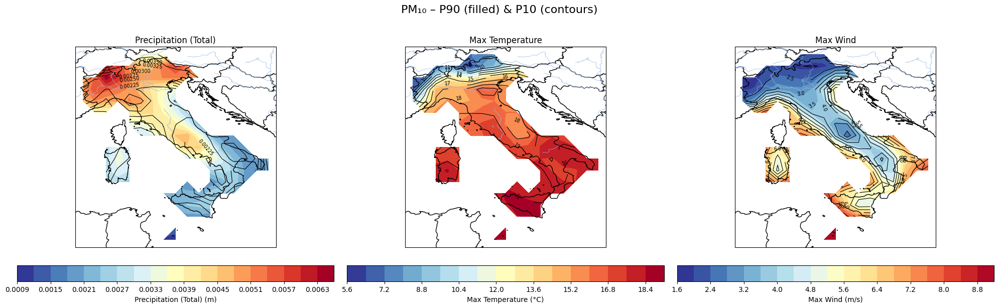


✅ All composite maps generated successfully.


In [5]:
import xarray as xr
import numpy as np
import matplotlib.pyplot as plt
import cartopy.crs as ccrs
import cartopy.feature as cfeature

# --------------------------------------------------
# 🇵🇹 FILE PATHS FOR Italy (change these later!)
# --------------------------------------------------
files = {
    'CO':     r"D:\IPMA\Results\co_fire_meteo_Italy.nc",
    'NO':     r"D:\IPMA\Results\no_fire_meteo_Italy.nc",
    'NO₂':    r"D:\IPMA\Results\no2_fire_meteo_Italy.nc",
    'PM₂.₅':  r"D:\IPMA\Results\pm2p5_fire_meteo_Italy.nc",
    'PM₁₀':   r"D:\IPMA\Results\pm10_fire_meteo_Italy.nc"
}

# --------------------------------------------------
# Helper: automatically detect lat/lon names
# --------------------------------------------------
def detect_lat_lon(ds):
    for lat_name in ['latitude', 'lat', 'Latitude', 'LAT']:
        for lon_name in ['longitude', 'lon', 'Longitude', 'LON']:
            if lat_name in ds and lon_name in ds:
                return lat_name, lon_name
    raise ValueError("Latitude/longitude variables not found in this NetCDF file.")


# --------------------------------------------------
# Composite calculator
# --------------------------------------------------
def compute_composites(ds, pollutant_name, lat_name, lon_name):
    pollutant_var = "Mean"
    pollutant = ds[pollutant_var]

    # Convert CO to mmol/mol
    if pollutant_name == "CO":
        ds = ds.copy()
        ds[pollutant_var] = pollutant * 1000

    spatial_mean = ds[pollutant_var].mean(dim=[lat_name, lon_name], skipna=True)

    p10 = np.nanpercentile(spatial_mean, 10)
    p90 = np.nanpercentile(spatial_mean, 90)

    low_times = ds.time[spatial_mean <= p10]
    high_times = ds.time[spatial_mean >= p90]

    print(f"  {pollutant_name}: P10={p10:.3f}, P90={p90:.3f}")
    print(f"  {len(low_times)} low-pollution days, {len(high_times)} high-pollution days")

    return low_times, high_times


# --------------------------------------------------
# Auto map extent (works anywhere)
# --------------------------------------------------
def get_extent(ds, var_name, lat_name, lon_name):
    first = ds[var_name].isel(time=0)
    mask = ~np.isnan(first)

    valid_lat = np.where(mask.sum(dim=lon_name) > 0)[0]
    valid_lon = np.where(mask.sum(dim=lat_name) > 0)[0]

    if len(valid_lat) == 0 or len(valid_lon) == 0:
        print("⚠ Using fallback extent (Italy).")
        return [-10, 0, 35, 45]  # Italy default

    lat_min = float(ds[lat_name][valid_lat].min())
    lat_max = float(ds[lat_name][valid_lat].max())
    lon_min = float(ds[lon_name][valid_lon].min())
    lon_max = float(ds[lon_name][valid_lon].max())

    # small margin
    return [lon_min - 0.5, lon_max + 0.5, lat_min - 0.5, lat_max + 0.5]


# --------------------------------------------------
# Main plotting routine
# --------------------------------------------------
def plot_pollutant_composites(pollutant_name, file_path):
    print(f"\n📊 Processing {pollutant_name}...")

    ds = xr.open_dataset(file_path)
    lat_name, lon_name = detect_lat_lon(ds)

    # Meteorological variables (update here if needed)
    meteo_vars = {
        "Precipitation (Total)": ("precip_Total_Precipitation", "m"),
        "Max Temperature": ("temp_Max", "°C"),
        "Max Wind": ("wind_Max", "m/s")
    }

    low_times, high_times = compute_composites(ds, pollutant_name, lat_name, lon_name)
    extent = get_extent(ds, "Mean", lat_name, lon_name)

    fig, axes = plt.subplots(1, len(meteo_vars), figsize=(20, 6),
                             subplot_kw={'projection': ccrs.PlateCarree()})

    if len(meteo_vars) == 1:
        axes = [axes]

    for ax, (meteo_label, (var_name, unit)) in zip(axes, meteo_vars.items()):
        if var_name not in ds:
            print(f"⚠ Variable {var_name} not found — skipping.")
            continue

        data = ds[var_name]
        low_comp = data.sel(time=low_times).mean(dim="time", skipna=True)
        high_comp = data.sel(time=high_times).mean(dim="time", skipna=True)

        vmin = float(np.nanmin(high_comp))
        vmax = float(np.nanmax(high_comp))

        # High pollution (P90)
        im = ax.contourf(
            ds[lon_name], ds[lat_name], high_comp,
            cmap="RdYlBu_r", levels=20, vmin=vmin, vmax=vmax,
            transform=ccrs.PlateCarree()
        )

        # Low pollution (P10)
        cont = ax.contour(
            ds[lon_name], ds[lat_name], low_comp,
            levels=15, colors="k", linewidths=0.8,
            transform=ccrs.PlateCarree()
        )
        ax.clabel(cont, inline=True, fontsize=7)

        # Map style
        ax.set_title(meteo_label)
        ax.set_extent(extent, crs=ccrs.PlateCarree())
        ax.coastlines("10m")
        ax.add_feature(cfeature.BORDERS.with_scale("10m"))
        ax.add_feature(cfeature.LAKES.with_scale("10m"), alpha=0.5)
        ax.add_feature(cfeature.RIVERS.with_scale("10m"), linewidth=0.5)

        cbar = fig.colorbar(im, ax=ax, orientation="horizontal", pad=0.07)
        cbar.set_label(f"{meteo_label} ({unit})")

    fig.suptitle(f"{pollutant_name} – P90 (filled) & P10 (contours)", fontsize=16, y=1.02)
    plt.tight_layout()
    plt.show()


# --------------------------------------------------
# Run script for all pollutants
# --------------------------------------------------
for pollutant_name, path in files.items():
    plot_pollutant_composites(pollutant_name, path)

print("\n✅ All composite maps generated successfully.")


### Greece


📊 Processing CO...
  CO: P10=143.375, P90=229.138
  803 low-pollution days, 803 high-pollution days


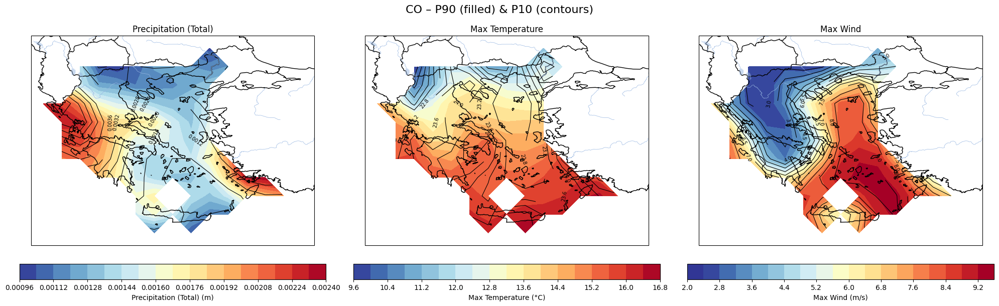


📊 Processing NO...
  NO: P10=0.094, P90=1.251
  803 low-pollution days, 803 high-pollution days


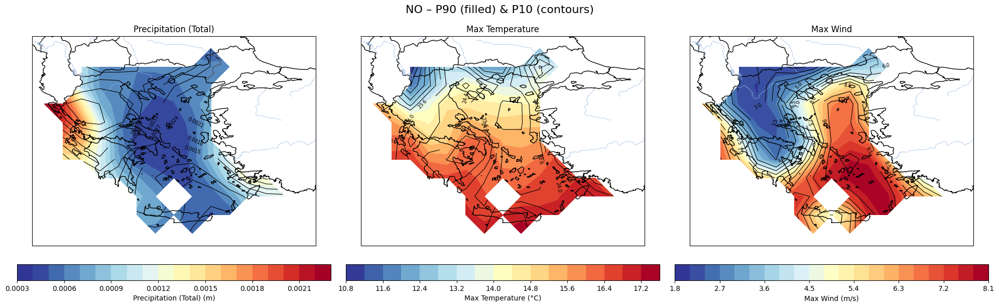


📊 Processing NO₂...
  NO₂: P10=2.462, P90=6.536
  803 low-pollution days, 803 high-pollution days


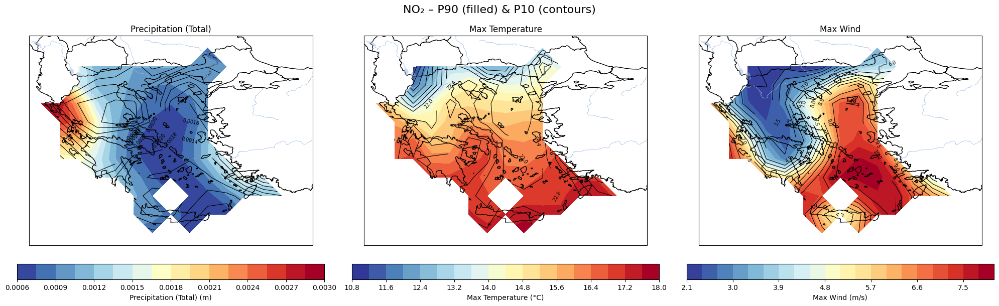


📊 Processing PM₂.₅...
  PM₂.₅: P10=6.100, P90=19.537
  803 low-pollution days, 803 high-pollution days


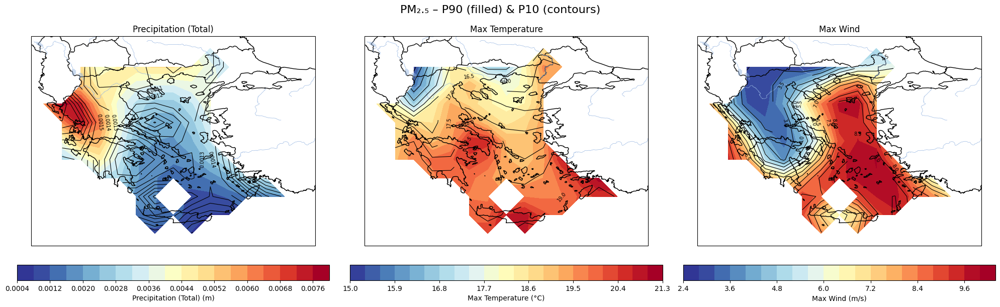


📊 Processing PM₁₀...
  PM₁₀: P10=8.806, P90=27.316
  803 low-pollution days, 803 high-pollution days


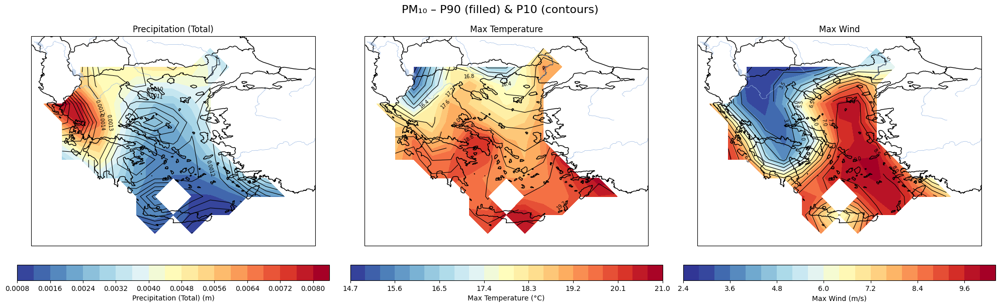


✅ All composite maps generated successfully.


In [1]:
import xarray as xr
import numpy as np
import matplotlib.pyplot as plt
import cartopy.crs as ccrs
import cartopy.feature as cfeature

# --------------------------------------------------
# 🇵🇹 FILE PATHS FOR Greece (change these later!)
# --------------------------------------------------
files = {
    'CO':     r"D:\IPMA\Results\co_fire_meteo_Greece.nc",
    'NO':     r"D:\IPMA\Results\no_fire_meteo_Greece.nc",
    'NO₂':    r"D:\IPMA\Results\no2_fire_meteo_Greece.nc",
    'PM₂.₅':  r"D:\IPMA\Results\pm2p5_fire_meteo_Greece.nc",
    'PM₁₀':   r"D:\IPMA\Results\pm10_fire_meteo_Greece.nc"
}

# --------------------------------------------------
# Helper: automatically detect lat/lon names
# --------------------------------------------------
def detect_lat_lon(ds):
    for lat_name in ['latitude', 'lat', 'Latitude', 'LAT']:
        for lon_name in ['longitude', 'lon', 'Longitude', 'LON']:
            if lat_name in ds and lon_name in ds:
                return lat_name, lon_name
    raise ValueError("Latitude/longitude variables not found in this NetCDF file.")


# --------------------------------------------------
# Composite calculator
# --------------------------------------------------
def compute_composites(ds, pollutant_name, lat_name, lon_name):
    pollutant_var = "Mean"
    pollutant = ds[pollutant_var]

    # Convert CO to mmol/mol
    if pollutant_name == "CO":
        ds = ds.copy()
        ds[pollutant_var] = pollutant * 1000

    spatial_mean = ds[pollutant_var].mean(dim=[lat_name, lon_name], skipna=True)

    p10 = np.nanpercentile(spatial_mean, 10)
    p90 = np.nanpercentile(spatial_mean, 90)

    low_times = ds.time[spatial_mean <= p10]
    high_times = ds.time[spatial_mean >= p90]

    print(f"  {pollutant_name}: P10={p10:.3f}, P90={p90:.3f}")
    print(f"  {len(low_times)} low-pollution days, {len(high_times)} high-pollution days")

    return low_times, high_times


# --------------------------------------------------
# Auto map extent (works anywhere)
# --------------------------------------------------
def get_extent(ds, var_name, lat_name, lon_name):
    first = ds[var_name].isel(time=0)
    mask = ~np.isnan(first)

    valid_lat = np.where(mask.sum(dim=lon_name) > 0)[0]
    valid_lon = np.where(mask.sum(dim=lat_name) > 0)[0]

    if len(valid_lat) == 0 or len(valid_lon) == 0:
        print("⚠ Using fallback extent (Greece).")
        return [-10, 0, 35, 45]  # Greece default

    lat_min = float(ds[lat_name][valid_lat].min())
    lat_max = float(ds[lat_name][valid_lat].max())
    lon_min = float(ds[lon_name][valid_lon].min())
    lon_max = float(ds[lon_name][valid_lon].max())

    # small margin
    return [lon_min - 0.5, lon_max + 0.5, lat_min - 0.5, lat_max + 0.5]


# --------------------------------------------------
# Main plotting routine
# --------------------------------------------------
def plot_pollutant_composites(pollutant_name, file_path):
    print(f"\n📊 Processing {pollutant_name}...")

    ds = xr.open_dataset(file_path)
    lat_name, lon_name = detect_lat_lon(ds)

    # Meteorological variables (update here if needed)
    meteo_vars = {
        "Precipitation (Total)": ("precip_Total_Precipitation", "m"),
        "Max Temperature": ("temp_Max", "°C"),
        "Max Wind": ("wind_Max", "m/s")
    }

    low_times, high_times = compute_composites(ds, pollutant_name, lat_name, lon_name)
    extent = get_extent(ds, "Mean", lat_name, lon_name)

    fig, axes = plt.subplots(1, len(meteo_vars), figsize=(20, 6),
                             subplot_kw={'projection': ccrs.PlateCarree()})

    if len(meteo_vars) == 1:
        axes = [axes]

    for ax, (meteo_label, (var_name, unit)) in zip(axes, meteo_vars.items()):
        if var_name not in ds:
            print(f"⚠ Variable {var_name} not found — skipping.")
            continue

        data = ds[var_name]
        low_comp = data.sel(time=low_times).mean(dim="time", skipna=True)
        high_comp = data.sel(time=high_times).mean(dim="time", skipna=True)

        vmin = float(np.nanmin(high_comp))
        vmax = float(np.nanmax(high_comp))

        # High pollution (P90)
        im = ax.contourf(
            ds[lon_name], ds[lat_name], high_comp,
            cmap="RdYlBu_r", levels=20, vmin=vmin, vmax=vmax,
            transform=ccrs.PlateCarree()
        )

        # Low pollution (P10)
        cont = ax.contour(
            ds[lon_name], ds[lat_name], low_comp,
            levels=15, colors="k", linewidths=0.8,
            transform=ccrs.PlateCarree()
        )
        ax.clabel(cont, inline=True, fontsize=7)

        # Map style
        ax.set_title(meteo_label)
        ax.set_extent(extent, crs=ccrs.PlateCarree())
        ax.coastlines("10m")
        ax.add_feature(cfeature.BORDERS.with_scale("10m"))
        ax.add_feature(cfeature.LAKES.with_scale("10m"), alpha=0.5)
        ax.add_feature(cfeature.RIVERS.with_scale("10m"), linewidth=0.5)

        cbar = fig.colorbar(im, ax=ax, orientation="horizontal", pad=0.07)
        cbar.set_label(f"{meteo_label} ({unit})")

    fig.suptitle(f"{pollutant_name} – P90 (filled) & P10 (contours)", fontsize=16, y=1.02)
    plt.tight_layout()
    plt.show()


# --------------------------------------------------
# Run script for all pollutants
# --------------------------------------------------
for pollutant_name, path in files.items():
    plot_pollutant_composites(pollutant_name, path)

print("\n✅ All composite maps generated successfully.")
